<a href="https://colab.research.google.com/github/currencyfxjle/An-lisis-Causal-y-Predictivo-Utilizando-Regresi-n/blob/main/Servicios_a_GBM.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import pandas as pd
import datetime
import plotly.graph_objects as go

# Function to obtain interest rate for a given currency
def get_info(currency):
    urls = {
        'EUR': 'https://datosmacro.expansion.com/tipo-interes/zona-euro',
        'GBP': 'https://datosmacro.expansion.com/tipo-interes/uk',
        'USD': 'https://datosmacro.expansion.com/tipo-interes/usa',
        'JPY': 'https://datosmacro.expansion.com/tipo-interes/japon',
        'AUD': 'https://datosmacro.expansion.com/tipo-interes/australia',
        'CAD': 'https://datosmacro.expansion.com/tipo-interes/canada',
        'NZD': 'https://datosmacro.expansion.com/tipo-interes/nueva-zelanda',
        'CHF': 'https://datosmacro.expansion.com/tipo-interes/suiza',
        'MXN': 'https://datosmacro.expansion.com/tipo-interes/mexico',
        'PLN': 'https://datosmacro.expansion.com/tipo-interes/polonia',
        'HUF': 'https://datosmacro.expansion.com/tipo-interes/hungria',
        'ZAR': 'https://datosmacro.expansion.com/tipo-interes/sudafrica',
        'CNY': 'https://datosmacro.expansion.com/tipo-interes/china'
    }
    try:
        url = urls[currency]
        df = pd.read_html(url)[0]
        df['Fecha'] = pd.to_datetime(df['Fecha'], format='%d/%m/%Y')
        df.set_index('Fecha', inplace=True)
        df.sort_index(inplace=True)
        df = df.loc['2000-01-01':]
        df.columns = [currency]
        df[currency] = df[currency].str.replace(',', '.').str.rstrip('%').astype('float')
        return df
    except Exception as e:
        print(f"Error fetching data for {currency}: {e}")
        return pd.DataFrame()

# Function to obtain the dataset with interest rates from major central banks
def get_dataset():
    df = pd.DataFrame(index=pd.date_range(start='2008-01-01', end=datetime.datetime.now()))
    df.index.name = 'Date'
    currencies = ['EUR', 'USD', 'GBP', 'CHF', 'CAD', 'AUD', 'NZD', 'JPY', 'MXN', 'PLN', 'HUF', 'ZAR', 'CNY']
    for currency in currencies:
        print(f"Fetching interest rates for {currency}...")
        df_currency = get_info(currency)
        if not df_currency.empty:
            df = df.merge(df_currency, left_index=True, right_index=True, how='left')
    df.ffill(inplace=True)
    df.dropna(inplace=True)
    return df

# Main execution block
if __name__ == "__main__":
    print("Fetching dataset of interest rates...")
    try:
        df_rates = get_dataset()  # Get the dataset of interest rates
        print("Dataset fetched successfully.")
    except Exception as e:
        print(f"Error fetching interest rates dataset: {e}")
        exit()

    # Create a Plotly figure
    fig = go.Figure()

    # Add traces for each currency's interest rate
    for column in df_rates.columns:
        fig.add_trace(go.Scatter(
            x=df_rates.index,
            y=df_rates[column],
            mode='lines',
            name=column,
            hovertemplate='<b>%{customdata} Interest Rate</b><br>Date: %{x}<br>Rate: %{y:.2f}%',
            customdata=[column] * len(df_rates)
        ))

    # Extend x-axis range
    last_date = df_rates.index[-1]
    extra_space = datetime.timedelta(days=90)  # Add 90 days as extra space
    extended_x_range = [df_rates.index[0], last_date + extra_space]

    # Update layout
    fig.update_layout(
        title='Interest Rates for All Currencies',
        xaxis=dict(title='Date', tickformat='%Y-%m-%d', range=extended_x_range),
        yaxis=dict(title='Interest Rate (%)'),
        legend=dict(title='Currencies'),
        width=1200,
        height=700,
        template='plotly_white'
    )

    # Show the interactive plot
    fig.show()


Fetching dataset of interest rates...
Fetching interest rates for EUR...
Fetching interest rates for USD...
Fetching interest rates for GBP...
Fetching interest rates for CHF...
Fetching interest rates for CAD...
Fetching interest rates for AUD...
Fetching interest rates for NZD...
Fetching interest rates for JPY...
Fetching interest rates for MXN...
Fetching interest rates for PLN...
Fetching interest rates for HUF...
Fetching interest rates for ZAR...
Fetching interest rates for CNY...
Dataset fetched successfully.


In [ ]:
import pandas as pd
import yfinance as yf
import plotly.graph_objects as go
import datetime

# Function to obtain interest rate for a given currency
def get_info(currency):
    urls = {
        'EUR': 'https://datosmacro.expansion.com/tipo-interes/zona-euro',
        'USD': 'https://datosmacro.expansion.com/tipo-interes/usa',
        'MXN': 'https://datosmacro.expansion.com/tipo-interes/mexico'
    }
    try:
        url = urls[currency]
        df = pd.read_html(url)[0]
        df['Fecha'] = pd.to_datetime(df['Fecha'], format='%d/%m/%Y')
        df.set_index('Fecha', inplace=True)
        df.sort_index(inplace=True)
        df = df.loc['2000-01-01':]
        df.columns = [currency]
        df[currency] = df[currency].str.replace(',', '.').str.rstrip('%').astype('float')
        return df
    except Exception as e:
        print(f"Error fetching data for {currency}: {e}")
        return pd.DataFrame()

# Function to fetch and combine interest rates
def get_dataset():
    df = pd.DataFrame(index=pd.date_range(start='2008-01-01', end=datetime.datetime.now()))
    df.index.name = 'Date'
    currencies = ['USD', 'MXN']
    for currency in currencies:
        print(f"Fetching interest rates for {currency}...")
        df_currency = get_info(currency)
        if not df_currency.empty:
            df = df.merge(df_currency, left_index=True, right_index=True, how='left')
    df.ffill(inplace=True)
    df.dropna(inplace=True)
    return df

# Function to plot closing prices with interest rates using Plotly
def plot_relation(pair, df_rates, title):
    currency_1, currency_2 = pair[:3], pair[3:]
    # Fetch closing prices
    pair_data = yf.Ticker(pair + "=X").history(start="2008-01-01", end=datetime.datetime.now(), interval="1d")

    # Remove timezone information from pair_data index
    pair_data.index = pair_data.index.tz_localize(None)

    # Align data on common dates
    common_dates = pair_data.index.intersection(df_rates.index)
    if len(common_dates) == 0:
        print("No overlapping dates found. Exiting function.")
        return

    pair_data = pair_data.loc[common_dates]
    df_rates = df_rates.loc[common_dates]

    # Extract variables
    primary_rate = df_rates[currency_1]
    secondary_rate = df_rates[currency_2]
    rate_diff = primary_rate - secondary_rate
    closing_prices = pair_data['Close']

    # Create a Plotly figure
    fig = go.Figure()

    # Add interest rates and their differential on the primary (left) y-axis
    fig.add_trace(go.Scatter(
        x=df_rates.index,
        y=primary_rate,
        mode='lines',
        name=f'{currency_1} Interest Rate',
        line=dict(color='green'),
        yaxis="y1"
    ))
    fig.add_trace(go.Scatter(
        x=df_rates.index,
        y=secondary_rate,
        mode='lines',
        name=f'{currency_2} Interest Rate',
        line=dict(color='red'),
        yaxis="y1"
    ))
    fig.add_trace(go.Scatter(
        x=df_rates.index,
        y=rate_diff,
        mode='lines',
        name='Interest Rate Differential',
        line=dict(color='blue'),
        yaxis="y1"
    ))

    # Add closing prices on the secondary (right) y-axis
    fig.add_trace(go.Scatter(
        x=closing_prices.index,
        y=closing_prices,
        mode='lines',
        name=f'{pair} Closing Prices',
        line=dict(color='black'),
        yaxis="y2"
    ))

    # Update layout with dual axes
    fig.update_layout(
        title=title,
        xaxis_title='Date',
        yaxis=dict(
            title='Interest Rates (%)',
            titlefont=dict(color='black'),
            tickfont=dict(color='black'),
            side='left'
        ),
        yaxis2=dict(
            title='Closing Prices',
            titlefont=dict(color='black'),
            tickfont=dict(color='black'),
            overlaying='y',
            side='right'
        ),
        legend=dict(
            orientation="h",  # Horizontal legend
            yanchor="top",    # Align top of legend with anchor point
            y=-0.1,           # Place below the "Date" label
            xanchor="center", # Center the legend horizontally
            x=0.5             # Center position
        ),
        width=1100,
        height=600
    )

    # Show the plot
    fig.show()

# Main execution block
if __name__ == "__main__":
    print("Fetching dataset of interest rates...")
    try:
        df_rates = get_dataset()
        print("Dataset fetched successfully.")
    except Exception as e:
        print(f"Error fetching interest rates dataset: {e}")
        exit()

    # Define the pair
    pair = "USDMXN"
    title = f'Interest Rates, Differential, and {pair} Closing Prices'
    plot_relation(pair, df_rates, title)


Fetching dataset of interest rates...
Fetching interest rates for USD...
Fetching interest rates for MXN...
Dataset fetched successfully.


In [ ]:
import yfinance as yf
import pandas as pd
import numpy as np
from scipy.stats import zscore
import plotly.graph_objects as go

# List of currency pairs
tickers = {
    "USDMXN=X": "Mexican Peso (MXN)",
}

# Create a figure for growth
fig_growth = go.Figure()

# Create a figure for variances
fig_variances = go.Figure()

# Loop through each currency pair
for ticker in tickers:
    # Download the data
    data = yf.Ticker(ticker).history(start="2024-01-01", end="2025-01-31")
    data['Return'] = data['Close'].pct_change()
    data.dropna(inplace=True)

    # Calculate cumulative growth of returns
    data['Cumulative Growth'] = (1 + data['Return']).cumprod()

    # Add a subplot for the currency pair in the growth figure
    fig_growth.add_trace(go.Scatter(x=data.index, y=data['Cumulative Growth'], mode='lines', name=f'{ticker} Growth'))

    # Isolate positive and negative returns
    positive_returns = data['Return'].copy()
    negative_returns = data['Return'].copy()
    positive_returns[positive_returns < 0] = 0
    negative_returns[negative_returns > 0] = 0
    negative_returns = negative_returns.abs()

    # Calculate cumulative variance for positive and negative returns
    data['Cumulative Positive Variance'] = positive_returns.cumsum()
    data['Cumulative Negative Variance'] = negative_returns.cumsum()

    # Apply z-score normalization
    data['Z Cumulative Positive Variance'] = zscore(data['Cumulative Positive Variance'])
    data['Z Cumulative Negative Variance'] = zscore(data['Cumulative Negative Variance'])

    # Add a subplot for the currency pair in the variances figure
    fig_variances.add_trace(go.Scatter(x=data.index, y=data['Z Cumulative Positive Variance'], mode='lines', name=f'{ticker} Positive Variance', line=dict(color='green')))
    fig_variances.add_trace(go.Scatter(x=data.index, y=data['Z Cumulative Negative Variance'], mode='lines', name=f'{ticker} Negative Variance', line=dict(color='red')))

# Update layout for the growth figure
fig_growth.update_layout(
    title='Cumulative Growth of Returns for Currency Pairs',
    xaxis_title='Date',
    yaxis_title='Cumulative Growth',
    height=500, width=1000,
    legend_title_text='Currency Pair'
)

# Update layout for the variances figure
fig_variances.update_layout(
    title='Normalized Cumulative Positive and Negative Variances for Currency Pairs',
    xaxis_title='Date',
    yaxis_title='Normalized Value',
    height=500, width=1000,
    legend_title_text='Currency Pair'
)

# Show both figures
fig_growth.show()
fig_variances.show()

In [ ]:
import yfinance as yf
import pandas as pd
import numpy as np
from scipy.stats import zscore
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# List of currency pairs
tickers = {
    "USDMXN=X": "Mexican Peso (MXN)",
}

# Create a subplot figure with secondary y-axis
fig = make_subplots(specs=[[{"secondary_y": True}]])

# Loop through each currency pair
for ticker in tickers:
    # Download the data
    data = yf.Ticker(ticker).history(start="2024-01-01", end="2025-01-31")
    data['Return'] = data['Close'].pct_change()
    data.dropna(inplace=True)

    # Calculate cumulative growth of returns
    data['Cumulative Growth'] = (1 + data['Return']).cumprod() - 1  # Subtract 1 for actual growth in %

    # Isolate positive and negative returns
    positive_returns = data['Return'].copy()
    negative_returns = data['Return'].copy()
    positive_returns[positive_returns < 0] = 0
    negative_returns[negative_returns > 0] = 0
    negative_returns = negative_returns.abs()

    # Calculate cumulative variance for positive and negative returns
    data['Cumulative Positive Variance'] = positive_returns.cumsum()
    data['Cumulative Negative Variance'] = negative_returns.cumsum()

    # Apply z-score normalization
    data['Z Cumulative Positive Variance'] = zscore(data['Cumulative Positive Variance'])
    data['Z Cumulative Negative Variance'] = zscore(data['Cumulative Negative Variance'])

    # Add cumulative growth to primary y-axis
    fig.add_trace(
        go.Scatter(
            x=data.index,
            y=data['Cumulative Growth'],
            mode='lines',
            name=f'{tickers[ticker]} Growth',
            line=dict(color='blue', width=2)  # Strong line to grab attention
        ),
        secondary_y=False,
    )

    # Add positive variance with lighter green
    fig.add_trace(
        go.Scatter(
            x=data.index,
            y=data['Z Cumulative Positive Variance'],
            mode='lines',
            name=f'{tickers[ticker]} Positive Variance',
            line=dict(color='rgba(0, 128, 0, 0.6)', width=1)  # Lighter green, thinner line
        ),
        secondary_y=True,
    )

    # Add negative variance with lighter red
    fig.add_trace(
        go.Scatter(
            x=data.index,
            y=data['Z Cumulative Negative Variance'],
            mode='lines',
            name=f'{tickers[ticker]} Negative Variance',
            line=dict(color='rgba(255, 0, 0, 0.6)', width=1)  # Lighter red, thinner line
        ),
        secondary_y=True,
    )

# Update layout
fig.update_layout(
    title='Cumulative Growth and Normalized Variances for Currency Pairs',
    xaxis_title='Date',
    height=600,
    width=1000,
    legend=dict(
        orientation="h",  # Horizontal legend
        yanchor="top",    # Align the top of the legend with its anchor
        y=-0.1,           # Move below the X-axis title
        xanchor="center", # Center the legend horizontally
        x=0.5             # Center the legend in the chart
    ),
    legend_title_text='Metrics'
)

# Set primary y-axis for Cumulative Growth
fig.update_yaxes(
    title_text="Cumulative Growth (%)",
    secondary_y=False,
    tickformat=".1%",  # Show percentages (e.g., 0.20 -> 20.0%)
)

# Set secondary y-axis for Normalized Variance and make it invisible
fig.update_yaxes(
    title_text="Normalized Variance (Z-Score)",
    secondary_y=True,
    showgrid=False,
    tickfont=dict(color="white"),  # Make labels invisible
    title_font=dict(color="white"),  # Make title invisible
    zerolinecolor="white"  # Make zero line invisible
)

# Show the figure
fig.show()


In [ ]:
import yfinance as yf
import pandas as pd
import plotly.graph_objects as go

# Define the ticker for USDMXN and the date range
ticker = "USDMXN=X"
start_date = '2000-01-01'  # Early start date for comprehensive historical data
end_date = '2025-12-31'    # Include current year to ensure it covers all available data to date

# Download historical data
data = yf.download(ticker, start=start_date, end=end_date)

# Ensure the 'Close' column exists
if 'Close' not in data.columns:
    print("Error: 'Close' column not found in the data")
    exit()

# Add a year column to facilitate analysis by year
data['Year'] = data.index.year

# Initialize the plot
fig = go.Figure()

# Get the current year
current_year = pd.Timestamp.today().year

# Process each year's data
for year in sorted(data['Year'].unique()):
    # Extract the data for the year
    yearly_data = data[data['Year'] == year].copy()

    # Calculate daily returns
    yearly_data.loc[:, 'Returns'] = yearly_data['Close'].pct_change()

    # Calculate cumulative returns
    yearly_data.loc[:, 'Cumulative Returns'] = (1 + yearly_data['Returns'].fillna(0)).cumprod() - 1

    # Normalize to start at zero for comparison
    yearly_data.loc[:, 'Normalized Cumulative Returns'] = yearly_data['Cumulative Returns'] - yearly_data['Cumulative Returns'].iloc[0]

    # Determine line color based on whether it's the current year
    line_color = 'red' if year == current_year else 'gray'

    # Add trace for the year
    fig.add_trace(go.Scatter(
        x=yearly_data.index.dayofyear,  # Use day of year for x-axis
        y=yearly_data['Normalized Cumulative Returns'],
        mode='lines',
        name=str(year),
        line=dict(color=line_color, width=3 if year == current_year else 2)
    ))

# Update layout
fig.update_layout(
    title="Annual Cumulative Growth Comparison for USDMXN",
    xaxis_title="Day of Year",
    yaxis_title="Normalized Cumulative Return",
    legend_title="Year",
    template="plotly_dark",
    width=1100,
    height=600
)

# Show the plot
fig.show()

[*********************100%***********************]  1 of 1 completed


In [ ]:
import yfinance as yf
import pandas as pd
import plotly.graph_objects as go

# Define the ticker for USDMXN and the date range
ticker = "USDMXN=X"
start_date = '2000-01-01'  # Early start date for comprehensive historical data
end_date = '2025-12-31'    # Include current year to ensure it covers all available data to date

# Download historical data
data = yf.download(ticker, start=start_date, end=end_date)

# Ensure the 'Close' column exists
if 'Close' not in data.columns:
    print("Error: 'Close' column not found in the data")
    exit()

# Add a year column to facilitate analysis by year
data['Year'] = data.index.year

# Initialize the plot
fig = go.Figure()

# Process each year's data
for year in sorted(data['Year'].unique()):
    # Extract the data for the year
    yearly_data = data[data['Year'] == year].copy()

    # Calculate daily returns
    yearly_data.loc[:, 'Returns'] = yearly_data['Close'].pct_change()

    # Calculate cumulative returns
    yearly_data.loc[:, 'Cumulative Returns'] = (1 + yearly_data['Returns'].fillna(0)).cumprod() - 1

    # Normalize to start at zero for comparison
    yearly_data.loc[:, 'Normalized Cumulative Returns'] = yearly_data['Cumulative Returns'] - yearly_data['Cumulative Returns'].iloc[0]

    # Determine line color based on the year
    if year == 2024:
        line_color = 'yellow'
    elif year == 2025:
        line_color = 'red'
    else:
        line_color = 'gray'

    # Add trace for the year
    fig.add_trace(go.Scatter(
        x=yearly_data.index.dayofyear,  # Use day of year for x-axis
        y=yearly_data['Normalized Cumulative Returns'],
        mode='lines',
        name=str(year),
        line=dict(color=line_color, width=3 if year in [2024, 2025] else 2)
    ))

# Update layout
fig.update_layout(
    title="Annual Cumulative Growth Comparison for USDMXN",
    xaxis_title="Day of Year",
    yaxis_title="Normalized Cumulative Return",
    legend_title="Year",
    template="plotly_dark",
    width=1100,
    height=600
)

# Show the plot
fig.show()


[*********************100%***********************]  1 of 1 completed


In [ ]:
import yfinance as yf
import pandas as pd
import plotly.graph_objects as go
import random

# Define date range
start_date = '2024-01-01'
end_date = '2025-12-31'

# Define the list of USD major and emerging FX pairs tickers along with corresponding country/currency labels
tickers = {
    "EURUSD=X": "Euro (EUR)",
    "USDJPY=X": "Japan (JPY)",
    "GBPUSD=X": "British Pound (GBP)",
    "USDCHF=X": "Swiss Franc (CHF)",
    "USDCAD=X": "Canadian Dollar (CAD)",
    "USDMXN=X": "Mexican Peso (MXN)",
    "USDPLN=X": "Polish Zloty (PLN)",
    "USDHUF=X": "Hungarian Forint (HUF)",
    "USDZAR=X": "South African Rand (ZAR)",
    "USDSGD=X": "Singapore Dollar (SGD)",
    "USDBRL=X": "Brazilian Real (BRL)",
    "AUDUSD=X": "Australian Dollar (AUD)",
    "NZDUSD=X": "New Zealand Dollar (NZD)",
    "USDINR=X": "Indian Rupee (INR)",
    "USDKRW=X": "South Korean Won (KRW)",
    "USDRUB=X": "Russian Ruble (RUB)",
    "USDCNY=X": "Chinese Yuan (CNY)",
    "USDTWD=X": "Taiwan Dollar (TWD)",
    "USDTHB=X": "Thai Baht (THB)",
    "USDTRY=X": "Turkish Lira",
    "USDCZK=X": "Czech Koruna",
    "USDMYR=X": "Malaysian Ringgit",
    "USDCOP=X": "Colombian Peso",
    "USDARS=X": "Argentine Peso",
    "USDCLP=X": "Chilean Peso"
}

# Function to generate a random color in hex format
def generate_random_color():
    return "#%06x" % random.randint(0, 0xFFFFFF)

# Download historical data
data = yf.download(list(tickers.keys()), start=start_date, end=end_date)['Close']

# Calculate daily returns with fill_method specified
returns = data.pct_change(fill_method=None).dropna()

# Calculate cumulative returns
cumulative_returns = (1 + returns).cumprod() - 1

# Create the plot
fig = go.Figure()

# Add traces for each index with country labels, highlighting USDMXN with a different color and thicker line
for ticker, label in tickers.items():
    if ticker == "USDMXN=X":
        # Highlight USDMXN
        fig.add_trace(go.Scatter(
            x=cumulative_returns.index,
            y=cumulative_returns[ticker],
            mode='lines',
            name=label,
            line=dict(width=4, color='white')  # Thicker line and different color (red) for USDMXN
        ))
    else:
        # Other currencies with dynamically generated colors
        fig.add_trace(go.Scatter(
            x=cumulative_returns.index,
            y=cumulative_returns[ticker],
            mode='lines',
            name=label,
            line=dict(width=2, color=generate_random_color())  # Assign a random color
        ))

# Update layout with figsize
fig.update_layout(
    title="Cumulative Rate of Return - Mexican Peso (MXN) vs Other Currencies",
    xaxis_title="Date",
    yaxis_title="Cumulative Return",
    legend_title="Currency (Against USD)",
    template="plotly_dark",
    width=1100,  # Width of the figure
    height=600   # Height of the figure
)

# Show the plot
fig.show()

[*********************100%***********************]  25 of 25 completed


In [ ]:
import yfinance as yf
import pandas as pd
import plotly.graph_objects as go
from plotly.colors import qualitative
import datetime

# ---------------------------
# Configuration Parameters
# ---------------------------

# Define date range
start_date = '2024-01-01'
end_date = '2025-12-31'

# Define the list of emerging FX pairs tickers along with corresponding country/currency labels
emerging_tickers = {
    "USDMXN=X": "Mexican Peso (MXN)",
    "USDPLN=X": "Polish Zloty (PLN)",
    "USDHUF=X": "Hungarian Forint (HUF)",
    "USDZAR=X": "South African Rand (ZAR)",
    "USDBRL=X": "Brazilian Real (BRL)",
    "USDINR=X": "Indian Rupee (INR)",
    "USDRUB=X": "Russian Ruble (RUB)",
    "USDCNY=X": "Chinese Yuan (CNY)",
    "USDTHB=X": "Thai Baht (THB)",
    "USDTRY=X": "Turkish Lira (TRY)",
    "USDCZK=X": "Czech Koruna (CZK)",
    "USDMYR=X": "Malaysian Ringgit (MYR)",
    "USDCOP=X": "Colombian Peso (COP)",
    "USDARS=X": "Argentine Peso (ARS)",
    "USDCLP=X": "Chilean Peso (CLP)"
}

# Define the highlight color for USDMXN=X (customizable)
highlight_ticker = "USDMXN=X"
highlight_color = 'white'  # Change this value to customize the color of USDMXN=X

# ---------------------------
# Helper Functions
# ---------------------------

# Function to assign colors to currency pairs, ensuring USDMXN=X has a distinct color
def assign_colors(tickers_dict, highlight_ticker, highlight_color='white'):
    colors = {}
    palette = [color for color in qualitative.Plotly if color.lower() != highlight_color.lower()]
    color_idx = 0
    for ticker in tickers_dict:
        if ticker == highlight_ticker:
            colors[ticker] = highlight_color
        else:
            colors[ticker] = palette[color_idx % len(palette)]
            color_idx += 1
    return colors

# ---------------------------
# Main Execution Block
# ---------------------------

def main():
    # Assign colors
    assigned_colors = assign_colors(emerging_tickers, highlight_ticker=highlight_ticker, highlight_color=highlight_color)

    # Download historical data
    print("Downloading historical data for emerging currency pairs...")
    data = yf.download(list(emerging_tickers.keys()), start=start_date, end=end_date)['Close']

    # Handle cases where some tickers might not have data
    data.dropna(axis=1, how='all', inplace=True)
    available_tickers = data.columns.tolist()

    if not available_tickers:
        print("No data available for the specified tickers and date range.")
        return

    # Fill missing data to prevent FutureWarning
    data = data.ffill().bfill()

    # Calculate daily returns
    returns = data.pct_change().dropna()

    # Calculate cumulative returns
    cumulative_returns = (1 + returns).cumprod() - 1

    # Create the plot
    fig = go.Figure()

    # Add traces for each ticker, highlighting USDMXN=X
    for ticker, label in emerging_tickers.items():
        if ticker not in available_tickers:
            print(f"Data for {ticker} is not available and will be skipped.")
            continue
        if ticker == highlight_ticker:
            # Highlight USDMXN with distinct color and thicker line
            fig.add_trace(go.Scatter(
                x=cumulative_returns.index,
                y=cumulative_returns[ticker],
                mode='lines',
                name=label,
                line=dict(width=4, color=assigned_colors[ticker]),  # Thicker line and distinct color
                hovertemplate='%{y:.2%}'  # Show percentages on hover
            ))
        else:
            # Other emerging currencies with unique colors
            fig.add_trace(go.Scatter(
                x=cumulative_returns.index,
                y=cumulative_returns[ticker],
                mode='lines',
                name=label,
                line=dict(width=2, color=assigned_colors[ticker]),  # Thinner line
                hovertemplate='%{y:.2%}'  # Show percentages on hover
            ))

    # Update layout with enhanced settings
    fig.update_layout(
        title="Cumulative Rate of Return - Mexican Peso (MXN) vs Other Emerging Currencies",
        xaxis_title="Date",
        yaxis_title="Cumulative Return (%)",
        legend_title="Currency (Against USD)",
        template="plotly_dark",
        width=1100,  # Increased width for better visibility
        height=600,  # Increased height
        legend=dict(
            orientation="h",       # Horizontal legend
            yanchor="top",         # Anchor legend to top
            y=-0.3,                # Position below the plot
            xanchor="center",      # Center horizontally
            x=0.5                  # Center position
        ),
        xaxis=dict(
            showgrid=False,        # Remove vertical grid lines
            linecolor='gray',      # Set x-axis line color to gray
            tickfont=dict(color='gray'),  # Set x-axis tick labels color to gray
            titlefont=dict(color='gray'),  # Set x-axis title color to gray
            nticks=20,             # Increase number of ticks on x-axis
            tickangle=45,          # Rotate x-axis labels for better readability
            ticks='outside',       # Position ticks outside
            tickwidth=2,           # Width of tick lines
            ticklen=10             # Length of tick lines
        ),
        yaxis=dict(
            showgrid=False,        # Remove horizontal grid lines
            linecolor='gray',      # Set y-axis line color to gray
            tickfont=dict(color='gray'),  # Set y-axis tick labels color to gray
            titlefont=dict(color='gray'),  # Set y-axis title color to gray
            nticks=20,             # Increase number of ticks on y-axis
            tickformat=".1%",      # Show percentages with one decimal place
            ticks='outside',       # Position ticks outside
            tickwidth=2,           # Width of tick lines
            ticklen=10             # Length of tick lines
        )
    )

    # Show the plot
    fig.show()

# Execute the main function
if __name__ == "__main__":
    main()

[                       0%                       ]

[*********************100%***********************]  15 of 15 completed


In [ ]:
import yfinance as yf
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Define start and end dates
start_date = "2024-01-01"
end_date = "2024-12-31"

# Fetch USDMXN data for daily timeframe
usdmxn_data = yf.Ticker("MXN=X").history(start=start_date, end=end_date, interval="1d")

# Check if data is valid
if usdmxn_data.empty:
    print("No data available for the specified date range.")
else:
    # Calculate rolling maximum of closing prices
    rolling_max = usdmxn_data['Close'].cummax()

    # Calculate drawdown as the percentage decline from the peak
    drawdown = (usdmxn_data['Close'] - rolling_max) / rolling_max * 100

    # Identify peaks in closing prices
    peak_indices = usdmxn_data['Close'] == rolling_max

    # Calculate Year-to-Date (YTD) Growth
    ytd_growth = (usdmxn_data['Close'] / usdmxn_data['Close'].iloc[0] - 1) * 100

    # Create subplots with shared x-axis
    fig = make_subplots(
        rows=3, cols=1,  # Three rows, one column
        shared_xaxes=True,
        row_heights=[0.5, 0.25, 0.25],  # Allocate space for each subplot
        vertical_spacing=0.1  # Space between plots
    )

    # Add the closing prices as a line plot (Top subplot)
    fig.add_trace(go.Scatter(
        x=usdmxn_data.index,
        y=usdmxn_data['Close'],
        mode='lines',
        name='USDMXN Closing Prices',
        line=dict(color='blue')
    ), row=1, col=1)

    # Add dots for the peaks in closing prices
    fig.add_trace(go.Scatter(
        x=usdmxn_data.index[peak_indices],
        y=usdmxn_data['Close'][peak_indices],
        mode='markers',
        name='Maximum Prices',
        marker=dict(color='red', size=11, symbol='triangle-up')
    ), row=1, col=1)

    # Add the drawdown as an area plot (Middle subplot)
    fig.add_trace(go.Scatter(
        x=usdmxn_data.index,
        y=drawdown,
        mode='lines',
        fill='tozeroy',
        name='Drawdown (%)',
        line=dict(color='green'),
        opacity=0.5
    ), row=2, col=1)

    # Add the YTD Growth as a line plot (Bottom subplot)
    fig.add_trace(go.Scatter(
        x=usdmxn_data.index,
        y=ytd_growth,
        mode='lines',
        name='YTD Growth (%)',
        line=dict(color='orange')
    ), row=3, col=1)

    # Update layout for the subplots
    fig.update_layout(
        title='USDMXN - Prices, Drawdown, and YTD Growth (2024)',
        xaxis=dict(title='Date', titlefont=dict(size=14)),
        yaxis=dict(
            title='Closing Prices',
            titlefont=dict(color='blue'),
            tickfont=dict(color='blue')
        ),
        yaxis2=dict(
            title='Drawdown (%)',
            titlefont=dict(color='green'),
            tickfont=dict(color='green')
        ),
        yaxis3=dict(
            title='YTD Growth (%)',
            titlefont=dict(color='orange'),
            tickfont=dict(color='orange')
        ),
        height=1000,  # Adjust overall chart height
        template='plotly_white',
        legend=dict(title='Legend', orientation='h', x=0.5, y=-0.15)
    )

    # Display the plot
    fig.show()

In [ ]:
import yfinance as yf
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Define start and end dates
start_date = "2024-01-01"
end_date = "2024-12-31"

# Fetch USDMXN data for daily timeframe
usdmxn_data = yf.Ticker("MXN=X").history(start=start_date, end=end_date, interval="1d")

# Check if data is valid
if usdmxn_data.empty:
    print("No data available for the specified date range.")
else:
    # Calculate rolling maximum of closing prices
    rolling_max = usdmxn_data['Close'].cummax()

    # Calculate drawdown as the percentage decline from the peak
    drawdown = (usdmxn_data['Close'] - rolling_max) / rolling_max * 100

    # Identify peaks in closing prices
    peak_indices = usdmxn_data['Close'] == rolling_max

    # Create subplots with shared x-axis
    fig = make_subplots(
        rows=2, cols=1,  # Two rows, one column
        shared_xaxes=True,
        row_heights=[0.6, 0.4],  # Allocate space for each subplot
        vertical_spacing=0.1  # Space between plots
    )

    # Add the closing prices as a line plot (Top subplot)
    fig.add_trace(go.Scatter(
        x=usdmxn_data.index,
        y=usdmxn_data['Close'],
        mode='lines',
        name='USDMXN Closing Prices',
        line=dict(color='blue')
    ), row=1, col=1)

    # Add dots for the peaks in closing prices
    fig.add_trace(go.Scatter(
        x=usdmxn_data.index[peak_indices],
        y=usdmxn_data['Close'][peak_indices],
        mode='markers',
        name='Maximum Prices',
        marker=dict(color='red', size=11, symbol='triangle-up')
    ), row=1, col=1)

    # Add the drawdown as an area plot (Bottom subplot)
    fig.add_trace(go.Scatter(
        x=usdmxn_data.index,
        y=drawdown,
        mode='lines',
        fill='tozeroy',
        name='Drawdown (%)',
        line=dict(color='green'),
        opacity=0.5
    ), row=2, col=1)

    # Update layout for the subplots
    fig.update_layout(
        title='USDMXN - Prices and Drawdown (2024)',
        xaxis=dict(title='Date', titlefont=dict(size=14)),
        yaxis=dict(
            title='Closing Prices',
            titlefont=dict(color='blue'),
            tickfont=dict(color='blue')
        ),
        yaxis2=dict(
            title='Drawdown (%)',
            titlefont=dict(color='green'),
            tickfont=dict(color='green')
        ),
        height=800,  # Adjust overall chart height
        width=1200,  # Adjust overall chart width
        template='plotly_white',
        legend=dict(title='Legend', orientation='h', x=0.1, y=-0.05)
    )

    # Display the plot
    fig.show()



In [ ]:
import yfinance as yf
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Define start and end dates
start_date = "2024-01-01"
end_date = "2025-12-31"

# Fetch USDMXN data for daily timeframe
usdmxn_data = yf.Ticker("MXN=X").history(start=start_date, end=end_date, interval="1d")

# Check if data is valid
if usdmxn_data.empty:
    print("No data available for the specified date range.")
else:
    # Calculate rolling maximum of closing prices
    rolling_max = usdmxn_data['Close'].cummax()

    # Calculate drawdown as the percentage decline from the peak
    drawdown = (usdmxn_data['Close'] - rolling_max) / rolling_max * 100

    # Identify peaks in closing prices
    peak_indices = usdmxn_data['Close'] == rolling_max

    # Calculate Year-to-Date (YTD) Growth
    ytd_growth = (usdmxn_data['Close'] / usdmxn_data['Close'].iloc[0] - 1) * 100

    # Create subplots with shared x-axis
    fig = make_subplots(
        rows=3, cols=1,  # Three rows, one column
        shared_xaxes=True,
        row_heights=[0.5, 0.25, 0.25],  # Allocate space for each subplot
        vertical_spacing=0.1  # Space between plots
    )

    # Add the closing prices as a line plot (Top subplot)
    fig.add_trace(go.Scatter(
        x=usdmxn_data.index,
        y=usdmxn_data['Close'],
        mode='lines',
        name='USDMXN Closing Prices',
        line=dict(color='blue')
    ), row=1, col=1)

    # Add dots for the peaks in closing prices
    fig.add_trace(go.Scatter(
        x=usdmxn_data.index[peak_indices],
        y=usdmxn_data['Close'][peak_indices],
        mode='markers',
        name='Maximum Prices',
        marker=dict(color='red', size=11, symbol='triangle-up')
    ), row=1, col=1)

    # Add the drawdown as an area plot (Middle subplot)
    fig.add_trace(go.Scatter(
        x=usdmxn_data.index,
        y=drawdown,
        mode='lines',
        fill='tozeroy',
        name='Drawdown (%)',
        line=dict(color='green'),
        opacity=0.5
    ), row=2, col=1)

    # Add the YTD Growth as a line plot (Bottom subplot)
    fig.add_trace(go.Scatter(
        x=usdmxn_data.index,
        y=ytd_growth,
        mode='lines',
        name='YTD Growth (%)',
        line=dict(color='orange')
    ), row=3, col=1)

    # Update layout for the subplots
    fig.update_layout(
        title='USDMXN - Prices - All time highs & Drawdown',
        xaxis=dict(title='Date', titlefont=dict(size=14)),
        yaxis=dict(
            title='Closing Prices',
            titlefont=dict(color='blue'),
            tickfont=dict(color='blue')
        ),
        yaxis2=dict(
            title='Drawdown (%)',
            titlefont=dict(color='green'),
            tickfont=dict(color='green')
        ),
        yaxis3=dict(
            title='YTD Growth (%)',
            titlefont=dict(color='orange'),
            tickfont=dict(color='orange')
        ),
        height=1000,  # Adjust overall chart height
        width=1200,    # Adjust overall chart width
        template='plotly_white',
        legend=dict(title='Legend', orientation='h', x=0.5, y=-0.15)
    )

    # Display the plot
    fig.show()


In [ ]:
import yfinance as yf
import pandas as pd
import numpy as np
import plotly.graph_objects as go

# Define the tickers for major, emerging, and Latin American USD forex pairs
tickers = {
    'EUR/USD': 'EURUSD=X',
    'GBP/USD': 'GBPUSD=X',
    'USD/JPY': 'JPY=X',
    'USD/CHF': 'CHF=X',
    'USD/CAD': 'CAD=X',
    'AUD/USD': 'AUDUSD=X',
    'NZD/USD': 'NZDUSD=X',
    'USD/MXN': 'MXN=X',     # Mexican Peso
    'USD/BRL': 'BRL=X',     # Brazilian Real
    'USD/ZAR': 'ZAR=X',     # South African Rand
    'USD/TRY': 'TRY=X',     # Turkish Lira
    'USD/PLN': 'PLN=X',     # Polish Zloty
    'USD/HUF': 'HUF=X',     # Hungarian Forint
    'USD/CNY': 'CNY=X',     # Chinese Yuan
    'USD/KRW': 'KRW=X',     # South Korean Won
    'USD/RUB': 'RUB=X',     # Russian Ruble
    'USD/INR': 'INR=X',     # Indian Rupee
    'USD/COP': 'COP=X',     # Colombian Peso
    'USD/CLP': 'CLP=X',
    'USD/ARS': 'ARS=X' # Chilean Peso
}

# Set the start and end dates
start_date = '2024-01-01'
end_date = '2025-12-30'  # Manually change this date as needed (YYYY-MM-DD)

# Fetch the data for the tickers
data = yf.download(list(tickers.values()), start=start_date, end=end_date)['Close']

# Forward fill missing data to handle non-trading days or holidays
data = data.ffill()

# Check which tickers have all data missing
invalid_tickers = data.columns[data.isnull().all()].tolist()
valid_tickers = data.columns[data.notnull().any()].tolist()

if invalid_tickers:
    print(f"\nTickers with no data: {invalid_tickers}")
if valid_tickers:
    print(f"Tickers with valid data: {valid_tickers}")

# Drop tickers that still have all data missing
data = data.dropna(axis=1, how='all')

# Check if data is empty after filtering
if data.empty:
    print("\nNo valid data available for the selected tickers after filtering.")
else:
    # Calculate daily returns for volatility and Sharpe ratio
    returns = data.pct_change().dropna()

    # Calculate YTD growth, maximum drawdown, volatility (standard deviation of returns), and Sharpe Ratio
    ytd_growth = {}
    max_drawdown = {}
    volatility = {}
    sharpe_ratio = {}

    risk_free_rate = 0.02  # Example risk-free rate (can be adjusted)

    for ticker in data.columns:
        # Identify the first and last valid data points
        first_valid = data[ticker].first_valid_index()
        last_valid = data[ticker].last_valid_index()

        if first_valid and last_valid:
            # Calculate YTD growth
            growth = (data.loc[last_valid, ticker] / data.loc[first_valid, ticker] - 1) * 100
            ytd_growth[ticker] = growth

            # Calculate max drawdown (Peak to Trough)
            rolling_max = data[ticker].cummax()
            drawdown = (data[ticker] / rolling_max - 1) * 100
            max_drawdown[ticker] = drawdown.min()

            # Calculate volatility (standard deviation of daily returns)
            vol = returns[ticker].std() * np.sqrt(252)  # Annualized volatility
            volatility[ticker] = vol * 10  # Amplify volatility for better visibility

            # Calculate Sharpe ratio (risk-adjusted return)
            sharpe = (returns[ticker].mean() * 252 - risk_free_rate) / vol
            sharpe_ratio[ticker] = sharpe

            print(f"YTD Growth for {tickers.get(ticker, ticker)} ({ticker}): {growth:.2f}%")
            print(f"Max Drawdown for {tickers.get(ticker, ticker)} ({ticker}): {max_drawdown[ticker]:.2f}%")
            print(f"Volatility for {tickers.get(ticker, ticker)} ({ticker}): {vol:.2f}")
            print(f"Sharpe Ratio for {tickers.get(ticker, ticker)} ({ticker}): {sharpe:.2f}")
        else:
            print(f"Insufficient data to calculate YTD growth and drawdown for {tickers.get(ticker, ticker)} ({ticker}).")

    # Convert to pandas Series
    ytd_growth = pd.Series(ytd_growth)
    max_drawdown = pd.Series(max_drawdown)
    volatility = pd.Series(volatility)
    sharpe_ratio = pd.Series(sharpe_ratio)

    # Ensure drawdowns are negative for proper display below zero
    max_drawdown = max_drawdown.apply(lambda x: -abs(x))

    # Use the real names of the currency pairs instead of the ticker symbols
    ticker_to_name = {
        'EURUSD=X': 'EUR/USD',
        'GBPUSD=X': 'GBP/USD',
        'JPY=X': 'USD/JPY',
        'CHF=X': 'USD/CHF',
        'CAD=X': 'USD/CAD',
        'AUDUSD=X': 'AUD/USD',
        'NZDUSD=X': 'NZD/USD',
        'MXN=X': 'USD/MXN',
        'BRL=X': 'USD/BRL',
        'ZAR=X': 'USD/ZAR',
        'TRY=X': 'USD/TRY',
        'PLN=X': 'USD/PLN',
        'HUF=X': 'USD/HUF',
        'CNY=X': 'USD/CNY',
        'KRW=X': 'USD/KRW',
        'RUB=X': 'USD/RUB',
        'INR=X': 'USD/INR',
        'COP=X': 'USD/COP',
        'CLP=X': 'USD/CLP',
        'ARS=X': 'USD/ARS'
    }

    # Replace tickers with real names
    ytd_growth.index = [ticker_to_name.get(ticker, ticker) for ticker in ytd_growth.index]
    max_drawdown.index = [ticker_to_name.get(ticker, ticker) for ticker in max_drawdown.index]
    volatility.index = [ticker_to_name.get(ticker, ticker) for ticker in volatility.index]
    sharpe_ratio.index = [ticker_to_name.get(ticker, ticker) for ticker in sharpe_ratio.index]

    # Sort YTD growth in descending order
    ytd_growth = ytd_growth.sort_values(ascending=False)

    # Sort other metrics based on sorted ytd_growth
    max_drawdown = max_drawdown[ytd_growth.index]
    volatility = volatility[ytd_growth.index]
    sharpe_ratio = sharpe_ratio[ytd_growth.index]

    # Create the Plotly figure for YTD Growth, Max Drawdown, Volatility, and Sharpe Ratio
    fig = go.Figure()

    # Add YTD Growth bars (above zero)
    fig.add_trace(go.Bar(
        x=ytd_growth.index,
        y=ytd_growth,
        name='YTD Growth',
        marker_color='blue',
        text=ytd_growth.apply(lambda x: f'{x:.2f}%'),
        hoverinfo='text',
        yaxis="y1"  # Use primary y-axis
    ))

    # Add Max Drawdown bars (below zero)
    fig.add_trace(go.Bar(
        x=max_drawdown.index,
        y=max_drawdown,
        name='Max Drawdown',
        marker_color='red',
        text=max_drawdown.apply(lambda x: f'{x:.2f}%'),
        hoverinfo='text',
        yaxis="y1"  # Use primary y-axis
    ))

    # Add Volatility as a scatter plot on secondary y-axis
    fig.add_trace(go.Scatter(
        x=volatility.index,
        y=volatility,
        mode='markers+lines',
        name='Volatility',
        marker=dict(color='orange', size=8),
        text=volatility.apply(lambda x: f'{x:.2f}'),
        hoverinfo='text',
        yaxis="y2"  # Use secondary y-axis
    ))

    # Add Sharpe Ratio as another scatter plot on secondary y-axis
    fig.add_trace(go.Scatter(
        x=sharpe_ratio.index,
        y=sharpe_ratio,
        mode='markers+lines',
        name='Sharpe Ratio',
        marker=dict(color='green', size=8),
        text=sharpe_ratio.apply(lambda x: f'{x:.2f}'),
        hoverinfo='text',
        yaxis="y2"  # Use secondary y-axis
    ))

        # Update layout with dual y-axes
    fig.update_layout(
        title='YTD Growth, Max Drawdown, Volatility, and Sharpe Ratio of USD Forex Pairs (2024)',
        xaxis_title='Currency Pairs',
        yaxis=dict(
            title='Percentage (%)',  # Primary y-axis for YTD Growth and Max Drawdown
            side='left',
            showgrid=True
        ),
        yaxis2=dict(
            title='Volatility / Sharpe Ratio',  # Secondary y-axis for Volatility and Sharpe Ratio
            overlaying='y',
            side='right',
            showgrid=False
        ),
        barmode='relative',  # Use relative mode to avoid overlap
        xaxis_tickangle=-45,
        xaxis=dict(
            tickfont=dict(size=14)  # Increase the font size of ticker labels on the X-axis
        ),
        hovermode="x unified",
        template='plotly_white',
        legend=dict(x=0.1, y=1.17, orientation='h'),
        height=1000
    )


    # Show the interactive plot
    fig.show()

[*********************100%***********************]  20 of 20 completed


Tickers with valid data: ['ARS=X', 'AUDUSD=X', 'BRL=X', 'CAD=X', 'CHF=X', 'CLP=X', 'CNY=X', 'COP=X', 'EURUSD=X', 'GBPUSD=X', 'HUF=X', 'INR=X', 'JPY=X', 'KRW=X', 'MXN=X', 'NZDUSD=X', 'PLN=X', 'RUB=X', 'TRY=X', 'ZAR=X']
YTD Growth for ARS=X (ARS=X): 27.85%
Max Drawdown for ARS=X (ARS=X): -0.86%
Volatility for ARS=X (ARS=X): 0.04
Sharpe Ratio for ARS=X (ARS=X): 5.41
YTD Growth for AUDUSD=X (AUDUSD=X): -9.80%
Max Drawdown for AUDUSD=X (AUDUSD=X): -11.08%
Volatility for AUDUSD=X (AUDUSD=X): 0.08
Sharpe Ratio for AUDUSD=X (AUDUSD=X): -1.34
YTD Growth for BRL=X (BRL=X): 25.76%
Max Drawdown for BRL=X (BRL=X): -10.36%
Volatility for BRL=X (BRL=X): 0.18
Sharpe Ratio for BRL=X (BRL=X): 1.19
YTD Growth for CAD=X (CAD=X): 8.97%
Max Drawdown for CAD=X (CAD=X): -3.33%
Volatility for CAD=X (CAD=X): 0.05
Sharpe Ratio for CAD=X (CAD=X): 1.25
YTD Growth for CHF=X (CHF=X): 9.10%
Max Drawdown for CHF=X (CHF=X): -8.59%
Volatility for CHF=X (CHF=X): 0.07
Sharpe Ratio for CHF=X (CHF=X): 0.91
YTD Growth for CL

In [ ]:
import yfinance as yf
import pandas as pd
import numpy as np
import plotly.graph_objects as go

# Define the tickers for major, emerging, and Latin American USD forex pairs
tickers = {
    'EUR/USD': 'EURUSD=X',
    'GBP/USD': 'GBPUSD=X',
    'USD/JPY': 'JPY=X',
    'USD/CHF': 'CHF=X',
    'USD/CAD': 'CAD=X',
    'AUD/USD': 'AUDUSD=X',
    'NZD/USD': 'NZDUSD=X',
    'USD/MXN': 'MXN=X',     # Mexican Peso
    'USD/BRL': 'BRL=X',     # Brazilian Real
    'USD/ZAR': 'ZAR=X',     # South African Rand
    'USD/TRY': 'TRY=X',     # Turkish Lira
    'USD/PLN': 'PLN=X',     # Polish Zloty
    'USD/HUF': 'HUF=X',     # Hungarian Forint
    'USD/CNY': 'CNY=X',     # Chinese Yuan
    'USD/KRW': 'KRW=X',     # South Korean Won
    'USD/RUB': 'RUB=X',     # Russian Ruble
    'USD/INR': 'INR=X',     # Indian Rupee
    'USD/COP': 'COP=X',     # Colombian Peso
    'USD/CLP': 'CLP=X',     # Chilean Peso
    'USD/ARS': 'ARS=X'      # Argentine Peso
}

# Set the start and end dates
start_date = '2024-01-01'
end_date = '2025-12-30'  # Manually change this date as needed (YYYY-MM-DD)

# Fetch the data for the tickers
print("Fetching data from Yahoo Finance...")
data = yf.download(list(tickers.values()), start=start_date, end=end_date)['Close']

# Forward fill missing data to handle non-trading days or holidays
data = data.ffill()

# Check which tickers have all data missing
invalid_tickers = data.columns[data.isnull().all()].tolist()
valid_tickers = data.columns[data.notnull().any()].tolist()

if invalid_tickers:
    print(f"\nTickers with no data: {invalid_tickers}")
if valid_tickers:
    print(f"Tickers with valid data: {valid_tickers}")

# Drop tickers that still have all data missing
data = data.dropna(axis=1, how='all')

# Check if data is empty after filtering
if data.empty:
    print("\nNo valid data available for the selected tickers after filtering.")
else:
    # Calculate daily returns for volatility and Sharpe ratio
    returns = data.pct_change().dropna()

    # Calculate YTD growth, maximum drawdown, volatility (standard deviation of returns), and Sharpe Ratio
    ytd_growth = {}
    max_drawdown = {}
    volatility = {}
    sharpe_ratio = {}

    risk_free_rate = 0.02  # Example risk-free rate (can be adjusted)

    for ticker in data.columns:
        # Identify the first and last valid data points
        first_valid = data[ticker].first_valid_index()
        last_valid = data[ticker].last_valid_index()

        if first_valid and last_valid:
            # Calculate YTD growth
            growth = (data.loc[last_valid, ticker] / data.loc[first_valid, ticker] - 1) * 100
            ytd_growth[ticker] = growth

            # Calculate max drawdown (Peak to Trough)
            rolling_max = data[ticker].cummax()
            drawdown = (data[ticker] / rolling_max - 1) * 100
            max_drawdown[ticker] = drawdown.min()

            # Calculate volatility (standard deviation of daily returns)
            vol = returns[ticker].std() * np.sqrt(252)  # Annualized volatility
            volatility[ticker] = vol * 10  # Amplify volatility for better visibility

            # Calculate Sharpe ratio (risk-adjusted return)
            sharpe = (returns[ticker].mean() * 252 - risk_free_rate) / vol
            sharpe_ratio[ticker] = sharpe

            print(f"\nMetrics for {ticker}:")
            print(f"YTD Growth: {growth:.2f}%")
            print(f"Max Drawdown: {max_drawdown[ticker]:.2f}%")
            print(f"Volatility: {vol:.2f}")
            print(f"Sharpe Ratio: {sharpe:.2f}")
        else:
            print(f"\nInsufficient data to calculate metrics for {ticker}.")

    # Convert to pandas Series
    ytd_growth = pd.Series(ytd_growth)
    max_drawdown = pd.Series(max_drawdown)
    volatility = pd.Series(volatility)
    sharpe_ratio = pd.Series(sharpe_ratio)

    # Ensure drawdowns are negative for proper display below zero
    max_drawdown = max_drawdown.apply(lambda x: -abs(x))

    # Use the real names of the currency pairs instead of the ticker symbols
    ticker_to_name = {v: k for k, v in tickers.items()}

    # Replace tickers with real names
    ytd_growth.index = [ticker_to_name.get(ticker, ticker) for ticker in ytd_growth.index]
    max_drawdown.index = [ticker_to_name.get(ticker, ticker) for ticker in max_drawdown.index]
    volatility.index = [ticker_to_name.get(ticker, ticker) for ticker in volatility.index]
    sharpe_ratio.index = [ticker_to_name.get(ticker, ticker) for ticker in sharpe_ratio.index]

    # Sort YTD growth in descending order
    ytd_growth = ytd_growth.sort_values(ascending=False)

    # Sort other metrics based on sorted ytd_growth
    max_drawdown = max_drawdown[ytd_growth.index]
    volatility = volatility[ytd_growth.index]
    sharpe_ratio = sharpe_ratio[ytd_growth.index]

    # Create the Plotly figure for YTD Growth, Max Drawdown, Volatility, and Sharpe Ratio
    fig = go.Figure()

    # Add YTD Growth bars (above zero)
    fig.add_trace(go.Bar(
        x=ytd_growth.index,
        y=ytd_growth,
        name='YTD Growth',
        marker_color='blue',
        text=ytd_growth.apply(lambda x: f'{x:.2f}%'),
        hoverinfo='text',
        yaxis="y1"  # Use primary y-axis
    ))

    # Add Max Drawdown bars (below zero)
    fig.add_trace(go.Bar(
        x=max_drawdown.index,
        y=max_drawdown,
        name='Max Drawdown',
        marker_color='red',
        text=max_drawdown.apply(lambda x: f'{x:.2f}%'),
        hoverinfo='text',
        yaxis="y1"  # Use primary y-axis
    ))

    # Add Volatility as a scatter plot on secondary y-axis
    fig.add_trace(go.Scatter(
        x=volatility.index,
        y=volatility,
        mode='markers+lines',
        name='Volatility',
        marker=dict(color='orange', size=8),
        text=volatility.apply(lambda x: f'{x:.2f}'),
        hoverinfo='text',
        yaxis="y2"  # Use secondary y-axis
    ))

    # Add Sharpe Ratio as another scatter plot on secondary y-axis
    fig.add_trace(go.Scatter(
        x=sharpe_ratio.index,
        y=sharpe_ratio,
        mode='markers+lines',
        name='Sharpe Ratio',
        marker=dict(color='green', size=8),
        text=sharpe_ratio.apply(lambda x: f'{x:.2f}'),
        hoverinfo='text',
        yaxis="y2"  # Use secondary y-axis
    ))

    # Update layout with dual y-axes and specified width & height
    fig.update_layout(
        title='YTD Growth, Max Drawdown, Volatility, and Sharpe Ratio of USD Forex Pairs (2024)',
        xaxis_title='Currency Pairs',
        yaxis=dict(
            title='Percentage (%)',  # Primary y-axis for YTD Growth and Max Drawdown
            side='left',
            showgrid=True
        ),
        yaxis2=dict(
            title='Volatility / Sharpe Ratio',  # Secondary y-axis for Volatility and Sharpe Ratio
            overlaying='y',
            side='right',
            showgrid=False
        ),
        barmode='relative',  # Use relative mode to allow bars to stack correctly
        xaxis_tickangle=-45,
        xaxis=dict(
            tickfont=dict(size=14)  # Increase the font size of ticker labels on the X-axis
        ),
        hovermode="x unified",
        template='plotly_white',
        legend=dict(x=0.1, y=1.25, orientation='h'),
        width=1100,    # Set the width of the chart
        height=600    # Set the height of the chart
    )

    # Show the interactive plot
    fig.show()


[                       0%                       ]

Fetching data from Yahoo Finance...


[*********************100%***********************]  20 of 20 completed


Tickers with valid data: ['ARS=X', 'AUDUSD=X', 'BRL=X', 'CAD=X', 'CHF=X', 'CLP=X', 'CNY=X', 'COP=X', 'EURUSD=X', 'GBPUSD=X', 'HUF=X', 'INR=X', 'JPY=X', 'KRW=X', 'MXN=X', 'NZDUSD=X', 'PLN=X', 'RUB=X', 'TRY=X', 'ZAR=X']

Metrics for ARS=X:
YTD Growth: 27.85%
Max Drawdown: -0.86%
Volatility: 0.04
Sharpe Ratio: 5.41

Metrics for AUDUSD=X:
YTD Growth: -9.76%
Max Drawdown: -11.04%
Volatility: 0.08
Sharpe Ratio: -1.33

Metrics for BRL=X:
YTD Growth: 25.76%
Max Drawdown: -10.36%
Volatility: 0.18
Sharpe Ratio: 1.19

Metrics for CAD=X:
YTD Growth: 8.95%
Max Drawdown: -3.33%
Volatility: 0.05
Sharpe Ratio: 1.25

Metrics for CHF=X:
YTD Growth: 9.07%
Max Drawdown: -8.59%
Volatility: 0.07
Sharpe Ratio: 0.91

Metrics for CLP=X:
YTD Growth: 15.87%
Max Drawdown: -10.08%
Volatility: 0.17
Sharpe Ratio: 0.79

Metrics for CNY=X:
YTD Growth: 3.73%
Max Drawdown: -3.65%
Volatility: 0.05
Sharpe Ratio: 0.32

Metrics for COP=X:
YTD Growth: 13.10%
Max Drawdown: -5.78%
Volatility: 0.14
Sharpe Ratio: 0.76

Metrics f

In [ ]:
import pandas as pd
import numpy as np
import yfinance as yf
import plotly.graph_objects as go

# Step 1: Download Historical Data
start_date = "2005-01-01"
end_date = "2025-12-31"
try:
    usdmxn = yf.Ticker("USDMXN=X").history(start=start_date, end=end_date)
    if usdmxn.empty:
        raise ValueError("No data retrieved. USD/MXN may be delisted or unavailable.")
except Exception as e:
    print(f"Error retrieving data: {e}")
    exit()

usdmxn.reset_index(inplace=True)

# Ensure the Date column is in datetime format
usdmxn['Date'] = pd.to_datetime(usdmxn['Date'])

# Step 2: Calculate Daily Returns
usdmxn['Daily Return'] = usdmxn['Close'].pct_change()

# Step 3: Calculate Cumulative Returns by Year
usdmxn['Year'] = usdmxn['Date'].dt.year
usdmxn['Day of Year'] = usdmxn['Date'].dt.dayofyear
cumulative_returns = (
    usdmxn.groupby(['Year', 'Day of Year'])['Daily Return']
    .sum()
    .groupby(level=0)
    .cumsum()
    .reset_index()
)

# Step 4: Pivot Data for Percentiles, Max, and Min
pivot = cumulative_returns.pivot(index='Day of Year', columns='Year', values='Daily Return')
pivot = pivot.dropna(how='all', axis=1)  # Remove columns (years) with all NaN values

# Calculate percentiles
percentiles = pivot.quantile([0.1, 0.25, 0.5, 0.75, 0.9], axis=1).T

# Calculate Max and Min trajectories and their corresponding years
max_trajectory = pivot.max(axis=1)
max_years = pivot.idxmax(axis=1)
min_trajectory = pivot.min(axis=1)
min_years = pivot.idxmin(axis=1)

# Step 5: Get 2024 Performance
current_year = 2024
if current_year not in pivot.columns:
    print(f"No data available for the year {current_year}.")
    exit()
current_year_returns = pivot[current_year].dropna()

# Step 6: Plot Data with Plotly
fig = go.Figure()

# Add Percentile Ranges (Shaded Areas)
fig.add_trace(go.Scatter(
    x=percentiles.index,
    y=percentiles[0.9],
    mode='lines',
    fill=None,
    name='Top Decile',
    line=dict(color='rgba(173, 216, 230, 0.4)')  # Light blue
))
fig.add_trace(go.Scatter(
    x=percentiles.index,
    y=percentiles[0.1],
    mode='lines',
    fill='tonexty',
    name='Bottom Decile',
    line=dict(color='rgba(173, 216, 230, 0.4)')
))
fig.add_trace(go.Scatter(
    x=percentiles.index,
    y=percentiles[0.75],
    mode='lines',
    fill='tonexty',
    name='Top Quartile',
    line=dict(color='rgba(100, 149, 237, 0.6)')  # Blue
))
fig.add_trace(go.Scatter(
    x=percentiles.index,
    y=percentiles[0.25],
    mode='lines',
    fill='tonexty',
    name='Bottom Quartile',
    line=dict(color='rgba(100, 149, 237, 0.6)')
))

# Add Median Line
fig.add_trace(go.Scatter(
    x=percentiles.index,
    y=percentiles[0.5],
    mode='lines',
    name='Median',
    line=dict(color='black', width=2)
))

# Add Max Trajectory (Faint Green Shadow)
fig.add_trace(go.Scatter(
    x=max_trajectory.index,
    y=max_trajectory,
    mode='lines+markers',
    name='Max Trajectory',
    text=max_years,  # Add year tags
    hoverinfo="text+name+y",
    marker=dict(color='green', size=4, opacity=0.6),  # Smaller markers
    line=dict(color='rgba(0, 128, 0, 0.3)', dash='dot', width=1.5)  # Faint green shadow
))

# Add Min Trajectory (Faint Red Shadow)
fig.add_trace(go.Scatter(
    x=min_trajectory.index,
    y=min_trajectory,
    mode='lines+markers',
    name='Min Trajectory',
    text=min_years,  # Add year tags
    hoverinfo="text+name+y",
    marker=dict(color='red', size=4, opacity=0.6),  # Smaller markers
    line=dict(color='rgba(255, 0, 0, 0.3)', dash='dot', width=1.5)  # Faint red shadow
))

# Add 2024 Performance Line (Dark Orange)
fig.add_trace(go.Scatter(
    x=current_year_returns.index,
    y=current_year_returns,
    mode='lines',
    name='2024',
    line=dict(color='darkorange', width=3)
))

# Update Layout
fig.update_layout(
    title="USD/MXN Cumulative Returns: 2024 vs Historical Percentiles with Max/Min",
    xaxis_title="Day of Year",
    yaxis_title="Cumulative Return",
    template="plotly_white",  # White background
    legend_title="Legend",
    width=1200,
    height=700
)

# Show the Chart
fig.show()


In [ ]:
import pandas as pd
import numpy as np
import yfinance as yf
import plotly.graph_objects as go

# Step 1: Download Historical Data
start_date = "2005-01-01"
end_date = "2025-12-31"
try:
    usdmxn = yf.Ticker("USDMXN=X").history(start=start_date, end=end_date)
    if usdmxn.empty:
        raise ValueError("No data retrieved. USD/MXN may be delisted or unavailable.")
except Exception as e:
    print(f"Error retrieving data: {e}")
    exit()

usdmxn.reset_index(inplace=True)

# Ensure the Date column is in datetime format
usdmxn['Date'] = pd.to_datetime(usdmxn['Date'])

# Step 2: Calculate Daily Returns
usdmxn['Daily Return'] = usdmxn['Close'].pct_change()

# Step 3: Calculate Cumulative Returns by Year
usdmxn['Year'] = usdmxn['Date'].dt.year
usdmxn['Day of Year'] = usdmxn['Date'].dt.dayofyear
cumulative_returns = (
    usdmxn.groupby(['Year', 'Day of Year'])['Daily Return']
    .sum()
    .groupby(level=0)
    .cumsum()
    .reset_index()
)

# Step 4: Pivot Data for Percentiles, Max, and Min
pivot = cumulative_returns.pivot(index='Day of Year', columns='Year', values='Daily Return')
pivot = pivot.dropna(how='all', axis=1)  # Remove columns (years) with all NaN values

# Calculate percentiles
percentiles = pivot.quantile([0.1, 0.25, 0.5, 0.75, 0.9], axis=1).T

# Calculate Max and Min trajectories and their corresponding years
max_trajectory = pivot.max(axis=1)
max_years = pivot.idxmax(axis=1)
min_trajectory = pivot.min(axis=1)
min_years = pivot.idxmin(axis=1)

# Step 5: Get 2025 Performance (Updated from 2024 to 2025)
current_year = 2025  # Changed from 2024 to 2025
if current_year not in pivot.columns:
    print(f"No data available for the year {current_year}.")
    exit()
current_year_returns = pivot[current_year].dropna()

# Step 6: Plot Data with Plotly
fig = go.Figure()

# Add Percentile Ranges (Shaded Areas)
fig.add_trace(go.Scatter(
    x=percentiles.index,
    y=percentiles[0.9],
    mode='lines',
    fill=None,
    name='Top Decile',
    line=dict(color='rgba(173, 216, 230, 0.4)')  # Light blue
))
fig.add_trace(go.Scatter(
    x=percentiles.index,
    y=percentiles[0.1],
    mode='lines',
    fill='tonexty',
    name='Bottom Decile',
    line=dict(color='rgba(173, 216, 230, 0.4)')
))
fig.add_trace(go.Scatter(
    x=percentiles.index,
    y=percentiles[0.75],
    mode='lines',
    fill='tonexty',
    name='Top Quartile',
    line=dict(color='rgba(100, 149, 237, 0.6)')  # Blue
))
fig.add_trace(go.Scatter(
    x=percentiles.index,
    y=percentiles[0.25],
    mode='lines',
    fill='tonexty',
    name='Bottom Quartile',
    line=dict(color='rgba(100, 149, 237, 0.6)')
))

# Add Median Line
fig.add_trace(go.Scatter(
    x=percentiles.index,
    y=percentiles[0.5],
    mode='lines',
    name='Median',
    line=dict(color='black', width=2)
))

# Add Max Trajectory (Faint Green Shadow)
fig.add_trace(go.Scatter(
    x=max_trajectory.index,
    y=max_trajectory,
    mode='lines+markers',
    name='Max Trajectory',
    text=max_years,  # Add year tags
    hoverinfo="text+name+y",
    marker=dict(color='green', size=4, opacity=0.6),  # Smaller markers
    line=dict(color='rgba(0, 128, 0, 0.3)', dash='dot', width=1.5)  # Faint green shadow
))

# Add Min Trajectory (Faint Red Shadow)
fig.add_trace(go.Scatter(
    x=min_trajectory.index,
    y=min_trajectory,
    mode='lines+markers',
    name='Min Trajectory',
    text=min_years,  # Add year tags
    hoverinfo="text+name+y",
    marker=dict(color='red', size=4, opacity=0.6),  # Smaller markers
    line=dict(color='rgba(255, 0, 0, 0.3)', dash='dot', width=1.5)  # Faint red shadow
))

# Add 2025 Performance Line (Updated from 2024 to 2025)
fig.add_trace(go.Scatter(
    x=current_year_returns.index,
    y=current_year_returns,
    mode='lines',
    name='2025',  # Changed from '2024' to '2025'
    line=dict(color='darkorange', width=3)
))

# Update Layout (Optional: Update title to reflect the change)
fig.update_layout(
    title="USD/MXN Cumulative Returns: 2025 vs Historical Percentiles with Max/Min",  # Updated year in title
    xaxis_title="Day of Year",
    yaxis_title="Cumulative Return",
    template="plotly_white",  # White background
    legend_title="Legend",
    width=1200,
    height=700
)

# Show the Chart
fig.show()


In [ ]:
import pandas as pd
import numpy as np
import yfinance as yf
import plotly.graph_objects as go

# Step 1: Download Historical Data
start_date = "2005-01-01"
end_date = "2025-12-31"  # Ensure data up to end of 2025

try:
    usdmxn = yf.Ticker("USDMXN=X").history(start=start_date, end=end_date)
    if usdmxn.empty:
        raise ValueError("No data retrieved. USD/MXN may be delisted or unavailable.")
except Exception as e:
    print(f"Error retrieving data: {e}")
    exit()

usdmxn.reset_index(inplace=True)

# Ensure the Date column is in datetime format
usdmxn['Date'] = pd.to_datetime(usdmxn['Date'])

# Step 2: Calculate Daily Returns
usdmxn['Daily Return'] = usdmxn['Close'].pct_change()

# Step 3: Calculate Cumulative Returns by Year
usdmxn['Year'] = usdmxn['Date'].dt.year
usdmxn['Day of Year'] = usdmxn['Date'].dt.dayofyear
cumulative_returns = (
    usdmxn.groupby(['Year', 'Day of Year'])['Daily Return']
    .sum()
    .groupby(level=0)
    .cumsum()
    .reset_index()
)

# Step 4: Pivot Data for Percentiles, Max, and Min
pivot = cumulative_returns.pivot(index='Day of Year', columns='Year', values='Daily Return')
pivot = pivot.dropna(how='all', axis=1)  # Remove columns (years) with all NaN values

# Calculate percentiles
percentiles = pivot.quantile([0.1, 0.25, 0.5, 0.75, 0.9], axis=1).T  # Transpose so index is Day of Year

# Ensure quantile columns are floats
percentiles.columns = percentiles.columns.astype(float)

# Calculate Max and Min trajectories and their corresponding years
max_trajectory = pivot.max(axis=1)
max_years = pivot.idxmax(axis=1)
min_trajectory = pivot.min(axis=1)
min_years = pivot.idxmin(axis=1)

# Step 5: Get 2024 and 2025 Performance
current_years = [2024, 2025]
available_years = pivot.columns.tolist()
current_year_returns = {}

for year in current_years:
    if year in pivot.columns:
        current_year_returns[year] = pivot[year].dropna()
    else:
        print(f"No data available for the year {year}.")

# Step 6: Plot Data with Plotly
fig = go.Figure()

# Add Percentile Ranges (Shaded Areas)
# Top Decile
fig.add_trace(go.Scatter(
    x=percentiles.index,
    y=percentiles[0.9],
    mode='lines',
    fill=None,
    name='Top Decile',
    line=dict(color='rgba(173, 216, 230, 0.4)')  # Light blue
))
# Bottom Decile
fig.add_trace(go.Scatter(
    x=percentiles.index,
    y=percentiles[0.1],
    mode='lines',
    fill='tonexty',
    name='Bottom Decile',
    line=dict(color='rgba(173, 216, 230, 0.4)')
))
# Top Quartile
fig.add_trace(go.Scatter(
    x=percentiles.index,
    y=percentiles[0.75],
    mode='lines',
    fill='tonexty',
    name='Top Quartile',
    line=dict(color='rgba(100, 149, 237, 0.6)')  # Blue
))
# Bottom Quartile
fig.add_trace(go.Scatter(
    x=percentiles.index,
    y=percentiles[0.25],
    mode='lines',
    fill='tonexty',
    name='Bottom Quartile',
    line=dict(color='rgba(100, 149, 237, 0.6)')
))

# Add Median Line
fig.add_trace(go.Scatter(
    x=percentiles.index,
    y=percentiles[0.5],
    mode='lines',
    name='Median',
    line=dict(color='black', width=2)
))

# Add Max Trajectory (Faint Green Shadow)
fig.add_trace(go.Scatter(
    x=max_trajectory.index,
    y=max_trajectory,
    mode='lines+markers',
    name='Max Trajectory',
    text=max_years,  # Add year tags
    hoverinfo="text+y",
    marker=dict(color='green', size=4, opacity=0.6),  # Smaller markers
    line=dict(color='rgba(0, 128, 0, 0.3)', dash='dot', width=1.5)  # Faint green shadow
))

# Add Min Trajectory (Faint Red Shadow)
fig.add_trace(go.Scatter(
    x=min_trajectory.index,
    y=min_trajectory,
    mode='lines+markers',
    name='Min Trajectory',
    text=min_years,  # Add year tags
    hoverinfo="text+y",
    marker=dict(color='red', size=4, opacity=0.6),  # Smaller markers
    line=dict(color='rgba(255, 0, 0, 0.3)', dash='dot', width=1.5)  # Faint red shadow
))

# Add Performance Lines for 2024 and 2025
# 2024 Performance Line (Dark Orange)
if 2024 in current_year_returns:
    fig.add_trace(go.Scatter(
        x=current_year_returns[2024].index,
        y=current_year_returns[2024],
        mode='lines',
        name='2024',
        line=dict(color='darkorange', width=3)
    ))

# 2025 Performance Line (Red)
if 2025 in current_year_returns:
    fig.add_trace(go.Scatter(
        x=current_year_returns[2025].index,
        y=current_year_returns[2025],
        mode='lines',
        name='2025',
        line=dict(color='red', width=3)
    ))

# (Optional) Add Annotation for Incomplete 2025 Data
if 2025 in current_year_returns:
    last_day_2025 = current_year_returns[2025].index.max()
    last_value_2025 = current_year_returns[2025].iloc[-1]
    fig.add_annotation(
        x=last_day_2025,
        y=last_value_2025,
        text="2025 Data Incomplete",
        showarrow=True,
        arrowhead=1,
        ax=0,
        ay=-40
    )

# Update Layout
fig.update_layout(
    title="USD/MXN Cumulative Returns: 2024 & 2025 vs Historical Percentiles with Max/Min",
    xaxis_title="Day of Year",
    yaxis_title="Cumulative Return",
    template="plotly_white",  # White background
    legend_title="Legend",
    width=1200,
    height=700
)

# Show the Chart
fig.show()


In [ ]:
import pandas as pd
import numpy as np
import yfinance as yf
from scipy.stats import norm

# Define the start and end dates
start_date = "2024-01-01"
end_date = "2024-11-01"

# Define the tickers with labels
tickers = {
    "EURUSD=X": "Euro (EUR)", "USDJPY=X": "Japan (JPY)", "GBPUSD=X": "British Pound (GBP)",
    "USDCHF=X": "Swiss Franc (CHF)", "USDCAD=X": "Canadian Dollar (CAD)", "USDMXN=X": "Mexican Peso (MXN)",
    "USDPLN=X": "Polish Zloty (PLN)", "USDHUF=X": "Hungarian Forint (HUF)", "USDZAR=X": "South African Rand (ZAR)",
    "USDSGD=X": "Singapore Dollar (SGD)", "USDBRL=X": "Brazilian Real (BRL)", "AUDUSD=X": "Australian Dollar (AUD)",
    "NZDUSD=X": "New Zealand Dollar (NZD)", "USDINR=X": "Indian Rupee (INR)", "USDKRW=X": "South Korean Won (KRW)",
    "USDRUB=X": "Russian Ruble (RUB)", "USDCNY=X": "Chinese Yuan (CNY)", "USDTWD=X": "Taiwan Dollar (TWD)",
    "USDTHB=X": "Thai Baht (THB)", "USDTRY=X": "Turkish Lira (TRY)", "USDCZK=X": "Czech Koruna (CZK)",
    "USDMYR=X": "Malaysian Ringgit (MYR)", "USDCOP=X": "Colombian Peso (COP)", "USDARS=X": "Argentine Peso (ARS)",
    "USDCLP=X": "Chilean Peso (CLP)", "USDPEN=X": "Peruvian Nuevo Sol (PEN)"
}

# Add the Dollar Index as a benchmark for Beta calculation
benchmark = "DX-Y.NYB"
tickers[benchmark] = "Dollar Index (DXY)"

# Retrieve the data for each ticker using yfinance
data = yf.download(list(tickers.keys()), start=start_date, end=end_date)["Close"]

# Check if 'Close' data was successfully retrieved
if data.empty:
    raise ValueError("No data retrieved. Please check the ticker symbols and date range.")

# Calculate returns with fill_method=None to prevent FutureWarning
returns = data.pct_change(fill_method=None).dropna()

# Interest rates for each currency (editable)
interest_rates = {
    'EUR': 3.40, 'USD': 5.00, 'JPY': 0.25, 'GBP': 5.00, 'CHF': 1.00, 'CAD': 3.75,
    'AUD': 4.35, 'NZD': 4.75, 'MXN': 10.50, 'PLN': 5.75, 'HUF': 6.50, 'ZAR': 8.00,
    'SGD': 3.16, 'BRL': 10.75, 'INR': 6.75, 'KRW': 3.25, 'RUB': 21.00, 'CNY': 3.10,
    'TWD': 2.00, 'THB': 2.25, 'TRY': 50.00, 'CZK': 4.25, 'MYR': 3.00, 'COP': 10.00,
    'ARS': 35.00, 'CLP': 5.25, 'PEN': 3.50
}

# Helper function to get interest rates
def get_interest_rate(currency):
    return interest_rates.get(currency, 0.01)  # Default to 1% if currency is not listed

# Define categories for each ticker
categories = {
    "EURUSD=X": {"Continent": "Europe", "Economic Classification": "Eurozone (Advanced)"},
    "USDJPY=X": {"Continent": "Asia", "Economic Classification": "Japan (Advanced)"},
    "GBPUSD=X": {"Continent": "Europe", "Economic Classification": "United Kingdom (Advanced)"},
    "USDCHF=X": {"Continent": "Europe", "Economic Classification": "Switzerland (Advanced)"},
    "USDCAD=X": {"Continent": "North America", "Economic Classification": "Canada (Advanced)"},
    "USDMXN=X": {"Continent": "North America", "Economic Classification": "Mexico (Emerging)"},
    "USDPLN=X": {"Continent": "Europe", "Economic Classification": "Poland (Emerging)"},
    "USDHUF=X": {"Continent": "Europe", "Economic Classification": "Hungary (Emerging)"},
    "USDZAR=X": {"Continent": "Africa", "Economic Classification": "South Africa (Emerging)"},
    "USDSGD=X": {"Continent": "Asia", "Economic Classification": "Singapore (Advanced)"},
    "USDBRL=X": {"Continent": "South America", "Economic Classification": "Brazil (Emerging)"},
    "AUDUSD=X": {"Continent": "Oceania", "Economic Classification": "Australia (Advanced)"},
    "NZDUSD=X": {"Continent": "Oceania", "Economic Classification": "New Zealand (Advanced)"},
    "USDINR=X": {"Continent": "Asia", "Economic Classification": "India (Emerging)"},
    "USDKRW=X": {"Continent": "Asia", "Economic Classification": "South Korea (Advanced)"},
    "USDRUB=X": {"Continent": "Europe/Asia", "Economic Classification": "Russia (Emerging)"},
    "USDCNY=X": {"Continent": "Asia", "Economic Classification": "China (Emerging)"},
    "USDTWD=X": {"Continent": "Asia", "Economic Classification": "Taiwan (Advanced)"},
    "USDTHB=X": {"Continent": "Asia", "Economic Classification": "Thailand (Emerging)"},
    "USDTRY=X": {"Continent": "Asia", "Economic Classification": "Turkey (Emerging)"},
    "USDCZK=X": {"Continent": "Europe", "Economic Classification": "Czech Republic (Emerging)"},
    "USDMYR=X": {"Continent": "Asia", "Economic Classification": "Malaysia (Emerging)"},
    "USDCOP=X": {"Continent": "South America", "Economic Classification": "Colombia (Emerging)"},
    "USDARS=X": {"Continent": "South America", "Economic Classification": "Argentina (Emerging)"},
    "USDCLP=X": {"Continent": "South America", "Economic Classification": "Chile (Emerging)"},
    "USDPEN=X": {"Continent": "South America", "Economic Classification": "Peru (Emerging)"},
    "DX-Y.NYB": {"Continent": "Global", "Economic Classification": "Benchmark (DXY)"}
}

# Calculate benchmark return and risk-free rate
risk_free_rate = 0.01
benchmark_return = returns[benchmark].mean() * 252

# Initialize dictionary to hold all metrics
metrics = {}

# Calculate metrics for each symbol
for ticker, label in tickers.items():
    # Standard metrics
    std_dev = returns[ticker].std() * np.sqrt(252)
    sharpe_ratio = (returns[ticker].mean() - risk_free_rate / 252) / std_dev * np.sqrt(252) if std_dev != 0 else np.nan

    # Sortino Ratio
    negative_returns = returns[ticker][returns[ticker] < 0]
    downside_deviation = np.std(negative_returns) * np.sqrt(252) if not negative_returns.empty else np.nan
    sortino_ratio = (returns[ticker].mean() - risk_free_rate / 252) / downside_deviation * np.sqrt(252) if downside_deviation != 0 else np.nan

    # Drawdown metrics
    cumulative_returns = (1 + returns[ticker]).cumprod()
    drawdown = cumulative_returns.cummax() - cumulative_returns
    max_drawdown = drawdown.max()
    avg_drawdown = drawdown.mean()

    # Advanced FX-specific metrics
    base_currency, quote_currency = ticker[:3], ticker[3:6]  # Split base and quote currencies
    base_rate = get_interest_rate(base_currency)
    quote_rate = get_interest_rate(quote_currency)

    # Carry Trade Return
    carry_trade_return = base_rate - quote_rate

    # Rolling Volatility and Rolling Beta
    rolling_volatility = returns[ticker].rolling(window=30).std() * np.sqrt(252)
    rolling_beta = returns[ticker].rolling(window=30).cov(returns[benchmark]) / returns[benchmark].rolling(window=30).var()

    # Momentum (3-month rolling return)
    momentum_3m = returns[ticker].rolling(window=63).sum() * 252 / 63

    # Correlation with Benchmark
    rolling_corr = returns[ticker].rolling(window=30).corr(returns[benchmark])

    # Expected Shortfall (CVaR 95%) - Updated Calculation
    var_95 = returns[ticker].quantile(0.05)  # VaR at 5%
    cvar_95 = returns[ticker][returns[ticker] <= var_95].mean()  # CVaR as average of returns <= VaR

    # Optional: Annualize CVaR
    # cvar_95_annual = cvar_95 * 252

    # Omega Ratio
    gains = returns[ticker][returns[ticker] > 0].sum()
    losses = abs(returns[ticker][returns[ticker] < 0].sum())
    omega_ratio = gains / losses if losses != 0 else np.nan

    # Liquidity Proxy (Average daily range)
    daily_range = data[ticker].diff().abs()  # Calculate daily range as the absolute difference
    avg_daily_range = daily_range.mean()  # Calculate the average daily range

    # Monthly Seasonality with 'ME' for month-end frequency
    monthly_seasonality = returns[ticker].resample('ME').mean()

    # CAPM-based metrics using Dollar Index as benchmark
    avg_return = returns[ticker].mean() * 252
    beta = returns[ticker].cov(returns[benchmark]) / returns[benchmark].var() if returns[benchmark].var() != 0 else np.nan
    alpha = (avg_return - risk_free_rate) - beta * (benchmark_return - risk_free_rate) if not np.isnan(beta) else np.nan
    capm_return = risk_free_rate + beta * (benchmark_return - risk_free_rate) if not np.isnan(beta) else np.nan
    treynor_ratio = (avg_return - risk_free_rate) / beta if beta != 0 else np.nan
    jensen_alpha = alpha
    tracking_error = np.std(returns[ticker] - returns[benchmark])
    information_ratio = (returns[ticker].mean() - returns[benchmark].mean()) / tracking_error if tracking_error != 0 else np.nan
    calmar_ratio = avg_return / max_drawdown if max_drawdown != 0 else np.nan
    cumulative_return = cumulative_returns.iloc[-1] - 1  # Use iloc to access the last value

    # Store metrics in the dictionary
    metrics[ticker] = {
        # Volatility and Risk Measures
        'Standard Deviation': std_dev,
        'Rolling Volatility (30d)': rolling_volatility.mean(),
        'Max Drawdown': max_drawdown,
        'Average Drawdown': avg_drawdown,
        'Expected Shortfall (CVaR 95%)': cvar_95,  # Updated CVaR Calculation
        'VaR 95%': var_95,  # Optional: Include VaR in the CSV
        'Average Daily Range': avg_daily_range,

        # Risk-Adjusted Performance Ratios
        'Sharpe Ratio': sharpe_ratio,
        'Sortino Ratio': sortino_ratio,
        'Treynor Ratio': treynor_ratio,
        'Omega Ratio': omega_ratio,

        # CAPM and Benchmark-Related Metrics
        'Beta (vs DXY)': beta,
        'Alpha': alpha,
        'CAPM Expected Return': capm_return,
        'Jensen\'s Alpha': jensen_alpha,
        'Rolling Beta (30d)': rolling_beta.mean(),
        'Tracking Error': tracking_error,
        'Information Ratio': information_ratio,

        # Momentum and Return Statistics
        'Momentum (3M)': momentum_3m.mean(),
        'Average Return': avg_return,
        'Average Positive Return': returns[ticker][returns[ticker] > 0].mean() * 252,
        'Average Negative Return': returns[ticker][returns[ticker] < 0].mean() * 252,
        'Cumulative Return': cumulative_return,
        'Max Return': returns[ticker].max(),
        'Min Return': returns[ticker].min(),

        # Skewness and Tail Risk
        'Skewness': returns[ticker].skew(),
        'Kurtosis': returns[ticker].kurtosis(),

        # Drawdown and Reward Measures
        'Calmar Ratio': calmar_ratio,

        # Other Financial Metrics
        'Carry Trade Return': carry_trade_return,
        'Rolling Correlation (30d)': rolling_corr.mean(),

        # Seasonal Analysis
        'Monthly Seasonality': monthly_seasonality.mean()
    }

# Create DataFrame for all metrics
metrics_df = pd.DataFrame(metrics).T

# Add Category Columns
metrics_df['Continent'] = metrics_df.index.map(lambda x: categories[x]['Continent'])
metrics_df['Economic Classification'] = metrics_df.index.map(lambda x: categories[x]['Economic Classification'])

# Reorder columns to place categories at the beginning
cols = ['Continent', 'Economic Classification'] + [col for col in metrics_df.columns if col not in ['Continent', 'Economic Classification']]
metrics_df = metrics_df[cols]

# Export to CSV
output_filename = "currency_metrics_with_categories.csv"
metrics_df.to_csv(output_filename, index=True)

print(f"CSV file '{output_filename}' has been created successfully.")



[*********************100%***********************]  27 of 27 completed


CSV file 'currency_metrics_with_categories.csv' has been created successfully.


In [ ]:
import pandas as pd
import numpy as np
import yfinance as yf
from datetime import datetime
import warnings

# Suppress warnings for cleaner output
warnings.simplefilter(action='ignore', category=FutureWarning)

# Define the start and end dates
start_date = "2005-01-01"
end_date = "2025-01-09"

# Define the tickers for major, emerging, and Latin American USD forex pairs
tickers = [
    # Latin America
    "USDMXN=X", "USDBRL=X", "USDCLP=X", "USDCOP=X",
    "USDARS=X", "USDPEN=X", "USDUYU=X", "USDVES=X",

    # Europe
    "USDPLN=X", "USDHUF=X", "USDCZK=X", "USDRUB=X",
    "USDTRY=X", "USDRON=X", "USDBGN=X",

    # Asia
    "USDCNY=X", "USDKRW=X", "USDIDR=X", "USDINR=X",
    "USDPHP=X", "USDMYR=X", "USDTWD=X", "USDSGD=X",
    "USDTHB=X", "USDVND=X", "USDHKD=X", "USDPKR=X",
    "USDMMK=X",

    # Africa
    "USDZAR=X", "USDNGN=X", "USDGHS=X", "USDEGP=X",
    "USDKES=X", "USDTZS=X",

    # Middle East
    "USDILS=X", "USDAED=X", "USDKWD=X", "USDSAR=X",
    "USDQAR=X", "USDOMR=X",

    # Major pairs and benchmarks
    "EURUSD=X",  # Euro to US Dollar
    "DX-Y.NYB",  # US Dollar Index
    "GC=F",      # Gold Futures
    "^GSPC"      # S&P 500
]

# Define labels for each ticker (optional, can be customized)
ticker_labels = {
    # Latin America
    "USDMXN=X": "Mexican Peso (MXN)", "USDBRL=X": "Brazilian Real (BRL)", "USDCLP=X": "Chilean Peso (CLP)",
    "USDCOP=X": "Colombian Peso (COP)", "USDARS=X": "Argentine Peso (ARS)", "USDPEN=X": "Peruvian Nuevo Sol (PEN)",
    "USDUYU=X": "Uruguayan Peso (UYU)", "USDVES=X": "Venezuelan Bolívar (VES)",

    # Europe
    "USDPLN=X": "Polish Zloty (PLN)", "USDHUF=X": "Hungarian Forint (HUF)", "USDCZK=X": "Czech Koruna (CZK)",
    "USDRUB=X": "Russian Ruble (RUB)", "USDTRY=X": "Turkish Lira (TRY)", "USDRON=X": "Romanian Leu (RON)",
    "USDBGN=X": "Bulgarian Lev (BGN)",

    # Asia
    "USDCNY=X": "Chinese Yuan (CNY)", "USDKRW=X": "South Korean Won (KRW)", "USDIDR=X": "Indonesian Rupiah (IDR)",
    "USDINR=X": "Indian Rupee (INR)", "USDPHP=X": "Philippine Peso (PHP)", "USDMYR=X": "Malaysian Ringgit (MYR)",
    "USDTWD=X": "Taiwan Dollar (TWD)", "USDSGD=X": "Singapore Dollar (SGD)",
    "USDTHB=X": "Thai Baht (THB)", "USDVND=X": "Vietnamese Dong (VND)", "USDHKD=X": "Hong Kong Dollar (HKD)",
    "USDPKR=X": "Pakistani Rupee (PKR)", "USDMMK=X": "Myanmar Kyat (MMK)",

    # Africa
    "USDZAR=X": "South African Rand (ZAR)", "USDNGN=X": "Nigerian Naira (NGN)", "USDGHS=X": "Ghanaian Cedi (GHS)",
    "USDEGP=X": "Egyptian Pound (EGP)", "USDKES=X": "Kenyan Shilling (KES)", "USDTZS=X": "Tanzanian Shilling (TZS)",

    # Middle East
    "USDILS=X": "Israeli Shekel (ILS)", "USDAED=X": "UAE Dirham (AED)", "USDKWD=X": "Kuwaiti Dinar (KWD)",
    "USDSAR=X": "Saudi Riyal (SAR)", "USDQAR=X": "Qatari Riyal (QAR)", "USDOMR=X": "Omani Rial (OMR)",

    # Major pairs and benchmarks
    "EURUSD=X": "Euro to US Dollar (EUR/USD)", "DX-Y.NYB": "US Dollar Index (DXY)", "GC=F": "Gold Futures (GC)",
    "^GSPC": "S&P 500 (^GSPC)"
}

# Define categories for each ticker
categories = {
    # Latin America
    "USDMXN=X": {"Continent": "Latin America", "Economic Classification": "Emerging"},
    "USDBRL=X": {"Continent": "Latin America", "Economic Classification": "Emerging"},
    "USDCLP=X": {"Continent": "Latin America", "Economic Classification": "Emerging"},
    "USDCOP=X": {"Continent": "Latin America", "Economic Classification": "Emerging"},
    "USDARS=X": {"Continent": "Latin America", "Economic Classification": "Emerging"},
    "USDPEN=X": {"Continent": "Latin America", "Economic Classification": "Emerging"},
    "USDUYU=X": {"Continent": "Latin America", "Economic Classification": "Emerging"},
    "USDVES=X": {"Continent": "Latin America", "Economic Classification": "Emerging"},

    # Europe
    "USDPLN=X": {"Continent": "Europe", "Economic Classification": "Emerging"},
    "USDHUF=X": {"Continent": "Europe", "Economic Classification": "Emerging"},
    "USDCZK=X": {"Continent": "Europe", "Economic Classification": "Emerging"},
    "USDRUB=X": {"Continent": "Europe/Asia", "Economic Classification": "Emerging"},
    "USDTRY=X": {"Continent": "Europe/Asia", "Economic Classification": "Emerging"},
    "USDRON=X": {"Continent": "Europe", "Economic Classification": "Emerging"},
    "USDBGN=X": {"Continent": "Europe", "Economic Classification": "Emerging"},

    # Asia
    "USDCNY=X": {"Continent": "Asia", "Economic Classification": "Emerging"},
    "USDKRW=X": {"Continent": "Asia", "Economic Classification": "Advanced"},
    "USDIDR=X": {"Continent": "Asia", "Economic Classification": "Emerging"},
    "USDINR=X": {"Continent": "Asia", "Economic Classification": "Emerging"},
    "USDPHP=X": {"Continent": "Asia", "Economic Classification": "Emerging"},
    "USDMYR=X": {"Continent": "Asia", "Economic Classification": "Emerging"},
    "USDTWD=X": {"Continent": "Asia", "Economic Classification": "Advanced"},
    "USDSGD=X": {"Continent": "Asia", "Economic Classification": "Advanced"},
    "USDTHB=X": {"Continent": "Asia", "Economic Classification": "Emerging"},
    "USDVND=X": {"Continent": "Asia", "Economic Classification": "Emerging"},
    "USDHKD=X": {"Continent": "Asia", "Economic Classification": "Advanced"},
    "USDPKR=X": {"Continent": "Asia", "Economic Classification": "Emerging"},
    "USDMMK=X": {"Continent": "Asia", "Economic Classification": "Emerging"},

    # Africa
    "USDZAR=X": {"Continent": "Africa", "Economic Classification": "Emerging"},
    "USDNGN=X": {"Continent": "Africa", "Economic Classification": "Emerging"},
    "USDGHS=X": {"Continent": "Africa", "Economic Classification": "Emerging"},
    "USDEGP=X": {"Continent": "Africa", "Economic Classification": "Emerging"},
    "USDKES=X": {"Continent": "Africa", "Economic Classification": "Emerging"},
    "USDTZS=X": {"Continent": "Africa", "Economic Classification": "Emerging"},

    # Middle East
    "USDILS=X": {"Continent": "Middle East", "Economic Classification": "Emerging"},
    "USDAED=X": {"Continent": "Middle East", "Economic Classification": "Emerging"},
    "USDKWD=X": {"Continent": "Middle East", "Economic Classification": "Emerging"},
    "USDSAR=X": {"Continent": "Middle East", "Economic Classification": "Emerging"},
    "USDQAR=X": {"Continent": "Middle East", "Economic Classification": "Emerging"},
    "USDOMR=X": {"Continent": "Middle East", "Economic Classification": "Emerging"},

    # Major pairs and benchmarks
    "EURUSD=X": {"Continent": "Europe", "Economic Classification": "Advanced"},
    "DX-Y.NYB": {"Continent": "Global", "Economic Classification": "Benchmark"},
    "GC=F": {"Continent": "Global", "Economic Classification": "Commodity"},
    "^GSPC": {"Continent": "Global", "Economic Classification": "Benchmark"}
}

# Function to calculate Maximum Drawdown for a given price series
def calculate_max_drawdown(prices):
    cumulative_max = prices.cummax()
    drawdown = (prices - cumulative_max) / cumulative_max
    max_drawdown = drawdown.min()
    return max_drawdown

# Function to calculate Year-to-Date (YTD) Return
def calculate_ytd_return(group):
    return (group.iloc[-1] / group.iloc[0]) - 1

# Initialize a dictionary to hold annual metrics
annual_metrics = {
    'Ticker': [],
    'Year': [],
    'YTD Return': [],
    'Maximum Drawdown': []
}

# Initialize a dictionary to hold overall metrics (optional)
# overall_metrics = {}  # If you want to include overall metrics like in previous scripts

# Download data for all tickers
print("Downloading data from Yahoo Finance...")
data = yf.download(tickers, start=start_date, end=end_date)["Close"]

# Handle single ticker case by ensuring data is a DataFrame
if isinstance(data, pd.Series):
    data = data.to_frame()

# Drop columns with all NaN values (tickers without data)
data.dropna(axis=1, how='all', inplace=True)

# Forward fill and backward fill to handle missing data
data.ffill(inplace=True)
data.bfill(inplace=True)

# Ensure Date is datetime and set as index
data.index = pd.to_datetime(data.index)

# Calculate daily returns
returns = data.pct_change(fill_method=None).dropna()

# Iterate over each ticker to calculate annual metrics
for ticker in data.columns:
    print(f"Processing ticker: {ticker}")
    # Extract the price series for the ticker
    price_series = data[ticker].dropna()

    # Ensure there is data to process
    if price_series.empty:
        print(f"No data available for {ticker}. Skipping...")
        continue

    # Create a DataFrame with Date and Price
    price_df = price_series.to_frame(name='Close')

    # Extract year from the Date index
    price_df['Year'] = price_df.index.year

    # Group by Year
    grouped = price_df.groupby('Year')

    for year, group in grouped:
        if len(group) < 2:
            # Not enough data to calculate return
            ytd_return = np.nan
            max_drawdown = np.nan
        else:
            # Calculate YTD Return
            ytd_return = calculate_ytd_return(group['Close'])

            # Calculate Maximum Drawdown
            max_drawdown = calculate_max_drawdown(group['Close'])

        # Append to annual_metrics
        annual_metrics['Ticker'].append(ticker)
        annual_metrics['Year'].append(year)
        annual_metrics['YTD Return'].append(ytd_return)
        annual_metrics['Maximum Drawdown'].append(max_drawdown)

# Create a DataFrame from annual_metrics
annual_metrics_df = pd.DataFrame(annual_metrics)

# Add Category Columns
annual_metrics_df['Continent'] = annual_metrics_df['Ticker'].map(lambda x: categories.get(x, {}).get('Continent', 'Unknown'))
annual_metrics_df['Economic Classification'] = annual_metrics_df['Ticker'].map(lambda x: categories.get(x, {}).get('Economic Classification', 'Unknown'))

# Reorder columns
annual_metrics_df = annual_metrics_df[['Ticker', 'Continent', 'Economic Classification', 'Year', 'YTD Return', 'Maximum Drawdown']]

# Save the annual metrics to a CSV file
output_filename = "currency_annual_metrics.csv"
annual_metrics_df.to_csv(output_filename, index=False)

print(f"\nCSV file '{output_filename}' has been created successfully.")


[*********************100%***********************]  44 of 44 completed


Processing ticker: DX-Y.NYB
Processing ticker: EURUSD=X
Processing ticker: GC=F
Processing ticker: USDAED=X
Processing ticker: USDARS=X
Processing ticker: USDBGN=X
Processing ticker: USDBRL=X
Processing ticker: USDCLP=X
Processing ticker: USDCNY=X
Processing ticker: USDCOP=X
Processing ticker: USDCZK=X
Processing ticker: USDEGP=X
Processing ticker: USDGHS=X
Processing ticker: USDHKD=X
Processing ticker: USDHUF=X
Processing ticker: USDIDR=X
Processing ticker: USDILS=X
Processing ticker: USDINR=X
Processing ticker: USDKES=X
Processing ticker: USDKRW=X
Processing ticker: USDKWD=X
Processing ticker: USDMMK=X
Processing ticker: USDMXN=X
Processing ticker: USDMYR=X
Processing ticker: USDNGN=X
Processing ticker: USDOMR=X
Processing ticker: USDPEN=X
Processing ticker: USDPHP=X
Processing ticker: USDPKR=X
Processing ticker: USDPLN=X
Processing ticker: USDQAR=X
Processing ticker: USDRON=X
Processing ticker: USDRUB=X
Processing ticker: USDSAR=X
Processing ticker: USDSGD=X
Processing ticker: USDTH

In [ ]:
USDARS=X: US Dollar to Argentine Peso (ARS)
USDBRL=X: US Dollar to Brazilian Real (BRL)
USDCLP=X: US Dollar to Chilean Peso (CLP)
USDCOP=X: US Dollar to Colombian Peso (COP)
USDMXN=X: US Dollar to Mexican Peso (MXN)
USDPEN=X: US Dollar to Peruvian Sol (PEN)
USDUYU=X: US Dollar to Uruguayan Peso (UYU)
USDVES=X: US Dollar to Venezuelan Bolívar (VES)

good, fixing daily

In [ ]:
import pandas as pd
import numpy as np
import yfinance as yf
from datetime import datetime
import warnings

# Suppress warnings for cleaner output
warnings.simplefilter(action='ignore', category=FutureWarning)

# Define the start and end dates
start_date = "2005-01-01"
end_date = "2025-01-09"

# Define tickers
tickers = [
    # Latin America
    "USDMXN=X", "USDBRL=X", "USDCLP=X", "USDCOP=X", "USDARS=X", "USDPEN=X", "USDUYU=X", "USDVES=X",
    # Europe
    "USDPLN=X", "USDHUF=X", "USDCZK=X", "USDRUB=X", "USDTRY=X", "USDRON=X", "USDBGN=X",
    # Asia
    "USDCNY=X", "USDKRW=X", "USDIDR=X", "USDINR=X", "USDPHP=X", "USDMYR=X", "USDTWD=X", "USDSGD=X",
    "USDTHB=X", "USDVND=X", "USDHKD=X", "USDPKR=X", "USDMMK=X",
    # Africa
    "USDZAR=X", "USDNGN=X", "USDGHS=X", "USDEGP=X", "USDKES=X", "USDTZS=X",
    # Middle East
    "USDILS=X", "USDAED=X", "USDKWD=X", "USDSAR=X", "USDQAR=X", "USDOMR=X",
    # Major pairs and benchmarks
    "EURUSD=X", "DX-Y.NYB", "GC=F", "^GSPC"
]

# Function to calculate Maximum Drawdown for a given price series
def calculate_max_drawdown(prices):
    cumulative_max = prices.cummax()
    drawdown = (prices - cumulative_max) / cumulative_max
    return drawdown.min()

# Function to calculate Return for a given period
def calculate_return(start_price, end_price):
    return (end_price / start_price) - 1

# Initialize metrics dictionary
metrics = {
    'Ticker': [],
    'Timeframe': [],
    'Period': [],
    'Return': [],
    'Maximum Drawdown': []
}

# Download data
print("Downloading data from Yahoo Finance...")
data = yf.download(tickers, start=start_date, end=end_date)["Close"]

# Ensure data is a DataFrame
if isinstance(data, pd.Series):
    data = data.to_frame()

# Drop tickers without data and handle missing values
data.dropna(axis=1, how='all', inplace=True)
data.ffill(inplace=True)
data.bfill(inplace=True)

# Define timeframes and their corresponding pandas offset aliases
timeframes = {
    'Yearly': 'Y',
    'Monthly': 'M',
    'Weekly': 'W'
    # 'Daily' will be handled separately
}

# Handle Yearly, Monthly, Weekly Timeframes
for ticker in data.columns:
    print(f"Processing {ticker}...")
    price_series = data[ticker].dropna()
    if price_series.empty:
        print(f"No data available for {ticker}. Skipping...")
        continue

    for timeframe_name, resample_rule in timeframes.items():
        # Resample the data according to the timeframe
        resampled = price_series.resample(resample_rule).agg(['first', 'last'])

        # Drop periods where either 'first' or 'last' is NaN
        resampled.dropna(inplace=True)

        # Calculate Return and Maximum Drawdown for each period
        for period, row in resampled.iterrows():
            period_end = period  # The label corresponds to the period's end
            # Determine the period's start based on the resample rule
            period_start = period.to_period(resample_rule).start_time

            # Handle edge cases where period_start might go beyond available data
            if period_start < price_series.index.min():
                period_start = price_series.index.min()

            # Extract the price data for the current period
            period_data = price_series.loc[period_start:period_end]

            if len(period_data) < 2:
                period_return = np.nan
                period_max_drawdown = np.nan
            else:
                # Calculate Return
                period_return = calculate_return(period_data.iloc[0], period_data.iloc[-1])

                # Calculate Maximum Drawdown
                period_max_drawdown = calculate_max_drawdown(period_data)

            # Append the metrics to the dictionary
            metrics['Ticker'].append(ticker)
            metrics['Timeframe'].append(timeframe_name)
            metrics['Period'].append(period_end.strftime('%Y-%m-%d'))
            metrics['Return'].append(period_return)
            metrics['Maximum Drawdown'].append(period_max_drawdown)

# Handle Daily Timeframe Separately
print("\nProcessing Daily metrics...")
for ticker in data.columns:
    print(f"Processing {ticker} (Daily)...")
    price_series = data[ticker].dropna()
    if price_series.empty:
        print(f"No data available for {ticker}. Skipping...")
        continue

    # Calculate daily returns
    daily_returns = price_series.pct_change().dropna()

    # Calculate daily max drawdown (not meaningful, set to 0.0)
    daily_max_drawdown = pd.Series(0.0, index=daily_returns.index)

    # Append to metrics
    metrics['Ticker'].extend([ticker] * len(daily_returns))
    metrics['Timeframe'].extend(['Daily'] * len(daily_returns))
    metrics['Period'].extend(daily_returns.index.strftime('%Y-%m-%d').tolist())
    metrics['Return'].extend(daily_returns.values.tolist())
    metrics['Maximum Drawdown'].extend(daily_max_drawdown.values.tolist())

# Create DataFrame from metrics
metrics_df = pd.DataFrame(metrics)

# Optional: Sort the DataFrame for better readability
metrics_df.sort_values(by=['Ticker', 'Timeframe', 'Period'], inplace=True)

# Save to CSV
output_filename = "currency_metrics_timeframes.csv"
metrics_df.to_csv(output_filename, index=False)
print(f"\nCSV file '{output_filename}' has been created successfully.")

[*********************100%***********************]  44 of 44 completed


Processing DX-Y.NYB...
Processing EURUSD=X...
Processing GC=F...
Processing USDAED=X...
Processing USDARS=X...
Processing USDBGN=X...
Processing USDBRL=X...
Processing USDCLP=X...
Processing USDCNY=X...
Processing USDCOP=X...
Processing USDCZK=X...
Processing USDEGP=X...
Processing USDGHS=X...
Processing USDHKD=X...
Processing USDHUF=X...
Processing USDIDR=X...
Processing USDILS=X...
Processing USDINR=X...
Processing USDKES=X...
Processing USDKRW=X...
Processing USDKWD=X...
Processing USDMMK=X...
Processing USDMXN=X...
Processing USDMYR=X...
Processing USDNGN=X...
Processing USDOMR=X...
Processing USDPEN=X...
Processing USDPHP=X...
Processing USDPKR=X...
Processing USDPLN=X...
Processing USDQAR=X...
Processing USDRON=X...
Processing USDRUB=X...
Processing USDSAR=X...
Processing USDSGD=X...
Processing USDTHB=X...
Processing USDTRY=X...
Processing USDTWD=X...
Processing USDTZS=X...
Processing USDUYU=X...
Processing USDVES=X...
Processing USDVND=X...
Processing USDZAR=X...
Processing ^GSP

In [ ]:
import pandas as pd
import numpy as np
import yfinance as yf
from datetime import datetime
import warnings

# Suppress warnings for cleaner output
warnings.simplefilter(action='ignore', category=FutureWarning)

# Define the start and end dates
start_date = "2005-01-01"
end_date = "2025-01-09"

# Define tickers
tickers = [
    # Latin America
    "USDMXN=X", "USDBRL=X", "USDCLP=X", "USDCOP=X", "USDARS=X", "USDPEN=X", "USDUYU=X", "USDVES=X",
    # Europe
    "USDPLN=X", "USDHUF=X", "USDCZK=X", "USDRUB=X", "USDTRY=X", "USDRON=X", "USDBGN=X",
    # Asia
    "USDCNY=X", "USDKRW=X", "USDIDR=X", "USDINR=X", "USDPHP=X", "USDMYR=X", "USDTWD=X", "USDSGD=X",
    "USDTHB=X", "USDVND=X", "USDHKD=X", "USDPKR=X", "USDMMK=X",
    # Africa
    "USDZAR=X", "USDNGN=X", "USDGHS=X", "USDEGP=X", "USDKES=X", "USDTZS=X",
    # Middle East
    "USDILS=X", "USDAED=X", "USDKWD=X", "USDSAR=X", "USDQAR=X", "USDOMR=X",
    # Major pairs and benchmarks
    "EURUSD=X", "DX-Y.NYB", "GC=F", "^GSPC"
]

# Function to calculate Maximum Drawdown for a given price series
def calculate_max_drawdown(prices):
    if len(prices) == 0:
        return np.nan
    cumulative_max = prices.cummax()
    drawdown = (prices - cumulative_max) / cumulative_max
    return drawdown.min()

# Function to calculate Return for a given period
def calculate_return(start_price, end_price):
    if start_price == 0:
        return np.nan
    return (end_price / start_price) - 1

# Initialize metrics dictionary
metrics = {
    'Ticker': [],
    'Timeframe': [],
    'Period': [],
    'Return': [],
    'Maximum Drawdown': []
}

# Download data including High, Low, and Close prices
print("Downloading data from Yahoo Finance...")
try:
    data = yf.download(tickers, start=start_date, end=end_date, group_by='ticker', auto_adjust=False)
except Exception as e:
    print(f"Error downloading data: {e}")
    data = pd.DataFrame()

if data.empty:
    print("No data downloaded. Exiting script.")
    exit()

# Handle cases where data is not MultiIndex (single ticker)
if isinstance(data.columns, pd.MultiIndex):
    tickers_available = data.columns.levels[0]
else:
    # If only one ticker is downloaded, make it a MultiIndex
    tickers_available = [tickers[0]]
    data.columns = pd.MultiIndex.from_product([['Close', 'High', 'Low'], tickers_available])

# Drop tickers without data and handle missing values
data.dropna(axis=1, how='all', inplace=True)
data.ffill(inplace=True)
data.bfill(inplace=True)

# Verify data columns
print(f"Available tickers after data cleaning: {tickers_available.tolist()}")

# Define timeframes and their corresponding pandas offset aliases
timeframes = {
    'Yearly': 'Y',
    'Monthly': 'M',
    'Weekly': 'W'
    # 'Daily' will be handled separately
}

# Handle Yearly, Monthly, Weekly Timeframes
for ticker in tickers_available:
    print(f"\nProcessing {ticker}...")
    try:
        # Extract High, Low, Close for the ticker
        if isinstance(data.columns, pd.MultiIndex):
            try:
                ticker_data = data[ticker][['High', 'Low', 'Close']].dropna()
            except KeyError:
                print(f"No data for {ticker}. Skipping...")
                continue
        else:
            ticker_data = data[['High', 'Low', 'Close']].dropna()

        if ticker_data.empty:
            print(f"No data available for {ticker}. Skipping...")
            continue

        for timeframe_name, resample_rule in timeframes.items():
            # Resample the Close prices according to the timeframe
            resampled_close = ticker_data['Close'].resample(resample_rule).agg(['first', 'last'])

            # Drop periods where either 'first' or 'last' is NaN
            resampled_close.dropna(inplace=True)

            # Calculate Return and Maximum Drawdown for each period
            for period, row in resampled_close.iterrows():
                period_end = period  # The label corresponds to the period's end
                # Determine the period's start based on the resample rule
                period_start = period.to_period(resample_rule).start_time

                # Handle edge cases where period_start might go beyond available data
                if period_start < ticker_data.index.min():
                    period_start = ticker_data.index.min()

                # Extract the price data for the current period
                period_data = ticker_data.loc[period_start:period_end]['Close']

                if len(period_data) < 2:
                    period_return = np.nan
                    period_max_drawdown = np.nan
                else:
                    # Calculate Return
                    period_return = calculate_return(period_data.iloc[0], period_data.iloc[-1])

                    # Calculate Maximum Drawdown
                    period_max_drawdown = calculate_max_drawdown(period_data)

                # Append the metrics to the dictionary
                metrics['Ticker'].append(ticker)
                metrics['Timeframe'].append(timeframe_name)
                metrics['Period'].append(period_end.strftime('%Y-%m-%d'))
                metrics['Return'].append(period_return)
                metrics['Maximum Drawdown'].append(period_max_drawdown)
    except Exception as e:
        print(f"Error processing {ticker}: {e}")

# Handle Daily Timeframe Separately
print("\nProcessing Daily metrics...")
for ticker in tickers_available:
    print(f"Processing {ticker} (Daily)...")
    try:
        # Extract High, Low, Close for the ticker
        if isinstance(data.columns, pd.MultiIndex):
            try:
                ticker_data = data[ticker][['High', 'Low', 'Close']].dropna()
            except KeyError:
                print(f"No data for {ticker}. Skipping Daily metrics...")
                continue
        else:
            ticker_data = data[['High', 'Low', 'Close']].dropna()

        if ticker_data.empty:
            print(f"No data available for {ticker}. Skipping Daily metrics...")
            continue

        # Calculate daily returns using Close prices
        daily_close = ticker_data['Close']
        daily_returns = daily_close.pct_change().dropna()

        # Calculate daily max drawdown using High and Low prices
        daily_high = ticker_data['High']
        daily_low = ticker_data['Low']
        daily_max_drawdown = (daily_low / daily_high) - 1  # This will be a negative value

        # Align daily_returns and daily_max_drawdown
        daily_max_drawdown = daily_max_drawdown.loc[daily_returns.index]

        # Append to metrics
        metrics['Ticker'].extend([ticker] * len(daily_returns))
        metrics['Timeframe'].extend(['Daily'] * len(daily_returns))
        metrics['Period'].extend(daily_returns.index.strftime('%Y-%m-%d').tolist())
        metrics['Return'].extend(daily_returns.values.tolist())
        metrics['Maximum Drawdown'].extend(daily_max_drawdown.values.tolist())
    except Exception as e:
        print(f"Error processing {ticker} (Daily): {e}")

# Verify that all lists have the same length
lengths = {key: len(value) for key, value in metrics.items()}
print("\nMetrics lengths:", lengths)

# Check if all lengths are equal
if len(set(lengths.values())) != 1:
    print("Warning: Metrics lists have different lengths. Please check the data and script.")
    # Identify which lists have different lengths
    from collections import defaultdict
    length_to_keys = defaultdict(list)
    for key, length in lengths.items():
        length_to_keys[length].append(key)
    for length, keys in length_to_keys.items():
        print(f"Length {length}: {keys}")
else:
    print("All metrics lists have the same length.")

# Create DataFrame from metrics
try:
    metrics_df = pd.DataFrame(metrics)
except ValueError as ve:
    print(f"Error creating DataFrame: {ve}")
    # To debug, print lengths
    print("Lengths of metrics lists:")
    for key, value in metrics.items():
        print(f"{key}: {len(value)}")
    # Optionally, identify where the discrepancy is
    # For example, check if any list is missing entries
    # This can be more involved and may require further debugging
    exit()

# Optional: Sort the DataFrame for better readability
metrics_df.sort_values(by=['Ticker', 'Timeframe', 'Period'], inplace=True)

# Save to CSV
output_filename = "currency_metrics_timeframes.csv"
try:
    metrics_df.to_csv(output_filename, index=False)
    print(f"\nCSV file '{output_filename}' has been created successfully.")
except Exception as e:
    print(f"Error saving CSV: {e}")


[*********************100%***********************]  44 of 44 completed


Available tickers after data cleaning: ['DX-Y.NYB', 'EURUSD=X', 'GC=F', 'USDAED=X', 'USDARS=X', 'USDBGN=X', 'USDBRL=X', 'USDCLP=X', 'USDCNY=X', 'USDCOP=X', 'USDCZK=X', 'USDEGP=X', 'USDGHS=X', 'USDHKD=X', 'USDHUF=X', 'USDIDR=X', 'USDILS=X', 'USDINR=X', 'USDKES=X', 'USDKRW=X', 'USDKWD=X', 'USDMMK=X', 'USDMXN=X', 'USDMYR=X', 'USDNGN=X', 'USDOMR=X', 'USDPEN=X', 'USDPHP=X', 'USDPKR=X', 'USDPLN=X', 'USDQAR=X', 'USDRON=X', 'USDRUB=X', 'USDSAR=X', 'USDSGD=X', 'USDTHB=X', 'USDTRY=X', 'USDTWD=X', 'USDTZS=X', 'USDUYU=X', 'USDVES=X', 'USDVND=X', 'USDZAR=X', '^GSPC']

Processing DX-Y.NYB...

Processing EURUSD=X...

Processing GC=F...

Processing USDAED=X...

Processing USDARS=X...

Processing USDBGN=X...

Processing USDBRL=X...

Processing USDCLP=X...

Processing USDCNY=X...

Processing USDCOP=X...

Processing USDCZK=X...

Processing USDEGP=X...

Processing USDGHS=X...

Processing USDHKD=X...

Processing USDHUF=X...

Processing USDIDR=X...

Processing USDILS=X...

Processing USDINR=X...

Processing

[*********************100%***********************]  2 of 2 completed


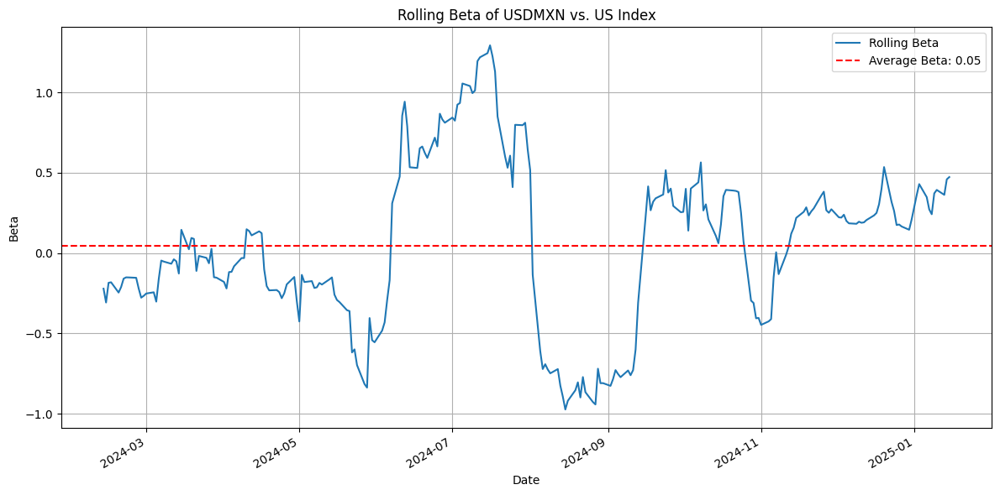

In [ ]:
import pandas as pd
import numpy as np
import yfinance as yf
import matplotlib.pyplot as plt

# Define the start and end dates
start_date = "2024-01-01"
end_date = "2025-12-30"

# Define the list of tickers
tickers = ["DX-Y.NYB", "USDMXN=X"]

# Retrieve the data for each ticker using yfinance
data = yf.download(tickers, start=start_date, end=end_date)["Close"].ffill()

# Calculate the returns with proper handling
returns = data.pct_change(fill_method=None).dropna()

# Define the benchmark for beta calculation (S&P 500)
benchmark = "DX-Y.NYB"

# Rolling window for beta calculation (e.g., 30 days)
rolling_window = 30

# Ensure the benchmark is present
if benchmark in returns.columns:
    # Calculate rolling beta for USDMXN compared to S&P 500
    rolling_beta = returns["USDMXN=X"].rolling(window=rolling_window).cov(returns[benchmark]) / \
                   returns[benchmark].rolling(window=rolling_window).var()

    # Calculate average Beta over the period
    average_beta = rolling_beta.mean()

    # Plot the rolling beta
    plt.figure(figsize=(12, 6))
    rolling_beta.plot(title='Rolling Beta of USDMXN vs. US Index', label='Rolling Beta')
    plt.axhline(y=average_beta, color='r', linestyle='--', label=f'Average Beta: {average_beta:.2f}')
    plt.xlabel('Date')
    plt.ylabel('Beta')
    plt.legend()
    plt.grid()
    plt.tight_layout()
    plt.show()
else:
    print(f"Benchmark {benchmark} not found in data.")

In [ ]:
import plotly.graph_objects as go
import yfinance as yf
import pandas as pd
import numpy as np
from prophet import Prophet

# Define start and end dates
start_date = "2019-01-01"
end_date = "2025-12-31"

# Step 1: Download the data for USD/MXN from Yahoo Finance
usdmxn = yf.Ticker("USDMXN=X").history(start=start_date, end=end_date)
usdmxn.reset_index(inplace=True)

# Remove timezone from the Date column
usdmxn['Date'] = usdmxn['Date'].dt.tz_localize(None)

# Prepare data for Prophet
prophet_data = usdmxn[['Date', 'Close']].rename(columns={'Date': 'ds', 'Close': 'y'})

# Train the Prophet model
model = Prophet()
model.fit(prophet_data)

# Step 2: Create future dataframe for predictions
future = model.make_future_dataframe(periods=12 * 30, freq='D')  # Forecast 12 months daily
forecast = model.predict(future)

# Step 3: Calculate historical deviations
historical_deviation = usdmxn.copy()
historical_deviation['Deviation'] = usdmxn['Close'] - forecast.loc[:len(usdmxn) - 1, 'yhat'].values
historical_std = historical_deviation['Deviation'].std()

# Define historical deviation bands with different shades of gray
deviation_bands = [
    (
        forecast['yhat'] - i * historical_std,
        forecast['yhat'] + i * historical_std,
        f"±{i} Std Dev",
        color
    )
    for i, color in zip(
        range(1, 4),
        [
            'rgba(200, 200, 200, 1)',  # Light gray for ±1 Std Dev
            'rgba(150, 150, 150, 1)',  # Medium gray for ±2 Std Dev
            'rgba(100, 100, 100, 1)'   # Dark gray for ±3 Std Dev
        ]
    )
]

# Step 4: Create data for forecast fan chart
quantile_ranges = [0.05, 0.1, 0.2, 0.3, 0.4, 0.5]
fan_chart_data = []
fan_colors = [
    'rgba(204, 229, 255, 0.2)',  # Light blue
    'rgba(153, 204, 255, 0.2)',
    'rgba(102, 178, 255, 0.2)',
    'rgba(51, 153, 255, 0.2)',
    'rgba(0, 128, 255, 0.2)',
    'rgba(0, 102, 255, 0.2)'     # Darker blue
]

for q, color in zip(quantile_ranges, fan_colors):
    lower = forecast['yhat'] - (forecast['yhat_upper'] - forecast['yhat']) * q
    upper = forecast['yhat'] + (forecast['yhat_upper'] - forecast['yhat']) * q
    fan_chart_data.append((lower, upper, q, color))

# Step 5: Create a Plotly figure
fig = go.Figure()

# Add historical closing prices
fig.add_trace(go.Scatter(
    x=usdmxn['Date'],
    y=usdmxn['Close'],
    mode='lines',
    name='Historical Data',
    line=dict(color='black', width=3)  # Black with more width
))

# Add the central forecast
fig.add_trace(go.Scatter(
    x=forecast['ds'],
    y=forecast['yhat'],
    mode='lines',
    name='Central Forecast',
    line=dict(color='blue', width=2, dash='solid')  # Kept in blue
))

# Add forecast fan chart layers (shaded blue regions)
for lower, upper, q, color in reversed(fan_chart_data):
    fig.add_trace(go.Scatter(
        x=pd.concat([forecast['ds'], forecast['ds'][::-1]]),
        y=pd.concat([upper, lower[::-1]]),
        fill='toself',
        fillcolor=color,
        line=dict(color='rgba(255, 255, 255, 0)'),
        name=f'Fan {int(q * 100)}%',
        showlegend=False  # Optional: Hide individual fan legend entries for clarity
    ))

# Add historical deviation bands as dotted gray lines
for lower, upper, label, color in deviation_bands:
    fig.add_trace(go.Scatter(
        x=forecast['ds'],
        y=lower,
        mode='lines',
        name=f"{label} Lower Bound",
        line=dict(color=color, dash='dot', width=1)
    ))
    fig.add_trace(go.Scatter(
        x=forecast['ds'],
        y=upper,
        mode='lines',
        name=f"{label} Upper Bound",
        line=dict(color=color, dash='dot', width=1)
    ))

# Update layout for better visualization
fig.update_layout(
    title="USD/MXN Forecast Fan Chart with Historical Deviations",
    xaxis_title="Date",
    yaxis_title="Exchange Rate (MXN/USD)",
    legend_title="Legend",
    template="plotly_white",
    width=1200,
    height=700
)

# Show the chart
fig.show()

INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpaux3vsw6/j0l46k0q.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpaux3vsw6/bg6olh3k.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=32220', 'data', 'file=/tmp/tmpaux3vsw6/j0l46k0q.json', 'init=/tmp/tmpaux3vsw6/bg6olh3k.json', 'output', 'file=/tmp/tmpaux3vsw6/prophet_modelukbgdhbs/prophet_model-20250115024119.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
02:41:19 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:41:20 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


In [ ]:
import plotly.graph_objects as go
import yfinance as yf
import pandas as pd
import numpy as np
from prophet import Prophet
import warnings

# Suppress warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

# Define start and end dates
start_date = "2024-01-01"
end_date = "2025-12-30"

# Download the data for USD/MXN from Yahoo Finance
usdmxn = yf.Ticker("USDMXN=X").history(start=start_date, end=end_date)
usdmxn.reset_index(inplace=True)

# Remove timezone from the Date column
usdmxn['Date'] = usdmxn['Date'].dt.tz_localize(None)

# Prepare data for Prophet
prophet_data = usdmxn[['Date', 'Close']].rename(columns={'Date': 'ds', 'Close': 'y'})

# Train the Prophet model with a wider uncertainty interval
model = Prophet(interval_width=0.99)  # Increase to 99% interval width
model.fit(prophet_data)

# Create future dataframe for predictions
future = model.make_future_dataframe(periods=90)  # Forecast 90 days ahead
forecast = model.predict(future)

# Resample for weekly and monthly intervals
weekly_stats = usdmxn.resample('W-Mon', on='Date').agg({'Close': 'last'})
monthly_stats = usdmxn.resample('M', on='Date').agg({'Close': 'last'})

# Create a Plotly figure
fig = go.Figure()

# Add daily closing prices
fig.add_trace(go.Scatter(
    x=usdmxn['Date'],
    y=usdmxn['Close'],
    mode='lines',
    name='Daily Close',
    line=dict(color='blue')
))

# Add weekly closing prices
fig.add_trace(go.Scatter(
    x=weekly_stats.reset_index()['Date'],
    y=weekly_stats['Close'],
    mode='lines+markers',
    name='Weekly Close',
    line=dict(color='orange')
))

# Add monthly closing prices
fig.add_trace(go.Scatter(
    x=monthly_stats.reset_index()['Date'],
    y=monthly_stats['Close'],
    mode='lines+markers',
    name='Monthly Close',
    line=dict(color='green')
))

# Add Prophet forecast
fig.add_trace(go.Scatter(
    x=forecast['ds'],
    y=forecast['yhat'],
    mode='lines',
    name='Prophet Forecast',
    line=dict(color='cyan', dash='dot')
))

# Add confidence intervals from Prophet with wider uncertainty
fig.add_trace(go.Scatter(
    x=pd.concat([forecast['ds'], forecast['ds'][::-1]]),
    y=pd.concat([forecast['yhat_upper'], forecast['yhat_lower'][::-1]]),
    fill='toself',
    fillcolor='rgba(173, 216, 230, 0.3)',  # More transparent shade for confidence band
    line=dict(color='rgba(255,255,255,0)'),  # Invisible boundary for better visuals
    name='Confidence Interval (99%)'
))


# Update layout for better visualization
fig.update_layout(
    title="USD/MXN Forecasts with Prophet (Wider Confidence Intervals)",
    xaxis_title="Date",
    yaxis_title="Closing Price (MXN)",
    legend_title="Frequency",
    template="plotly_dark",
    width=1200,
    height=700
)

# Display the figure
fig.show()

INFO:prophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:prophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.
DEBUG:cmdstanpy:input tempfile: /tmp/tmpaux3vsw6/1ez75gzx.json
DEBUG:cmdstanpy:input tempfile: /tmp/tmpaux3vsw6/eigqg_f5.json
DEBUG:cmdstanpy:idx 0
DEBUG:cmdstanpy:running CmdStan, num_threads: None
DEBUG:cmdstanpy:CmdStan args: ['/usr/local/lib/python3.11/dist-packages/prophet/stan_model/prophet_model.bin', 'random', 'seed=25371', 'data', 'file=/tmp/tmpaux3vsw6/1ez75gzx.json', 'init=/tmp/tmpaux3vsw6/eigqg_f5.json', 'output', 'file=/tmp/tmpaux3vsw6/prophet_modelno_je9y7/prophet_model-20250115025229.csv', 'method=optimize', 'algorithm=lbfgs', 'iter=10000']
02:52:29 - cmdstanpy - INFO - Chain [1] start processing
INFO:cmdstanpy:Chain [1] start processing
02:52:29 - cmdstanpy - INFO - Chain [1] done processing
INFO:cmdstanpy:Chain [1] done processing


In [ ]:
!pip install pmdarima

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.2/2.2 MB 23.8 MB/s eta 0:00:00


In [ ]:
import numpy as np
import pandas as pd
import yfinance as yf
import plotly.graph_objects as go
from pmdarima import auto_arima
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.holtwinters import ExponentialSmoothing
import warnings

# Suppress warnings
warnings.filterwarnings("ignore")

# Step 1: Download and Prepare the Data
start_date = "2019-01-01"
end_date = "2025-12-30"
usdmxn = yf.Ticker("USDMXN=X").history(start=start_date, end=end_date)
usdmxn.reset_index(inplace=True)
usdmxn['Date'] = pd.to_datetime(usdmxn['Date'])

# Resample data for weekly and monthly intervals
weekly_stats = usdmxn.resample('W-Mon', on='Date').mean()
monthly_stats = usdmxn.resample('M', on='Date').mean()

# Step 2: Forecast Functions for Each Model
def auto_arima_forecast(data, steps):
    model = auto_arima(
        data,
        seasonal=False,
        stepwise=True,
        suppress_warnings=True,
        max_p=5,
        max_q=5,
        max_d=2,
        trace=True
    )
    forecast = model.predict(n_periods=steps)
    return forecast, model

def sarima_forecast(data, order, seasonal_order, steps):
    model = SARIMAX(data, order=order, seasonal_order=seasonal_order).fit()
    forecast = model.forecast(steps=steps)
    return forecast, model

def hw_forecast(data, trend, seasonal, seasonal_periods, steps):
    model = ExponentialSmoothing(data, trend=trend, seasonal=seasonal, seasonal_periods=seasonal_periods).fit()
    forecast = model.forecast(steps=steps)
    return forecast, model

# Step 3: Generate Forecasts for Daily, Weekly, and Monthly Timeframes
# ARIMA Forecasts
daily_forecast_arima, daily_arima_model = auto_arima_forecast(usdmxn['Close'], steps=90)
weekly_forecast_arima, weekly_arima_model = auto_arima_forecast(weekly_stats['Close'], steps=12)
monthly_forecast_arima, monthly_arima_model = auto_arima_forecast(monthly_stats['Close'], steps=3)

# SARIMA Forecasts
daily_forecast_sarima, daily_sarima_model = sarima_forecast(usdmxn['Close'], order=(2, 1, 2), seasonal_order=(1, 1, 1, 12), steps=90)
weekly_forecast_sarima, weekly_sarima_model = sarima_forecast(weekly_stats['Close'], order=(2, 1, 2), seasonal_order=(1, 1, 1, 12), steps=12)
monthly_forecast_sarima, monthly_sarima_model = sarima_forecast(monthly_stats['Close'], order=(2, 1, 2), seasonal_order=(1, 1, 1, 12), steps=3)

# Holt-Winters Forecasts
daily_forecast_hw, daily_hw_model = hw_forecast(usdmxn['Close'], trend="add", seasonal="add", seasonal_periods=12, steps=90)
weekly_forecast_hw, weekly_hw_model = hw_forecast(weekly_stats['Close'], trend="add", seasonal="add", seasonal_periods=12, steps=12)
monthly_forecast_hw, monthly_hw_model = hw_forecast(monthly_stats['Close'], trend="add", seasonal="add", seasonal_periods=12, steps=3)

# Step 4: Align Forecasts with Last Observations
# Align daily forecasts
daily_forecast_arima[0] = usdmxn['Close'].iloc[-1]
daily_forecast_sarima[0] = usdmxn['Close'].iloc[-1]
daily_forecast_hw[0] = usdmxn['Close'].iloc[-1]

# Align weekly forecasts
weekly_forecast_arima[0] = weekly_stats['Close'].iloc[-1]
weekly_forecast_sarima[0] = weekly_stats['Close'].iloc[-1]
weekly_forecast_hw[0] = weekly_stats['Close'].iloc[-1]

# Align monthly forecasts
monthly_forecast_arima[0] = monthly_stats['Close'].iloc[-1]
monthly_forecast_sarima[0] = monthly_stats['Close'].iloc[-1]
monthly_forecast_hw[0] = monthly_stats['Close'].iloc[-1]

# Step 5: Generate Future Dates Starting Immediately After Last Observation
# For daily data
future_daily_dates = pd.date_range(start=usdmxn['Date'].iloc[-1], periods=90, freq='D')

# For weekly data
future_weekly_dates = pd.date_range(start=weekly_stats.index[-1], periods=12, freq='W-MON')

# For monthly data
future_monthly_dates = pd.date_range(start=monthly_stats.index[-1], periods=3, freq='M')

# Step 6: Visualization for All Models
fig = go.Figure()

# Historical Data
fig.add_trace(go.Scatter(x=usdmxn['Date'], y=usdmxn['Close'], mode='lines', name='Daily Close', line=dict(color='blue')))
fig.add_trace(go.Scatter(x=weekly_stats.reset_index()['Date'], y=weekly_stats['Close'], mode='lines+markers', name='Weekly Close', line=dict(color='orange')))
fig.add_trace(go.Scatter(x=monthly_stats.reset_index()['Date'], y=monthly_stats['Close'], mode='lines+markers', name='Monthly Close', line=dict(color='green')))

# ARIMA Forecasts
fig.add_trace(go.Scatter(x=future_daily_dates, y=daily_forecast_arima, mode='lines', name='ARIMA Daily', line=dict(dash='dot', color='cyan')))
fig.add_trace(go.Scatter(x=future_weekly_dates, y=weekly_forecast_arima, mode='lines+markers', name='ARIMA Weekly', line=dict(dash='dot', color='cyan')))
fig.add_trace(go.Scatter(x=future_monthly_dates, y=monthly_forecast_arima, mode='lines+markers', name='ARIMA Monthly', line=dict(dash='dot', color='cyan')))

# SARIMA Forecasts
fig.add_trace(go.Scatter(x=future_daily_dates, y=daily_forecast_sarima, mode='lines', name='SARIMA Daily', line=dict(dash='dot', color='magenta')))
fig.add_trace(go.Scatter(x=future_weekly_dates, y=weekly_forecast_sarima, mode='lines+markers', name='SARIMA Weekly', line=dict(dash='dot', color='magenta')))
fig.add_trace(go.Scatter(x=future_monthly_dates, y=monthly_forecast_sarima, mode='lines+markers', name='SARIMA Monthly', line=dict(dash='dot', color='magenta')))

# Holt-Winters Forecasts
fig.add_trace(go.Scatter(x=future_daily_dates, y=daily_forecast_hw, mode='lines', name='Holt-Winters Daily', line=dict(dash='dot', color='yellow')))
fig.add_trace(go.Scatter(x=future_weekly_dates, y=weekly_forecast_hw, mode='lines+markers', name='Holt-Winters Weekly', line=dict(dash='dot', color='yellow')))
fig.add_trace(go.Scatter(x=future_monthly_dates, y=monthly_forecast_hw, mode='lines+markers', name='Holt-Winters Monthly', line=dict(dash='dot', color='yellow')))

# Update Layout
fig.update_layout(
    title="USD/MXN Forecasts: Daily, Weekly, and Monthly (Seamless)",
    xaxis_title="Date",
    yaxis_title="Closing Price (MXN)",
    legend_title="Model",
    template="plotly_dark",
    width=1200,
    height=700
)

fig.show()

In [ ]:
import yfinance as yf
import plotly.graph_objects as go
from sklearn.ensemble import IsolationForest
import pandas as pd

# Define start and end dates
start_date = "2022-01-01"
end_date = "2025-12-10"

# Fetch S&P 500 data for daily timeframe
sp500_data = yf.Ticker("USDMXN=X").history(start=start_date, end=end_date, interval="1d")

# Fill missing values for 'Close' to ensure no NaNs
sp500_data['Close'] = sp500_data['Close'].ffill()

# Define thresholds for multiple anomaly classifications
thresholds = [0.45, 0.10, 0.05, 0.02]  # Contamination levels
colors = ['gray', 'yellow', 'orange', 'red']  # Colors for each threshold
categories = ['45% (Common)', '10% (Moderate)', '5% (High)', '2% (Extreme)']  # Category names

# Create a combined DataFrame for all anomalies
all_anomalies = pd.DataFrame()

# Iterate over each threshold to detect anomalies
for i, contamination in enumerate(thresholds):
    # Apply Isolation Forest for anomaly detection
    isolation_forest = IsolationForest(contamination=contamination, random_state=42)
    isolation_forest.fit(sp500_data[['Close']].to_numpy())

    # Predict anomalies
    sp500_data[f'anomalies_{i}'] = isolation_forest.predict(sp500_data[['Close']].to_numpy())
    sp500_data[f'scores_{i}'] = isolation_forest.decision_function(sp500_data[['Close']].to_numpy())

    # Extract anomalies
    anomalies = sp500_data[sp500_data[f'anomalies_{i}'] == -1].copy()
    anomalies['Category'] = categories[i]  # Assign category name
    anomalies['Color'] = colors[i]  # Assign color
    anomalies['Label'] = anomalies.apply(
        lambda row: f"Date: {row.name.strftime('%Y-%m-%d')}<br>Close: {row['Close']:.2f}<br>Score: {row[f'scores_{i}']:.2f}",
        axis=1
    )

    # Combine anomalies into a single DataFrame
    all_anomalies = pd.concat([all_anomalies, anomalies])

# Create a Plotly figure for Close prices
fig = go.Figure()

# Add the Close prices as a line plot
fig.add_trace(go.Scatter(
    x=sp500_data.index,
    y=sp500_data['Close'],
    mode='lines',
    name='USD/MXN Close Prices / Anomalies',
    line=dict(color='blue')
))

# Add anomalies for each threshold as separate scatter traces
# Plot higher anomalies (e.g., 45%) first, then lower ones (e.g., 2%) to ensure lower anomalies are visible
for category, color in zip(categories, colors):
    category_data = all_anomalies[all_anomalies['Category'] == category]
    fig.add_trace(go.Scatter(
        x=category_data.index,
        y=category_data['Close'],
        mode='markers',
        name=f'{category} Anomalies',
        marker=dict(color=color, size=10, line=dict(color='black', width=1)),
        text=category_data['Label'],
        hoverinfo='text'
    ))

# Update the layout for the chart
fig.update_layout(
    title='Close Prices with Anomalies (2%, 5%, 10%, 45%)',
    xaxis_title='Date',
    yaxis_title='Price',
    legend_title='Legend',
    width=1200,
    height=700
)

# Display the plot
fig.show()

In [ ]:
!pip install kneed

In [ ]:
import yfinance as yf
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans
from kneed import KneeLocator
import plotly.graph_objects as go
import plotly.express as px

# Fetch S&P 500 data
sp500 = yf.Ticker("USDMXN=X").history(start="2024-01-01", end="2025-12-30")

# Define moving averages
moving_averages = [2, 5, 10, 20, 30, 40, 50, 100, 200]

# Calculate moving averages and the difference between price and each MA
for ma in moving_averages:
    sp500[f'{ma}d_MA'] = sp500['Close'].rolling(window=ma).mean()
    sp500[f'Price_{ma}d_MA_Diff'] = sp500['Close'] - sp500[f'{ma}d_MA']

# Prepare features for K-NN clustering
features = sp500[[f'Price_{ma}d_MA_Diff' for ma in moving_averages]].abs()
features.dropna(inplace=True)

# Finding the optimal number of clusters using the elbow method
inertia = []
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, n_init=10, random_state=42).fit(features)
    inertia.append(kmeans.inertia_)

k_optimal = KneeLocator(range(1, 10), inertia, curve='convex', direction='decreasing').knee

# Perform KMeans clustering
kmeans = KMeans(n_clusters=k_optimal, n_init=10, random_state=42)
clusters = kmeans.fit_predict(features)

# Add cluster information to the original DataFrame
sp500 = sp500.loc[features.index]
sp500['Cluster'] = clusters

# Calculate the centroids of the clusters
centroids = kmeans.cluster_centers_

# Initialize the market state classification dictionary
market_states = {}

# Determine the lowest, highest, and average centroid values
mean_centroid_value = np.mean([np.mean(centroid) for centroid in centroids])
lowest_centroid_value = np.min([np.mean(centroid) for centroid in centroids])
highest_centroid_value = np.max([np.mean(centroid) for centroid in centroids])

# Classify clusters based on the centroid values
for i, centroid in enumerate(centroids):
    avg_difference = np.mean(centroid)

    # Classify as Momentum if the average difference is the highest
    if avg_difference == highest_centroid_value:
        market_states[i] = 'Momentum'

    # Classify as Mean Reversion if the average difference is the lowest
    elif avg_difference == lowest_centroid_value:
        market_states[i] = 'Mean Reversion'

    # Otherwise, classify as Neutral (near average difference)
    else:
        market_states[i] = 'Neutral'

# Print the market state classification for each cluster
print("Market States by Cluster:", market_states)

# Plotting the clusters with Plotly
fig = go.Figure()

# Plot clusters and assign colors based on market states
state_colors = {'Momentum': 'red', 'Mean Reversion': 'green', 'Neutral': 'blue'}

for cluster in range(k_optimal):
    cluster_periods = sp500['Cluster'] == cluster
    label = market_states.get(cluster, 'Unknown')

    fig.add_trace(go.Scatter(
        x=sp500.index[cluster_periods],
        y=sp500['Close'][cluster_periods],
        mode='markers',
        name=f'Cluster {cluster}: {label}',
        marker=dict(size=6, color=state_colors[label], opacity=0.7)
    ))

# Update the layout of the scatter plot
fig.update_layout(
    title="USD/MXN Price with K-Means Cluster Trends",
    xaxis_title="Date",
    yaxis_title="Price",
    legend_title="Clusters",
    width=1000,
    height=600
)

fig.show()

# Plot histograms of MA differences for each cluster using Plotly
hist_fig = go.Figure()

for cluster in range(k_optimal):
    label = market_states.get(cluster, 'Unknown')
    hist_fig.add_trace(go.Histogram(
        x=sp500[f'Price_{20}d_MA_Diff'][sp500['Cluster'] == cluster],
        nbinsx=50,
        opacity=0.5,
        name=f'Cluster {cluster}: {label}',
        marker_color=state_colors[label]
    ))

# Update the layout of the histogram
hist_fig.update_layout(
    title="Distribution of 20-day MA Differences for Clusters",
    xaxis_title="20-day MA Difference",
    yaxis_title="Frequency",
    barmode='overlay',
    width=1000,
    height=600
)

hist_fig.show()

Market States by Cluster: {0: 'Mean Reversion', 1: 'Neutral', 2: 'Momentum'}


In [ ]:
import yfinance as yf
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans
from kneed import KneeLocator
import plotly.graph_objects as go
import plotly.express as px

# Fetch S&P 500 data
sp500 = yf.Ticker("USDMXN=X").history(start="2021-01-01", end="2025-12-30")

# Define moving averages
moving_averages = [2, 5, 10, 20, 30, 40, 50, 100, 200]

# Calculate moving averages and the difference between price and each MA
for ma in moving_averages:
    sp500[f'{ma}d_MA'] = sp500['Close'].rolling(window=ma).mean()
    sp500[f'Price_{ma}d_MA_Diff'] = sp500['Close'] - sp500[f'{ma}d_MA']

# Prepare features for K-NN clustering
features = sp500[[f'Price_{ma}d_MA_Diff' for ma in moving_averages]].abs()
features.dropna(inplace=True)

# Finding the optimal number of clusters using the elbow method
inertia = []
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, n_init=10, random_state=42).fit(features)
    inertia.append(kmeans.inertia_)

k_optimal = KneeLocator(range(1, 10), inertia, curve='convex', direction='decreasing').knee

# Perform KMeans clustering
kmeans = KMeans(n_clusters=k_optimal, n_init=10, random_state=42)
clusters = kmeans.fit_predict(features)

# Add cluster information to the original DataFrame
sp500 = sp500.loc[features.index]
sp500['Cluster'] = clusters

# Calculate the centroids of the clusters
centroids = kmeans.cluster_centers_

# Initialize the market state classification dictionary
market_states = {}

# Determine the lowest, highest, and average centroid values
mean_centroid_value = np.mean([np.mean(centroid) for centroid in centroids])
lowest_centroid_value = np.min([np.mean(centroid) for centroid in centroids])
highest_centroid_value = np.max([np.mean(centroid) for centroid in centroids])

# Classify clusters based on the centroid values
for i, centroid in enumerate(centroids):
    avg_difference = np.mean(centroid)

    # Classify as Momentum if the average difference is the highest
    if avg_difference == highest_centroid_value:
        market_states[i] = 'Momentum'

    # Classify as Mean Reversion if the average difference is the lowest
    elif avg_difference == lowest_centroid_value:
        market_states[i] = 'Mean Reversion'

    # Otherwise, classify as Neutral (near average difference)
    else:
        market_states[i] = 'Neutral'

# Print the market state classification for each cluster
print("Market States by Cluster:", market_states)

# Plotting the clusters with Plotly
fig = go.Figure()

# Plot clusters and assign colors based on market states
state_colors = {'Momentum': 'red', 'Mean Reversion': 'green', 'Neutral': 'blue'}

for cluster in range(k_optimal):
    cluster_periods = sp500['Cluster'] == cluster
    label = market_states.get(cluster, 'Unknown')

    fig.add_trace(go.Scatter(
        x=sp500.index[cluster_periods],
        y=sp500['Close'][cluster_periods],
        mode='markers',
        name=f'Cluster {cluster}: {label}',
        marker=dict(size=6, color=state_colors[label], opacity=0.7)
    ))

# Add a black line connecting all closing prices
fig.add_trace(go.Scatter(
    x=sp500.index,
    y=sp500['Close'],
    mode='lines',
    name='Closing Price Trend',
    line=dict(color='black', width=0.5)
))

# Update the layout of the scatter plot
fig.update_layout(
    title="USD/MXN Price with K-Means Cluster Trends",
    xaxis_title="Date",
    yaxis_title="Price",
    legend_title="Clusters",
    width=1000,
    height=600
)

fig.show()

# Plot histograms of MA differences for each cluster using Plotly
hist_fig = go.Figure()

for cluster in range(k_optimal):
    label = market_states.get(cluster, 'Unknown')
    hist_fig.add_trace(go.Histogram(
        x=sp500[f'Price_{20}d_MA_Diff'][sp500['Cluster'] == cluster],
        nbinsx=50,
        opacity=0.5,
        name=f'Cluster {cluster}: {label}',
        marker_color=state_colors[label]
    ))

# Update the layout of the histogram
hist_fig.update_layout(
    title="Distribution of 20-day MA Differences for Clusters",
    xaxis_title="20-day MA Difference",
    yaxis_title="Frequency",
    barmode='overlay',
    width=1000,
    height=600
)

hist_fig.show()


Market States by Cluster: {0: 'Neutral', 1: 'Momentum', 2: 'Mean Reversion'}


In [ ]:
import yfinance as yf
import pandas as pd
import plotly.graph_objects as go

# Fetch data for the currency pair
currency_pair = yf.Ticker("USDMXN=X").history(start="2024-01-01", end="2025-10-04")

# Calculate absolute returns and their absolute values
currency_pair['Returns'] = currency_pair['Close'].pct_change()
currency_pair['AbsReturns'] = abs(currency_pair['Returns'])

# Calculate 5-day rolling volatility (standard deviation of returns)
currency_pair['Volatility'] = currency_pair['Returns'].rolling(window=5).std()

# Calculate daily range (High - Low) and normalize for size
currency_pair['DailyRange'] = currency_pair['High'] - currency_pair['Low']
currency_pair['Normalized_Range'] = 5 + (50 * (currency_pair['DailyRange'] / currency_pair['DailyRange'].max()))

# Normalize volatility for color scaling
currency_pair['Normalized_Volatility'] = currency_pair['Volatility'] / currency_pair['Volatility'].max()

# Fill NaN values with defaults for visibility and continuity
currency_pair['Normalized_Range'] = currency_pair['Normalized_Range'].fillna(5)
currency_pair['Normalized_Volatility'] = currency_pair['Normalized_Volatility'].fillna(0)  # Assuming minimum volatility where NaN

# Create a scatter plot using the normalized volatility for color and normalized range for marker size
fig = go.Figure()

# Add the scatter plot trace for volatility and daily range
fig.add_trace(go.Scatter(x=currency_pair.index, y=currency_pair['Close'], mode='markers',
                         marker=dict(size=currency_pair['Normalized_Range'],
                                     color=currency_pair['Normalized_Volatility'],
                                     colorscale='Viridis',
                                     colorbar=dict(title='Volatility', x=1.02),
                                     showscale=True),
                         name='FX Emerging Close'))

# Add the closing price trend line in black with a smaller width
fig.add_trace(go.Scatter(x=currency_pair.index, y=currency_pair['Close'], mode='lines',
                         line=dict(color='black', width=1),
                         name='Closing Price Trend'))

# Update layout for a larger figure size and add titles
fig.update_layout(height=800, width=1200,
                  title_text="Currency Pair Price Visualization Influenced by 5-Day Rolling Volatility and Daily Price Range",
                  xaxis_title="Date", yaxis_title="Close Price", legend_title="Legend",
                  margin=dict(l=20, r=20, t=100, b=20),
                  legend=dict(yanchor="top", y=1.20, xanchor="left", x=0.85))

# Show the plot
fig.show()

In [ ]:
import numpy as np
import yfinance as yf
import pandas as pd
import plotly.graph_objects as go
from sklearn.metrics import r2_score

# Function to scale sizes
def scale_sizes(size_map, scale_factor):
    return {key: value * scale_factor for key, value in size_map.items()}

# Define start and end dates
start_date = "2023-01-01"
end_date = "2025-12-31"

# Fetch USDMXN data for daily timeframe
usdmxn_daily = yf.Ticker("USDMXN=X").history(start=start_date, end=end_date, interval="1d")

# Calculate daily returns and absolute returns
usdmxn_daily['Returns'] = usdmxn_daily['Close'].pct_change()
usdmxn_daily['AbsReturns'] = abs(usdmxn_daily['Returns'])

# Calculate 5-day rolling volatility (standard deviation of returns)
usdmxn_daily['Volatility'] = usdmxn_daily['Returns'].rolling(window=5).std()

# Classify volatility into quantiles: 'Very High' as top 5% and remaining into 4 quantiles
volatility_threshold = usdmxn_daily['Volatility'].quantile(0.95)  # 95th percentile
usdmxn_daily['Volatility Category'] = pd.cut(usdmxn_daily['Volatility'],
                                             bins=[0, usdmxn_daily['Volatility'].quantile(0.20), usdmxn_daily['Volatility'].quantile(0.40),
                                                   usdmxn_daily['Volatility'].quantile(0.60), usdmxn_daily['Volatility'].quantile(0.80),
                                                   volatility_threshold, usdmxn_daily['Volatility'].max()],
                                             labels=["Very Low", "Low", "Medium", "High", "Upper High", "Very High"])

# Map volatility categories to specific sizes and shapes
size_map = {"Very Low": 4, "Low": 8, "Medium": 12, "High": 16, "Upper High": 18, "Very High": 20}
shape_map = {"Very Low": 'circle', "Low": 'square', "Medium": 'triangle-up', "High": 'cross', "Upper High": 'pentagon', "Very High": 'diamond'}

# Select six contrasting colors
colors = ['rgb(255, 0, 0)', 'rgb(0, 255, 0)', 'rgb(0, 0, 255)', 'rgb(255, 255, 0)', 'rgb(255, 165, 0)', 'rgb(128, 0, 128)']  # Red, Green, Blue, Yellow, Orange, Purple

# Scale factor for sizes (adjust this to make markers larger or smaller)
scale_factor = 0.90
scaled_size_map = scale_sizes(size_map, scale_factor)

# Calculate various moving averages for trend lines
usdmxn_daily['MA5'] = usdmxn_daily['Close'].rolling(window=5).mean()  # Adjusted for daily timeframe
usdmxn_daily['MA10'] = usdmxn_daily['Close'].rolling(window=10).mean()  # Adjusted for daily timeframe
usdmxn_daily['MA21'] = usdmxn_daily['Close'].rolling(window=21).mean()  # Adjusted for daily timeframe

# Create a Plotly scatter plot for the daily data
fig_daily = go.Figure()

# Iterate over each volatility category to create separate traces
for idx, category in enumerate(["Very Low", "Low", "Medium", "High", "Upper High", "Very High"]):
    category_data = usdmxn_daily[usdmxn_daily['Volatility Category'] == category]
    fig_daily.add_trace(go.Scatter(
        x=category_data.index,
        y=category_data['Close'],
        mode='markers',
        marker=dict(
            color=colors[idx],
            size=scaled_size_map[category],
            opacity=0.7,
            symbol=shape_map[category]
        ),
        name=f'Volatility: {category}'
    ))

# Add moving average lines with dotted style
fig_daily.add_trace(go.Scatter(
    x=usdmxn_daily.index,
    y=usdmxn_daily['MA5'],
    line=dict(color='cyan', width=2, dash='dot'),
    name='5-day MA (dotted)'
))
fig_daily.add_trace(go.Scatter(
    x=usdmxn_daily.index,
    y=usdmxn_daily['MA10'],
    line=dict(color='magenta', width=2, dash='dot'),
    name='10-day MA (dotted)'
))
fig_daily.add_trace(go.Scatter(
    x=usdmxn_daily.index,
    y=usdmxn_daily['MA21'],
    line=dict(color='lime', width=2, dash='dot'),
    name='21-day MA (dotted)'
))

# Convert the index (date) to a numerical format for regression analysis
x_values = np.array([i for i in range(len(usdmxn_daily.index))])
y_values = usdmxn_daily['Close'].values

# Linear regression
slope, intercept = np.polyfit(x_values, y_values, 1)
linear_trendline = intercept + slope * x_values
linear_r2 = r2_score(y_values, linear_trendline)

# Polynomial regression (5th degree for more complexity)
poly_coeffs = np.polyfit(x_values, y_values, 8)
poly_trendline = np.polyval(poly_coeffs, x_values)
poly_r2 = r2_score(y_values, poly_trendline)

# Add the linear trendline to the plot
fig_daily.add_trace(go.Scatter(
    x=usdmxn_daily.index,
    y=linear_trendline,
    mode='lines',
    name=f'Linear Trendline (R²={linear_r2:.2f})',
    line=dict(color='red', width=3)
))

# Add the polynomial trendline to the plot
fig_daily.add_trace(go.Scatter(
    x=usdmxn_daily.index,
    y=poly_trendline,
    mode='lines',
    name=f'Polynomial Trendline (R²={poly_r2:.2f})',
    line=dict(color='blue', width=2)
))

# Update layout for a larger figure size with contrasting background
fig_daily.update_layout(
    title='USDMXN Prices with Volatility Quantiles and Moving Averages (Daily Timeframe)',
    xaxis_title='Date',
    yaxis_title='Closing Price',
    legend_title='Legend',
    width=1500,  # Width of the figure in pixels
    height=900,  # Height of the figure in pixels
    plot_bgcolor='gray',  # Gray background for contrast
    paper_bgcolor='black',
    font_color='white'
)

# Display the plot
fig_daily.show()

In [ ]:
import yfinance as yf
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Define start and end dates
start_date = "2024-01-01"
end_date = "2024-12-31"

# Fetch USDMXN data for daily timeframe
usdmxn_data = yf.Ticker("MXN=X").history(start=start_date, end=end_date, interval="1d")

# Check if data is valid
if usdmxn_data.empty:
    print("No data available for the specified date range.")
else:
    # Calculate rolling maximum of closing prices
    rolling_max = usdmxn_data['Close'].cummax()

    # Calculate drawdown as the percentage decline from the peak
    drawdown = (usdmxn_data['Close'] - rolling_max) / rolling_max * 100

    # Identify peaks in closing prices
    peak_indices = usdmxn_data['Close'] == rolling_max

    # Create subplots with shared x-axis
    fig = make_subplots(
        rows=2, cols=1,  # Two rows, one column
        shared_xaxes=True,
        row_heights=[0.75, 0.25],  # Allocate 75% height for prices, 25% for drawdown
        vertical_spacing=0.1  # Space between plots
    )

    # Add the closing prices as a line plot (Top subplot)
    fig.add_trace(go.Scatter(
        x=usdmxn_data.index,
        y=usdmxn_data['Close'],
        mode='lines',
        name='USDMXN Closing Prices',
        line=dict(color='blue')
    ), row=1, col=1)

    # Add dots for the peaks in closing prices
    fig.add_trace(go.Scatter(
        x=usdmxn_data.index[peak_indices],
        y=usdmxn_data['Close'][peak_indices],
        mode='markers',
        name='Precios Maximos',
        marker=dict(color='red', size=11, symbol='triangle-up')  # Different color for peaks
    ), row=1, col=1)

    # Add the drawdown as an area plot with shadow effect (Bottom subplot)
    fig.add_trace(go.Scatter(
        x=usdmxn_data.index,
        y=drawdown,
        mode='lines',
        fill='tozeroy',  # Fill the area under the curve
        name='Apreciaciones (%)',
        line=dict(color='green'),
        opacity=0.5  # Add shadow effect with transparency
    ), row=2, col=1)

    # Update layout for the subplots
    fig.update_layout(
        title='USDMXN - Precio y Apreciaciones (2024) // Jose A. Lizarraga Esquer - GBM FX Payments',
        xaxis=dict(title='Date', titlefont=dict(size=14)),
        yaxis=dict(
            title='Closing Prices',
            titlefont=dict(color='blue'),
            tickfont=dict(color='blue')
        ),
        yaxis2=dict(
            title='Apreciaciones (%)',
            titlefont=dict(color='green'),
            tickfont=dict(color='green')
        ),
        height=800,  # Adjust overall chart height
        template='plotly_white',
        legend=dict(title='Legend', orientation='h', x=0.5, y=-0.15)
    )

    # Display the plot
    fig.show()

[*********************100%***********************]  21 of 21 completed


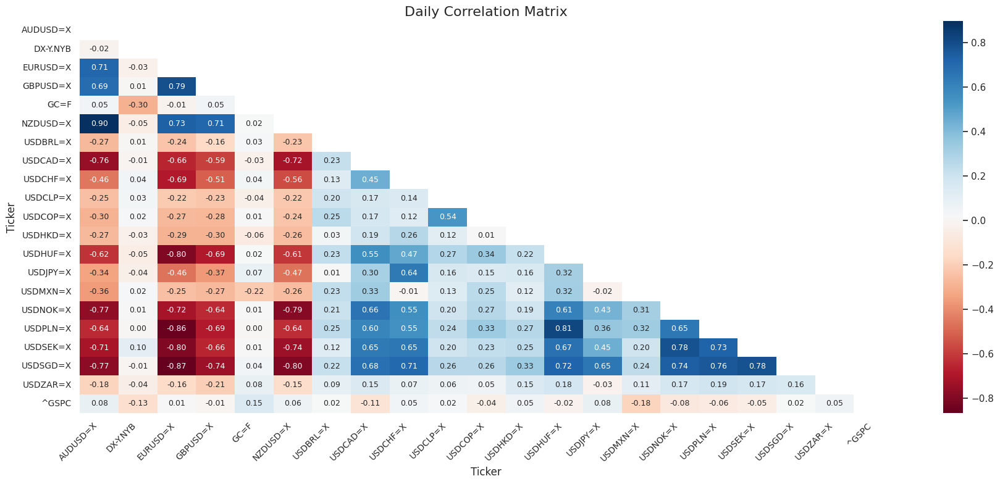

In [ ]:
import pandas as pd
import numpy as np
import yfinance as yf
import warnings
import seaborn as sns
import matplotlib.pyplot as plt

# Suppress future warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

# Define the start and end dates for daily data
daily_start_date = "2024-01-01"
end_date = "2025-12-14"

# Reordering the tickers list based on the specified order
tickers = [
    # Emerging USD FX pairs
    "USDMXN=X", "USDPLN=X", "USDHUF=X", "USDZAR=X", "USDBRL=X",
    "USDCLP=X", "USDCOP=X", "USDSEK=X", "USDNOK=X", "USDSGD=X", "USDHKD=X",

    # Major USD FX pairs
    "EURUSD=X", "GBPUSD=X", "USDJPY=X", "AUDUSD=X", "USDCAD=X",
    "USDCHF=X", "NZDUSD=X",

    # Indices and gold
    "DX-Y.NYB", "GC=F", "^GSPC"
]

# Function to fetch and clean daily data
def fetch_daily_data(tickers, start_date, end_date):
    data = yf.download(tickers, start=start_date, end=end_date, interval='1d')
    if isinstance(data.columns, pd.MultiIndex) and 'Close' in data.columns.levels[0]:  # For multi-level index
        data = data['Close']
    return data.dropna(axis=1, how='all')  # Drop columns with all NaN values

# Fetch historical daily data
daily_data = fetch_daily_data(tickers, daily_start_date, end_date)

# Function to calculate daily correlation matrix
def calculate_daily_correlation(data):
    # Calculate the daily percentage change
    returns = data.pct_change().dropna()
    # Calculate and return the correlation matrix
    return returns.corr()

# Calculate the daily correlation matrix
daily_correlation_matrix = calculate_daily_correlation(daily_data)

# Plotting the daily correlation matrix
sns.set_theme(style="white")
def plot_daily_correlation_matrix(correlation_matrix):
    plt.figure(figsize=(18, 8))
    # Mask the upper triangle of the matrix
    mask = np.triu(np.ones_like(correlation_matrix, dtype=bool))
    sns.heatmap(correlation_matrix, annot=True, fmt=".2f", cmap="RdBu", cbar=True, mask=mask, annot_kws={"size": 9})
    plt.title("Daily Correlation Matrix", fontsize=16)
    plt.xticks(rotation=45, ha='right', fontsize=10)
    plt.yticks(rotation=0, fontsize=10)
    plt.tight_layout()
    plt.show()

# Plot the daily correlation matrix
plot_daily_correlation_matrix(daily_correlation_matrix)

In [ ]:
!pip install kneed

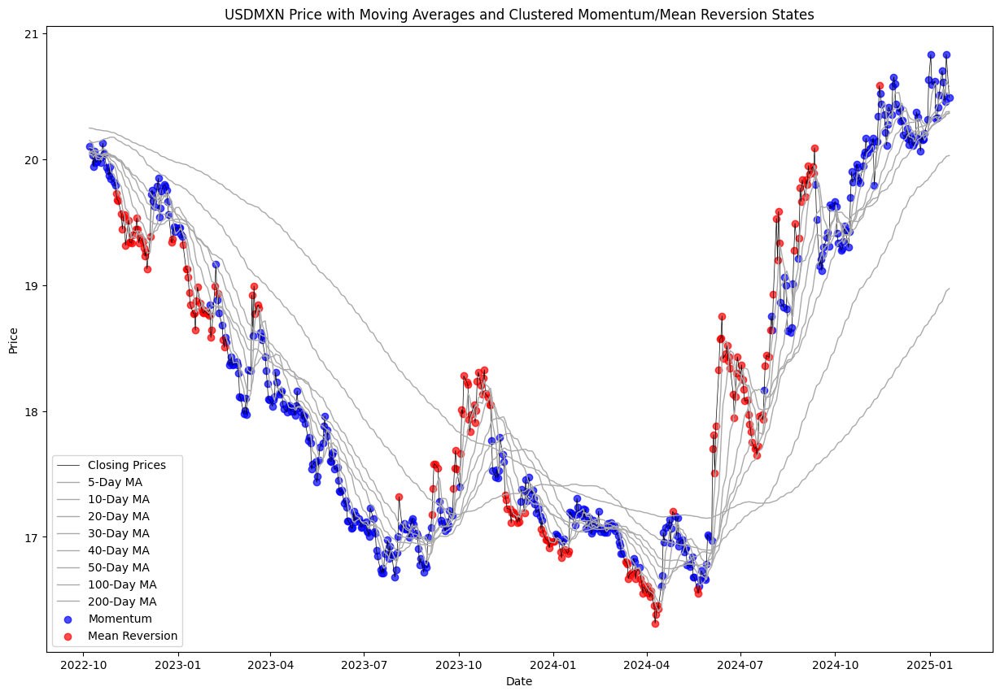

In [ ]:
import yfinance as yf
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import xgboost as xgb
from sklearn.metrics import accuracy_score, classification_report
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from kneed import KneeLocator

# Fetch USDMXN data
usdmxn = yf.Ticker("USDMXN=X").history(start="2022-01-01", end="2025-12-30")

# Define moving averages
moving_averages = [5, 10, 20, 30, 40, 50, 100, 200]

# Calculate moving averages and the difference between price and each MA
for ma in moving_averages:
    usdmxn[f'{ma}d_MA'] = usdmxn['Close'].rolling(window=ma).mean()
    usdmxn[f'Price_{ma}d_MA_Diff'] = usdmxn['Close'] - usdmxn[f'{ma}d_MA']

# Prepare features for classification
features = usdmxn[[f'Price_{ma}d_MA_Diff' for ma in moving_averages]].abs()

# Drop rows with NaN values from both features and usdmxn
features.dropna(inplace=True)
usdmxn = usdmxn.loc[features.index]

# Finding the optimal number of clusters using the elbow method
inertia = []
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, n_init=10, random_state=42).fit(features)
    inertia.append(kmeans.inertia_)

k_optimal = KneeLocator(range(1, 10), inertia, curve='convex', direction='decreasing').knee

# Perform KMeans clustering
kmeans = KMeans(n_clusters=k_optimal * 2, n_init=10, random_state=42)
clusters = kmeans.fit_predict(features)
usdmxn['Cluster'] = clusters

# Define the market states
market_states = {
    0: 'Strong Momentum',
    1: 'Moderate Momentum',
    2: 'Weak Momentum',
    3: 'Strong Mean Reversion',
    4: 'Moderate Mean Reversion',
    5: 'Weak Mean Reversion'
}

# Assign Momentum (Blue) and Mean Reversion (Red) to clusters
usdmxn['State'] = np.where(usdmxn['Cluster'].isin([0, 1, 2]), 'Momentum', 'Mean Reversion')

# Define custom colors for Momentum (Blue) and Mean Reversion (Red)
state_colors = {
    'Momentum': 'blue',
    'Mean Reversion': 'red'
}

# Plotting with cluster trend classification, moving averages, and custom colors
plt.figure(figsize=(15, 10))

# Plot a thin black line connecting the returns
plt.plot(usdmxn.index, usdmxn['Close'], color='black', linewidth=0.5, label='Closing Prices')

# Plot moving averages in dark gray
for ma in moving_averages:
    plt.plot(usdmxn.index, usdmxn[f'{ma}d_MA'], color='darkgray', linewidth=1, label=f'{ma}-Day MA')

# Plot clusters with custom colors
for state in state_colors.keys():
    state_periods = usdmxn['State'] == state
    plt.scatter(
        usdmxn.index[state_periods],
        usdmxn['Close'][state_periods],
        label=state,
        color=state_colors[state],
        alpha=0.7
    )

plt.title('USDMXN Price with Moving Averages and Clustered Momentum/Mean Reversion States')
plt.xlabel('Date')
plt.ylabel('Price')
plt.legend()
plt.show()


Accuracy: 0.95
Classification Report:
              precision    recall  f1-score   support

           0       0.94      0.99      0.96        93
           1       0.98      0.88      0.93        51

    accuracy                           0.95       144
   macro avg       0.96      0.94      0.95       144
weighted avg       0.95      0.95      0.95       144



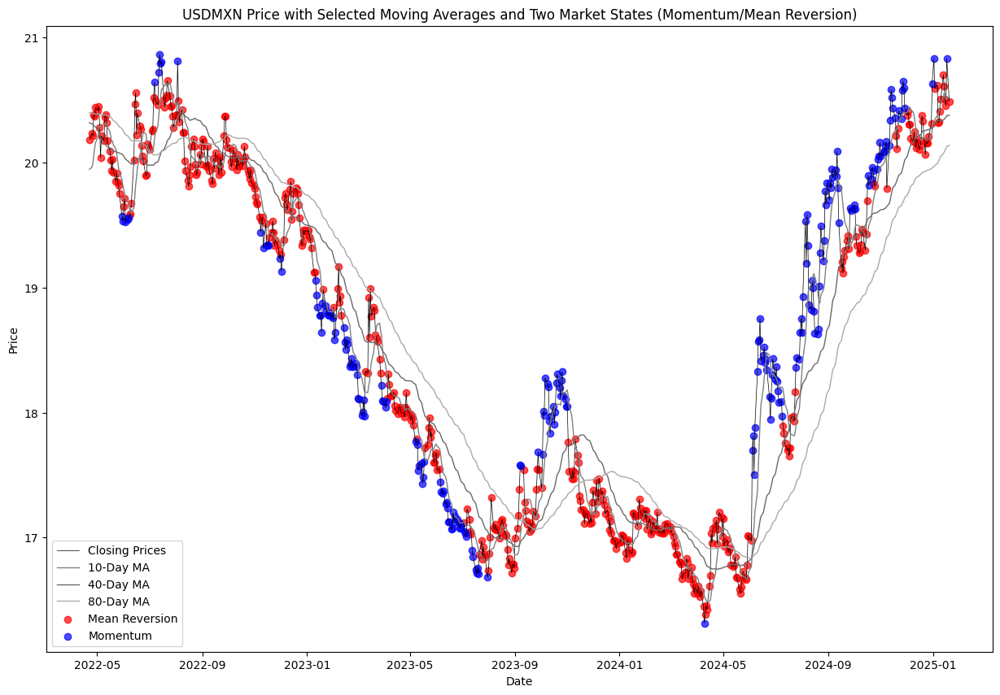

In [ ]:
import yfinance as yf
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import xgboost as xgb
from sklearn.metrics import accuracy_score, classification_report
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from kneed import KneeLocator

# Fetch USDMXN data
usdmxn = yf.Ticker("USDMXN=X").history(start="2022-01-01", end="2025-12-30")

# Define selected moving averages
selected_mas = [10, 40, 80]

# Calculate the selected moving averages and their price differences
for ma in selected_mas:
    usdmxn[f'{ma}d_MA'] = usdmxn['Close'].rolling(window=ma).mean()
    usdmxn[f'Price_{ma}d_MA_Diff'] = usdmxn['Close'] - usdmxn[f'{ma}d_MA']

# Prepare features for classification (only using selected MAs)
features = usdmxn[[f'Price_{ma}d_MA_Diff' for ma in selected_mas]].abs()

# Drop rows with NaN values from both features and usdmxn
features.dropna(inplace=True)
usdmxn = usdmxn.loc[features.index]

# Finding the optimal number of clusters using the elbow method
inertia = []
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, n_init=10, random_state=42).fit(features)
    inertia.append(kmeans.inertia_)

k_optimal = KneeLocator(range(1, 10), inertia, curve='convex', direction='decreasing').knee

# Perform KMeans clustering with 2 clusters
kmeans = KMeans(n_clusters=2, n_init=10, random_state=42)
clusters = kmeans.fit_predict(features)
usdmxn['Cluster'] = clusters

# Determine which cluster corresponds to which state
cluster_means = features.groupby(usdmxn['Cluster']).mean().mean(axis=1)
mean_reversion_cluster = cluster_means.idxmin()  # Cluster with smaller mean differences → Mean Reversion
momentum_cluster = cluster_means.idxmax()  # Cluster with larger mean differences → Momentum

# Define the target labels
usdmxn['Target'] = np.where(usdmxn['Cluster'] == mean_reversion_cluster, 'Mean Reversion', 'Momentum')

# Encode the target labels to integers
label_encoder = LabelEncoder()
usdmxn['Target'] = label_encoder.fit_transform(usdmxn['Target'])

# Split the data into training and testing sets
X = features.values
y = usdmxn['Target'].values
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train an XGBoost classifier
model = xgb.XGBClassifier()
model.fit(X_train, y_train)

# Make predictions
y_pred = model.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
classification_rep = classification_report(y_test, y_pred)

print(f'Accuracy: {accuracy:.2f}')
print('Classification Report:')
print(classification_rep)

# Define custom colors: Blue for Momentum, Red for Mean Reversion
colors = {
    mean_reversion_cluster: 'red',
    momentum_cluster: 'blue'
}

# Define shades of gray for moving averages
ma_colors = ['gray', 'dimgray', 'darkgray']

# Plotting with cluster trend classification and selected moving averages
plt.figure(figsize=(15, 10))

# Plot a thin black line connecting the returns
plt.plot(usdmxn.index, usdmxn['Close'], color='black', linewidth=0.5, label='Closing Prices')

# Plot selected moving averages in shades of gray
for ma, color in zip(selected_mas, ma_colors):
    plt.plot(usdmxn.index, usdmxn[f'{ma}d_MA'], label=f'{ma}-Day MA', color=color, linewidth=1)

# Plot clusters with custom colors
for cluster in range(2):  # Only two clusters
    cluster_periods = usdmxn['Cluster'] == cluster
    label = 'Mean Reversion' if cluster == mean_reversion_cluster else 'Momentum'
    plt.scatter(
        usdmxn.index[cluster_periods],
        usdmxn['Close'][cluster_periods],
        label=f'{label}',
        color=colors[cluster],
        alpha=0.7
    )

plt.title('USDMXN Price with Selected Moving Averages and Two Market States (Momentum/Mean Reversion)')
plt.xlabel('Date')
plt.ylabel('Price')
plt.legend()
plt.show()


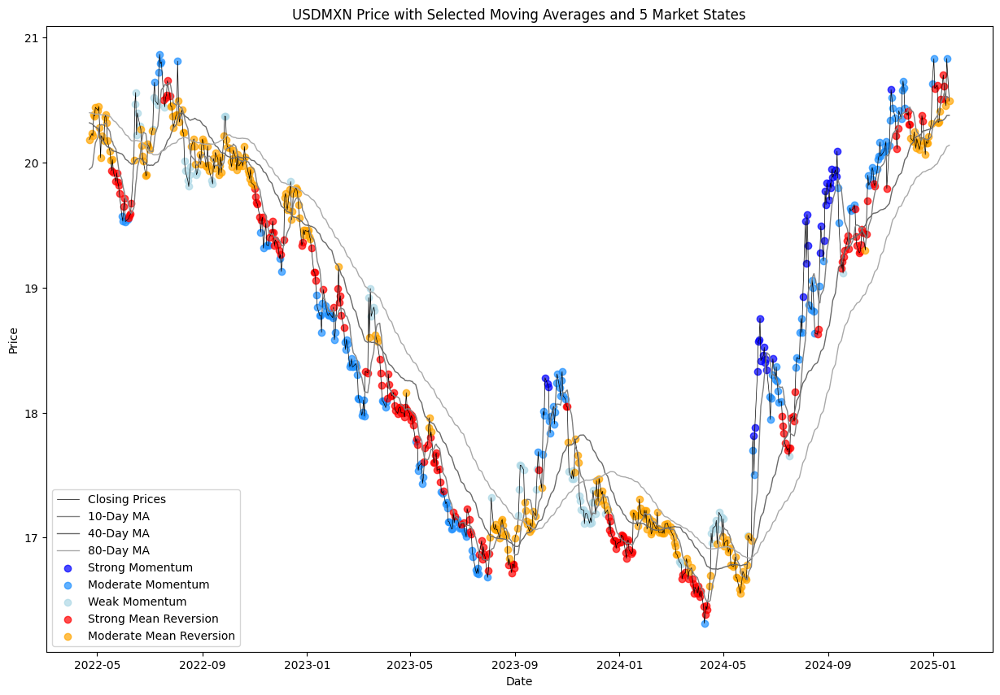

In [ ]:
import yfinance as yf
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
import xgboost as xgb
from sklearn.metrics import accuracy_score, classification_report
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans

# Fetch USDMXN data
usdmxn = yf.Ticker("USDMXN=X").history(start="2022-01-01", end="2025-12-30")

# Define selected moving averages
selected_mas = [10, 40, 80]

# Calculate the selected moving averages and their price differences
for ma in selected_mas:
    usdmxn[f'{ma}d_MA'] = usdmxn['Close'].rolling(window=ma).mean()
    usdmxn[f'Price_{ma}d_MA_Diff'] = usdmxn['Close'] - usdmxn[f'{ma}d_MA']

# Prepare features for classification (only using selected MAs)
features = usdmxn[[f'Price_{ma}d_MA_Diff' for ma in selected_mas]].abs()

# Drop rows with NaN values from both features and usdmxn
features.dropna(inplace=True)
usdmxn = usdmxn.loc[features.index]

# Perform KMeans clustering with 5 clusters
kmeans = KMeans(n_clusters=5, n_init=10, random_state=42)
clusters = kmeans.fit_predict(features)
usdmxn['Cluster'] = clusters

# Define market states
market_states = {
    0: 'Strong Momentum',
    1: 'Moderate Momentum',
    2: 'Weak Momentum',
    3: 'Strong Mean Reversion',
    4: 'Moderate Mean Reversion',
}

# Map clusters to market states based on their mean differences
cluster_means = features.groupby(usdmxn['Cluster']).mean().mean(axis=1)
state_mapping = dict(zip(cluster_means.sort_values(ascending=False).index, market_states.values()))
usdmxn['State'] = usdmxn['Cluster'].map(state_mapping)

# Assign colors to states
state_colors = {
    'Strong Momentum': 'blue',
    'Moderate Momentum': 'dodgerblue',
    'Weak Momentum': 'lightblue',
    'Strong Mean Reversion': 'red',
    'Moderate Mean Reversion': 'orange',
}

# Plotting with cluster trend classification and selected moving averages
plt.figure(figsize=(15, 10))

# Plot a thin black line connecting the returns
plt.plot(usdmxn.index, usdmxn['Close'], color='black', linewidth=0.5, label='Closing Prices')

# Plot selected moving averages in shades of gray
ma_colors = ['gray', 'dimgray', 'darkgray']
for ma, color in zip(selected_mas, ma_colors):
    plt.plot(usdmxn.index, usdmxn[f'{ma}d_MA'], label=f'{ma}-Day MA', color=color, linewidth=1)

# Plot clusters with colors corresponding to market states
for state, color in state_colors.items():
    state_periods = usdmxn['State'] == state
    plt.scatter(
        usdmxn.index[state_periods],
        usdmxn['Close'][state_periods],
        label=state,
        color=color,
        alpha=0.7
    )

plt.title('USDMXN Price with Selected Moving Averages and 5 Market States')
plt.xlabel('Date')
plt.ylabel('Price')
plt.legend()
plt.show()


In [ ]:
import yfinance as yf
import pandas as pd
import numpy as np
import plotly.graph_objs as go
from sklearn.preprocessing import MinMaxScaler

# Download the data
usdmxn = yf.Ticker("USDMXN=X").history(start="2000-01-01", end="2025-12-03")

# Normalize the data
scaler = MinMaxScaler()
usdmxn[['Close']] = scaler.fit_transform(usdmxn[['Close']])

# Function to calculate moving average
def calculate_moving_average(data, ma_period):
    return data['Close'].rolling(window=ma_period).mean()

# Calculate moving averages for each MA
ma_periods = [5, 21, 50, 100, 200, 300, 400, 500]
for ma_period in ma_periods:
    usdmxn[f'MA_{ma_period}'] = calculate_moving_average(usdmxn, ma_period)
    usdmxn[f'State_MA_{ma_period}'] = np.where(usdmxn['Close'] > usdmxn[f'MA_{ma_period}'], 'Above', 'Below')

# Create a plotly figure
fig = go.Figure()

# Add the normalized close price
fig.add_trace(go.Scatter(x=usdmxn.index, y=usdmxn['Close'], mode='lines', name='Normalized Close Price', line=dict(color='white', width=2)))

# Use automatic color cycling for moving averages
for ma_period in ma_periods:
    fig.add_trace(go.Scatter(x=usdmxn.index, y=usdmxn[f'MA_{ma_period}'], mode='lines', name=f'{ma_period}-Day MA'))

# Highlight Above and Below signals with markers
for ma_period in ma_periods:
    signals_above = usdmxn[usdmxn[f'State_MA_{ma_period}'] == 'Above']
    signals_below = usdmxn[usdmxn[f'State_MA_{ma_period}'] == 'Below']
    fig.add_trace(go.Scatter(x=signals_above.index, y=signals_above['Close'], mode='markers', marker=dict(color='green', symbol='triangle-up', size=6), name=f'Above {ma_period} MA'))
    fig.add_trace(go.Scatter(x=signals_below.index, y=signals_below['Close'], mode='markers', marker=dict(color='red', symbol='triangle-down', size=6), name=f'Below {ma_period} MA'))

# Update layout with custom figure size
fig.update_layout(title="USDMXN Normalized Close Price with Moving Averages (5, 21, 50, 100, 200, 300, 400, 500 days)",
                  xaxis_title="Date", yaxis_title="Normalized Price", legend_title="Legend", template="plotly_dark",
                  width=1700,  # Set the width of the figure
                  height=900)  # Set the height of the figure

# Show the plot
fig.show()

In [ ]:
import pandas as pd
import numpy as np
import yfinance as yf
from scipy.stats import norm

# Define the start and end dates
start_date = "2024-01-01"
end_date = "2024-11-01"

# Define the tickers with labels
tickers = {
    "EURUSD=X": "Euro (EUR)", "USDJPY=X": "Japan (JPY)", "GBPUSD=X": "British Pound (GBP)",
    "USDCHF=X": "Swiss Franc (CHF)", "USDCAD=X": "Canadian Dollar (CAD)", "USDMXN=X": "Mexican Peso (MXN)",
    "USDPLN=X": "Polish Zloty (PLN)", "USDHUF=X": "Hungarian Forint (HUF)", "USDZAR=X": "South African Rand (ZAR)",
    "USDSGD=X": "Singapore Dollar (SGD)", "USDBRL=X": "Brazilian Real (BRL)", "AUDUSD=X": "Australian Dollar (AUD)",
    "NZDUSD=X": "New Zealand Dollar (NZD)", "USDINR=X": "Indian Rupee (INR)", "USDKRW=X": "South Korean Won (KRW)",
    "USDRUB=X": "Russian Ruble (RUB)", "USDCNY=X": "Chinese Yuan (CNY)", "USDTWD=X": "Taiwan Dollar (TWD)",
    "USDTHB=X": "Thai Baht (THB)", "USDTRY=X": "Turkish Lira", "USDCZK=X": "Czech Koruna",
    "USDMYR=X": "Malaysian Ringgit", "USDCOP=X": "Colombian Peso", "USDARS=X": "Argentine Peso",
    "USDCLP=X": "Chilean Peso", "USDPEN=X": "Peruvian Nuevo Sol"
}

# Add the Dollar Index as a benchmark for Beta calculation
benchmark = "DX-Y.NYB"
tickers[benchmark] = "Dollar Index (DXY)"

# Retrieve the data for each ticker using yfinance
data = yf.download(list(tickers.keys()), start=start_date, end=end_date)["Close"]

# Calculate returns
returns = data.pct_change(fill_method=None).dropna()

# Interest rates for each currency (editable)
interest_rates = {
    'EUR': 3.40, 'USD': 5.00, 'JPY': 0.25, 'GBP': 5.00, 'CHF': 1.00, 'CAD': 3.75,
    'AUD': 4.35, 'NZD': 4.75, 'MXN': 10.50, 'PLN': 5.75, 'HUF': 6.50, 'ZAR': 8.00,
    'SGD': 3.16, 'BRL': 10.75, 'INR': 6.75, 'KRW': 3.25, 'RUB': 21.00, 'CNY': 3.10,
    'TWD': 2.00, 'THB': 2.25, 'TRY': 50.00, 'CZK': 4.25, 'MYR': 3.00, 'COP': 10.00,
    'ARS': 35.00, 'CLP': 5.25, 'PEN': 3.50
}

# Helper function to get interest rates
def get_interest_rate(currency):
    return interest_rates.get(currency, 0.01)  # Default to 1% if currency is not listed

# Calculate benchmark return and risk-free rate
risk_free_rate = 0.01
benchmark_return = returns[benchmark].mean() * 252

# Initialize dictionary to hold all metrics
metrics = {}

# Calculate metrics for each symbol
for ticker, label in tickers.items():
    # Standard metrics
    std_dev = returns[ticker].std() * np.sqrt(252)
    sharpe_ratio = (returns[ticker].mean() - risk_free_rate / 252) / std_dev * np.sqrt(252)

    # Sortino Ratio
    negative_returns = returns[ticker][returns[ticker] < 0]
    downside_deviation = np.std(negative_returns)
    sortino_ratio = (returns[ticker].mean() - risk_free_rate / 252) / downside_deviation * np.sqrt(252)

    # Drawdown metrics
    cumulative_returns = (1 + returns[ticker]).cumprod()
    drawdown = cumulative_returns.cummax() - cumulative_returns
    max_drawdown = drawdown.max()
    avg_drawdown = drawdown.mean()

    # Advanced FX-specific metrics
    base_currency, quote_currency = ticker[:3], ticker[3:6]  # Split base and quote currencies
    base_rate = get_interest_rate(base_currency)
    quote_rate = get_interest_rate(quote_currency)

    # Carry Trade Return
    carry_trade_return = base_rate - quote_rate

    # Rolling Volatility and Rolling Beta
    rolling_volatility = returns[ticker].rolling(window=30).std() * np.sqrt(252)
    rolling_beta = returns[ticker].rolling(window=30).cov(returns[benchmark]) / returns[benchmark].rolling(window=30).var()

    # Momentum (3-month rolling return)
    momentum_3m = returns[ticker].rolling(window=63).sum() * 252 / 63

    # Correlation with Benchmark
    rolling_corr = returns[ticker].rolling(window=30).corr(returns[benchmark])

    # Expected Shortfall (CVaR 95%)
    var_95 = norm.ppf(1 - 0.05, returns[ticker].mean(), returns[ticker].std()) * np.sqrt(252)
    cvar_95 = returns[ticker][returns[ticker] <= var_95].mean()

    # Omega Ratio
    omega_ratio = returns[ticker][returns[ticker] > 0].sum() / abs(returns[ticker][returns[ticker] < 0].sum())

    # Liquidity Proxy (Average daily range)
    daily_range = data[ticker].diff().abs()  # Calculate daily range as the absolute difference
    avg_daily_range = daily_range.mean()  # Calculate the average daily range

    # Monthly Seasonality with 'ME' for month-end frequency
    monthly_seasonality = returns[ticker].resample('ME').mean()

    # CAPM-based metrics using Dollar Index as benchmark
    avg_return = returns[ticker].mean() * 252
    beta = returns[ticker].cov(returns[benchmark]) / returns[benchmark].var()
    alpha = (avg_return - risk_free_rate) - beta * (benchmark_return - risk_free_rate)
    capm_return = risk_free_rate + beta * (benchmark_return - risk_free_rate)
    treynor_ratio = (avg_return - risk_free_rate) / beta if beta != 0 else np.nan
    jensen_alpha = alpha
    tracking_error = np.std(returns[ticker] - returns[benchmark])
    information_ratio = (returns[ticker].mean() - returns[benchmark].mean()) / tracking_error if tracking_error != 0 else np.nan
    calmar_ratio = avg_return / max_drawdown if max_drawdown != 0 else np.nan
    cumulative_return = cumulative_returns.iloc[-1] - 1  # Use iloc to access the last value

    # Store metrics in the dictionary
    metrics[ticker] = {
        # Volatility and Risk Measures
        'Standard Deviation': std_dev,
        'Rolling Volatility (30d)': rolling_volatility.mean(),
        'Max Drawdown': max_drawdown,
        'Average Drawdown': avg_drawdown,
        'Expected Shortfall (CVaR 95%)': cvar_95,
        'VaR 95%': var_95,
        'Average Daily Range': avg_daily_range,

        # Risk-Adjusted Performance Ratios
        'Sharpe Ratio': sharpe_ratio,
        'Sortino Ratio': sortino_ratio,
        'Treynor Ratio': treynor_ratio,
        'Omega Ratio': omega_ratio,

        # CAPM and Benchmark-Related Metrics
        'Beta (vs DXY)': beta,
        'Alpha': alpha,
        'CAPM Expected Return': capm_return,
        'Jensen\'s Alpha': jensen_alpha,
        'Rolling Beta (30d)': rolling_beta.mean(),
        'Tracking Error': tracking_error,
        'Information Ratio': information_ratio,

        # Momentum and Return Statistics
        'Momentum (3M)': momentum_3m.mean(),
        'Average Return': avg_return,
        'Average Positive Return': returns[ticker][returns[ticker] > 0].mean() * 252,
        'Average Negative Return': returns[ticker][returns[ticker] < 0].mean() * 252,
        'Cumulative Return': cumulative_return,
        'Max Return': returns[ticker].max(),
        'Min Return': returns[ticker].min(),

        # Skewness and Tail Risk
        'Skewness': returns[ticker].skew(),
        'Kurtosis': returns[ticker].kurtosis(),

        # Drawdown and Reward Measures
        'Calmar Ratio': calmar_ratio,

        # Other Financial Metrics
        'Carry Trade Return': carry_trade_return,
        'Rolling Correlation (30d)': rolling_corr.mean(),

        # Seasonal Analysis
        'Monthly Seasonality': monthly_seasonality.mean()
    }

# Create DataFrame for all metrics
metrics_df = pd.DataFrame(metrics).T

# Display the DataFrame
metrics_df

[*********************100%***********************]  27 of 27 completed


,Standard Deviation,Rolling Volatility (30d),Max Drawdown,Average Drawdown,Expected Shortfall (CVaR 95%),VaR 95%,Average Daily Range,Sharpe Ratio,Sortino Ratio,Treynor Ratio,...,Average Negative Return,Cumulative Return,Max Return,Min Return,Skewness,Kurtosis,Calmar Ratio,Carry Trade Return,Rolling Correlation (30d),Monthly Seasonality
EURUSD=X,0.054376,0.054878,0.037014,0.013618,-0.000100,0.087852,0.002786,-0.040806,-0.979291,13.432187,...,-0.633536,-0.021276,0.011424,-0.010828,-0.120739,0.747736,-0.681448,-1.60,0.023911,-0.000104
USDJPY=X,0.102931,0.099117,0.158696,0.042982,0.000324,0.174457,0.661110,0.043922,0.846040,7.815380,...,-1.363807,0.063539,0.019800,-0.024242,-0.631920,1.982705,0.515247,4.75,-0.033509,0.000330
GBPUSD=X,0.060345,0.060121,0.041481,0.014696,0.000067,0.100324,0.003623,0.007225,0.157563,2.229484,...,-0.763777,0.012244,0.008773,-0.011046,-0.449003,0.424739,0.407922,0.00,0.034729,0.000076
USDCHF=X,0.071687,0.072057,0.089003,0.029570,0.000146,0.120236,0.002884,0.023607,0.577733,0.659128,...,-0.878588,0.028020,0.013698,-0.019246,-0.069823,1.789604,0.414188,4.00,-0.012519,0.000155
USDCAD=X,0.046125,0.046673,0.035896,0.008699,0.000296,0.080566,0.003021,0.088173,2.355793,-1.510281,...,-0.534701,0.060990,0.008406,-0.008019,0.086557,0.313717,2.077160,1.25,-0.075519,0.000291
USDMXN=X,0.136956,0.134377,0.058546,0.022623,0.000985,0.240912,0.108123,0.109592,3.145564,-2.710173,...,-1.314135,0.212185,0.042883,-0.024538,0.844245,3.306410,4.240494,-5.50,-0.027879,0.000990
USDPLN=X,0.087634,0.088037,0.054431,0.021379,0.000214,0.147539,0.016894,0.031538,0.893086,-0.432371,...,-0.975933,0.041144,0.015981,-0.013760,0.252237,0.085679,0.989768,-0.75,-0.078956,0.000212
USDHUF=X,0.087249,0.088994,0.051489,0.017219,0.000488,0.151251,1.594761,0.081485,2.745255,-0.807116,...,-0.995179,0.100650,0.014739,-0.011954,0.310893,-0.516764,2.386149,-1.50,-0.103149,0.000503
USDZAR=X,0.112411,0.112599,0.083988,0.029173,0.000063,0.185895,0.102841,0.003250,0.096428,-18.227010,...,-1.286253,0.007698,0.018938,-0.021303,0.268005,-0.042445,0.188109,-3.00,-0.013612,0.000058
USDSGD=X,0.041095,0.040189,0.061016,0.016634,0.000012,0.067787,0.002534,-0.010655,-0.258103,0.645292,...,-0.499364,0.001781,0.006856,-0.008296,-0.073316,0.599580,0.049972,1.84,-0.044703,0.000009


In [ ]:
# Save the DataFrame to a CSV file
metrics_df.to_csv("metrics_data2.csv", index=True)

[*********************100%***********************]  22 of 22 completed


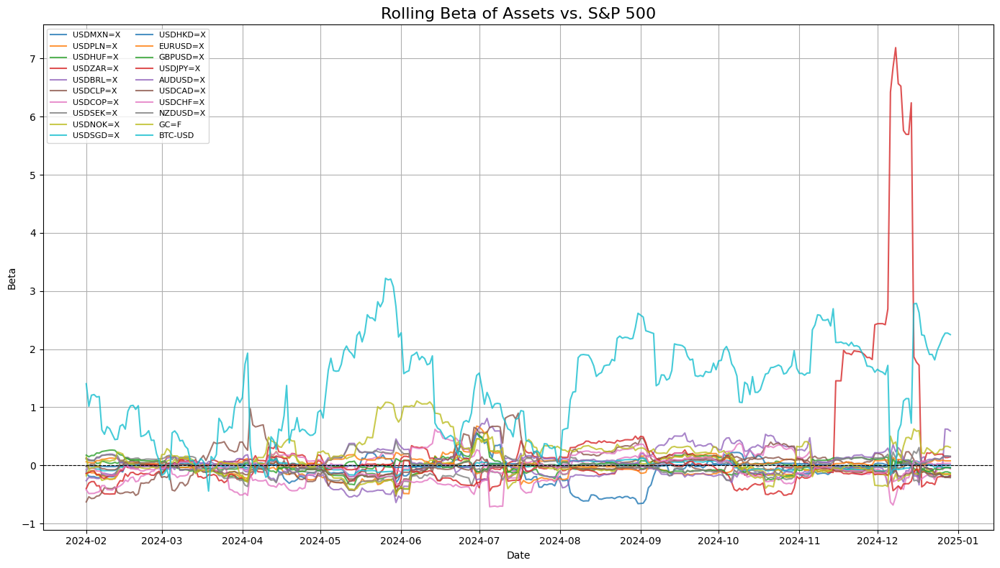

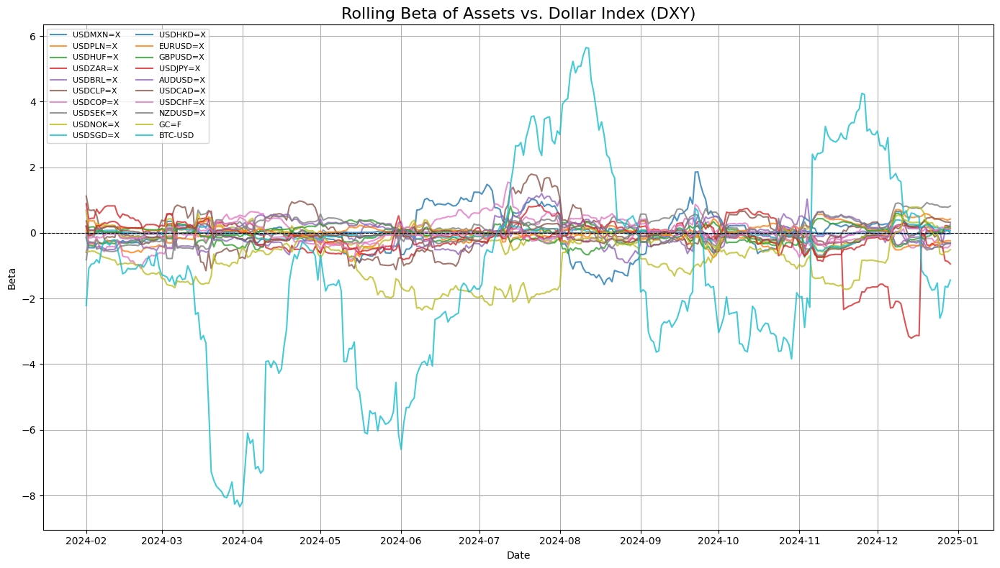

In [ ]:
import pandas as pd
import numpy as np
import yfinance as yf
import matplotlib.pyplot as plt

# Define the start and end dates
start_date = "2024-01-01"
end_date = "2024-12-30"

# Define the list of tickers
tickers = [
    "USDMXN=X", "USDPLN=X", "USDHUF=X", "USDZAR=X", "USDBRL=X",
    "USDCLP=X", "USDCOP=X", "USDSEK=X", "USDNOK=X", "USDSGD=X", "USDHKD=X",
    "EURUSD=X", "GBPUSD=X", "USDJPY=X", "AUDUSD=X", "USDCAD=X",
    "USDCHF=X", "NZDUSD=X", "DX-Y.NYB", "GC=F", "^GSPC", "BTC-USD"
]

# Retrieve the data for each ticker using yfinance
data = yf.download(tickers, start=start_date, end=end_date)["Close"].ffill()

# Calculate the returns
returns = data.pct_change(fill_method=None).dropna()

# Define benchmarks for beta calculation
benchmark_sp500 = "^GSPC"
benchmark_dxy = "DX-Y.NYB"

# Rolling window for beta calculation (e.g., 30 days)
rolling_window = 30

# Initialize dictionaries to hold rolling beta data
rolling_beta_sp500 = {}
rolling_beta_dxy = {}

# Calculate rolling betas for each ticker against benchmarks
for ticker in tickers:
    if ticker in returns.columns and ticker != benchmark_sp500 and ticker != benchmark_dxy:
        # Rolling beta against S&P 500
        rolling_beta_sp500[ticker] = returns[ticker].rolling(window=rolling_window).cov(returns[benchmark_sp500]) / \
                                     returns[benchmark_sp500].rolling(window=rolling_window).var()

        # Rolling beta against Dollar Index
        rolling_beta_dxy[ticker] = returns[ticker].rolling(window=rolling_window).cov(returns[benchmark_dxy]) / \
                                   returns[benchmark_dxy].rolling(window=rolling_window).var()

# Plot rolling beta against S&P 500
plt.figure(figsize=(14, 8))
for ticker, beta_series in rolling_beta_sp500.items():
    plt.plot(beta_series, label=ticker, alpha=0.8)
plt.axhline(0, color='black', linestyle='--', linewidth=0.8)
plt.title("Rolling Beta of Assets vs. S&P 500", fontsize=16)
plt.xlabel("Date")
plt.ylabel("Beta")
plt.legend(fontsize=8, loc='upper left', ncol=2)
plt.grid()
plt.tight_layout()
plt.show()

# Plot rolling beta against Dollar Index
plt.figure(figsize=(14, 8))
for ticker, beta_series in rolling_beta_dxy.items():
    plt.plot(beta_series, label=ticker, alpha=0.8)
plt.axhline(0, color='black', linestyle='--', linewidth=0.8)
plt.title("Rolling Beta of Assets vs. Dollar Index (DXY)", fontsize=16)
plt.xlabel("Date")
plt.ylabel("Beta")
plt.legend(fontsize=8, loc='upper left', ncol=2)
plt.grid()
plt.tight_layout()
plt.show()

In [ ]:
import pandas as pd
import numpy as np
import yfinance as yf
import plotly.graph_objects as go

# Define the start and end dates
start_date = "2023-08-01"
end_date = "2024-12-30"

# Define the list of tickers
tickers = [
    "USDMXN=X", "USDPLN=X", "USDHUF=X", "USDZAR=X", "USDBRL=X",
    "USDCLP=X", "USDCOP=X", "USDSEK=X", "USDNOK=X", "USDSGD=X", "USDHKD=X",
    "EURUSD=X", "GBPUSD=X", "USDJPY=X", "AUDUSD=X", "USDCAD=X",
    "USDCHF=X", "NZDUSD=X", "DX-Y.NYB", "GC=F", "^GSPC", "BTC-USD"
]

# Retrieve the data for each ticker using yfinance
data = yf.download(tickers, start=start_date, end=end_date)["Close"]

# Calculate the returns
returns = data.pct_change(fill_method=None).dropna()  # Updated to handle fill_method deprecation

# Define the benchmarks
benchmarks = {"^GSPC": "S&P 500", "DX-Y.NYB": "Dollar Index"}

# Rolling window for beta calculation
rolling_window = 30

# Initialize figures
fig_sp500 = go.Figure()
fig_dxy = go.Figure()

for ticker in tickers:
    try:
        for benchmark, benchmark_label in benchmarks.items():
            if benchmark not in returns.columns or ticker not in returns.columns:
                continue

            # Calculate rolling beta
            rolling_beta = (
                returns[ticker].rolling(window=rolling_window).cov(returns[benchmark]) /
                returns[benchmark].rolling(window=rolling_window).var()
            )

            # Add traces to the appropriate figure
            if benchmark == "^GSPC":
                fig_sp500.add_trace(go.Scatter(
                    x=rolling_beta.index,
                    y=rolling_beta,
                    mode="lines",
                    name=ticker,
                    line=dict(width=2)
                ))
            elif benchmark == "DX-Y.NYB":
                fig_dxy.add_trace(go.Scatter(
                    x=rolling_beta.index,
                    y=rolling_beta,
                    mode="lines",
                    name=ticker,
                    line=dict(width=2)
                ))
    except Exception as e:
        print(f"Error processing {ticker}: {e}")

# Update layout for S&P 500 rolling beta figure
fig_sp500.update_layout(
    title="Rolling Beta of Assets vs. S&P 500",
    xaxis_title="Date",
    yaxis_title="Rolling Beta",
    template="plotly_white",
    legend_title="Assets",
    width=1000,
    height=600
)

# Update layout for Dollar Index rolling beta figure
fig_dxy.update_layout(
    title="Rolling Beta of Assets vs. Dollar Index",
    xaxis_title="Date",
    yaxis_title="Rolling Beta",
    template="plotly_white",
    legend_title="Assets",
    width=1000,
    height=600
)

# Show plots
fig_sp500.show()
fig_dxy.show()

[*********************100%***********************]  22 of 22 completed


[*********************100%***********************]  6 of 6 completed


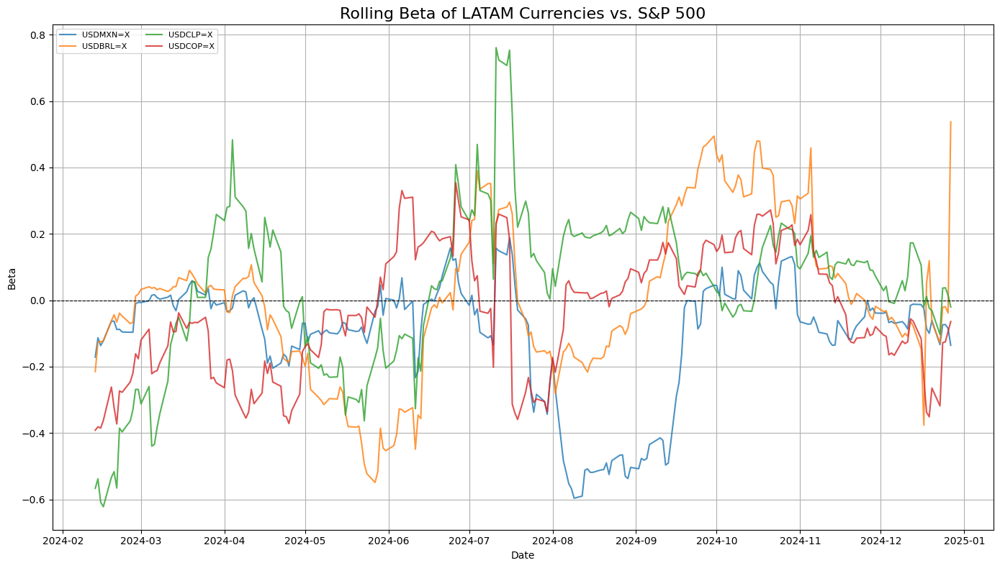

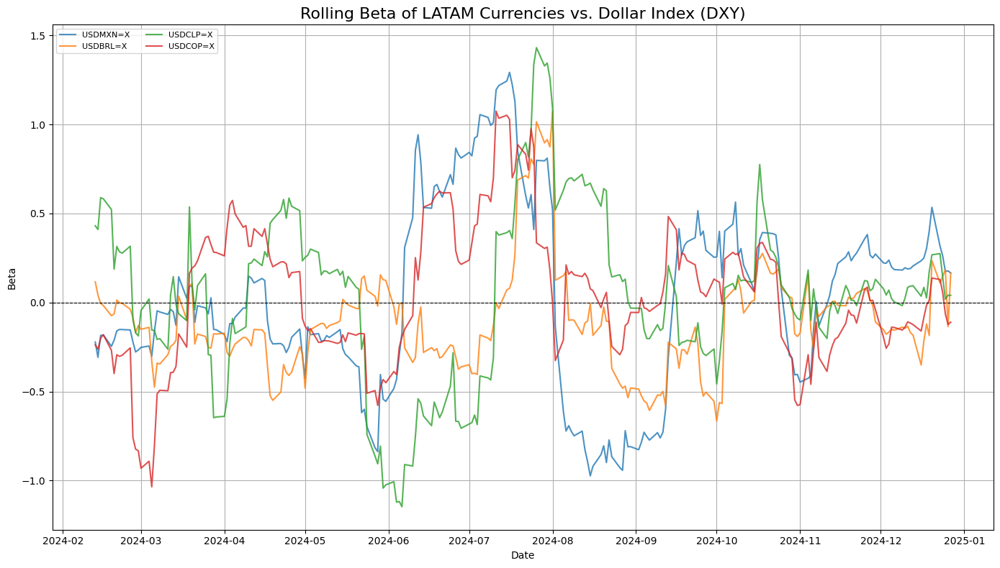

In [ ]:
import pandas as pd
import numpy as np
import yfinance as yf
import matplotlib.pyplot as plt

# Define the start and end dates
start_date = "2024-01-01"
end_date = "2024-12-30"

# Define the list of LATAM tickers along with benchmarks
tickers = ["USDMXN=X", "USDBRL=X", "USDCLP=X", "USDCOP=X", "DX-Y.NYB", "^GSPC"]

# Retrieve the data for each ticker using yfinance
data = yf.download(tickers, start=start_date, end=end_date)["Close"].ffill()

# Calculate the returns
returns = data.pct_change(fill_method=None).dropna()

# Define benchmarks for beta calculation
benchmark_sp500 = "^GSPC"
benchmark_dxy = "DX-Y.NYB"

# Rolling window for beta calculation (e.g., 30 days)
rolling_window = 30

# Initialize dictionaries to hold rolling beta data
rolling_beta_sp500 = {}
rolling_beta_dxy = {}

# Calculate rolling betas for each LATAM ticker against benchmarks
for ticker in tickers:
    if ticker in returns.columns and ticker not in [benchmark_sp500, benchmark_dxy]:
        # Rolling beta against S&P 500
        rolling_beta_sp500[ticker] = returns[ticker].rolling(window=rolling_window).cov(returns[benchmark_sp500]) / \
                                     returns[benchmark_sp500].rolling(window=rolling_window).var()

        # Rolling beta against Dollar Index
        rolling_beta_dxy[ticker] = returns[ticker].rolling(window=rolling_window).cov(returns[benchmark_dxy]) / \
                                   returns[benchmark_dxy].rolling(window=rolling_window).var()

# Plot rolling beta against S&P 500
plt.figure(figsize=(14, 8))
for ticker, beta_series in rolling_beta_sp500.items():
    plt.plot(beta_series, label=ticker, alpha=0.8)
plt.axhline(0, color='black', linestyle='--', linewidth=0.8)
plt.title("Rolling Beta of LATAM Currencies vs. S&P 500", fontsize=16)
plt.xlabel("Date")
plt.ylabel("Beta")
plt.legend(fontsize=8, loc='upper left', ncol=2)
plt.grid()
plt.tight_layout()
plt.show()

# Plot rolling beta against Dollar Index
plt.figure(figsize=(14, 8))
for ticker, beta_series in rolling_beta_dxy.items():
    plt.plot(beta_series, label=ticker, alpha=0.8)
plt.axhline(0, color='black', linestyle='--', linewidth=0.8)
plt.title("Rolling Beta of LATAM Currencies vs. Dollar Index (DXY)", fontsize=16)
plt.xlabel("Date")
plt.ylabel("Beta")
plt.legend(fontsize=8, loc='upper left', ncol=2)
plt.grid()
plt.tight_layout()
plt.show()


In [ ]:
import yfinance as yf
import pandas as pd
import numpy as np
from scipy.stats import zscore
import plotly.graph_objects as go

# List of currency pairs
tickers = {
    "EURUSD=X": "Euro (EUR)",
    "USDJPY=X": "Japan (JPY)",
    "GBPUSD=X": "British Pound (GBP)",
    "USDCHF=X": "Swiss Franc (CHF)",
    "USDCAD=X": "Canadian Dollar (CAD)",
    "USDMXN=X": "Mexican Peso (MXN)",
    "USDPLN=X": "Polish Zloty (PLN)",
    "USDHUF=X": "Hungarian Forint (HUF)",
    "USDZAR=X": "South African Rand (ZAR)",
    "USDSGD=X": "Singapore Dollar (SGD)",
    "USDBRL=X": "Brazilian Real (BRL)",
    "AUDUSD=X": "Australian Dollar (AUD)",
    "NZDUSD=X": "New Zealand Dollar (NZD)",
    "USDINR=X": "Indian Rupee (INR)",
    "USDKRW=X": "South Korean Won (KRW)",
    "USDRUB=X": "Russian Ruble (RUB)",
    "USDCNY=X": "Chinese Yuan (CNY)",
    "USDTWD=X": "Taiwan Dollar (TWD)",
    "USDTHB=X": "Thai Baht (THB)",
    "USDTRY=X": "Turkish Lira",
    "USDCZK=X": "Czech Koruna",
    "USDMYR=X": "Malaysian Ringgit",
    "USDCOP=X": "Colombian Peso",
    "USDARS=X": "Argentine Peso",
    "USDCLP=X": "Chilean Peso"
}

# Create a figure for growth
fig_growth = go.Figure()

# Create a figure for variances
fig_variances = go.Figure()

# Loop through each currency pair
for ticker in tickers:
    # Download the data
    data = yf.Ticker(ticker).history(start="2024-01-01", end="2024-12-31")
    data['Return'] = data['Close'].pct_change()
    data.dropna(inplace=True)

    # Calculate cumulative growth of returns
    data['Cumulative Growth'] = (1 + data['Return']).cumprod()

    # Add a subplot for the currency pair in the growth figure
    fig_growth.add_trace(go.Scatter(x=data.index, y=data['Cumulative Growth'], mode='lines', name=f'{ticker} Growth'))

    # Isolate positive and negative returns
    positive_returns = data['Return'].copy()
    negative_returns = data['Return'].copy()
    positive_returns[positive_returns < 0] = 0
    negative_returns[negative_returns > 0] = 0
    negative_returns = negative_returns.abs()

    # Calculate cumulative variance for positive and negative returns
    data['Cumulative Positive Variance'] = positive_returns.cumsum()
    data['Cumulative Negative Variance'] = negative_returns.cumsum()

    # Apply z-score normalization
    data['Z Cumulative Positive Variance'] = zscore(data['Cumulative Positive Variance'])
    data['Z Cumulative Negative Variance'] = zscore(data['Cumulative Negative Variance'])

    # Add a subplot for the currency pair in the variances figure
    fig_variances.add_trace(go.Scatter(x=data.index, y=data['Z Cumulative Positive Variance'], mode='lines', name=f'{ticker} Positive Variance', line=dict(color='green')))
    fig_variances.add_trace(go.Scatter(x=data.index, y=data['Z Cumulative Negative Variance'], mode='lines', name=f'{ticker} Negative Variance', line=dict(color='red')))

# Update layout for the growth figure
fig_growth.update_layout(
    title='Cumulative Growth of Returns for Currency Pairs',
    xaxis_title='Date',
    yaxis_title='Cumulative Growth',
    height=800, width=1200,
    legend_title_text='Currency Pair'
)

# Update layout for the variances figure
fig_variances.update_layout(
    title='Normalized Cumulative Positive and Negative Variances for Currency Pairs',
    xaxis_title='Date',
    yaxis_title='Normalized Value',
    height=1000, width=1600,
    legend_title_text='Currency Pair'
)

# Show both figures
fig_growth.show()
fig_variances.show()

In [ ]:
!pip install kneed

In [ ]:
import yfinance as yf
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans
from kneed import KneeLocator
import plotly.graph_objects as go
import plotly.express as px

# Fetch S&P 500 data
sp500 = yf.Ticker("USDMXN=X").history(start="2021-01-01", end="2025-12-30")

# Define moving averages
moving_averages = [2, 5, 10, 20, 30, 40, 50, 100, 200]

# Calculate moving averages and the difference between price and each MA
for ma in moving_averages:
    sp500[f'{ma}d_MA'] = sp500['Close'].rolling(window=ma).mean()
    sp500[f'Price_{ma}d_MA_Diff'] = sp500['Close'] - sp500[f'{ma}d_MA']

# Prepare features for K-NN clustering
features = sp500[[f'Price_{ma}d_MA_Diff' for ma in moving_averages]].abs()
features.dropna(inplace=True)

# Finding the optimal number of clusters using the elbow method
inertia = []
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, n_init=10, random_state=42).fit(features)
    inertia.append(kmeans.inertia_)

k_optimal = KneeLocator(range(1, 10), inertia, curve='convex', direction='decreasing').knee

# Perform KMeans clustering
kmeans = KMeans(n_clusters=k_optimal, n_init=10, random_state=42)
clusters = kmeans.fit_predict(features)

# Add cluster information to the original DataFrame
sp500 = sp500.loc[features.index]
sp500['Cluster'] = clusters

# Calculate the centroids of the clusters
centroids = kmeans.cluster_centers_

# Initialize the market state classification dictionary
market_states = {}

# Determine the lowest, highest, and average centroid values
mean_centroid_value = np.mean([np.mean(centroid) for centroid in centroids])
lowest_centroid_value = np.min([np.mean(centroid) for centroid in centroids])
highest_centroid_value = np.max([np.mean(centroid) for centroid in centroids])

# Classify clusters based on the centroid values
for i, centroid in enumerate(centroids):
    avg_difference = np.mean(centroid)

    # Classify as Momentum if the average difference is the highest
    if avg_difference == highest_centroid_value:
        market_states[i] = 'Momentum'

    # Classify as Mean Reversion if the average difference is the lowest
    elif avg_difference == lowest_centroid_value:
        market_states[i] = 'Mean Reversion'

    # Otherwise, classify as Neutral (near average difference)
    else:
        market_states[i] = 'Neutral'

# Print the market state classification for each cluster
print("Market States by Cluster:", market_states)

# Plotting the clusters with Plotly
fig = go.Figure()

# Plot clusters and assign colors based on market states
state_colors = {'Momentum': 'red', 'Mean Reversion': 'green', 'Neutral': 'blue'}

for cluster in range(k_optimal):
    cluster_periods = sp500['Cluster'] == cluster
    label = market_states.get(cluster, 'Unknown')

    fig.add_trace(go.Scatter(
        x=sp500.index[cluster_periods],
        y=sp500['Close'][cluster_periods],
        mode='markers',
        name=f'Cluster {cluster}: {label}',
        marker=dict(size=6, color=state_colors[label], opacity=0.7)
    ))

# Update the layout of the scatter plot
fig.update_layout(
    title="S&P 500 Price with K-Means Cluster Trends",
    xaxis_title="Date",
    yaxis_title="Price",
    legend_title="Clusters",
    width=1000,
    height=600
)

fig.show()

# Plot histograms of MA differences for each cluster using Plotly
hist_fig = go.Figure()

for cluster in range(k_optimal):
    label = market_states.get(cluster, 'Unknown')
    hist_fig.add_trace(go.Histogram(
        x=sp500[f'Price_{20}d_MA_Diff'][sp500['Cluster'] == cluster],
        nbinsx=50,
        opacity=0.5,
        name=f'Cluster {cluster}: {label}',
        marker_color=state_colors[label]
    ))

# Update the layout of the histogram
hist_fig.update_layout(
    title="Distribution of 20-day MA Differences for Clusters",
    xaxis_title="20-day MA Difference",
    yaxis_title="Frequency",
    barmode='overlay',
    width=1000,
    height=600
)

hist_fig.show()

Market States by Cluster: {0: 'Mean Reversion', 1: 'Neutral', 2: 'Momentum'}


In [ ]:
import plotly.graph_objects as go
import yfinance as yf
import pandas as pd
import numpy as np
import warnings

# Suppress specific FutureWarnings
warnings.simplefilter(action='ignore', category=FutureWarning)

# Define start and end dates for flexible editing
start_date = "2024-01-01"
end_date = "2025-12-30"

# Download the data for USD/MXN from Yahoo Finance
usdmxn = yf.Ticker("USDMXN=X").history(start=start_date, end=end_date)
usdmxn.reset_index(inplace=True)

# Resample for weekly and monthly intervals
weekly_stats = usdmxn.resample('W-Mon', on='Date').agg({
    'Close': 'last'
})
monthly_stats = usdmxn.resample('M', on='Date').agg({
    'Close': 'last'
})

# Create a Plotly figure with daily, weekly, and monthly closing prices
fig = go.Figure()

# Add daily closing prices
fig.add_trace(go.Scatter(
    x=usdmxn['Date'],
    y=usdmxn['Close'],
    mode='lines',
    name='Daily Close'
))

# Add weekly closing prices
fig.add_trace(go.Scatter(
    x=weekly_stats.reset_index()['Date'],
    y=weekly_stats['Close'],
    mode='lines+markers',
    name='Weekly Close'
))

# Add monthly closing prices
fig.add_trace(go.Scatter(
    x=monthly_stats.reset_index()['Date'],
    y=monthly_stats['Close'],
    mode='lines+markers',
    name='Monthly Close'
))

# Update the layout for better visualization with figsize
fig.update_layout(
    title=f"USD/MXN Closing Prices: Daily, Weekly, and Monthly",
    xaxis_title="Date",
    yaxis_title="Closing Price (MXN)",
    legend_title="Frequency",
    template="plotly_dark",
    width=1200,  # Figure width
    height=700   # Figure height
)

# Display the figure
fig.show()

In [ ]:
import yfinance as yf
import pandas as pd
import numpy as np
import warnings

# Suppress specific FutureWarnings
warnings.simplefilter(action='ignore', category=FutureWarning)

# Download the data for USD/MXN from Yahoo Finance
usdmxn = yf.Ticker("USDMXN=X").history(start="2024-01-01", end="2024-12-30")
usdmxn.reset_index(inplace=True)

# Calculate daily high-close, low-close distances, and close-to-close return percentages
usdmxn['High_Close_Diff'] = (usdmxn['High'] - usdmxn['Close']).abs()
usdmxn['Low_Close_Diff'] = (usdmxn['Close'] - usdmxn['Low']).abs()
usdmxn['Return_%'] = usdmxn['Close'].pct_change() * 100

# Add a column to check if the day is inside or outside the previous day's range
usdmxn['Inside_Outside'] = np.where(
    (usdmxn['High'] <= usdmxn['High'].shift(1)) & (usdmxn['Low'] >= usdmxn['Low'].shift(1)),
    'Inside',
    'Outside'
)

# Add a column indicating if the previous range was broken by the high or low
usdmxn['Range_Break'] = np.where(
    (usdmxn['High'] > usdmxn['High'].shift(1)) & (usdmxn['Low'] < usdmxn['Low'].shift(1)),
    'Both',
    np.where(
        usdmxn['High'] > usdmxn['High'].shift(1),
        'High',
        np.where(
            usdmxn['Low'] < usdmxn['Low'].shift(1),
            'Low',
            'None'
        )
    )
)

# Resample for weekly and monthly intervals
weekly_stats = usdmxn.resample('W-Mon', on='Date').agg({
    'High': 'max',
    'Low': 'min',
    'Close': 'last',
    'Return_%': 'sum'
})
weekly_stats['High_Close_Diff'] = (weekly_stats['High'] - weekly_stats['Close']).abs()
weekly_stats['Low_Close_Diff'] = (weekly_stats['Close'] - weekly_stats['Low']).abs()
weekly_stats['Previous_High'] = weekly_stats['High'].shift(1)
weekly_stats['Previous_Low'] = weekly_stats['Low'].shift(1)
weekly_stats['Inside_Outside'] = np.where(
    (weekly_stats['High'] <= weekly_stats['Previous_High']) & (weekly_stats['Low'] >= weekly_stats['Previous_Low']),
    'Inside',
    'Outside'
)
weekly_stats['Range_Break'] = np.where(
    (weekly_stats['High'] > weekly_stats['Previous_High']) & (weekly_stats['Low'] < weekly_stats['Previous_Low']),
    'Both',
    np.where(
        weekly_stats['High'] > weekly_stats['Previous_High'],
        'High',
        np.where(
            weekly_stats['Low'] < weekly_stats['Previous_Low'],
            'Low',
            'None'
        )
    )
)

monthly_stats = usdmxn.resample('M', on='Date').agg({
    'High': 'max',
    'Low': 'min',
    'Close': 'last',
    'Return_%': 'sum'
})
monthly_stats['High_Close_Diff'] = (monthly_stats['High'] - monthly_stats['Close']).abs()
monthly_stats['Low_Close_Diff'] = (monthly_stats['Close'] - monthly_stats['Low']).abs()
monthly_stats['Previous_High'] = monthly_stats['High'].shift(1)
monthly_stats['Previous_Low'] = monthly_stats['Low'].shift(1)
monthly_stats['Inside_Outside'] = np.where(
    (monthly_stats['High'] <= monthly_stats['Previous_High']) & (monthly_stats['Low'] >= monthly_stats['Previous_Low']),
    'Inside',
    'Outside'
)
monthly_stats['Range_Break'] = np.where(
    (monthly_stats['High'] > monthly_stats['Previous_High']) & (monthly_stats['Low'] < monthly_stats['Previous_Low']),
    'Both',
    np.where(
        monthly_stats['High'] > monthly_stats['Previous_High'],
        'High',
        np.where(
            monthly_stats['Low'] < monthly_stats['Previous_Low'],
            'Low',
            'None'
        )
    )
)

# Save results to CSV files for easier access
daily_csv_path = '/content/USD_MXN_Daily_Analysis.csv'
weekly_csv_path = '/content/USD_MXN_Weekly_Analysis.csv'
monthly_csv_path = '/content/USD_MXN_Monthly_Analysis.csv'

usdmxn[['Date', 'Close', 'High_Close_Diff', 'Low_Close_Diff', 'Return_%', 'Inside_Outside', 'Range_Break']].to_csv(daily_csv_path, index=False)
weekly_stats.reset_index().to_csv(weekly_csv_path, index=False)
monthly_stats.reset_index().to_csv(monthly_csv_path, index=False)

# Display dataframes for review
print("Daily Analysis:")
display(usdmxn[['Date', 'Close', 'High_Close_Diff', 'Low_Close_Diff', 'Return_%', 'Inside_Outside', 'Range_Break']].head())

print("\nWeekly Analysis:")
display(weekly_stats.reset_index()[['Date', 'Close', 'High_Close_Diff', 'Low_Close_Diff', 'Return_%', 'Inside_Outside', 'Range_Break']].head())

print("\nMonthly Analysis:")
display(monthly_stats.reset_index()[['Date', 'Close', 'High_Close_Diff', 'Low_Close_Diff', 'Return_%', 'Inside_Outside', 'Range_Break']].head())

# File paths for reference
print(f"\nCSV Files Saved:")
print(f"Daily Analysis: {daily_csv_path}")
print(f"Weekly Analysis: {weekly_csv_path}")
print(f"Monthly Analysis: {monthly_csv_path}")

Daily Analysis:


,Date,Close,High_Close_Diff,Low_Close_Diff,Return_%,Inside_Outside,Range_Break
0,2024-01-01 00:00:00+00:00,16.963440,0.000000,0.000099,NaN,Outside,None
1,2024-01-02 00:00:00+00:00,16.962509,0.102001,0.067209,-0.005487,Outside,Both
2,2024-01-03 00:00:00+00:00,17.019400,0.078850,0.015800,0.335390,Outside,High
3,2024-01-04 00:00:00+00:00,17.012150,0.071550,0.046650,-0.042597,Outside,Low
4,2024-01-05 00:00:00+00:00,17.008600,0.058220,0.138300,-0.020865,Outside,Low



Weekly Analysis:


,Date,Close,High_Close_Diff,Low_Close_Diff,Return_%,Inside_Outside,Range_Break
0,2024-01-01 00:00:00+00:00,16.963440,0.000000,0.000099,0.000000,Outside,None
1,2024-01-08 00:00:00+00:00,16.880939,0.217310,0.107740,-0.484126,Outside,Both
2,2024-01-15 00:00:00+00:00,16.869070,0.184460,0.065269,-0.065502,Inside,None
3,2024-01-22 00:00:00+00:00,17.093149,0.288502,0.208050,1.337691,Outside,High
4,2024-01-29 00:00:00+00:00,17.168619,0.206560,0.047619,0.445870,Inside,None



Monthly Analysis:


,Date,Close,High_Close_Diff,Low_Close_Diff,Return_%,Inside_Outside,Range_Break
0,2024-01-31 00:00:00+00:00,17.152710,0.228941,0.379511,1.142421,Outside,None
1,2024-02-29 00:00:00+00:00,17.087299,0.194921,0.106899,-0.365546,Inside,None
2,2024-03-31 00:00:00+00:00,16.602840,0.453800,0.092541,-2.861421,Outside,Low
3,2024-04-30 00:00:00+01:00,17.011560,0.806129,0.763861,2.489591,Outside,Both
4,2024-05-31 00:00:00+01:00,17.005819,0.153431,0.490719,0.005275,Inside,None



CSV Files Saved:
Daily Analysis: /content/USD_MXN_Daily_Analysis.csv
Weekly Analysis: /content/USD_MXN_Weekly_Analysis.csv
Monthly Analysis: /content/USD_MXN_Monthly_Analysis.csv


In [ ]:
import yfinance as yf
import pandas as pd
import numpy as np
import warnings
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Suppress specific FutureWarnings
warnings.simplefilter(action='ignore', category=FutureWarning)

# Download the data for USD/MXN from Yahoo Finance
usdmxn = yf.Ticker("USDMXN=X").history(start="2024-01-01", end="2025-12-30")
usdmxn.reset_index(inplace=True)

# Ensure the 'Date' column is in datetime format
usdmxn['Date'] = pd.to_datetime(usdmxn['Date'])

# Calculate daily high-close, low-close distances, and close-to-close return percentages
usdmxn['High_Close_Diff'] = (usdmxn['High'] - usdmxn['Close']).abs()
usdmxn['Low_Close_Diff'] = (usdmxn['Close'] - usdmxn['Low']).abs()
usdmxn['Return_%'] = usdmxn['Close'].pct_change() * 100
usdmxn['Return_Real'] = usdmxn['Close'].diff()  # Real term change

# Add a column to check if the day is inside or outside the previous day's range
usdmxn['Inside_Outside'] = np.where(
    (usdmxn['High'] <= usdmxn['High'].shift(1)) & (usdmxn['Low'] >= usdmxn['Low'].shift(1)),
    'Inside',
    'Outside'
)

# Add a column indicating if the previous range was broken by the high or low
usdmxn['Range_Break'] = np.where(
    (usdmxn['High'] > usdmxn['High'].shift(1)) & (usdmxn['Low'] < usdmxn['Low'].shift(1)),
    'Both',
    np.where(
        usdmxn['High'] > usdmxn['High'].shift(1),
        'High',
        np.where(
            usdmxn['Low'] < usdmxn['Low'].shift(1),
            'Low',
            'None'
        )
    )
)

# Resample for weekly and monthly intervals
weekly_stats = usdmxn.resample('W-Mon', on='Date').agg({
    'High': 'max',
    'Low': 'min',
    'Close': 'last',
    'Return_%': 'sum',
    'Return_Real': 'sum'
})
weekly_stats['High_Close_Diff'] = (weekly_stats['High'] - weekly_stats['Close']).abs()
weekly_stats['Low_Close_Diff'] = (weekly_stats['Close'] - weekly_stats['Low']).abs()
weekly_stats['Previous_High'] = weekly_stats['High'].shift(1)
weekly_stats['Previous_Low'] = weekly_stats['Low'].shift(1)
weekly_stats['Inside_Outside'] = np.where(
    (weekly_stats['High'] <= weekly_stats['Previous_High']) & (weekly_stats['Low'] >= weekly_stats['Previous_Low']),
    'Inside',
    'Outside'
)
weekly_stats['Range_Break'] = np.where(
    (weekly_stats['High'] > weekly_stats['Previous_High']) & (weekly_stats['Low'] < weekly_stats['Previous_Low']),
    'Both',
    np.where(
        weekly_stats['High'] > weekly_stats['Previous_High'],
        'High',
        np.where(
            weekly_stats['Low'] < weekly_stats['Previous_Low'],
            'Low',
            'None'
        )
    )
)

monthly_stats = usdmxn.resample('M', on='Date').agg({
    'High': 'max',
    'Low': 'min',
    'Close': 'last',
    'Return_%': 'sum',
    'Return_Real': 'sum'
})
monthly_stats['High_Close_Diff'] = (monthly_stats['High'] - monthly_stats['Close']).abs()
monthly_stats['Low_Close_Diff'] = (monthly_stats['Close'] - monthly_stats['Low']).abs()
monthly_stats['Previous_High'] = monthly_stats['High'].shift(1)
monthly_stats['Previous_Low'] = monthly_stats['Low'].shift(1)
monthly_stats['Inside_Outside'] = np.where(
    (monthly_stats['High'] <= monthly_stats['Previous_High']) & (monthly_stats['Low'] >= monthly_stats['Previous_Low']),
    'Inside',
    'Outside'
)
monthly_stats['Range_Break'] = np.where(
    (monthly_stats['High'] > monthly_stats['Previous_High']) & (monthly_stats['Low'] < monthly_stats['Previous_Low']),
    'Both',
    np.where(
        monthly_stats['High'] > monthly_stats['Previous_High'],
        'High',
        np.where(
            monthly_stats['Low'] < monthly_stats['Previous_Low'],
            'Low',
            'None'
        )
    )
)

# Calculate statistics for daily, weekly, and monthly data
def calculate_statistics(data, prefix):
    stats = {
        f'{prefix}_Max_Return_%': data['Return_%'].max(),
        f'{prefix}_Min_Return_%': data['Return_%'].min(),
        f'{prefix}_Avg_Return_%': data['Return_%'].mean(),
        f'{prefix}_Median_Return_%': data['Return_%'].median(),
        f'{prefix}_Max_Return_Real': data['Return_Real'].max(),
        f'{prefix}_Min_Return_Real': data['Return_Real'].min(),
        f'{prefix}_Avg_Return_Real': data['Return_Real'].mean(),
        f'{prefix}_Median_Return_Real': data['Return_Real'].median(),
    }
    return stats

daily_stats = calculate_statistics(usdmxn, 'Daily')
weekly_stats_reset = weekly_stats.reset_index()
weekly_stats_reset = calculate_statistics(weekly_stats_reset, 'Weekly')
monthly_stats_reset = monthly_stats.reset_index()
monthly_stats_reset = calculate_statistics(monthly_stats_reset, 'Monthly')

# Combine all statistics into a DataFrame
stats_df = pd.DataFrame([daily_stats, weekly_stats_reset, monthly_stats_reset])
stats_df.index = ['Daily', 'Weekly', 'Monthly']
print(stats_df)

# Plotly Visualizations
# 1. Close Price Trend (Interactive Line Chart)
fig1 = px.line(usdmxn, x='Date', y='Close', title='USD/MXN Close Prices (2024)',
               labels={'Close': 'Close Price', 'Date': 'Date'})
fig1.update_traces(line=dict(color='blue', width=2))
fig1.update_layout(hovermode='x unified', template='plotly_white', width=1200, height=600)
fig1.show()

# 2. Daily Return Distribution (Interactive Histogram)
fig2 = px.histogram(usdmxn, x='Return_%', nbins=30, title='USD/MXN Daily Return Distribution',
                    labels={'Return_%': 'Daily Return (%)', 'count': 'Frequency'})
fig2.update_traces(marker=dict(color='skyblue', line=dict(color='black', width=1)))
fig2.update_layout(template='plotly_white', width=1200, height=600)
fig2.show()

# 3. Weekly Returns (Dual-Axis Bar and Line Chart)
weekly_stats_reset = weekly_stats.reset_index()
fig3 = make_subplots(specs=[[{"secondary_y": True}]])
fig3.add_trace(
    go.Bar(x=weekly_stats_reset['Date'], y=weekly_stats_reset['Return_%'], name='Weekly Return (%)', marker_color='lightgreen'),
    secondary_y=False,
)
fig3.add_trace(
    go.Scatter(x=weekly_stats_reset['Date'], y=weekly_stats_reset['Return_Real'], name='Weekly Return (Real)', line=dict(color='red')),
    secondary_y=True,
)
fig3.update_layout(
    title='USD/MXN Weekly Returns (2024)',
    xaxis_title='Week',
    template='plotly_white',
    width=1200,
    height=600,
)
fig3.update_yaxes(title_text='Return (%)', secondary_y=False)
fig3.update_yaxes(title_text='Return (Real)', secondary_y=True)
fig3.show()

# 4. Monthly Returns (Dual-Axis Bar and Line Chart)
monthly_stats_reset = monthly_stats.reset_index()
fig4 = make_subplots(specs=[[{"secondary_y": True}]])
fig4.add_trace(
    go.Bar(x=monthly_stats_reset['Date'], y=monthly_stats_reset['Return_%'], name='Monthly Return (%)', marker_color='orange'),
    secondary_y=False,
)
fig4.add_trace(
    go.Scatter(x=monthly_stats_reset['Date'], y=monthly_stats_reset['Return_Real'], name='Monthly Return (Real)', line=dict(color='purple')),
    secondary_y=True,
)
fig4.update_layout(
    title='USD/MXN Monthly Returns (2024)',
    xaxis_title='Month',
    template='plotly_white',
    width=1200,
    height=600,
)
fig4.update_yaxes(title_text='Return (%)', secondary_y=False)
fig4.update_yaxes(title_text='Return (Real)', secondary_y=True)
fig4.show()

# 5. Inside/Outside Days (Interactive Pie Chart)
inside_outside_counts = usdmxn['Inside_Outside'].value_counts()
fig5 = px.pie(inside_outside_counts, values=inside_outside_counts.values, names=inside_outside_counts.index,
              title='Proportion of Inside/Outside Days', hole=0.4)
fig5.update_traces(textinfo='percent+label', marker=dict(colors=['lightblue', 'lightcoral']))
fig5.update_layout(template='plotly_white', width=1200, height=600)
fig5.show()

# 6. Range Break Analysis (Interactive Bar Chart)
range_break_counts = usdmxn['Range_Break'].value_counts()
fig6 = px.bar(range_break_counts, x=range_break_counts.index, y=range_break_counts.values,
              title='Range Break Analysis', labels={'x': 'Break Type', 'y': 'Frequency'})
fig6.update_traces(marker=dict(color='purple', line=dict(color='black', width=1)))
fig6.update_layout(template='plotly_white', width=1200, height=600)
fig6.show()

# 7. High-Close and Low-Close Differences (Interactive Bar Chart)
avg_high_close_diff = usdmxn['High_Close_Diff'].mean()
avg_low_close_diff = usdmxn['Low_Close_Diff'].mean()
fig7 = px.bar(x=['High-Close', 'Low-Close'], y=[avg_high_close_diff, avg_low_close_diff],
              title='Average High-Close and Low-Close Differences',
              labels={'x': 'Difference Type', 'y': 'Average Difference'})
fig7.update_traces(marker=dict(color=['lightblue', 'lightgreen'], line=dict(color='black', width=1)))
fig7.update_layout(template='plotly_white', width=1200, height=600)
fig7.show()

         Daily_Max_Return_%  Daily_Min_Return_%  Daily_Avg_Return_%  \
Daily              4.288258           -2.453823            0.070816   
Weekly                  NaN                 NaN                 NaN   
Monthly                 NaN                 NaN                 NaN   

         Daily_Median_Return_%  Daily_Max_Return_Real  Daily_Min_Return_Real  \
Daily                -0.011439               0.727829               -0.47444   
Weekly                     NaN                    NaN                    NaN   
Monthly                    NaN                    NaN                    NaN   

         Daily_Avg_Return_Real  Daily_Median_Return_Real  Weekly_Max_Return_%  \
Daily                 0.012599                 -0.001916                  NaN   
Weekly                     NaN                       NaN             7.831157   
Monthly                    NaN                       NaN                  NaN   

         Weekly_Min_Return_%  ...  Weekly_Avg_Return_Real  \
Daily   

In [ ]:
import yfinance as yf
import pandas as pd
import numpy as np
import warnings
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Suppress specific FutureWarnings
warnings.simplefilter(action='ignore', category=FutureWarning)

# Download the data for USD/MXN from Yahoo Finance
usdmxn = yf.Ticker("USDMXN=X").history(start="2024-01-01", end="2025-12-30")
usdmxn.reset_index(inplace=True)

# Ensure the 'Date' column is in datetime format
usdmxn['Date'] = pd.to_datetime(usdmxn['Date'])

# Calculate daily variables
usdmxn['Return_%'] = usdmxn['Close'].pct_change() * 100  # Daily returns in percentage
usdmxn['Gap_Size'] = usdmxn['Open'] - usdmxn['Close'].shift(1)  # Gap between today's open and yesterday's close
usdmxn['Momentum_5'] = usdmxn['Close'] - usdmxn['Close'].shift(5)  # 5-day momentum
usdmxn['Volatility_14'] = usdmxn['Return_%'].rolling(window=14).std()  # 14-day volatility

# Calculate moving averages
usdmxn['MA_7'] = usdmxn['Close'].rolling(window=7).mean()  # Short-term moving average
usdmxn['MA_30'] = usdmxn['Close'].rolling(window=30).mean()  # Medium-term moving average
usdmxn['MA_Full'] = usdmxn['Close'].expanding().mean()  # Long-term moving average (full sample)

# Calculate RSI (Relative Strength Index)
def calculate_rsi(data, window=14):
    delta = data['Close'].diff()
    gain = (delta.where(delta > 0, 0)).rolling(window=window).mean()
    loss = (-delta.where(delta < 0, 0)).rolling(window=window).mean()
    rs = gain / loss
    rsi = 100 - (100 / (1 + rs))
    return rsi

usdmxn['RSI_14'] = calculate_rsi(usdmxn)  # 14-day RSI

# Calculate ATR (Average True Range)
usdmxn['True_Range'] = np.maximum(
    usdmxn['High'] - usdmxn['Low'],
    np.maximum(
        abs(usdmxn['High'] - usdmxn['Close'].shift(1)),
        abs(usdmxn['Low'] - usdmxn['Close'].shift(1))
    )
)
usdmxn['ATR_14'] = usdmxn['True_Range'].rolling(window=14).mean()  # 14-day ATR

# Define biases for different timeframes
def calculate_bias(data, ma_short, ma_long, rsi, atr):
    bias = np.where(
        (data['Close'] > ma_short) & (data['Close'] > ma_long) & (rsi > 50) & (data['Volatility_14'] > atr),
        'Bullish',
        np.where(
            (data['Close'] < ma_short) & (data['Close'] < ma_long) & (rsi < 50) & (data['Volatility_14'] > atr),
            'Bearish',
            'Neutral'
        )
    )
    return bias

# Full sample bias
usdmxn['Bias_Full'] = calculate_bias(usdmxn, usdmxn['MA_7'], usdmxn['MA_Full'], usdmxn['RSI_14'], usdmxn['ATR_14'])

# Last month bias
last_month_data = usdmxn[usdmxn['Date'] >= (usdmxn['Date'].max() - pd.Timedelta(days=30))].copy()  # Explicit copy
last_month_data['Bias_Last_Month'] = calculate_bias(last_month_data, last_month_data['MA_7'], last_month_data['MA_30'], last_month_data['RSI_14'], last_month_data['ATR_14'])

# Last week bias
last_week_data = usdmxn[usdmxn['Date'] >= (usdmxn['Date'].max() - pd.Timedelta(days=7))].copy()  # Explicit copy
last_week_data['Bias_Last_Week'] = calculate_bias(last_week_data, last_week_data['MA_7'], last_week_data['MA_7'], last_week_data['RSI_14'], last_week_data['ATR_14'])

# Save results to CSV files for easier access
daily_csv_path = '/content/USD_MXN_Daily_Enhanced_Analysis.csv'
usdmxn.to_csv(daily_csv_path, index=False)

# Display dataframes for review
print("Daily Analysis with Enhanced Metrics:")
display(usdmxn.head())

# File paths for reference
print(f"\nCSV File Saved:")
print(f"Daily Analysis: {daily_csv_path}")

# Plotly Visualizations
# Define colors for biases
bias_colors = {'Bullish': 'lightgreen', 'Bearish': 'lightcoral', 'Neutral': 'lightblue'}

# 1. Full Sample Bias Distribution (Interactive Pie Chart)
bias_full_counts = usdmxn['Bias_Full'].value_counts()
fig1 = px.pie(bias_full_counts, values=bias_full_counts.values, names=bias_full_counts.index,
              title='USD/MXN Full Sample Bias Distribution (2024-2025)', hole=0.4,
              color=bias_full_counts.index, color_discrete_map=bias_colors)
fig1.update_traces(textinfo='percent+label')
fig1.update_layout(template='plotly_white', width=1200, height=600,
                  annotations=[dict(text='Sample: Full Dataset (2024-2025)', x=0.5, y=1.1, showarrow=False, font_size=12)])
fig1.show()

# 2. Last Month Bias Distribution (Interactive Pie Chart)
bias_last_month_counts = last_month_data['Bias_Last_Month'].value_counts()
fig2 = px.pie(bias_last_month_counts, values=bias_last_month_counts.values, names=bias_last_month_counts.index,
              title='USD/MXN Last Month Bias Distribution', hole=0.4,
              color=bias_last_month_counts.index, color_discrete_map=bias_colors)
fig2.update_traces(textinfo='percent+label')
fig2.update_layout(template='plotly_white', width=1200, height=600,
                  annotations=[dict(text=f'Sample: Last 30 Days (Ending {last_month_data["Date"].max().strftime("%Y-%m-%d")})',
                                   x=0.5, y=1.1, showarrow=False, font_size=12)])
fig2.show()

# 3. Last Week Bias Distribution (Interactive Pie Chart)
bias_last_week_counts = last_week_data['Bias_Last_Week'].value_counts()
fig3 = px.pie(bias_last_week_counts, values=bias_last_week_counts.values, names=bias_last_week_counts.index,
              title='USD/MXN Last Week Bias Distribution', hole=0.4,
              color=bias_last_week_counts.index, color_discrete_map=bias_colors)
fig3.update_traces(textinfo='percent+label')
fig3.update_layout(template='plotly_white', width=1200, height=600,
                  annotations=[dict(text=f'Sample: Last 7 Days (Ending {last_week_data["Date"].max().strftime("%Y-%m-%d")})',
                                   x=0.5, y=1.1, showarrow=False, font_size=12)])
fig3.show()

# Description of Bias Determination
bias_description = """
**How Bullish, Bearish, and Neutral Biases Are Determined:**

1. **Bullish**:
   - The closing price is above both the short-term (7-day) and long-term (full sample) moving averages.
   - The Relative Strength Index (RSI) is above 50, indicating upward momentum.
   - Volatility (14-day standard deviation of returns) is above the average true range (ATR).

2. **Bearish**:
   - The closing price is below both the short-term (7-day) and long-term (full sample) moving averages.
   - The RSI is below 50, indicating downward momentum.
   - Volatility is above the average true range (ATR).

3. **Neutral**:
   - Conditions for neither Bullish nor Bearish are met.
   - The market is considered to be in a consolidation phase or lacking a clear trend.
"""

print(bias_description)

Daily Analysis with Enhanced Metrics:


,Date,Open,High,Low,Close,Volume,Dividends,Stock Splits,Return_%,Gap_Size,Momentum_5,Volatility_14,MA_7,MA_30,MA_Full,RSI_14,True_Range,ATR_14,Bias_Full
0,2024-01-01 00:00:00+00:00,16.963440,16.963440,16.963341,16.963440,0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,16.963440,NaN,NaN,NaN,Neutral
1,2024-01-02 00:00:00+00:00,16.962509,17.064510,16.895300,16.962509,0,0.0,0.0,-0.005487,-0.000931,NaN,NaN,NaN,NaN,16.962975,NaN,0.16921,NaN,Neutral
2,2024-01-03 00:00:00+00:00,17.019400,17.098249,17.003599,17.019400,0,0.0,0.0,0.335390,0.056890,NaN,NaN,NaN,NaN,16.981783,NaN,0.13574,NaN,Neutral
3,2024-01-04 00:00:00+00:00,17.012150,17.083700,16.965500,17.012150,0,0.0,0.0,-0.042597,-0.007250,NaN,NaN,NaN,NaN,16.989375,NaN,0.11820,NaN,Neutral
4,2024-01-05 00:00:00+00:00,17.008600,17.066820,16.870300,17.008600,0,0.0,0.0,-0.020865,-0.003550,NaN,NaN,NaN,NaN,16.993220,NaN,0.19652,NaN,Neutral



CSV File Saved:
Daily Analysis: /content/USD_MXN_Daily_Enhanced_Analysis.csv



**How Bullish, Bearish, and Neutral Biases Are Determined:**

1. **Bullish**:
   - The closing price is above both the short-term (7-day) and long-term (full sample) moving averages.
   - The Relative Strength Index (RSI) is above 50, indicating upward momentum.
   - Volatility (14-day standard deviation of returns) is above the average true range (ATR).

2. **Bearish**:
   - The closing price is below both the short-term (7-day) and long-term (full sample) moving averages.
   - The RSI is below 50, indicating downward momentum.
   - Volatility is above the average true range (ATR).

3. **Neutral**:
   - Conditions for neither Bullish nor Bearish are met.
   - The market is considered to be in a consolidation phase or lacking a clear trend.



In [ ]:
import yfinance as yf
import pandas as pd
import numpy as np
import warnings
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Suppress specific FutureWarnings
warnings.simplefilter(action='ignore', category=FutureWarning)

# Download the data for USD/MXN from Yahoo Finance
usdmxn = yf.Ticker("USDMXN=X").history(start="2005-01-01", end="2025-12-30")
usdmxn.reset_index(inplace=True)

# Ensure the 'Date' column is in datetime format
usdmxn['Date'] = pd.to_datetime(usdmxn['Date'])

# Calculate daily variables
usdmxn['Return_%'] = usdmxn['Close'].pct_change() * 100  # Daily returns in percentage
usdmxn['Gap_Size'] = usdmxn['Open'] - usdmxn['Close'].shift(1)  # Gap between today's open and yesterday's close
usdmxn['Momentum_5'] = usdmxn['Close'] - usdmxn['Close'].shift(5)  # 5-day momentum
usdmxn['Volatility_14'] = usdmxn['Return_%'].rolling(window=14).std()  # 14-day volatility

# Calculate moving averages
usdmxn['MA_7'] = usdmxn['Close'].rolling(window=7).mean()  # Short-term moving average
usdmxn['MA_30'] = usdmxn['Close'].rolling(window=30).mean()  # Medium-term moving average
usdmxn['MA_Full'] = usdmxn['Close'].expanding().mean()  # Long-term moving average (full sample)

# Calculate RSI (Relative Strength Index)
def calculate_rsi(data, window=14):
    delta = data['Close'].diff()
    gain = (delta.where(delta > 0, 0)).rolling(window=window).mean()
    loss = (-delta.where(delta < 0, 0)).rolling(window=window).mean()
    rs = gain / loss
    rsi = 100 - (100 / (1 + rs))
    return rsi

usdmxn['RSI_14'] = calculate_rsi(usdmxn)  # 14-day RSI

# Calculate ATR (Average True Range)
usdmxn['True_Range'] = np.maximum(
    usdmxn['High'] - usdmxn['Low'],
    np.maximum(
        abs(usdmxn['High'] - usdmxn['Close'].shift(1)),
        abs(usdmxn['Low'] - usdmxn['Close'].shift(1))
    )
)
usdmxn['ATR_14'] = usdmxn['True_Range'].rolling(window=14).mean()  # 14-day ATR

# Define biases for different timeframes
def calculate_bias(data, ma_short, ma_long, rsi, atr):
    bias = np.where(
        (data['Close'] > ma_short) & (data['Close'] > ma_long) & (rsi > 50) & (data['Volatility_14'] > atr),
        'Bullish',
        np.where(
            (data['Close'] < ma_short) & (data['Close'] < ma_long) & (rsi < 50) & (data['Volatility_14'] > atr),
            'Bearish',
            'Neutral'
        )
    )
    return bias

# Full sample bias
usdmxn['Bias_Full'] = calculate_bias(usdmxn, usdmxn['MA_7'], usdmxn['MA_Full'], usdmxn['RSI_14'], usdmxn['ATR_14'])

# Last month bias
last_month_data = usdmxn[usdmxn['Date'] >= (usdmxn['Date'].max() - pd.Timedelta(days=30))].copy()  # Explicit copy
last_month_data['Bias_Last_Month'] = calculate_bias(last_month_data, last_month_data['MA_7'], last_month_data['MA_30'], last_month_data['RSI_14'], last_month_data['ATR_14'])

# Last week bias
last_week_data = usdmxn[usdmxn['Date'] >= (usdmxn['Date'].max() - pd.Timedelta(days=7))].copy()  # Explicit copy
last_week_data['Bias_Last_Week'] = calculate_bias(last_week_data, last_week_data['MA_7'], last_week_data['MA_7'], last_week_data['RSI_14'], last_week_data['ATR_14'])

# Save results to CSV files for easier access
daily_csv_path = '/content/USD_MXN_Daily_Enhanced_Analysis.csv'
usdmxn.to_csv(daily_csv_path, index=False)

# Display dataframes for review
print("Daily Analysis with Enhanced Metrics:")
display(usdmxn.head())

# File paths for reference
print(f"\nCSV File Saved:")
print(f"Daily Analysis: {daily_csv_path}")

# Plotly Visualizations
# Define colors for biases
bias_colors = {'Bullish': 'lightgreen', 'Bearish': 'lightcoral', 'Neutral': 'lightblue'}

# 1. Full Sample Bias Distribution (Interactive Pie Chart)
bias_full_counts = usdmxn['Bias_Full'].value_counts()
fig1 = px.pie(bias_full_counts, values=bias_full_counts.values, names=bias_full_counts.index,
              title='USD/MXN Full Sample Bias Distribution (2024-2025)', hole=0.4,
              color=bias_full_counts.index, color_discrete_map=bias_colors)
fig1.update_traces(textinfo='percent+label')
fig1.update_layout(template='plotly_white', width=800, height=600,
                  annotations=[dict(text='Sample: Full Dataset (2024-2025)', x=0.5, y=1.1, showarrow=False, font_size=12)])
fig1.show()

# 2. Last Month Bias Distribution (Interactive Pie Chart)
bias_last_month_counts = last_month_data['Bias_Last_Month'].value_counts()
fig2 = px.pie(bias_last_month_counts, values=bias_last_month_counts.values, names=bias_last_month_counts.index,
              title='USD/MXN Last Month Bias Distribution', hole=0.4,
              color=bias_last_month_counts.index, color_discrete_map=bias_colors)
fig2.update_traces(textinfo='percent+label')
fig2.update_layout(template='plotly_white', width=800, height=600,
                  annotations=[dict(text=f'Sample: Last 30 Days (Ending {last_month_data["Date"].max().strftime("%Y-%m-%d")})',
                                   x=0.5, y=1.1, showarrow=False, font_size=12)])
fig2.show()

# 3. Last Week Bias Distribution (Interactive Pie Chart)
bias_last_week_counts = last_week_data['Bias_Last_Week'].value_counts()
fig3 = px.pie(bias_last_week_counts, values=bias_last_week_counts.values, names=bias_last_week_counts.index,
              title='USD/MXN Last Week Bias Distribution', hole=0.4,
              color=bias_last_week_counts.index, color_discrete_map=bias_colors)
fig3.update_traces(textinfo='percent+label')
fig3.update_layout(template='plotly_white', width=800, height=600,
                  annotations=[dict(text=f'Sample: Last 7 Days (Ending {last_week_data["Date"].max().strftime("%Y-%m-%d")})',
                                   x=0.5, y=1.1, showarrow=False, font_size=12)])
fig3.show()

# 4. Plot Indicators Being Analyzed
# Create subplots for indicators
fig4 = make_subplots(rows=4, cols=1, shared_xaxes=True, vertical_spacing=0.1,
                     subplot_titles=('Moving Averages (MA)', 'Relative Strength Index (RSI)',
                                     'Average True Range (ATR)', 'Volatility (14-Day Std Dev)'))

# Moving Averages
fig4.add_trace(go.Scatter(x=usdmxn['Date'], y=usdmxn['MA_7'], name='MA_7', line=dict(color='blue')), row=1, col=1)
fig4.add_trace(go.Scatter(x=usdmxn['Date'], y=usdmxn['MA_30'], name='MA_30', line=dict(color='orange')), row=1, col=1)
fig4.add_trace(go.Scatter(x=usdmxn['Date'], y=usdmxn['MA_Full'], name='MA_Full', line=dict(color='green')), row=1, col=1)

# RSI
fig4.add_trace(go.Scatter(x=usdmxn['Date'], y=usdmxn['RSI_14'], name='RSI_14', line=dict(color='purple')), row=2, col=1)
fig4.add_hline(y=50, line_dash="dash", line_color="red", row=2, col=1)  # RSI midpoint

# ATR
fig4.add_trace(go.Scatter(x=usdmxn['Date'], y=usdmxn['ATR_14'], name='ATR_14', line=dict(color='brown')), row=3, col=1)

# Volatility
fig4.add_trace(go.Scatter(x=usdmxn['Date'], y=usdmxn['Volatility_14'], name='Volatility_14', line=dict(color='teal')), row=4, col=1)

# Update layout
fig4.update_layout(template='plotly_white', width=800, height=600,
                   title_text='USD/MXN Indicators Being Analyzed (2024-2025)')
fig4.update_yaxes(title_text='Price', row=1, col=1)
fig4.update_yaxes(title_text='RSI', row=2, col=1)
fig4.update_yaxes(title_text='ATR', row=3, col=1)
fig4.update_yaxes(title_text='Volatility', row=4, col=1)
fig4.show()

# Description of Bias Determination
bias_description = """
**How Bullish, Bearish, and Neutral Biases Are Determined:**

1. **Bullish**:
   - The closing price is above both the short-term (7-day) and long-term (full sample) moving averages.
   - The Relative Strength Index (RSI) is above 50, indicating upward momentum.
   - Volatility (14-day standard deviation of returns) is above the average true range (ATR).

2. **Bearish**:
   - The closing price is below both the short-term (7-day) and long-term (full sample) moving averages.
   - The RSI is below 50, indicating downward momentum.
   - Volatility is above the average true range (ATR).

3. **Neutral**:
   - Conditions for neither Bullish nor Bearish are met.
   - The market is considered to be in a consolidation phase or lacking a clear trend.
"""

print(bias_description)

Daily Analysis with Enhanced Metrics:


,Date,Open,High,Low,Close,Volume,Dividends,Stock Splits,Return_%,Gap_Size,Momentum_5,Volatility_14,MA_7,MA_30,MA_Full,RSI_14,True_Range,ATR_14,Bias_Full
0,2005-01-03 00:00:00+00:00,11.125,11.220,11.072,11.189,0,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN,11.189000,NaN,NaN,NaN,Neutral
1,2005-01-04 00:00:00+00:00,11.197,11.370,11.157,11.347,0,0.0,0.0,1.412101,0.007999,NaN,NaN,NaN,NaN,11.268000,NaN,0.213,NaN,Neutral
2,2005-01-05 00:00:00+00:00,11.349,11.391,11.280,11.330,0,0.0,0.0,-0.149821,0.002000,NaN,NaN,NaN,NaN,11.288667,NaN,0.111,NaN,Neutral
3,2005-01-06 00:00:00+00:00,11.335,11.403,11.285,11.358,0,0.0,0.0,0.247130,0.005000,NaN,NaN,NaN,NaN,11.306000,NaN,0.118,NaN,Neutral
4,2005-01-07 00:00:00+00:00,11.323,11.354,11.149,11.246,0,0.0,0.0,-0.986085,-0.035000,NaN,NaN,NaN,NaN,11.294000,NaN,0.209,NaN,Neutral



CSV File Saved:
Daily Analysis: /content/USD_MXN_Daily_Enhanced_Analysis.csv



**How Bullish, Bearish, and Neutral Biases Are Determined:**

1. **Bullish**:
   - The closing price is above both the short-term (7-day) and long-term (full sample) moving averages.
   - The Relative Strength Index (RSI) is above 50, indicating upward momentum.
   - Volatility (14-day standard deviation of returns) is above the average true range (ATR).

2. **Bearish**:
   - The closing price is below both the short-term (7-day) and long-term (full sample) moving averages.
   - The RSI is below 50, indicating downward momentum.
   - Volatility is above the average true range (ATR).

3. **Neutral**:
   - Conditions for neither Bullish nor Bearish are met.
   - The market is considered to be in a consolidation phase or lacking a clear trend.



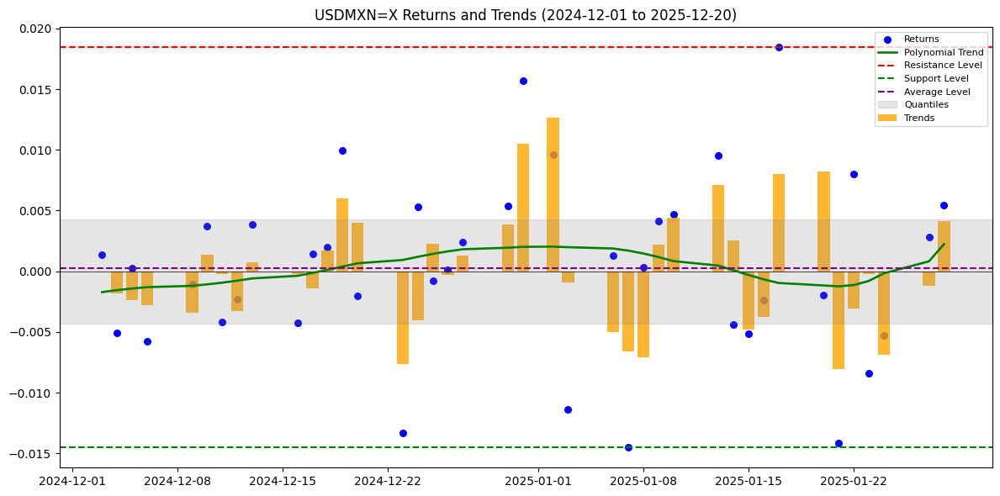

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
import yfinance as yf

# Define the start and end dates
start_date = "2024-12-01"
end_date = "2025-12-20"

# Define the list of tickers
tickers = [
    "USDMXN=X"
]

# Retrieve the data for all tickers using yfinance
data = yf.download(tickers, start=start_date, end=end_date, progress=False)["Close"]

# Handle missing data using `.ffill()` and `.bfill()`
data = data.ffill().bfill()  # Fill missing values forward and backward

# Calculate the returns and trends of each ticker
returns = data.pct_change().dropna()  # No need for `fill_method` after handling missing values
trends = returns.rolling(window=2).mean()

# Plot the returns and trends for each ticker
fig, axs = plt.subplots(nrows=len(tickers), figsize=(12, 6 * len(tickers)))

for i, ticker in enumerate(tickers):
    ax = axs[i] if len(tickers) > 1 else axs  # Handle single subplot scenario

    # Scatter plot for returns
    ax.scatter(returns.index, returns[ticker], label="Returns", color="blue", s=30)

    # Bar chart for trends
    ax.bar(trends.index, trends[ticker], label="Trends", color="orange", alpha=0.8, width=0.8)
    ax.axhline(0, color="black", linewidth=0.5)  # Add a horizontal line at 0

    # Polynomial trend line
    x = np.arange(len(returns))
    coef = np.polyfit(x, returns[ticker], deg=5)  # Fit a polynomial of degree 5
    poly_trend = np.polyval(coef, x)
    ax.plot(returns.index, poly_trend, label="Polynomial Trend", color="green", linewidth=1.9)

    # Support and Resistance Levels
    resistance_level = returns[ticker].max()
    support_level = returns[ticker].min()
    average_level = returns[ticker].mean()
    quantile_25 = returns[ticker].quantile(0.25)
    quantile_75 = returns[ticker].quantile(0.75)

    ax.axhline(resistance_level, color="red", linestyle="--", linewidth=1.5, label="Resistance Level")
    ax.axhline(support_level, color="green", linestyle="--", linewidth=1.5, label="Support Level")
    ax.axhline(average_level, color="purple", linestyle="--", linewidth=1.5, label="Average Level")
    ax.axhspan(quantile_25, quantile_75, color="gray", alpha=0.2, label="Quantiles")

    ax.set_title(f"{ticker} Returns and Trends ({start_date} to {end_date})")
    ax.legend(loc="upper right", fontsize=8)

plt.tight_layout()
plt.show()

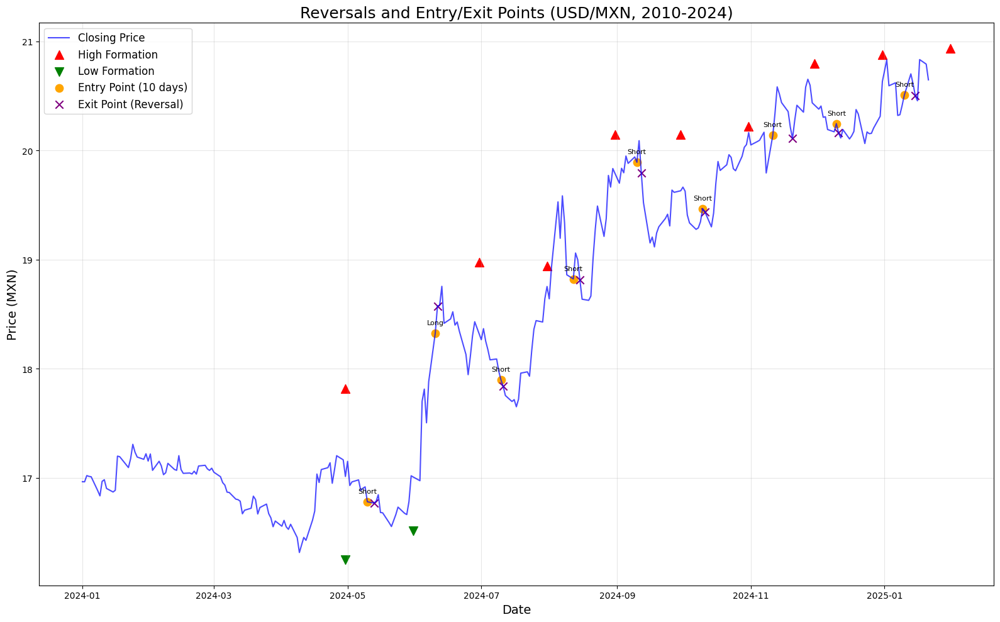

Sample Trade Entries:
  Formation_Date Entry_Date  Entry_Price  Exit_Date  Exit_Price Trade_Type
0     2024-04-30 2024-05-10    16.779499 2024-05-13   16.767200      Short
1     2024-05-31 2024-06-10    18.325850 2024-06-11   18.572210       Long
2     2024-06-30 2024-07-10    17.895340 2024-07-11   17.836531      Short
3     2024-07-31 2024-08-12    18.822189 2024-08-15   18.811701      Short
4     2024-08-31 2024-09-10    19.891371 2024-09-12   19.795900      Short


In [ ]:
import yfinance as yf
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Suppress FutureWarnings for cleaner output
import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

# Download data for USD/MXN from 2010 to 2024
ticker = "USDMXN=X"
data = yf.Ticker(ticker).history(interval="1d", start="2024-01-01", end="2025-12-31")
data.reset_index(inplace=True)  # Ensure 'Date' column exists
data['Date'] = pd.to_datetime(data['Date']).dt.tz_localize(None)  # Remove timezone info

# Resample data to monthly frequency to identify high and low formations
monthly_data = data.resample('ME', on='Date').agg({
    'High': 'max',
    'Low': 'min'
}).reset_index()

# Identify High and Low Formations
# A formation occurs if the current month's high/low is higher/lower than the previous N months
N = 3  # Number of months to look back for formation

monthly_data['High_Formation'] = monthly_data['High'] > monthly_data['High'].shift(N)
monthly_data['Low_Formation'] = monthly_data['Low'] < monthly_data['Low'].shift(N)

# Define the entry delay (10 days for this example)
entry_delay = 10

# Prepare the DataFrame for visualization
visualization_data = []
for _, row in monthly_data.iterrows():
    if row['High_Formation'] or row['Low_Formation']:
        # Calculate the entry date
        entry_date = row['Date'] + pd.Timedelta(days=entry_delay)

        # Ensure the entry_date does not exceed the data range
        if entry_date > data['Date'].max():
            continue

        # Find the closest trading day on or after the entry_date
        post_entry_data = data[data['Date'] >= entry_date]
        if post_entry_data.empty:
            continue  # Skip if no data exists after the entry date

        entry_price = post_entry_data.iloc[0]['Close']
        actual_entry_date = post_entry_data.iloc[0]['Date']

        # Calculate reversal points
        if row['High_Formation']:
            # For High Formation: Measure downward reversal
            reversal_data = post_entry_data[post_entry_data['Close'] < entry_price]
            if not reversal_data.empty:
                exit_row = reversal_data.iloc[0]
                exit_date = exit_row['Date']
                exit_price = exit_row['Close']
                trade_type = 'Short'
            else:
                exit_date = np.nan
                exit_price = np.nan
                trade_type = 'Short'
        elif row['Low_Formation']:
            # For Low Formation: Measure upward reversal
            reversal_data = post_entry_data[post_entry_data['Close'] > entry_price]
            if not reversal_data.empty:
                exit_row = reversal_data.iloc[0]
                exit_date = exit_row['Date']
                exit_price = exit_row['Close']
                trade_type = 'Long'
            else:
                exit_date = np.nan
                exit_price = np.nan
                trade_type = 'Long'

        # Store the data for visualization
        visualization_data.append({
            'Formation_Date': row['Date'],
            'Entry_Date': actual_entry_date,
            'Entry_Price': entry_price,
            'Exit_Date': exit_date,
            'Exit_Price': exit_price,
            'Trade_Type': trade_type
        })

# Convert to DataFrame
visualization_df = pd.DataFrame(visualization_data)

# Plot the chart
plt.figure(figsize=(16, 10))

# Plot closing prices
plt.plot(data['Date'], data['Close'], label='Closing Price', color='blue', alpha=0.7)

# Mark high formations
high_formations = monthly_data[monthly_data['High_Formation']]
plt.scatter(high_formations['Date'],
            high_formations['High'],
            color='red', label='High Formation', marker='^', s=100)

# Mark low formations
low_formations = monthly_data[monthly_data['Low_Formation']]
plt.scatter(low_formations['Date'],
            low_formations['Low'],
            color='green', label='Low Formation', marker='v', s=100)

# Mark entry points
plt.scatter(visualization_df['Entry_Date'], visualization_df['Entry_Price'],
            color='orange', label='Entry Point (10 days)', marker='o', s=80)

# Mark exit points
# Exclude entries where exit_date is NaN
exit_points = visualization_df.dropna(subset=['Exit_Date'])
plt.scatter(exit_points['Exit_Date'], exit_points['Exit_Price'],
            color='purple', label='Exit Point (Reversal)', marker='x', s=80)

# Enhance Plot with Annotations (Optional)
for idx, trade in exit_points.iterrows():
    plt.annotate(trade['Trade_Type'],
                 (trade['Entry_Date'], trade['Entry_Price']),
                 textcoords="offset points",
                 xytext=(0,10),
                 ha='center',
                 fontsize=8,
                 color='black')

# Add labels and legend
plt.title(f"Reversals and Entry/Exit Points (USD/MXN, 2010-2024)", fontsize=18)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Price (MXN)', fontsize=14)
plt.legend(fontsize=12)
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()

# Display the first few rows of the visualization DataFrame
print("Sample Trade Entries:")
print(visualization_df.head())


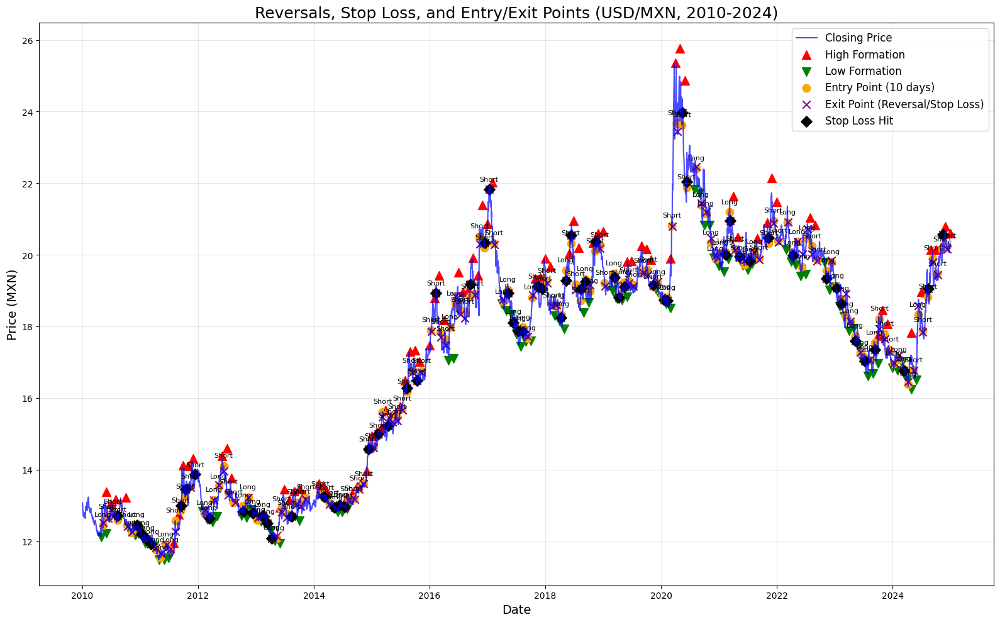

Sample Trade Entries:
  Formation_Date Entry_Date  Entry_Price  Stop_Loss  Exit_Date  Exit_Price  \
0     2010-04-30 2010-05-10      12.4471   12.44610 2010-05-11    12.51429   
1     2010-05-31 2010-06-10      12.6847   12.87400 2010-06-11    12.64960   
2     2010-06-30 2010-07-12      12.8188   12.83953 2010-07-13    12.67300   
3     2010-07-31 2010-08-10      12.5960   12.71970 2010-08-11    12.71970   
4     2010-09-30 2010-10-11      12.4520   12.46000 2010-10-12    12.40700   

    Profit Trade_Type  Cumulative_Profit  
0  0.06719       Long            0.06719  
1  0.03510      Short            0.10229  
2  0.14580      Short            0.24809  
3 -0.12370      Short            0.12439  
4  0.04500      Short            0.16939  

--- Performance Metrics ---
Total Number of Trades: 163
Profitable Trades: 100
Win Rate: 61.35%
Average Profit/Loss per Trade: 0.0109 MXN
Cumulative Profit/Loss: 1.7830 MXN
Maximum Drawdown: 1.4842 MXN
Sharpe Ratio: 1.3309


In [ ]:
import yfinance as yf
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from datetime import timedelta
import warnings

# Suppress FutureWarnings for cleaner output
warnings.simplefilter(action='ignore', category=FutureWarning)

# Download data for USD/MXN from 2010 to 2024
ticker = "USDMXN=X"
data = yf.Ticker(ticker).history(interval="1d", start="2010-01-01", end="2024-12-31")
data.reset_index(inplace=True)  # Ensure 'Date' column exists
data['Date'] = pd.to_datetime(data['Date']).dt.tz_localize(None)  # Remove timezone info

# Resample data to monthly frequency to identify high and low formations
monthly_data = data.resample('ME', on='Date').agg({
    'High': 'max',
    'Low': 'min'
}).reset_index()

# Identify High and Low Formations
# A formation occurs if the current month's high/low is higher/lower than the previous N months
N = 3  # Number of months to look back for formation

monthly_data['High_Formation'] = monthly_data['High'] > monthly_data['High'].shift(N)
monthly_data['Low_Formation'] = monthly_data['Low'] < monthly_data['Low'].shift(N)

# Define the entry delay (10 days for this example)
entry_delay = 10

# Define stop loss offset (e.g., 0 for using exact low/high of entry day)
# Since the user wants stop loss below the low of the entry day for Longs and above the high for Shorts
# We can set stop loss exactly at that level
# Alternatively, you can add a buffer (e.g., 0.5%) by modifying the stop loss calculation

# Prepare the DataFrame for visualization and performance metrics
visualization_data = []
for _, row in monthly_data.iterrows():
    if row['High_Formation'] or row['Low_Formation']:
        # Calculate the entry date
        entry_date = row['Date'] + pd.Timedelta(days=entry_delay)

        # Ensure the entry_date does not exceed the data range
        if entry_date > data['Date'].max():
            continue

        # Find the closest trading day on or after the entry_date
        post_entry_data = data[data['Date'] >= entry_date]
        if post_entry_data.empty:
            continue  # Skip if no data exists after the entry date

        entry_row = post_entry_data.iloc[0]
        entry_price = entry_row['Close']
        actual_entry_date = entry_row['Date']

        # Determine stop loss based on trade type
        if row['High_Formation']:
            trade_type = 'Short'
            stop_loss = entry_row['High']  # Stop loss above the high of entry day
            # For Shorts, if price rises to stop_loss before reversal, exit at stop_loss
        elif row['Low_Formation']:
            trade_type = 'Long'
            stop_loss = entry_row['Low']  # Stop loss below the low of entry day
            # For Longs, if price falls to stop_loss before reversal, exit at stop_loss

        # Initialize exit variables
        exit_date = np.nan
        exit_price = np.nan

        # Iterate over post_entry_data to find the first event: reversal or stop loss
        for idx, trade_row in post_entry_data.iterrows():
            current_price = trade_row['Close']
            current_date = trade_row['Date']

            if trade_type == 'Short':
                # Check for reversal (price < entry_price) or stop loss (price > stop_loss)
                if current_price < entry_price:
                    exit_date = current_date
                    exit_price = current_price
                    break  # Reversal occurred
                elif current_price > stop_loss:
                    exit_date = current_date
                    exit_price = stop_loss  # Exit at stop loss price
                    break  # Stop loss triggered
            elif trade_type == 'Long':
                # Check for reversal (price > entry_price) or stop loss (price < stop_loss)
                if current_price > entry_price:
                    exit_date = current_date
                    exit_price = current_price
                    break  # Reversal occurred
                elif current_price < stop_loss:
                    exit_date = current_date
                    exit_price = stop_loss  # Exit at stop loss price
                    break  # Stop loss triggered

        # Calculate profit or loss
        if trade_type == 'Short' and not pd.isna(exit_price):
            profit = entry_price - exit_price  # Profit for Short: entry - exit
        elif trade_type == 'Long' and not pd.isna(exit_price):
            profit = exit_price - entry_price  # Profit for Long: exit - entry
        else:
            profit = 0  # No exit occurred

        # Store the data for visualization and metrics
        visualization_data.append({
            'Formation_Date': row['Date'],
            'Entry_Date': actual_entry_date,
            'Entry_Price': entry_price,
            'Stop_Loss': stop_loss,
            'Exit_Date': exit_date,
            'Exit_Price': exit_price,
            'Profit': profit,
            'Trade_Type': trade_type
        })

# Convert to DataFrame
visualization_df = pd.DataFrame(visualization_data)

# Calculate Cumulative Profit/Loss
visualization_df['Cumulative_Profit'] = visualization_df['Profit'].cumsum()

# Calculate Maximum Drawdown
cumulative_profit = visualization_df['Cumulative_Profit']
rolling_max = cumulative_profit.cummax()
drawdown = rolling_max - cumulative_profit
max_drawdown = drawdown.max()

# Calculate Win Rate
total_trades = len(visualization_df)
profitable_trades = len(visualization_df[visualization_df['Profit'] > 0])
win_rate = (profitable_trades / total_trades) * 100 if total_trades > 0 else 0

# Calculate Average Profit/Loss per Trade
average_profit = visualization_df['Profit'].mean()

# Calculate Sharpe Ratio
# Assuming risk-free rate is 0 for simplicity
sharpe_ratio = visualization_df['Profit'].mean() / visualization_df['Profit'].std() * np.sqrt(252) if visualization_df['Profit'].std() != 0 else np.nan

# Plot the chart
plt.figure(figsize=(16, 10))

# Plot closing prices
plt.plot(data['Date'], data['Close'], label='Closing Price', color='blue', alpha=0.7)

# Mark high formations
high_formations = monthly_data[monthly_data['High_Formation']]
plt.scatter(high_formations['Date'],
            high_formations['High'],
            color='red', label='High Formation', marker='^', s=100)

# Mark low formations
low_formations = monthly_data[monthly_data['Low_Formation']]
plt.scatter(low_formations['Date'],
            low_formations['Low'],
            color='green', label='Low Formation', marker='v', s=100)

# Mark entry points
plt.scatter(visualization_df['Entry_Date'], visualization_df['Entry_Price'],
            color='orange', label='Entry Point (10 days)', marker='o', s=80)

# Mark exit points
# Exclude entries where exit_date is NaN
exit_points = visualization_df.dropna(subset=['Exit_Date'])
plt.scatter(exit_points['Exit_Date'], exit_points['Exit_Price'],
            color='purple', label='Exit Point (Reversal/Stop Loss)', marker='x', s=80)

# Mark stop loss points
# Only plot stop loss points where stop loss was hit
stop_loss_hits = visualization_df[~visualization_df['Exit_Price'].isna() &
                                  (
                                      ((visualization_df['Trade_Type'] == 'Short') &
                                       (visualization_df['Exit_Price'] == visualization_df['Stop_Loss'])) |
                                      ((visualization_df['Trade_Type'] == 'Long') &
                                       (visualization_df['Exit_Price'] == visualization_df['Stop_Loss']))
                                  )]
plt.scatter(stop_loss_hits['Exit_Date'], stop_loss_hits['Exit_Price'],
            color='black', label='Stop Loss Hit', marker='D', s=80)

# Enhance Plot with Annotations (Optional)
for idx, trade in exit_points.iterrows():
    plt.annotate(trade['Trade_Type'],
                 (trade['Entry_Date'], trade['Entry_Price']),
                 textcoords="offset points",
                 xytext=(0,10),
                 ha='center',
                 fontsize=8,
                 color='black')

# Add labels and legend
plt.title(f"Reversals, Stop Loss, and Entry/Exit Points (USD/MXN, 2010-2024)", fontsize=18)
plt.xlabel('Date', fontsize=14)
plt.ylabel('Price (MXN)', fontsize=14)
plt.legend(fontsize=12)
plt.grid(alpha=0.3)
plt.tight_layout()
plt.show()

# Display the first few rows of the visualization DataFrame
print("Sample Trade Entries:")
print(visualization_df.head())

# Display Performance Metrics
print("\n--- Performance Metrics ---")
print(f"Total Number of Trades: {total_trades}")
print(f"Profitable Trades: {profitable_trades}")
print(f"Win Rate: {win_rate:.2f}%")
print(f"Average Profit/Loss per Trade: {average_profit:.4f} MXN")
print(f"Cumulative Profit/Loss: {visualization_df['Cumulative_Profit'].iloc[-1]:.4f} MXN")
print(f"Maximum Drawdown: {max_drawdown:.4f} MXN")
print(f"Sharpe Ratio: {sharpe_ratio:.4f}")


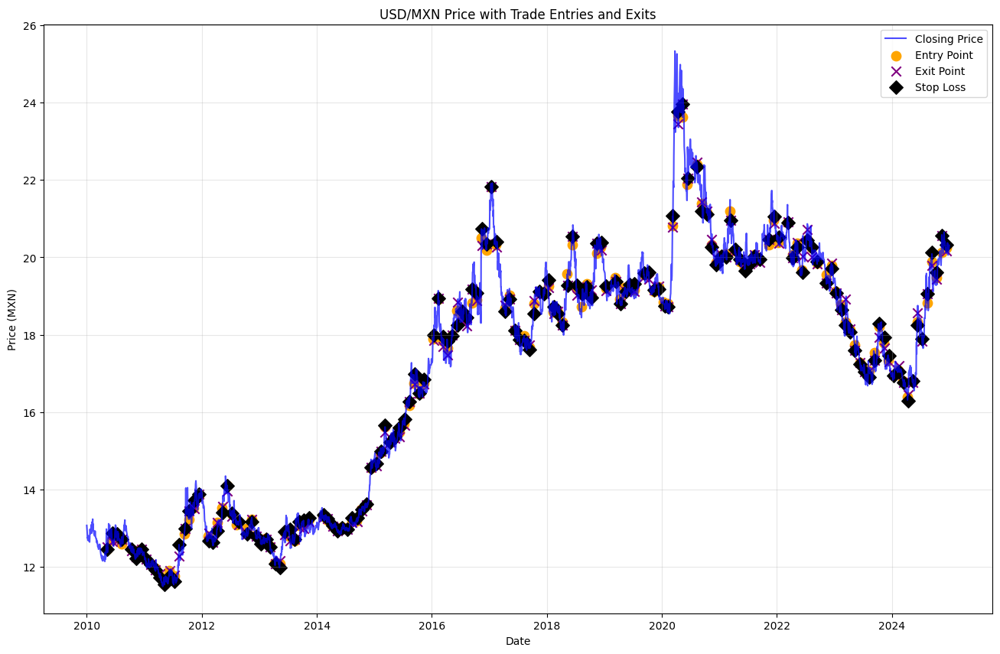


--- Performance Metrics ---
Total Number of Trades: 163
Profitable Trades: 100
Win Rate: 61.35%
Average Profit/Loss per Trade: 0.0109 MXN
Cumulative Profit/Loss: 1.7830 MXN
Sharpe Ratio: 1.3309


In [ ]:
import yfinance as yf
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from datetime import timedelta

# Download data for USD/MXN from 2010 to 2024
ticker = "USDMXN=X"
data = yf.Ticker(ticker).history(interval="1d", start="2010-01-01", end="2024-12-31")
data.reset_index(inplace=True)
data['Date'] = pd.to_datetime(data['Date']).dt.tz_localize(None)

# Resample data to monthly frequency to identify high and low formations
monthly_data = data.resample('ME', on='Date').agg({'High': 'max', 'Low': 'min'}).reset_index()

# Identify High and Low Formations
N = 3
monthly_data['High_Formation'] = monthly_data['High'] > monthly_data['High'].shift(N)
monthly_data['Low_Formation'] = monthly_data['Low'] < monthly_data['Low'].shift(N)

# Define entry delay
entry_delay = 10
visualization_data = []
for _, row in monthly_data.iterrows():
    if row['High_Formation'] or row['Low_Formation']:
        entry_date = row['Date'] + timedelta(days=entry_delay)
        if entry_date > data['Date'].max():
            continue
        post_entry_data = data[data['Date'] >= entry_date]
        if post_entry_data.empty:
            continue
        entry_row = post_entry_data.iloc[0]
        entry_price = entry_row['Close']
        actual_entry_date = entry_row['Date']
        trade_type = 'Short' if row['High_Formation'] else 'Long'
        stop_loss = entry_row['High'] if trade_type == 'Short' else entry_row['Low']
        exit_date, exit_price = np.nan, np.nan
        for _, trade_row in post_entry_data.iterrows():
            if (trade_type == 'Short' and trade_row['Close'] > stop_loss) or \
               (trade_type == 'Long' and trade_row['Close'] < stop_loss):
                exit_date, exit_price = trade_row['Date'], stop_loss
                break
            elif (trade_type == 'Short' and trade_row['Close'] < entry_price):
                exit_date, exit_price = trade_row['Date'], trade_row['Close']
                break
            elif (trade_type == 'Long' and trade_row['Close'] > entry_price):
                exit_date, exit_price = trade_row['Date'], trade_row['Close']
                break
        profit = (entry_price - exit_price) if trade_type == 'Short' else (exit_price - entry_price)
        visualization_data.append({
            'Formation_Date': row['Date'], 'Entry_Date': actual_entry_date, 'Entry_Price': entry_price,
            'Stop_Loss': stop_loss, 'Exit_Date': exit_date, 'Exit_Price': exit_price,
            'Profit': profit, 'Trade_Type': trade_type
        })

visualization_df = pd.DataFrame(visualization_data)
visualization_df['Cumulative_Profit'] = visualization_df['Profit'].cumsum()

# Performance Metrics
total_trades = len(visualization_df)
profitable_trades = len(visualization_df[visualization_df['Profit'] > 0])
win_rate = (profitable_trades / total_trades) * 100 if total_trades > 0 else 0
average_profit = visualization_df['Profit'].mean()
sharpe_ratio = visualization_df['Profit'].mean() / visualization_df['Profit'].std() * np.sqrt(252) if visualization_df['Profit'].std() != 0 else np.nan

# Plot with Matplotlib
plt.figure(figsize=(16, 10))
plt.plot(data['Date'], data['Close'], label='Closing Price', color='blue', alpha=0.7)
plt.scatter(visualization_df['Entry_Date'], visualization_df['Entry_Price'], color='orange', label='Entry Point', marker='o', s=80)
plt.scatter(visualization_df['Exit_Date'], visualization_df['Exit_Price'], color='purple', label='Exit Point', marker='x', s=80)
plt.scatter(visualization_df['Exit_Date'], visualization_df['Stop_Loss'], color='black', label='Stop Loss', marker='D', s=80)
plt.xlabel('Date')
plt.ylabel('Price (MXN)')
plt.title('USD/MXN Price with Trade Entries and Exits')
plt.legend()
plt.grid(alpha=0.3)
plt.show()

# Print Performance Metrics
print("\n--- Performance Metrics ---")
print(f"Total Number of Trades: {total_trades}")
print(f"Profitable Trades: {profitable_trades}")
print(f"Win Rate: {win_rate:.2f}%")
print(f"Average Profit/Loss per Trade: {average_profit:.4f} MXN")
print(f"Cumulative Profit/Loss: {visualization_df['Cumulative_Profit'].iloc[-1]:.4f} MXN")
print(f"Sharpe Ratio: {sharpe_ratio:.4f}")


In [ ]:
import yfinance as yf
import pandas as pd
import numpy as np
import plotly.graph_objects as go

# Download data for USD/MXN from 2010 to 2024
ticker = "USDMXN=X"
data = yf.Ticker(ticker).history(interval="1d", start="2010-01-01", end="2024-12-31")
data.reset_index(inplace=True)  # Ensure 'Date' column exists
data['Date'] = pd.to_datetime(data['Date']).dt.tz_localize(None)  # Remove timezone info

# Resample data to monthly frequency to identify high and low formations
monthly_data = data.resample('ME', on='Date').agg({
    'High': 'max',
    'Low': 'min'
}).reset_index()

# Identify High and Low Formations
N = 3  # Number of months to look back
monthly_data['High_Formation'] = monthly_data['High'] > monthly_data['High'].shift(N)
monthly_data['Low_Formation'] = monthly_data['Low'] < monthly_data['Low'].shift(N)

# Define entry delay and prepare visualization data
entry_delay = 10
visualization_data = []
for _, row in monthly_data.iterrows():
    if row['High_Formation'] or row['Low_Formation']:
        entry_date = row['Date'] + pd.Timedelta(days=entry_delay)
        if entry_date > data['Date'].max():
            continue
        post_entry_data = data[data['Date'] >= entry_date]
        if post_entry_data.empty:
            continue
        entry_row = post_entry_data.iloc[0]
        entry_price = entry_row['Close']
        actual_entry_date = entry_row['Date']
        trade_type = 'Short' if row['High_Formation'] else 'Long'
        stop_loss = entry_row['High'] if trade_type == 'Short' else entry_row['Low']

        exit_date, exit_price = np.nan, np.nan
        for _, trade_row in post_entry_data.iterrows():
            if (trade_type == 'Short' and trade_row['Close'] > stop_loss) or \
               (trade_type == 'Long' and trade_row['Close'] < stop_loss):
                exit_date, exit_price = trade_row['Date'], stop_loss
                break
            elif (trade_type == 'Short' and trade_row['Close'] < entry_price):
                exit_date, exit_price = trade_row['Date'], trade_row['Close']
                break
            elif (trade_type == 'Long' and trade_row['Close'] > entry_price):
                exit_date, exit_price = trade_row['Date'], trade_row['Close']
                break

        visualization_data.append({
            'Formation_Date': row['Date'], 'Entry_Date': actual_entry_date, 'Entry_Price': entry_price,
            'Stop_Loss': stop_loss, 'Exit_Date': exit_date, 'Exit_Price': exit_price,
            'Trade_Type': trade_type
        })

visualization_df = pd.DataFrame(visualization_data)

# Create Plotly Figure
fig = go.Figure()

# Line plot for Closing Prices
fig.add_trace(go.Scatter(x=data['Date'], y=data['Close'], mode='lines', name='Closing Price', line=dict(color='blue')))

# High & Low Formations
fig.add_trace(go.Scatter(x=monthly_data['Date'][monthly_data['High_Formation']],
                         y=monthly_data['High'][monthly_data['High_Formation']],
                         mode='markers', marker=dict(color='red', symbol='triangle-up', size=10), name='High Formation'))
fig.add_trace(go.Scatter(x=monthly_data['Date'][monthly_data['Low_Formation']],
                         y=monthly_data['Low'][monthly_data['Low_Formation']],
                         mode='markers', marker=dict(color='green', symbol='triangle-down', size=10), name='Low Formation'))

# Entry & Exit Points
fig.add_trace(go.Scatter(x=visualization_df['Entry_Date'], y=visualization_df['Entry_Price'],
                         mode='markers', marker=dict(color='orange', size=8), name='Entry Point'))
fig.add_trace(go.Scatter(x=visualization_df['Exit_Date'], y=visualization_df['Exit_Price'],
                         mode='markers', marker=dict(color='purple', size=8), name='Exit Point'))

# Stop Loss Points
stop_loss_hits = visualization_df.dropna(subset=['Exit_Date'])
fig.add_trace(go.Scatter(x=stop_loss_hits['Exit_Date'], y=stop_loss_hits['Stop_Loss'],
                         mode='markers', marker=dict(color='black', symbol='diamond', size=10), name='Stop Loss'))

# Layout Adjustments
fig.update_layout(title="USD/MXN Closing Prices with Trades", xaxis_title="Date", yaxis_title="Price (MXN)",
                  template='plotly_white', height=600)
fig.show()


[*********************100%***********************]  1 of 1 completed


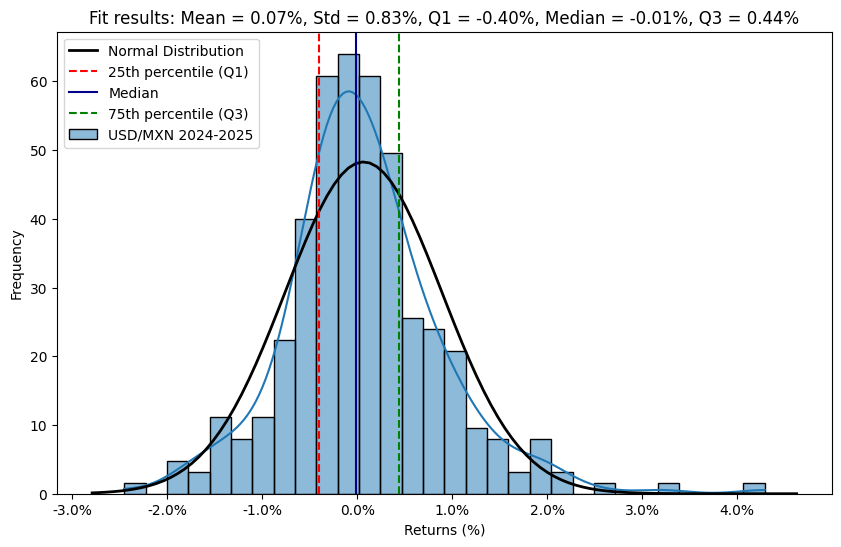

In [ ]:
import pandas as pd
import numpy as np
import yfinance as yf
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import norm
from matplotlib.ticker import FuncFormatter

# Define the start and end dates for the data retrieval
start_date = "2024-01-01"
end_date = "2025-12-30"

# Define the ticker for USD/MXN
sp_ticker = "USDMXN=X"

# Retrieve the data for USD/MXN using yfinance
data = yf.download(sp_ticker, start=start_date, end=end_date)["Close"]

# Calculate daily returns for USD/MXN
sp_returns = data.pct_change().dropna()

# Fit a normal distribution to the returns
mu, std = norm.fit(sp_returns)

# Plot the histogram and KDE for USD/MXN returns
plt.figure(figsize=(10, 6))
sns.histplot(sp_returns, bins=30, kde=True, color='blue', label='USD/MXN 2024-2025', stat="density")

# Plot the normal distribution with the same mean and standard deviation
xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)
p = norm.pdf(x, mu, std)
plt.plot(x, p, 'k', linewidth=2, label='Normal Distribution')

# Quantile values for the box plot percentiles, ensuring they are scalars
q1 = sp_returns.quantile(0.25).item()
median = sp_returns.quantile(0.5).item()
q3 = sp_returns.quantile(0.75).item()

# Plot quantile lines
plt.axvline(q1, color='red', linestyle='--', label='25th percentile (Q1)')
plt.axvline(median, color='darkblue', linestyle='-', label='Median')
plt.axvline(q3, color='green', linestyle='--', label='75th percentile (Q3)')

# Calculate title with mean, standard deviation, and quantiles
title = f"Fit results: Mean = {mu*100:.2f}%, Std = {std*100:.2f}%, " \
        f"Q1 = {q1*100:.2f}%, Median = {median*100:.2f}%, " \
        f"Q3 = {q3*100:.2f}%"
plt.title(title)

# Format the x-axis as percentages
plt.gca().xaxis.set_major_formatter(FuncFormatter(lambda x, _: f"{x*100:.1f}%"))

# Add labels and legend
plt.xlabel('Returns (%)')
plt.ylabel('Frequency')
plt.legend(loc='upper left')

# Show the plot
plt.show()


In [ ]:
import pandas as pd
import numpy as np
import yfinance as yf
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import norm

# Define the start and end dates for the data retrieval
start_date = "2024-01-01"
end_date = "2025-12-01"

# Define the tickers for S&P 500, NASDAQ, Russell 2000, Dow 30, and Dollar Index
tickers = [
    "EURUSD=X", "GBPUSD=X", "USDJPY=X", "AUDUSD=X", "USDCAD=X", "USDCHF=X", "NZDUSD=X",
    "EURGBP=X", "EURJPY=X", "EURCHF=X", "EURAUD=X", "EURCAD=X", "EURNZD=X",
    "GBPJPY=X", "GBPCHF=X", "GBPAUD=X", "GBPCAD=X", "GBPNZD=X",
    "AUDJPY=X", "AUDCHF=X", "AUDCAD=X", "AUDNZD=X",
    "CADJPY=X", "CADCHF=X", "NZDJPY=X", "NZDCHF=X",
    "CHFJPY=X", "NZDCAD=X", "USDSGD=X", "USDMXN=X",
    "^GSPC", "^DJI", "^IXIC", "^RUT", "BTC-USD"
]

# Retrieve the data for the tickers using yfinance
data = yf.download(tickers, start=start_date, end=end_date)["Close"]

# Calculate daily returns for all tickers
daily_returns = data.pct_change(fill_method=None).dropna()

# Loop through each ticker and plot its distribution on separate charts
for ticker in tickers:
    # Extract the daily returns for the specific ticker
    ticker_returns = daily_returns[ticker].dropna()

    # Fit a normal distribution to the data
    mu, std = norm.fit(ticker_returns)

    # Create a new figure for each index
    plt.figure(figsize=(10, 6))

    # Plot the histogram and KDE for returns
    sns.histplot(ticker_returns, bins=30, kde=True, color='blue', label=f'{ticker} Returns', stat="density")

    # Plot the normal distribution with the same mean and standard deviation
    xmin, xmax = plt.xlim()
    x = np.linspace(xmin, xmax, 100)
    p = norm.pdf(x, mu, std)
    plt.plot(x, p, 'k', linewidth=2, label='Normal Distribution')

    # Plot quantile lines
    quantiles = ticker_returns.quantile([0.25, 0.5, 0.75])
    plt.axvline(quantiles[0.25], color='red', linestyle='--', linewidth=1.5, label='25th percentile (Q1)')
    plt.axvline(quantiles[0.5], color='darkblue', linestyle='-', linewidth=1.5, label='Median')
    plt.axvline(quantiles[0.75], color='green', linestyle='--', linewidth=1.5, label='75th percentile (Q3)')

    # Add title, labels, and legend
    plt.title(f"{ticker} Returns Distribution with Quantiles and Normal Distribution")
    plt.xlabel('Returns')
    plt.ylabel('Density')
    plt.legend()

    # Show the plot
    plt.show()

    },
    "LATAM": {
        "USDMXN=X": "Mexican Peso (MXN)",
        "USDBRL=X": "Brazilian Real (BRL)",
        "USDCOP=X": "Colombian Peso (COP)",
        "USDARS=X": "Argentine Peso (ARS)",
        "USDCLP=X": "Chilean Peso (CLP)",
    },

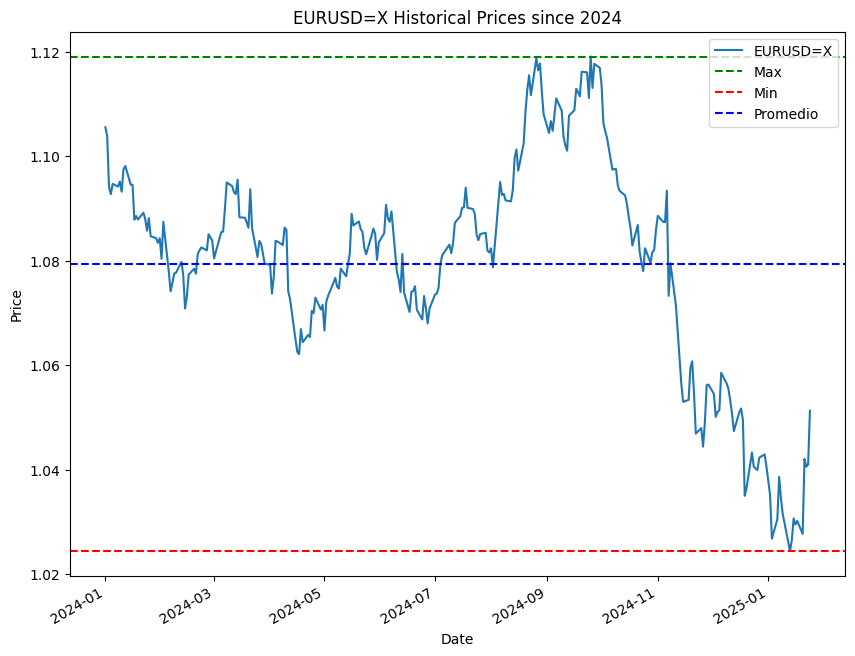

EURUSD=X missing values: 0


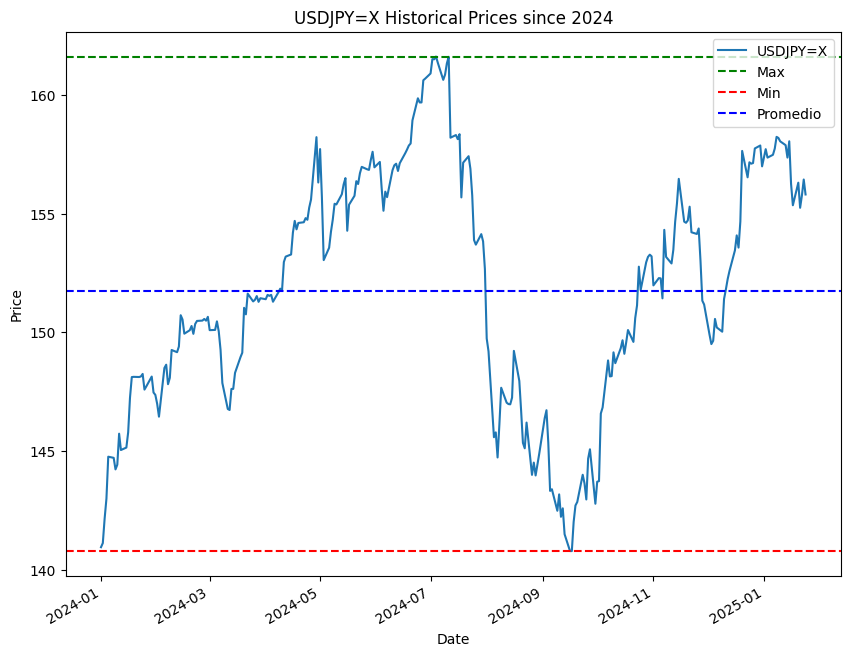

USDJPY=X missing values: 0


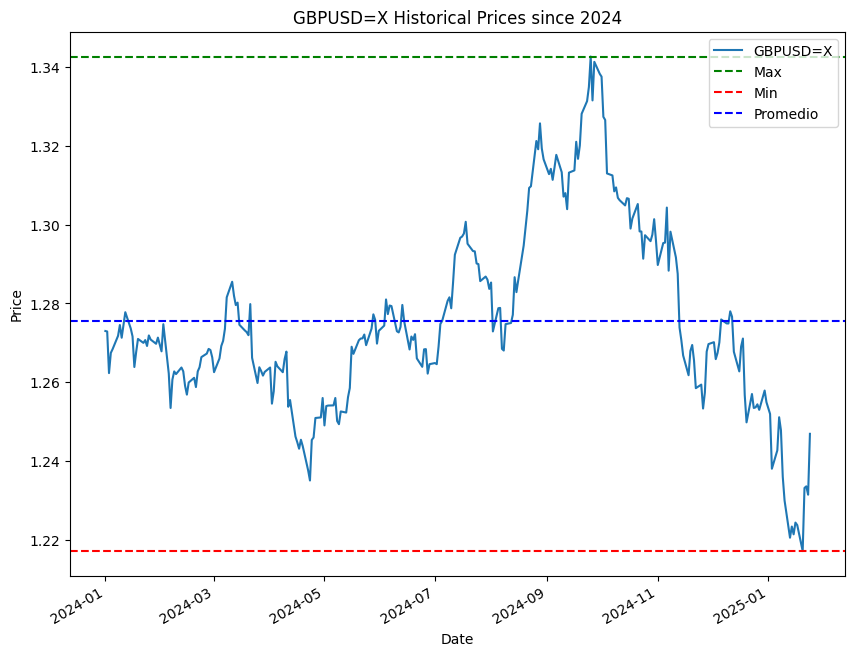

GBPUSD=X missing values: 0


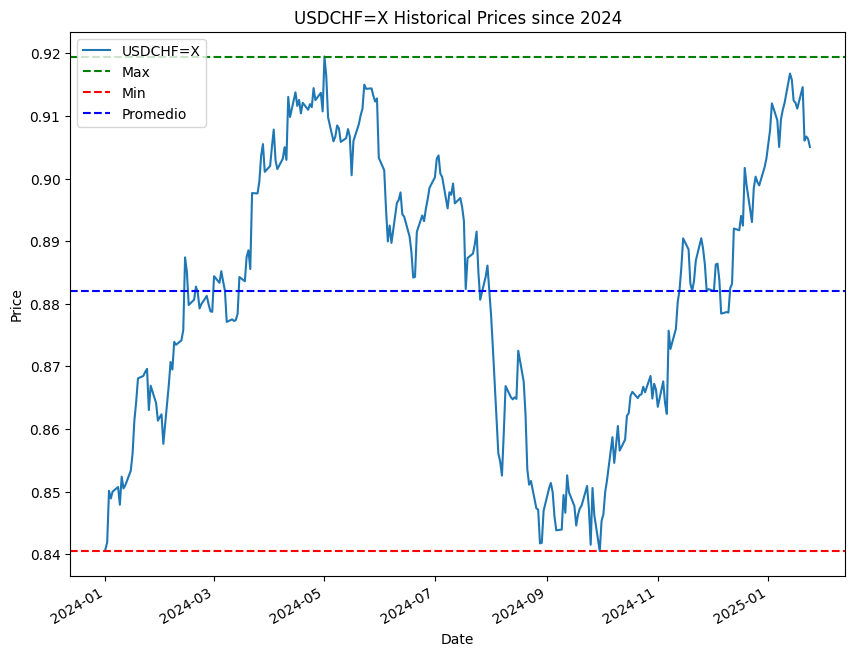

USDCHF=X missing values: 0


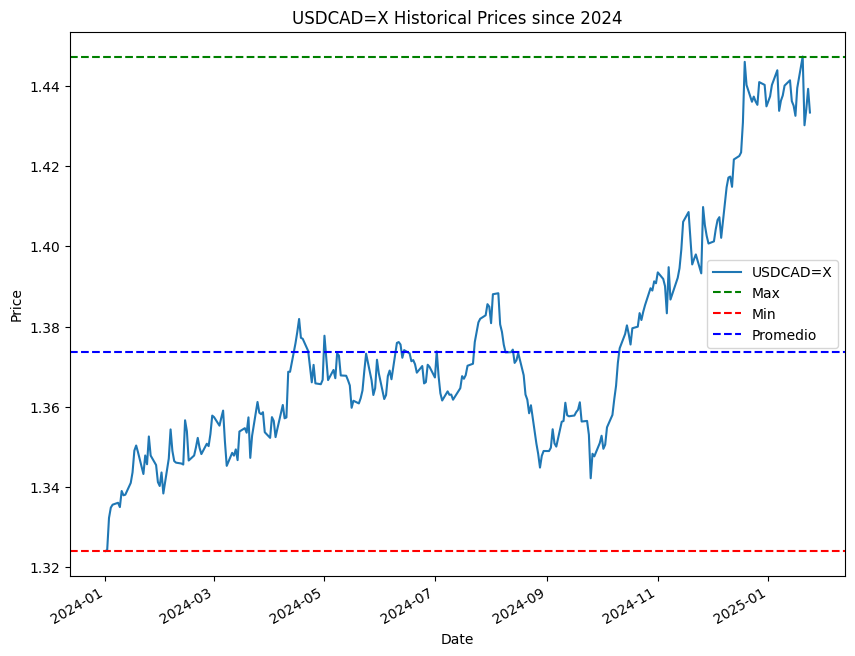

USDCAD=X missing values: 0


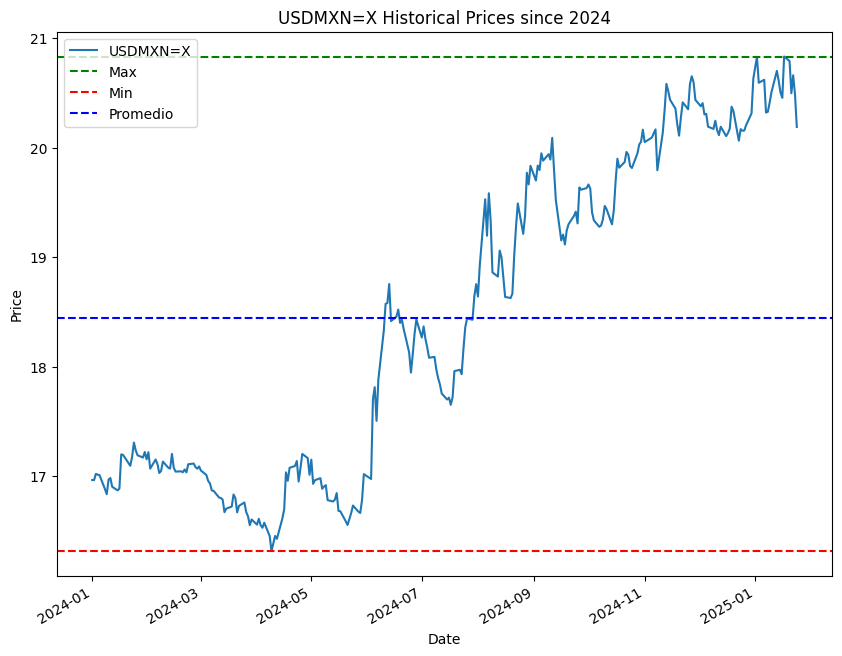

USDMXN=X missing values: 0


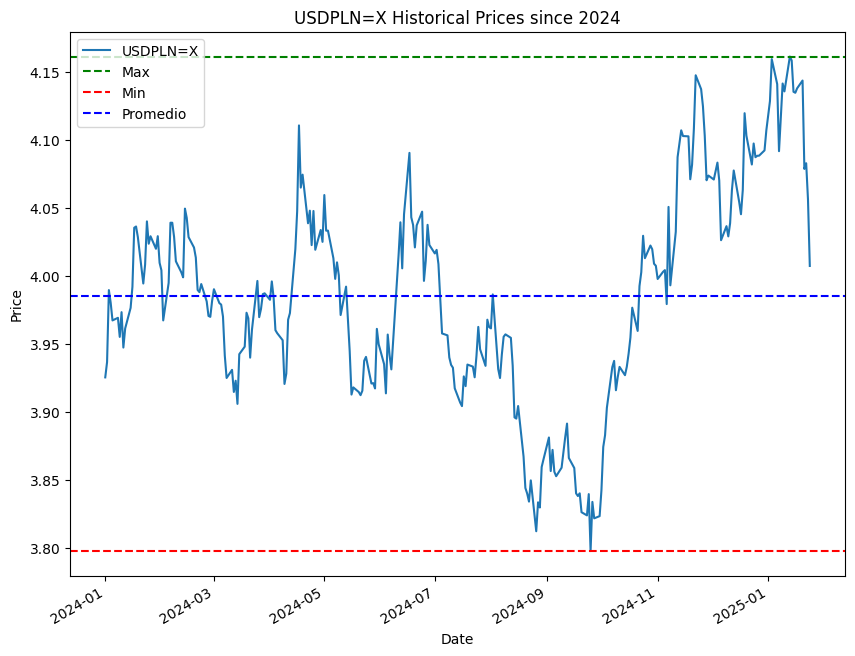

USDPLN=X missing values: 0


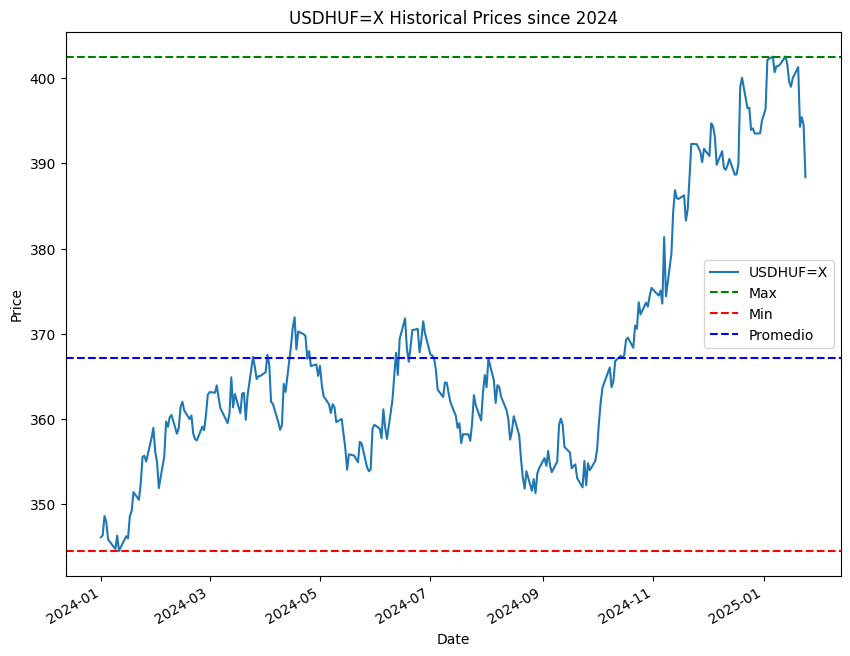

USDHUF=X missing values: 0


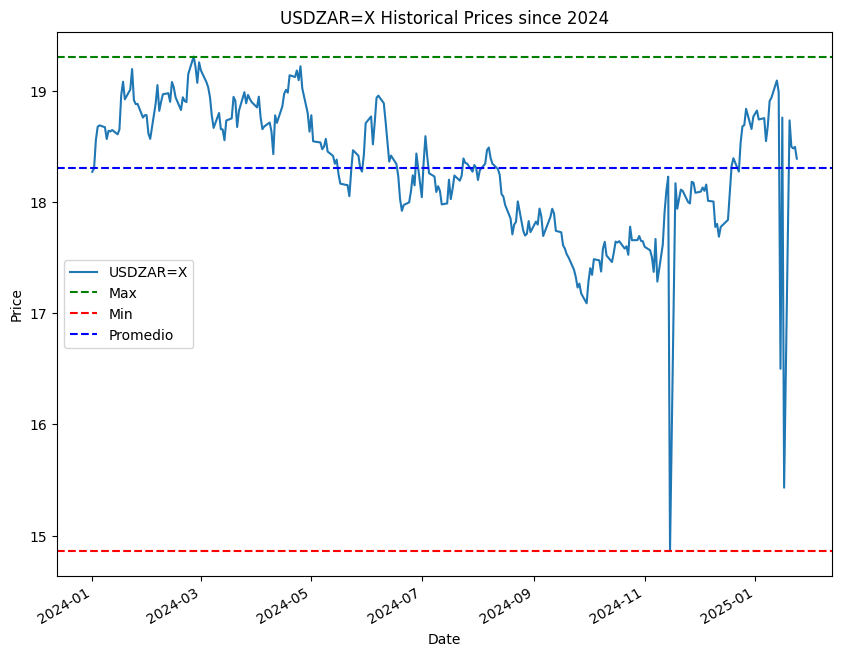

USDZAR=X missing values: 0


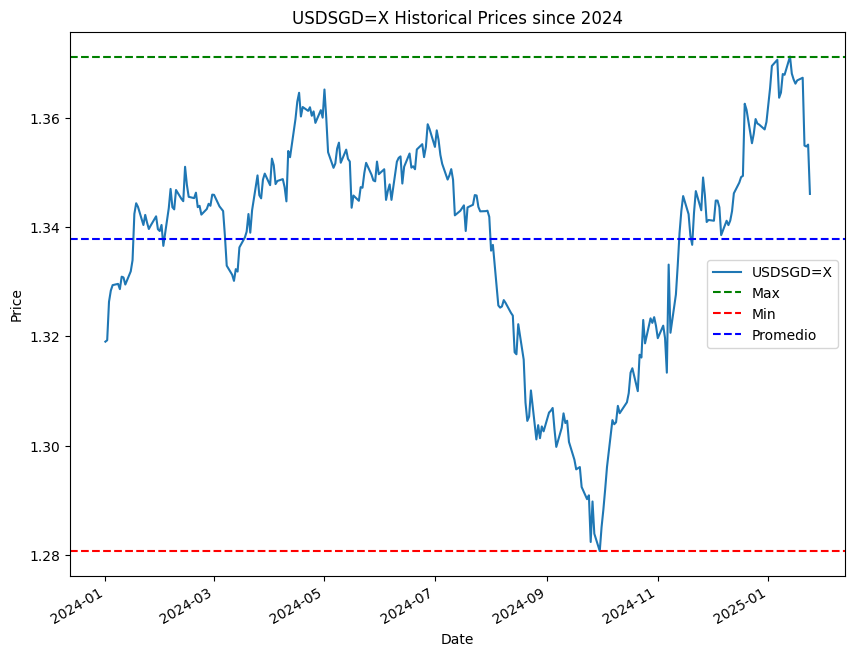

USDSGD=X missing values: 0


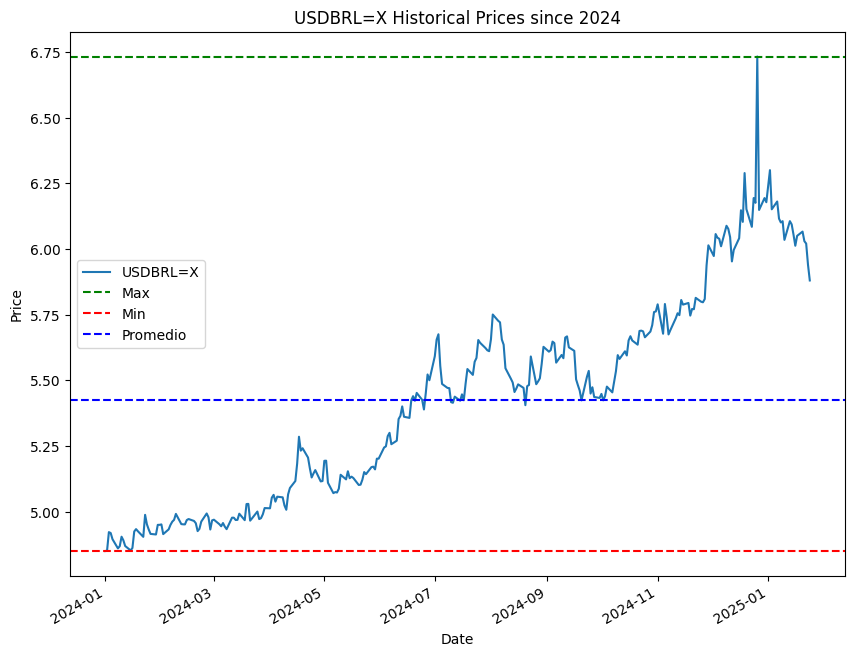

USDBRL=X missing values: 0


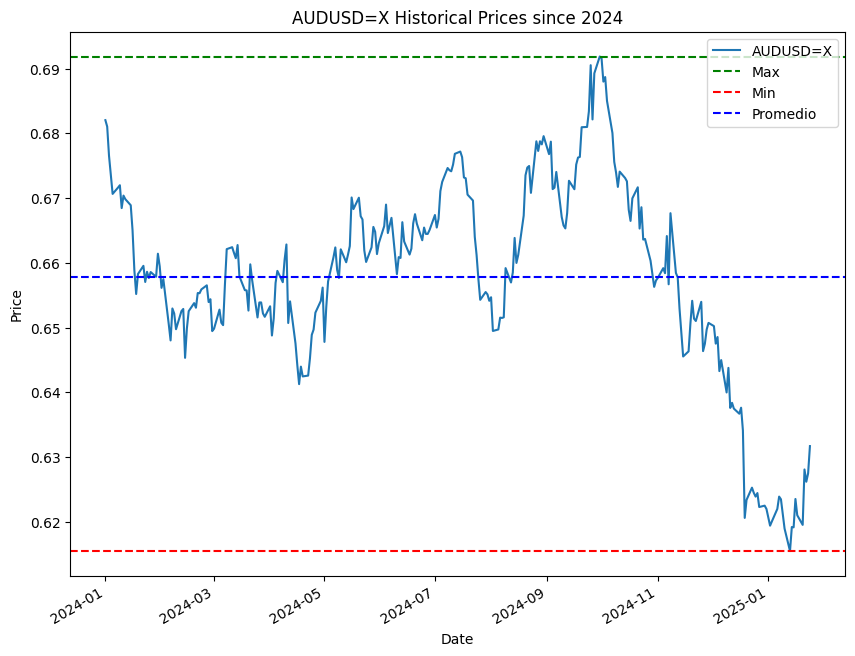

AUDUSD=X missing values: 0


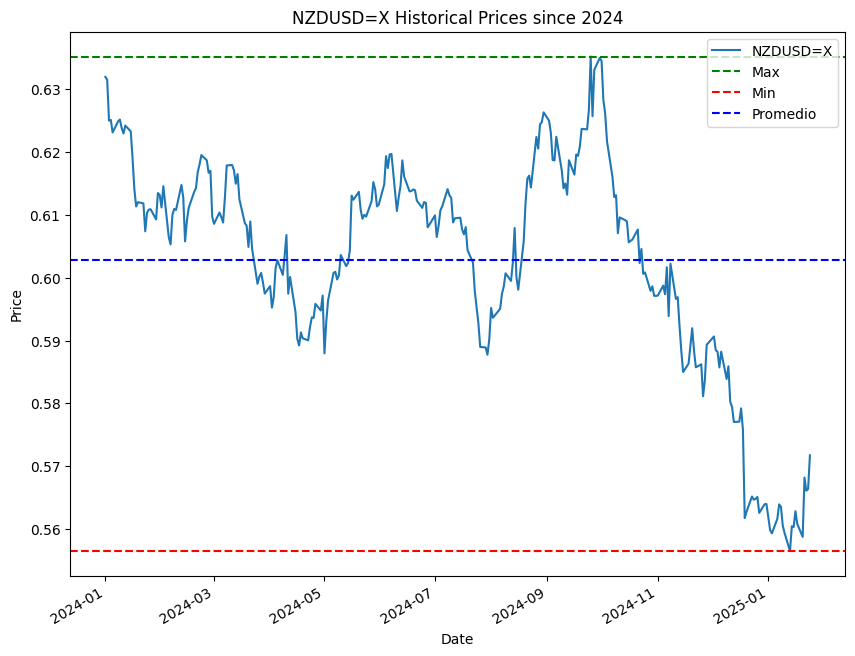

NZDUSD=X missing values: 0


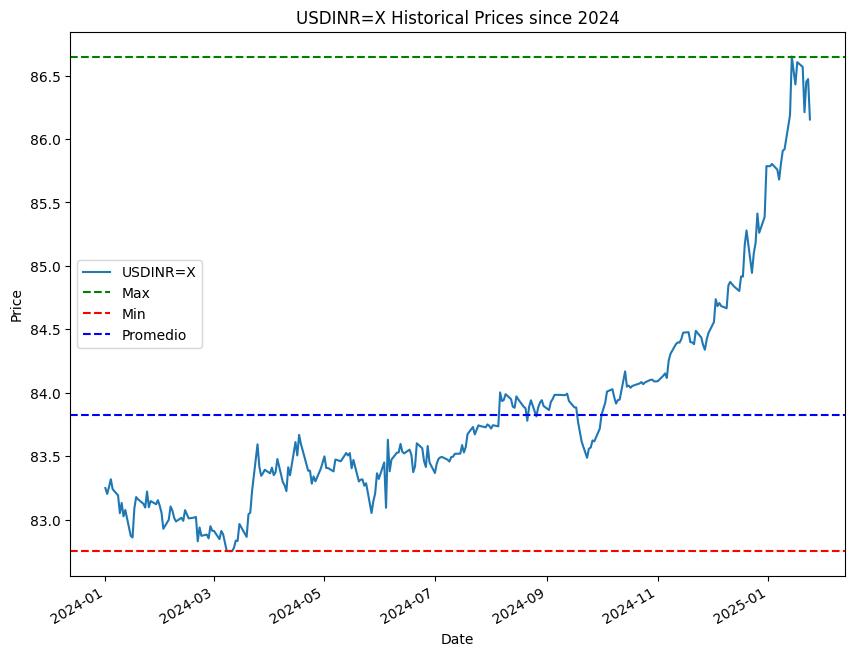

USDINR=X missing values: 0


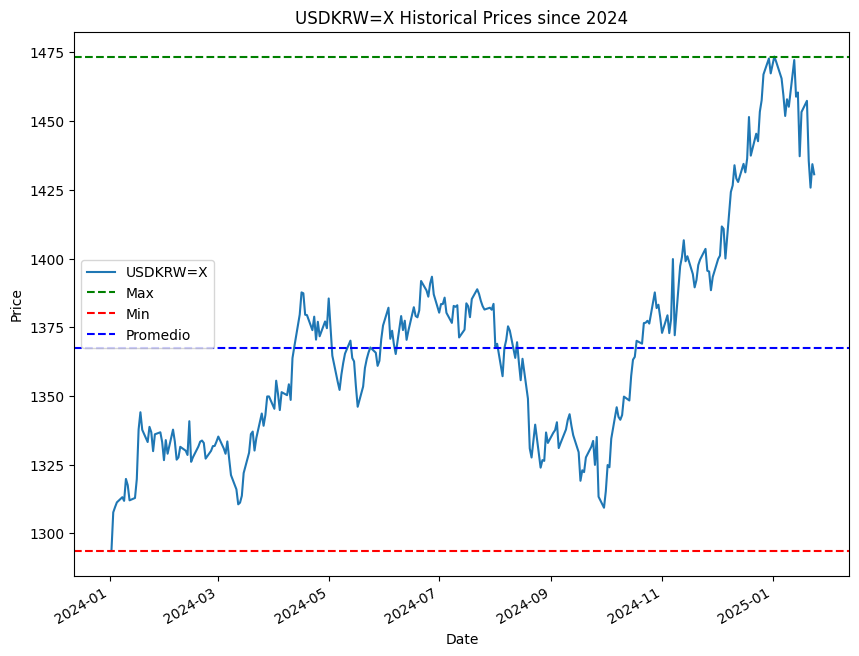

USDKRW=X missing values: 0


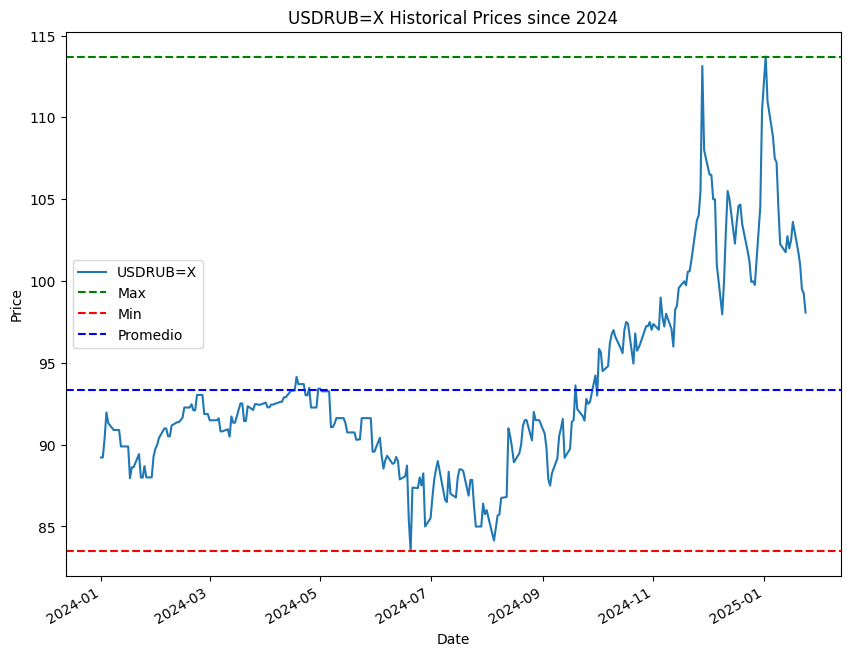

USDRUB=X missing values: 0


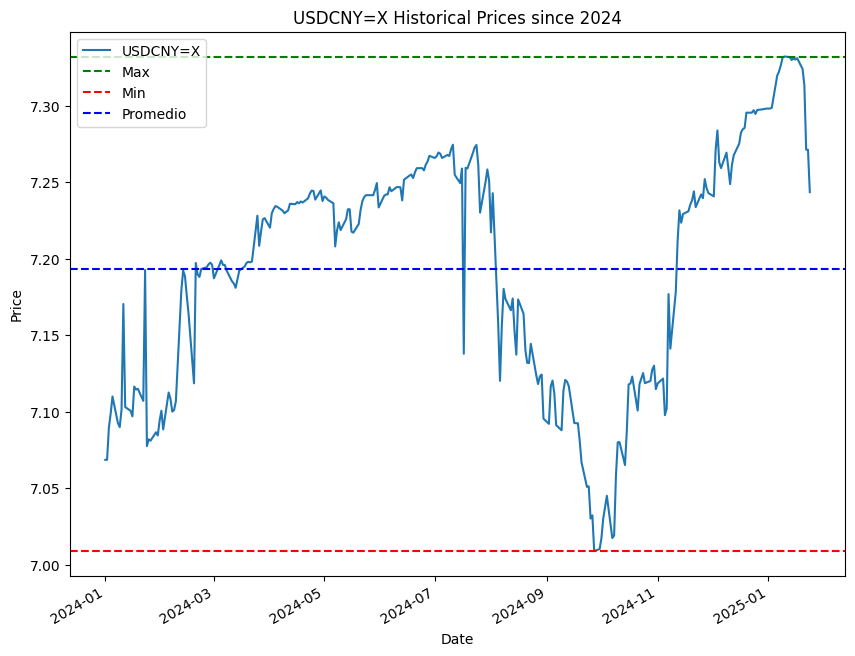

USDCNY=X missing values: 0


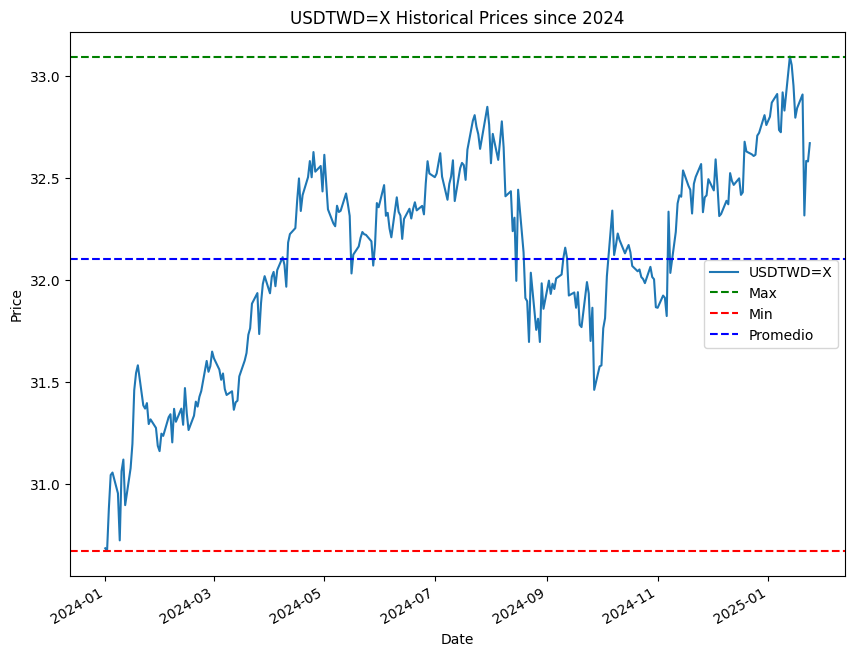

USDTWD=X missing values: 0


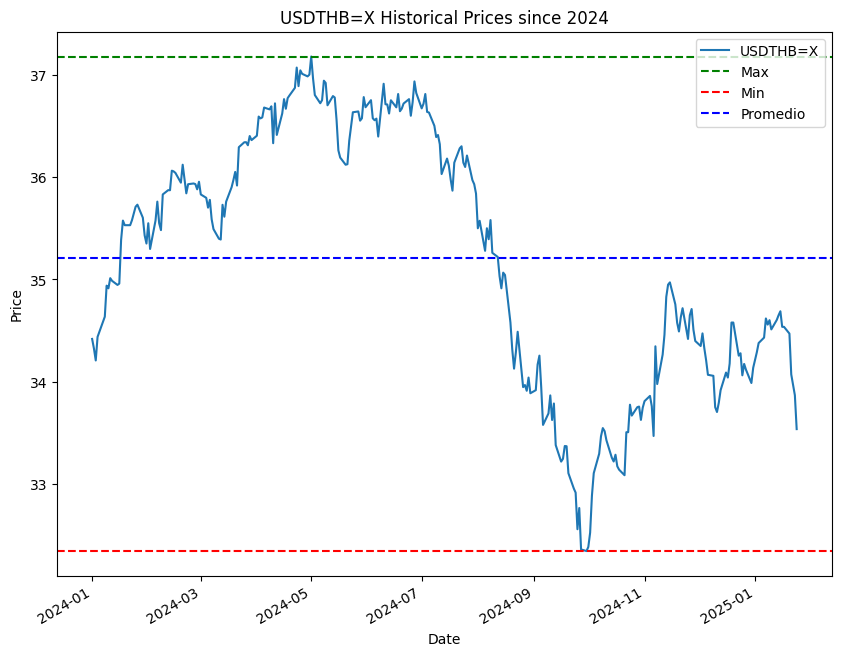

USDTHB=X missing values: 0


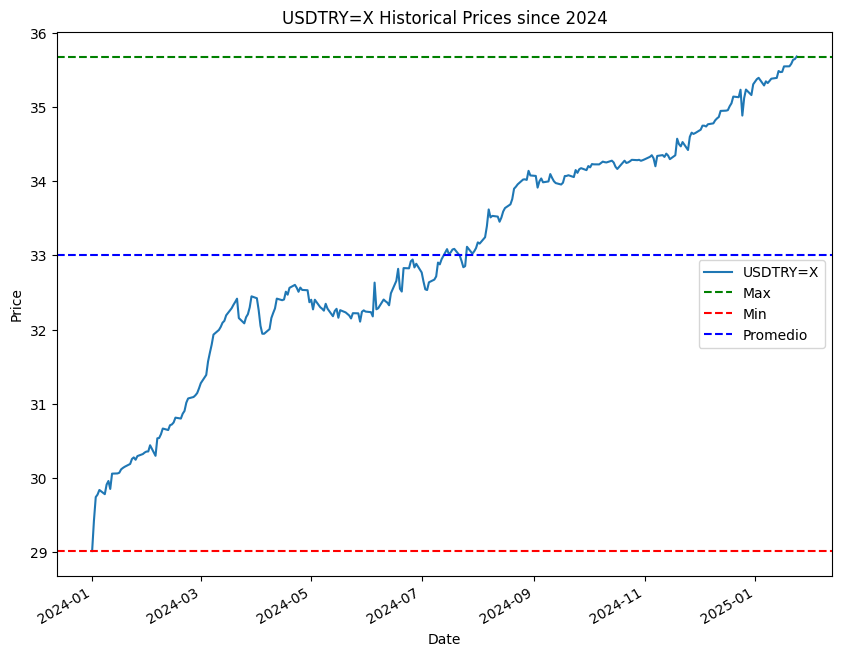

USDTRY=X missing values: 0


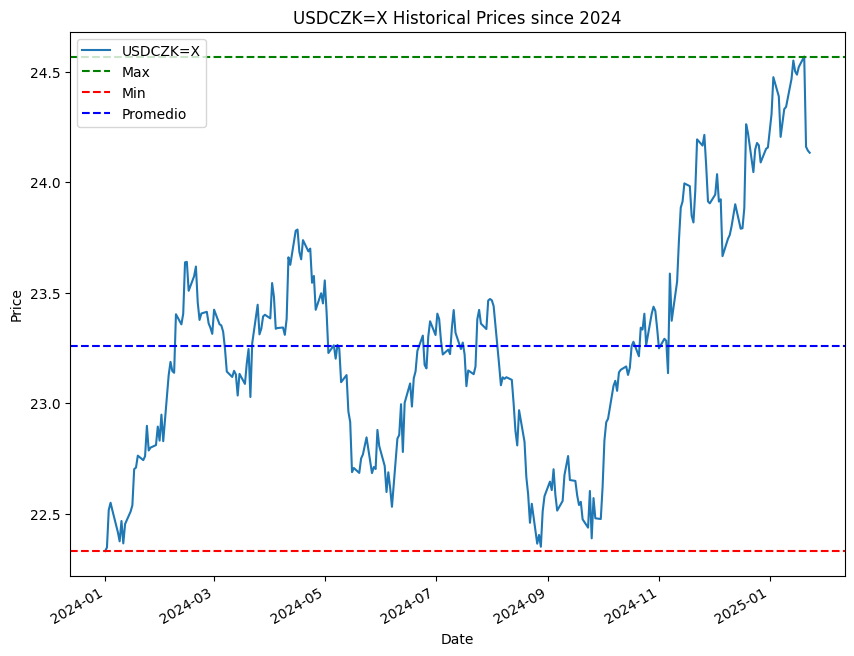

USDCZK=X missing values: 0


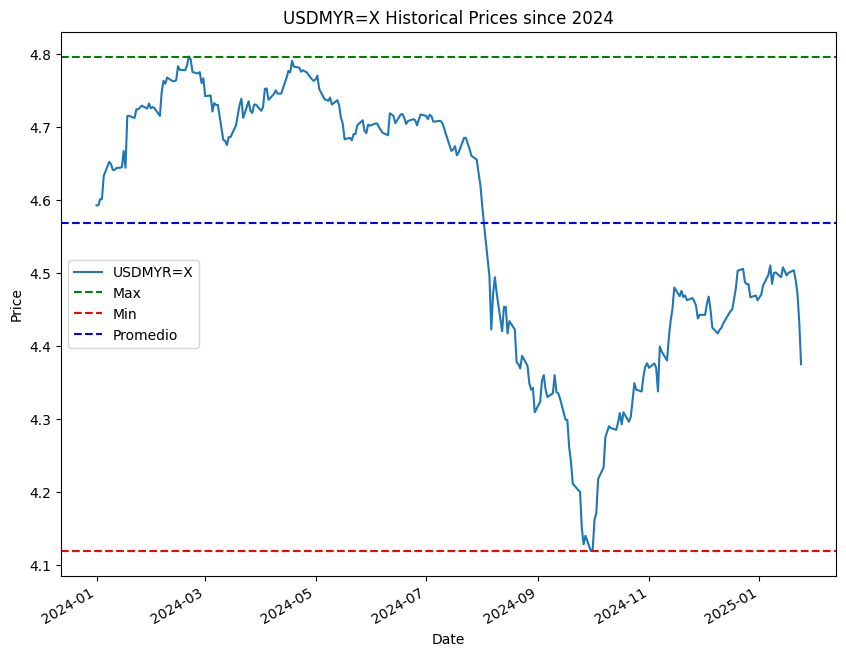

USDMYR=X missing values: 0


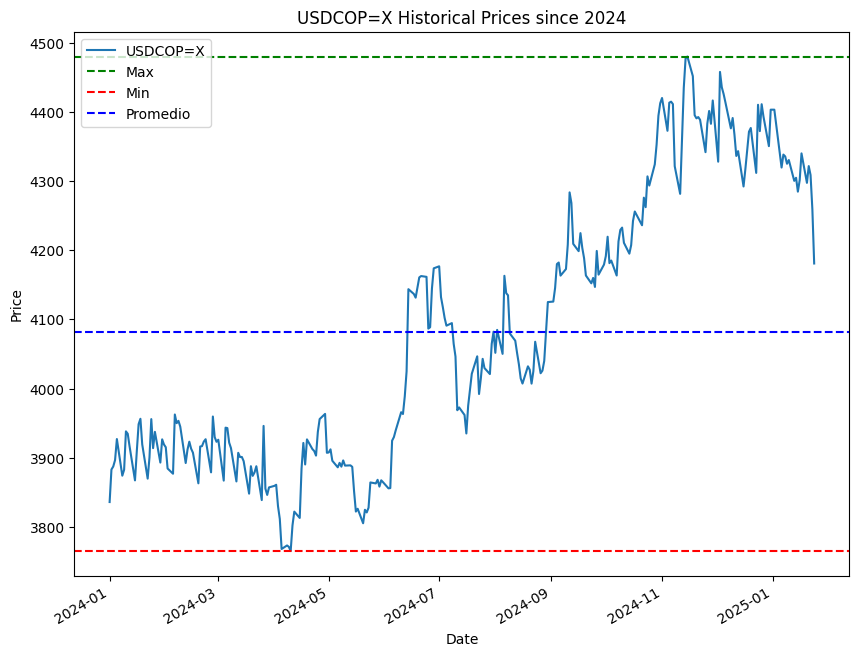

USDCOP=X missing values: 0


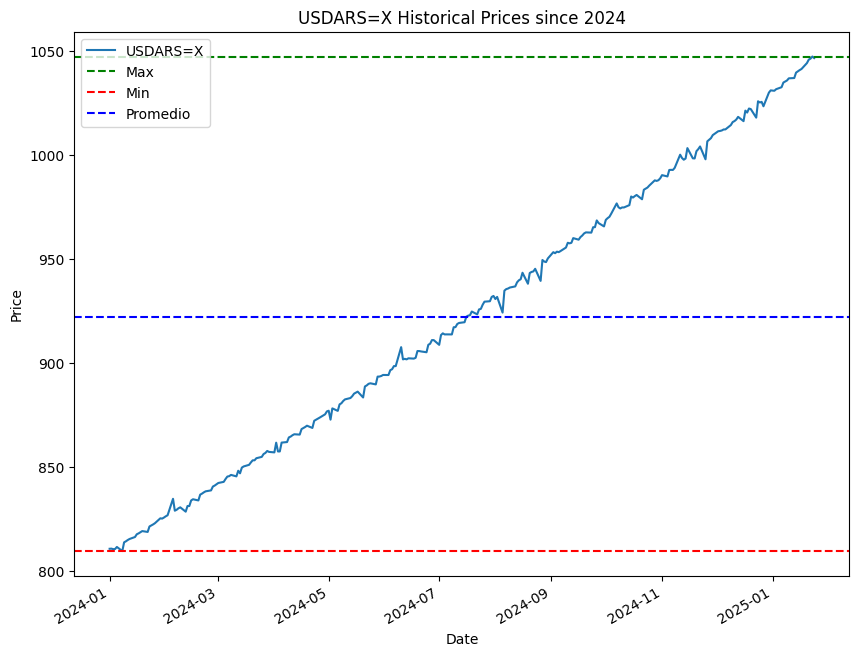

USDARS=X missing values: 0


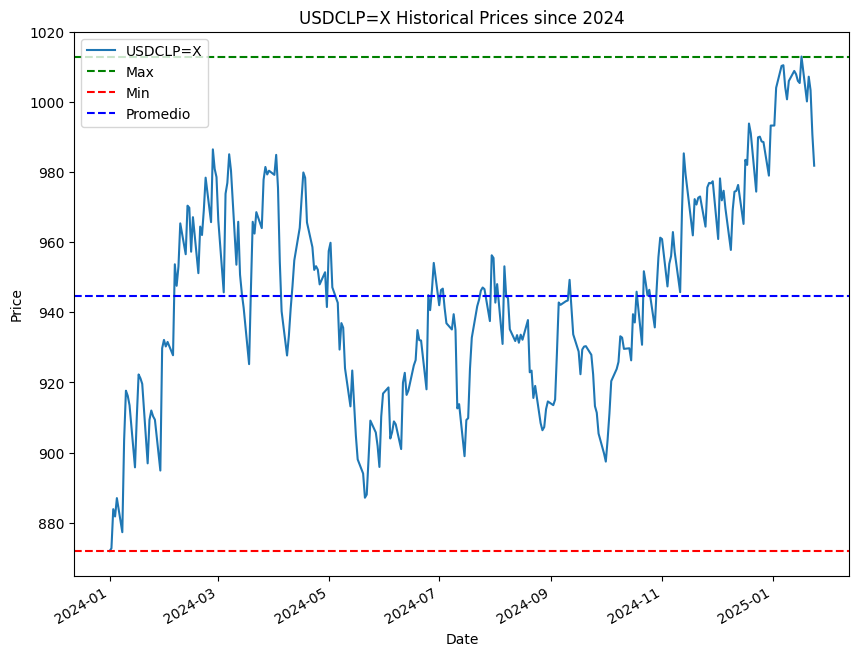

USDCLP=X missing values: 0


In [ ]:
import yfinance as yf
import pandas as pd
import matplotlib.pyplot as plt

# List of currency pairs
tickers = {
    "USDMXN=X": "Mexican Peso (MXN)",
    "USDBRL=X": "Brazilian Real (BRL)",
    "USDCOP=X": "Colombian Peso",
    "USDARS=X": "Argentine Peso",
    "USDCLP=X": "Chilean Peso"
    "EURUSD=X": "Euro (EUR)",
    "USDCAD=X": "Canadian Dollar (CAD)",
    "USDJPY=X": "Japan (JPY)",
    "GBPUSD=X": "British Pound (GBP)",
    "USDCHF=X": "Swiss Franc (CHF)",
    "USDPLN=X": "Polish Zloty (PLN)",
    "USDHUF=X": "Hungarian Forint (HUF)",
    "USDZAR=X": "South African Rand (ZAR)",
    "USDSGD=X": "Singapore Dollar (SGD)",
    "USDINR=X": "Indian Rupee (INR)",
    "USDKRW=X": "South Korean Won (KRW)",
    "USDRUB=X": "Russian Ruble (RUB)",
    "USDCNY=X": "Chinese Yuan (CNY)",
    "USDTWD=X": "Taiwan Dollar (TWD)",
    "USDTHB=X": "Thai Baht (THB)",
    "USDTRY=X": "Turkish Lira",
    "USDCZK=X": "Czech Koruna",
    "USDMYR=X": "Malaysian Ringgit",
}

for ticker_symbol in tickers:
    # Get the historical data for the current ticker
    ticker = yf.Ticker(ticker_symbol)
    history = ticker.history(period="max").loc['2024-01-01':]

    # Plot the data
    plt.figure(figsize=(10, 8))
    ax = history["Close"].plot(label=ticker_symbol)
    plt.xlabel('Date')
    plt.ylabel('Price')
    plt.title(ticker_symbol + ' Historical Prices since 2024')

    # Calculate and draw high, low, and mean lines
    high = history['Close'].max()
    low = history['Close'].min()
    mean = history['Close'].mean()

    ax.axhline(high, color='green', linestyle='--', label='Max')
    ax.axhline(low, color='red', linestyle='--', label='Min')
    ax.axhline(mean, color='blue', linestyle='--', label='Promedio')

    plt.legend()
    plt.show()

    # Check for missing values
    print(ticker_symbol, "missing values:", history["Close"].isna().sum())

In [ ]:
import yfinance as yf
import matplotlib.pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages

# Categories of currency pairs
categories = {
    "USD Majors": {
        "EURUSD=X": "Euro (EUR)",
        "USDJPY=X": "Japan (JPY)",
        "GBPUSD=X": "British Pound (GBP)",
        "USDCHF=X": "Swiss Franc (CHF)",
        "USDCAD=X": "Canadian Dollar (CAD)",
    },
    "LATAM": {
        "USDMXN=X": "Mexican Peso (MXN)",
        "USDBRL=X": "Brazilian Real (BRL)",
        "USDCOP=X": "Colombian Peso (COP)",
        "USDARS=X": "Argentine Peso (ARS)",
        "USDCLP=X": "Chilean Peso (CLP)",
    },
    "Emerging/Other": {
        "USDPLN=X": "Polish Zloty (PLN)",
        "USDHUF=X": "Hungarian Forint (HUF)",
        "USDSGD=X": "Singapore Dollar (SGD)",
        "USDRUB=X": "Russian Ruble (RUB)",
        "USDCNY=X": "Chinese Yuan (CNY)",
    }
}

# Create a PDF to save all plots in a single horizontal page with small square charts
output_pdf_path = "currency_charts_with_lines.pdf"

# Define the number of rows and columns for subplots
total_charts = sum(len(tickers) for tickers in categories.values())
cols = 5  # Number of charts per row
rows = -(-total_charts // cols)  # Calculate rows needed

# Create the PDF and plot the charts
with PdfPages(output_pdf_path) as pdf:
    fig, axes = plt.subplots(nrows=rows, ncols=cols, figsize=(20, rows * 3))
    axes = axes.flatten()  # Flatten the axes for easy indexing
    fig.suptitle("Currency Historical Prices (2024 Onwards) with Max, Min, and Mean", fontsize=16, fontweight="bold")

    chart_index = 0
    for category, tickers in categories.items():
        for ticker_symbol, currency_name in tickers.items():
            if chart_index >= len(axes):  # Avoid out-of-range errors
                break

            ax = axes[chart_index]
            chart_index += 1

            # Fetch historical data
            ticker = yf.Ticker(ticker_symbol)
            history = ticker.history(period="max").loc["2024-01-01":]

            # Skip if no data available
            if history.empty:
                print(f"No data available for {ticker_symbol} ({currency_name})")
                ax.axis("off")  # Turn off the axis for empty plots
                continue

            # Plot the data
            ax.plot(history["Close"], label=f"{currency_name}")
            ax.set_title(currency_name, fontsize=10)
            ax.set_xlabel("")
            ax.set_ylabel("")
            ax.tick_params(axis="x", labelsize=8)
            ax.tick_params(axis="y", labelsize=8)
            ax.grid(True, linestyle="--", alpha=0.6)

            # Calculate max, min, and mean
            max_val = history["Close"].max()
            min_val = history["Close"].min()
            mean_val = history["Close"].mean()

            # Plot max, min, and mean lines
            ax.axhline(max_val, color="green", linestyle="--", label="Max")
            ax.axhline(min_val, color="red", linestyle="--", label="Min")
            ax.axhline(mean_val, color="blue", linestyle="--", label="Mean")

            # Add statistics as text
            stats_text = f"Max: {max_val:.2f}\nMin: {min_val:.2f}\nMean: {mean_val:.2f}"
            ax.text(0.02, 0.98, stats_text, transform=ax.transAxes, fontsize=8, verticalalignment='top',
                    bbox=dict(facecolor='white', alpha=0.7))

    # Turn off unused axes
    for i in range(chart_index, len(axes)):
        axes[i].axis("off")

    # Adjust layout and save
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    pdf.savefig(fig)
    plt.close(fig)

print(f"Horizontal PDF with all charts and lines has been saved to {output_pdf_path}.")


Horizontal PDF with all charts and lines has been saved to currency_charts_with_lines.pdf.


In [ ]:
import yfinance as yf
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Define the ticker
ticker_symbol = "USDMXN=X"

# Get the historical data for the ticker
ticker = yf.Ticker(ticker_symbol)
history = ticker.history(period="max").loc['2005-01-01':]

# Create a subplot figure for 12 months (4 rows, 3 columns)
fig = make_subplots(
    rows=4, cols=3,
    subplot_titles=[f'Month {month}' for month in range(1, 13)]
)

# Loop through each month and add a subplot
for month in range(1, 13):
    row = (month - 1) // 3 + 1  # Calculate row
    col = (month - 1) % 3 + 1   # Calculate column

    for year in range(2005, 2025):  # Plot from 2010 to 2024
        monthly_data = history[(history.index.month == month) & (history.index.year == year)]
        if not monthly_data.empty:
            # Normalize the starting price to 100
            normalized_data = (monthly_data['Close'] / monthly_data['Close'].iloc[0]) * 100
            fig.add_trace(
                go.Scatter(
                    x=list(range(1, len(normalized_data) + 1)),
                    y=normalized_data,
                    mode='lines+markers',
                    name=str(year),
                    legendgroup=str(year),
                    showlegend=True if month == 1 else False  # Show legend only for the first month
                ),
                row=row, col=col
            )

# Update layout
fig.update_layout(
    height=800, width=900,
    title_text=f'{ticker_symbol} - Monthly Price Rallies Comparison (Normalized)',
    showlegend=True
)

# Show plot
fig.show()

In [ ]:
import yfinance as yf
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Define the ticker
ticker_symbol = "USDMXN=X"

# Get the historical data for the ticker
ticker = yf.Ticker(ticker_symbol)
history = ticker.history(period="max").loc['2000-01-01':]

# Define colors and styles
highlight_year_2024 = 2024
highlight_year_2025 = 2025
highlight_color_2024 = "orange"  # Highlight color for 2024
highlight_color_2025 = "red"     # Highlight color for 2025
other_color = "gray"             # Color for all other years
average_color = "black"          # Color for the monthly average line

# Create a subplot figure for 12 months (4 rows, 3 columns)
fig = make_subplots(
    rows=4, cols=3,
    subplot_titles=[f'Month {month}' for month in range(1, 13)]
)

# Loop through each month and add a subplot
for month in range(1, 13):
    row = (month - 1) // 3 + 1  # Calculate row
    col = (month - 1) % 3 + 1   # Calculate column

    # Collect real-term price changes for each year to calculate the average later
    monthly_values = []
    for year in range(2000, 2026):  # Adjusted to include 2025
        monthly_data = history[(history.index.month == month) & (history.index.year == year)]
        if not monthly_data.empty:
            # Calculate price change relative to the first day of the month
            price_change = monthly_data['Close'] - monthly_data['Close'].iloc[0]
            monthly_values.append(price_change.values)

            # Set line and marker style based on the highlighted years or others
            if year == highlight_year_2024:
                line_color = highlight_color_2024
                line_width = 2.5  # Slightly thicker for 2024
                marker_size = 6
                opacity = 1
            elif year == highlight_year_2025:
                line_color = highlight_color_2025
                line_width = 3  # Even thicker for 2025
                marker_size = 7
                opacity = 1
            else:
                line_color = other_color
                line_width = 1.5
                marker_size = 4
                opacity = 0.7

            fig.add_trace(
                go.Scatter(
                    x=list(range(1, len(price_change) + 1)),
                    y=price_change,
                    mode='lines+markers',
                    name=str(year),
                    legendgroup=str(year),
                    line=dict(color=line_color, width=line_width),
                    marker=dict(size=marker_size),
                    opacity=opacity,
                    showlegend=True if month == 1 else False  # Show legend only for the first month
                ),
                row=row, col=col
            )

    # Calculate the monthly average price change
    if monthly_values:
        # Compute the average price change for each day in the month across all years
        avg_price_change = pd.DataFrame(monthly_values).mean(axis=0)

        # Add the average trace to the subplot
        fig.add_trace(
            go.Scatter(
                x=list(range(1, len(avg_price_change) + 1)),
                y=avg_price_change,
                mode='lines',
                name=f'Average {month}',
                line=dict(color=average_color, width=2, dash='dash'),  # Black dashed line for average
                showlegend=False  # No need to show legend for each month
            ),
            row=row, col=col
        )

# Update layout
fig.update_layout(
    height=900, width=1500,
    title_text=f'{ticker_symbol} - Monthly Price Changes (Real-Term Values) with Monthly Average',
    showlegend=True
)

# Ensure all Y-axes start from 0 and display real amounts
fig.update_yaxes(rangemode="tozero", tickformat="0.1f")  # Display up to 2 decimal places

# Show plot
fig.show()


In [ ]:
import yfinance as yf
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Define the ticker
ticker_symbol = "USDMXN=X"

# Get the historical data for the ticker
ticker = yf.Ticker(ticker_symbol)
history = ticker.history(period="max").loc['2000-01-01':]

# Define colors and styles
highlight_year_2024 = 2024
highlight_year_2025 = 2025
highlight_color_2024 = "orange"  # Highlight color for 2024
highlight_color_2025 = "red"     # Highlight color for 2025
other_color = "gray"             # Color for all other years
average_color = "black"          # Color for the monthly average line
median_color = "blue"            # Color for the median
max_min_color = "green"          # Color for max/min
quantile_color = "purple"        # Color for quantiles

# Create a subplot figure for 12 months (4 rows, 3 columns)
fig = make_subplots(
    rows=4, cols=3,
    subplot_titles=[f'Month {month}' for month in range(1, 13)]
)

# Loop through each month and add a subplot
for month in range(1, 13):
    row = (month - 1) // 3 + 1  # Calculate row
    col = (month - 1) % 3 + 1   # Calculate column

    # Collect real-term price changes for each year to calculate statistics later
    monthly_values = []
    for year in range(2000, 2026):  # Adjusted to include 2025
        monthly_data = history[(history.index.month == month) & (history.index.year == year)]
        if not monthly_data.empty:
            # Calculate price change relative to the first day of the month
            price_change = monthly_data['Close'] - monthly_data['Close'].iloc[0]
            monthly_values.append(price_change.values)

            # Set line and marker style based on the highlighted years or others
            if year == highlight_year_2024:
                line_color = highlight_color_2024
                line_width = 2.5  # Slightly thicker for 2024
                marker_size = 6
                opacity = 1
            elif year == highlight_year_2025:
                line_color = highlight_color_2025
                line_width = 3  # Even thicker for 2025
                marker_size = 7
                opacity = 1
            else:
                line_color = other_color
                line_width = 1.5
                marker_size = 4
                opacity = 0.7

            fig.add_trace(
                go.Scatter(
                    x=list(range(1, len(price_change) + 1)),
                    y=price_change,
                    mode='lines+markers',
                    name=str(year),
                    legendgroup=str(year),
                    line=dict(color=line_color, width=line_width),
                    marker=dict(size=marker_size),
                    opacity=opacity,
                    showlegend=True if month == 1 else False  # Show legend only for the first month
                ),
                row=row, col=col
            )

    # Calculate statistics for the month
    if monthly_values:
        # Combine all price changes into a single DataFrame
        monthly_df = pd.DataFrame(monthly_values).T

        # Compute statistics
        avg_price_change = monthly_df.mean(axis=1)  # Average
        median_price_change = monthly_df.median(axis=1)  # Median
        max_price_change = monthly_df.max(axis=1)  # Max
        min_price_change = monthly_df.min(axis=1)  # Min
        q25_price_change = monthly_df.quantile(0.25, axis=1)  # 25th percentile
        q75_price_change = monthly_df.quantile(0.75, axis=1)  # 75th percentile

        # Add the average trace
        fig.add_trace(
            go.Scatter(
                x=list(range(1, len(avg_price_change) + 1)),
                y=avg_price_change,
                mode='lines',
                name=f'Average {month}',
                line=dict(color=average_color, width=2, dash='dash'),
                showlegend=False
            ),
            row=row, col=col
        )

        # Add the median trace
        fig.add_trace(
            go.Scatter(
                x=list(range(1, len(median_price_change) + 1)),
                y=median_price_change,
                mode='lines',
                name=f'Median {month}',
                line=dict(color=median_color, width=2, dash='dot'),
                showlegend=False
            ),
            row=row, col=col
        )

        # Add the max and min traces
        fig.add_trace(
            go.Scatter(
                x=list(range(1, len(max_price_change) + 1)),
                y=max_price_change,
                mode='lines',
                name=f'Max {month}',
                line=dict(color=max_min_color, width=1.5, dash='dash'),
                showlegend=False
            ),
            row=row, col=col
        )
        fig.add_trace(
            go.Scatter(
                x=list(range(1, len(min_price_change) + 1)),
                y=min_price_change,
                mode='lines',
                name=f'Min {month}',
                line=dict(color=max_min_color, width=1.5, dash='dash'),
                showlegend=False
            ),
            row=row, col=col
        )

        # Add the quantile range (shaded area between 25th and 75th percentiles)
        fig.add_trace(
            go.Scatter(
                x=list(range(1, len(q25_price_change) + 1)) + list(range(len(q25_price_change), 0, -1)),
                y=list(q25_price_change) + list(q75_price_change)[::-1],
                fill='toself',
                fillcolor='rgba(128, 0, 128, 0.2)',  # Purple with transparency
                line=dict(color='rgba(255, 255, 255, 0)'),  # Invisible line
                name=f'Quantile Range {month}',
                showlegend=False
            ),
            row=row, col=col
        )

# Update layout
fig.update_layout(
    height=850, width=1400,
    title_text=f'{ticker_symbol} - Monthly Price Changes (Real-Term Values) with Statistics',
    showlegend=True
)

# Ensure all Y-axes start from 0 and display real amounts
fig.update_yaxes(rangemode="tozero", tickformat=".2f")  # Display up to 2 decimal places

# Show plot
fig.show()

In [ ]:
import yfinance as yf
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Define the ticker
ticker_symbol = "USDMXN=X"

# Get the historical data for the ticker
ticker = yf.Ticker(ticker_symbol)
history = ticker.history(period="max").loc['2000-01-01':]

# Define colors and styles
highlight_year_2024 = 2024
highlight_year_2025 = 2025
highlight_color_2024 = "orange"  # Highlight color for 2024
highlight_color_2025 = "red"     # Highlight color for 2025
other_color = "gray"             # Color for all other years
average_color = "black"          # Color for the monthly average line
median_color = "blue"            # Color for the median
max_min_color = "green"          # Color for max/min
quantile_color = "purple"        # Color for quantiles

# Create a subplot figure for 12 months (4 rows, 3 columns)
fig = make_subplots(
    rows=4, cols=3,
    subplot_titles=[f'Month {month}' for month in range(1, 13)]
)

# Loop through each month and add a subplot
for month in range(1, 13):
    row = (month - 1) // 3 + 1  # Calculate row
    col = (month - 1) % 3 + 1   # Calculate column

    # Collect real-term price changes for each year to calculate statistics later
    monthly_values = []
    for year in range(2000, 2026):  # Adjusted to include 2025
        monthly_data = history[(history.index.month == month) & (history.index.year == year)]
        if not monthly_data.empty:
            # Calculate price change relative to the first day of the month
            price_change = monthly_data['Close'] - monthly_data['Close'].iloc[0]
            monthly_values.append(price_change.values)

            # Set line and marker style based on the highlighted years or others
            if year == highlight_year_2024:
                line_color = highlight_color_2024
                line_width = 2.5  # Slightly thicker for 2024
                marker_size = 6
                opacity = 1
            elif year == highlight_year_2025:
                line_color = highlight_color_2025
                line_width = 3  # Even thicker for 2025
                marker_size = 7
                opacity = 1
            else:
                line_color = other_color
                line_width = 1.5
                marker_size = 4
                opacity = 0.7

            fig.add_trace(
                go.Scatter(
                    x=list(range(1, len(price_change) + 1)),
                    y=price_change,
                    mode='lines+markers',
                    name=str(year),
                    legendgroup=str(year),
                    line=dict(color=line_color, width=line_width),
                    marker=dict(size=marker_size),
                    opacity=opacity,
                    showlegend=True if month == 1 else False  # Show legend only for the first month
                ),
                row=row, col=col
            )

    # Calculate statistics for the month
    if monthly_values:
        # Combine all price changes into a single DataFrame
        monthly_df = pd.DataFrame(monthly_values).T

        # Compute statistics
        avg_price_change = monthly_df.mean().mean()  # Average across all days and years
        median_price_change = monthly_df.median().median()  # Median across all days and years
        max_price_change = monthly_df.max().max()  # Max across all days and years
        min_price_change = monthly_df.min().min()  # Min across all days and years
        q25_price_change = monthly_df.quantile(0.25).quantile(0.25)  # 25th percentile
        q75_price_change = monthly_df.quantile(0.75).quantile(0.75)  # 75th percentile

        # Add the average line
        fig.add_trace(
            go.Scatter(
                x=[1, len(monthly_df)],  # Horizontal line across the month
                y=[avg_price_change, avg_price_change],
                mode='lines',
                name=f'Average {month}',
                line=dict(color=average_color, width=2, dash='dash'),
                showlegend=False
            ),
            row=row, col=col
        )

        # Add the median line
        fig.add_trace(
            go.Scatter(
                x=[1, len(monthly_df)],
                y=[median_price_change, median_price_change],
                mode='lines',
                name=f'Median {month}',
                line=dict(color=median_color, width=2, dash='dot'),
                showlegend=False
            ),
            row=row, col=col
        )

        # Add the max and min lines
        fig.add_trace(
            go.Scatter(
                x=[1, len(monthly_df)],
                y=[max_price_change, max_price_change],
                mode='lines',
                name=f'Max {month}',
                line=dict(color=max_min_color, width=1.5, dash='dash'),
                showlegend=False
            ),
            row=row, col=col
        )
        fig.add_trace(
            go.Scatter(
                x=[1, len(monthly_df)],
                y=[min_price_change, min_price_change],
                mode='lines',
                name=f'Min {month}',
                line=dict(color=max_min_color, width=1.5, dash='dash'),
                showlegend=False
            ),
            row=row, col=col
        )

        # Add the quantile range (shaded area between 25th and 75th percentiles)
        fig.add_trace(
            go.Scatter(
                x=[1, len(monthly_df), len(monthly_df), 1],  # Rectangle coordinates
                y=[q25_price_change, q25_price_change, q75_price_change, q75_price_change],
                fill='toself',
                fillcolor='rgba(128, 0, 128, 0.2)',  # Purple with transparency
                line=dict(color='rgba(255, 255, 255, 0)'),  # Invisible line
                name=f'Quantile Range {month}',
                showlegend=False
            ),
            row=row, col=col
        )

# Update layout
fig.update_layout(
    height=850, width=1400,
    title_text=f'{ticker_symbol} - Monthly Price Changes (Real-Term Values) with Statistics',
    showlegend=True
)

# Ensure all Y-axes start from 0 and display real amounts
fig.update_yaxes(rangemode="tozero", tickformat=".2f")  # Display up to 2 decimal places

# Show plot
fig.show()

In [ ]:
import yfinance as yf
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Define the ticker
ticker_symbol = "USDMXN=X"

# Get the historical data for the ticker
ticker = yf.Ticker(ticker_symbol)
history = ticker.history(period="max").loc['2000-01-01':]

# Calculate daily, weekly, and monthly returns
history['Daily_Return'] = history['Close'].pct_change() * 100  # Daily returns in percentage

# Weekly returns: Resample to weeks ending on Sunday ('W-SUN')
weekly_data = history['Close'].resample('W-SUN').last()  # Resample to week-ending Sunday
weekly_returns = weekly_data.pct_change() * 100  # Calculate weekly returns

# Monthly returns: Use 'ME' (Month-End) instead of 'M'
monthly_data = history['Close'].resample('ME').last()  # Resample to month-end
monthly_returns = monthly_data.pct_change() * 100  # Calculate monthly returns

# Drop NaN values (first row will have NaN for returns)
history.dropna(subset=['Daily_Return'], inplace=True)
weekly_returns.dropna(inplace=True)
monthly_returns.dropna(inplace=True)

# Create a subplot figure for daily, weekly, and monthly returns
fig = make_subplots(
    rows=3, cols=1,
    subplot_titles=["Daily Returns (%)", "Weekly Returns (%)", "Monthly Returns (%)"],
    shared_xaxes=True,
    vertical_spacing=0.05
)

# Plot daily returns
fig.add_trace(
    go.Scatter(
        x=history.index,
        y=history['Daily_Return'],
        mode='lines',
        name='Daily Returns',
        line=dict(color='blue', width=1),
        opacity=0.7
    ),
    row=1, col=1
)

# Plot weekly returns
fig.add_trace(
    go.Scatter(
        x=weekly_returns.index,
        y=weekly_returns,
        mode='lines+markers',
        name='Weekly Returns',
        line=dict(color='green', width=2),
        marker=dict(size=4),
        opacity=0.8
    ),
    row=2, col=1
)

# Plot monthly returns
fig.add_trace(
    go.Scatter(
        x=monthly_returns.index,
        y=monthly_returns,
        mode='lines+markers',
        name='Monthly Returns',
        line=dict(color='red', width=2),
        marker=dict(size=6),
        opacity=0.9
    ),
    row=3, col=1
)

# Update layout
fig.update_layout(
    height=850, width=1400,
    title_text=f'{ticker_symbol} - Daily, Weekly, and Monthly Returns (%)',
    showlegend=False
)

# Update Y-axis formatting to display percentages
fig.update_yaxes(tickformat=".2f", title="% Return")

# Show plot
fig.show()

In [ ]:
import yfinance as yf
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Define the ticker
ticker_symbol = "USDMXN=X"

# Get the historical data for the ticker
ticker = yf.Ticker(ticker_symbol)
history = ticker.history(period="max").loc['2024-01-01':]

# Calculate daily, weekly, and monthly returns
history['Daily_Return'] = history['Close'].pct_change() * 100  # Daily returns in percentage

# Weekly returns: Resample to weeks ending on Sunday ('W-SUN')
weekly_data = history['Close'].resample('W-SUN').last()  # Resample to week-ending Sunday
weekly_returns = weekly_data.pct_change() * 100  # Calculate weekly returns

# Monthly returns: Use 'ME' (Month-End)
monthly_data = history['Close'].resample('ME').last()  # Resample to month-end
monthly_returns = monthly_data.pct_change() * 100  # Calculate monthly returns

# Drop NaN values (first row will have NaN for returns)
history.dropna(subset=['Daily_Return'], inplace=True)
weekly_returns.dropna(inplace=True)
monthly_returns.dropna(inplace=True)

# Create a subplot figure for daily, weekly, and monthly returns
fig = make_subplots(
    rows=3, cols=1,
    subplot_titles=["Daily Returns (%)", "Weekly Returns (%)", "Monthly Returns (%)"],
    shared_xaxes=True,
    vertical_spacing=0.05,
    specs=[[{"secondary_y": True}], [{"secondary_y": True}], [{"secondary_y": True}]]  # Enable secondary axis
)

# Plot daily returns
fig.add_trace(
    go.Scatter(
        x=history.index,
        y=history['Daily_Return'],
        mode='lines',
        name='Daily Returns (%)',
        line=dict(color='blue', width=1),
        opacity=0.7
    ),
    row=1, col=1, secondary_y=False  # Percentage on primary Y-axis
)

# Add real closing prices to the daily chart
fig.add_trace(
    go.Scatter(
        x=history.index,
        y=history['Close'],
        mode='lines',
        name='Closing Price',
        line=dict(color='black', width=1.5, dash='dot'),
        opacity=0.8
    ),
    row=1, col=1, secondary_y=True  # Price on secondary Y-axis
)

# Plot weekly returns
fig.add_trace(
    go.Scatter(
        x=weekly_returns.index,
        y=weekly_returns,
        mode='lines+markers',
        name='Weekly Returns (%)',
        line=dict(color='green', width=2),
        marker=dict(size=4),
        opacity=0.8
    ),
    row=2, col=1, secondary_y=False
)

# Add real closing prices to the weekly chart
fig.add_trace(
    go.Scatter(
        x=weekly_data.index,
        y=weekly_data,
        mode='lines',
        name='Closing Price',
        line=dict(color='black', width=1.5, dash='dot'),
        opacity=0.8
    ),
    row=2, col=1, secondary_y=True
)

# Plot monthly returns
fig.add_trace(
    go.Scatter(
        x=monthly_returns.index,
        y=monthly_returns,
        mode='lines+markers',
        name='Monthly Returns (%)',
        line=dict(color='red', width=2),
        marker=dict(size=6),
        opacity=0.9
    ),
    row=3, col=1, secondary_y=False
)

# Add real closing prices to the monthly chart
fig.add_trace(
    go.Scatter(
        x=monthly_data.index,
        y=monthly_data,
        mode='lines',
        name='Closing Price',
        line=dict(color='black', width=1.5, dash='dot'),
        opacity=0.8
    ),
    row=3, col=1, secondary_y=True
)

# Update layout
fig.update_layout(
    height=850, width=1400,
    title_text=f'{ticker_symbol} - Daily, Weekly, and Monthly Returns (%) with Closing Prices',
    showlegend=False
)

# Update Y-axis formatting
fig.update_yaxes(title_text="% Return", tickformat=".2f", secondary_y=False)
fig.update_yaxes(title_text="Closing Price", secondary_y=True)

# Show plot
fig.show()


In [ ]:
import yfinance as yf
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Define the ticker
ticker_symbol = "USDMXN=X"

# Get the historical data for the ticker
ticker = yf.Ticker(ticker_symbol)
history = ticker.history(period="max").loc['2024-01-01':]

# Calculate daily, weekly, and monthly returns
history['Daily_Return'] = history['Close'].pct_change() * 100  # Daily returns in percentage

# Weekly returns: Resample to weeks ending on Sunday ('W-SUN')
weekly_data = history['Close'].resample('W-SUN').last()  # Resample to week-ending Sunday
weekly_returns = weekly_data.pct_change() * 100  # Calculate weekly returns

# Monthly returns: Use 'ME' (Month-End)
monthly_data = history['Close'].resample('ME').last()  # Resample to month-end
monthly_returns = monthly_data.pct_change() * 100  # Calculate monthly returns

# Drop NaN values (first row will have NaN for returns)
history.dropna(subset=['Daily_Return'], inplace=True)
weekly_returns.dropna(inplace=True)
monthly_returns.dropna(inplace=True)

# Create a subplot figure for daily, weekly, and monthly returns
fig = make_subplots(
    rows=3, cols=1,
    subplot_titles=["Daily Returns (%)", "Weekly Returns (%)", "Monthly Returns (%)"],
    shared_xaxes=True,
    vertical_spacing=0.05,
    specs=[[{"secondary_y": True}], [{"secondary_y": True}], [{"secondary_y": True}]]  # Enable secondary axis
)

# Plot daily returns as blue bars
fig.add_trace(
    go.Bar(
        x=history.index,
        y=history['Daily_Return'],
        name='Daily Returns (%)',
        marker_color='blue',
        opacity=0.7
    ),
    row=1, col=1, secondary_y=False
)

# Add small blue circles for daily returns
fig.add_trace(
    go.Scatter(
        x=history.index,
        y=history['Daily_Return'],
        mode='markers',
        name='Daily Return Points',
        marker=dict(color='blue', size=4),
    ),
    row=1, col=1, secondary_y=False
)

# Add high prices as a **light gray** solid line
fig.add_trace(
    go.Scatter(
        x=history.index,
        y=history['High'],
        mode='lines',
        name='High Price',
        line=dict(color='lightgray', width=1.5),
        opacity=0.8
    ),
    row=1, col=1, secondary_y=True
)

# Add low prices as a **light gray** solid line
fig.add_trace(
    go.Scatter(
        x=history.index,
        y=history['Low'],
        mode='lines',
        name='Low Price',
        line=dict(color='lightgray', width=1.5),
        opacity=0.8
    ),
    row=1, col=1, secondary_y=True
)

# Add real closing prices as a **dark gray** solid line
fig.add_trace(
    go.Scatter(
        x=history.index,
        y=history['Close'],
        mode='lines',
        name='Closing Price (Solid)',
        line=dict(color='darkgray', width=2),
        opacity=0.9
    ),
    row=1, col=1, secondary_y=True
)

# Add real closing prices as a **black dotted line**
fig.add_trace(
    go.Scatter(
        x=history.index,
        y=history['Close'],
        mode='lines',
        name='Closing Price (Dotted)',
        line=dict(color='black', width=1.5, dash='dot'),
        opacity=0.9
    ),
    row=1, col=1, secondary_y=True
)

# Plot weekly returns as **blue bars**
fig.add_trace(
    go.Bar(
        x=weekly_returns.index,
        y=weekly_returns,
        name='Weekly Returns (%)',
        marker_color='blue',
        opacity=0.8
    ),
    row=2, col=1, secondary_y=False
)

# Add real closing prices as a **dark gray solid line** for weekly data
fig.add_trace(
    go.Scatter(
        x=weekly_data.index,
        y=weekly_data,
        mode='lines',
        name='Closing Price (Weekly)',
        line=dict(color='darkgray', width=2),
        opacity=0.9
    ),
    row=2, col=1, secondary_y=True
)

# Plot monthly returns as **blue bars**
fig.add_trace(
    go.Bar(
        x=monthly_returns.index,
        y=monthly_returns,
        name='Monthly Returns (%)',
        marker_color='blue',
        opacity=0.9
    ),
    row=3, col=1, secondary_y=False
)

# Add real closing prices as a **dark gray solid line** for monthly data
fig.add_trace(
    go.Scatter(
        x=monthly_data.index,
        y=monthly_data,
        mode='lines',
        name='Closing Price (Monthly)',
        line=dict(color='darkgray', width=2),
        opacity=0.9
    ),
    row=3, col=1, secondary_y=True
)

# Update layout
fig.update_layout(
    height=900, width=1400,
    title_text=f'{ticker_symbol} - Daily, Weekly, and Monthly Returns (%) with High, Low, and Closing Prices',
    showlegend=True,
    xaxis_rangeslider_visible=False
)

# Update Y-axis formatting
fig.update_yaxes(title_text="% Return", tickformat=".2f", secondary_y=False)
fig.update_yaxes(title_text="Closing Price", secondary_y=True)

# Show plot
fig.show()


In [ ]:
import yfinance as yf
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Define the ticker
ticker_symbol = "USDMXN=X"

# Get the historical data for the ticker starting from 2024-01-01
ticker = yf.Ticker(ticker_symbol)
history = ticker.history(period="max").loc['2024-01-01':]

# Calculate daily returns (in percentage)
history['Daily_Return'] = history['Close'].pct_change() * 100

# -------------------------------
# Compute Weekly Data and Returns
# -------------------------------
# Weekly closing prices (last close of the week ending on Sunday)
weekly_close = history['Close'].resample('W-SUN').last()
weekly_returns = weekly_close.pct_change() * 100  # Weekly returns in percentage

# Weekly high: maximum high in each week; Weekly low: minimum low in each week
weekly_high = history['High'].resample('W-SUN').max()
weekly_low  = history['Low'].resample('W-SUN').min()

# -------------------------------
# Compute Monthly Data and Returns
# -------------------------------
# Monthly closing prices (last close at month end)
monthly_close = history['Close'].resample('ME').last()
monthly_returns = monthly_close.pct_change() * 100  # Monthly returns in percentage

# Monthly high: maximum high in each month; Monthly low: minimum low in each month
monthly_high = history['High'].resample('ME').max()
monthly_low  = history['Low'].resample('ME').min()

# Drop NaN values (the first entry for each returns series will be NaN)
history.dropna(subset=['Daily_Return'], inplace=True)
weekly_returns.dropna(inplace=True)
monthly_returns.dropna(inplace=True)

# -------------------------------
# Create a subplot figure with 3 rows (Daily, Weekly, Monthly)
# -------------------------------
fig = make_subplots(
    rows=3, cols=1,
    subplot_titles=["Daily Returns (%)", "Weekly Returns (%)", "Monthly Returns (%)"],
    shared_xaxes=True,
    vertical_spacing=0.05,
    specs=[[{"secondary_y": True}], [{"secondary_y": True}], [{"secondary_y": True}]]  # Enable secondary y-axes
)

# -------------------------------
# Row 1: Daily Returns and Prices
# -------------------------------
# Daily returns as blue bars
fig.add_trace(
    go.Bar(
        x=history.index,
        y=history['Daily_Return'],
        name='Daily Returns (%)',
        marker_color='blue',
        opacity=0.7
    ),
    row=1, col=1, secondary_y=False
)

# Small blue markers for daily returns
fig.add_trace(
    go.Scatter(
        x=history.index,
        y=history['Daily_Return'],
        mode='markers',
        name='Daily Return Points',
        marker=dict(color='blue', size=4),
    ),
    row=1, col=1, secondary_y=False
)

# Daily High as a light gray solid line
fig.add_trace(
    go.Scatter(
        x=history.index,
        y=history['High'],
        mode='lines',
        name='High Price (Daily)',
        line=dict(color='lightgray', width=1.5),
        opacity=0.8
    ),
    row=1, col=1, secondary_y=True
)

# Daily Low as a light gray solid line
fig.add_trace(
    go.Scatter(
        x=history.index,
        y=history['Low'],
        mode='lines',
        name='Low Price (Daily)',
        line=dict(color='lightgray', width=1.5),
        opacity=0.8
    ),
    row=1, col=1, secondary_y=True
)

# Daily Closing Price as a dark gray solid line
fig.add_trace(
    go.Scatter(
        x=history.index,
        y=history['Close'],
        mode='lines',
        name='Closing Price (Daily) Solid',
        line=dict(color='darkgray', width=2),
        opacity=0.9
    ),
    row=1, col=1, secondary_y=True
)

# Daily Closing Price as a black dotted line
fig.add_trace(
    go.Scatter(
        x=history.index,
        y=history['Close'],
        mode='lines',
        name='Closing Price (Daily) Dotted',
        line=dict(color='black', width=1.5, dash='dot'),
        opacity=0.9
    ),
    row=1, col=1, secondary_y=True
)

# -------------------------------
# Row 2: Weekly Returns and Prices
# -------------------------------
# Weekly returns as green bars
fig.add_trace(
    go.Bar(
        x=weekly_returns.index,
        y=weekly_returns,
        name='Weekly Returns (%)',
        marker_color='green',
        opacity=0.8
    ),
    row=2, col=1, secondary_y=False
)

# Weekly High as a light gray solid line
fig.add_trace(
    go.Scatter(
        x=weekly_high.index,
        y=weekly_high,
        mode='lines',
        name='Weekly High Price',
        line=dict(color='lightgray', width=1.5),
        opacity=0.9
    ),
    row=2, col=1, secondary_y=True
)

# Weekly Low as a light gray solid line
fig.add_trace(
    go.Scatter(
        x=weekly_low.index,
        y=weekly_low,
        mode='lines',
        name='Weekly Low Price',
        line=dict(color='lightgray', width=1.5),
        opacity=0.9
    ),
    row=2, col=1, secondary_y=True
)

# Weekly Closing Price as a black solid line
fig.add_trace(
    go.Scatter(
        x=weekly_close.index,
        y=weekly_close,
        mode='lines',
        name='Closing Price (Weekly)',
        line=dict(color='black', width=2),
        opacity=0.9
    ),
    row=2, col=1, secondary_y=True
)

# --- Add markers for each weekly close ---
fig.add_trace(
    go.Scatter(
        x=weekly_close.index,
        y=weekly_close,
        mode='markers',
        name='Weekly Close Points',
        marker=dict(color='black', size=8),
        opacity=0.9
    ),
    row=2, col=1, secondary_y=True
)

# -------------------------------
# Row 3: Monthly Returns and Prices
# -------------------------------
# Monthly returns as red bars
fig.add_trace(
    go.Bar(
        x=monthly_returns.index,
        y=monthly_returns,
        name='Monthly Returns (%)',
        marker_color='red',
        opacity=0.9
    ),
    row=3, col=1, secondary_y=False
)

# Monthly High as a light gray solid line
fig.add_trace(
    go.Scatter(
        x=monthly_high.index,
        y=monthly_high,
        mode='lines',
        name='Monthly High Price',
        line=dict(color='lightgray', width=1.5),
        opacity=0.9
    ),
    row=3, col=1, secondary_y=True
)

# Monthly Low as a light gray solid line
fig.add_trace(
    go.Scatter(
        x=monthly_low.index,
        y=monthly_low,
        mode='lines',
        name='Monthly Low Price',
        line=dict(color='lightgray', width=1.5),
        opacity=0.9
    ),
    row=3, col=1, secondary_y=True
)

# Monthly Closing Price as a black solid line
fig.add_trace(
    go.Scatter(
        x=monthly_close.index,
        y=monthly_close,
        mode='lines',
        name='Closing Price (Monthly)',
        line=dict(color='black', width=2),
        opacity=0.9
    ),
    row=3, col=1, secondary_y=True
)

# --- Add markers for each monthly close ---
fig.add_trace(
    go.Scatter(
        x=monthly_close.index,
        y=monthly_close,
        mode='markers',
        name='Monthly Close Points',
        marker=dict(color='black', size=8),
        opacity=0.9
    ),
    row=3, col=1, secondary_y=True
)

# -------------------------------
# Update Layout and Axes Formatting
# -------------------------------
fig.update_layout(
    height=900, width=1400,
    title_text=f'{ticker_symbol} - Daily, Weekly, and Monthly Returns (%) with High, Low, and Closing Prices',
    showlegend=True,
    xaxis_rangeslider_visible=False
)

# Update Y-axis labels:
# Primary y-axis (returns) uses percentage formatting.
fig.update_yaxes(title_text="% Return", tickformat=".2f", secondary_y=False)
# Secondary y-axis (prices) shows the price.
fig.update_yaxes(title_text="Price", secondary_y=True)

# -------------------------------
# Display the Plot
# -------------------------------
fig.show()


In [ ]:
import yfinance as yf
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Define the ticker
ticker_symbol = "USDMXN=X"

# Get the historical data for the ticker starting from 2024-01-01
ticker = yf.Ticker(ticker_symbol)
history = ticker.history(period="max").loc['2024-01-01':]

# Calculate daily returns (in percentage)
history['Daily_Return'] = history['Close'].pct_change() * 100

# -------------------------------
# Compute Weekly Data and Returns
# -------------------------------
# Weekly closing prices (last close of the week ending on Sunday)
weekly_close = history['Close'].resample('W-SUN').last()
weekly_returns = weekly_close.pct_change() * 100  # Weekly returns in percentage

# Weekly high: maximum high in each week; Weekly low: minimum low in each week
weekly_high = history['High'].resample('W-SUN').max()
weekly_low  = history['Low'].resample('W-SUN').min()

# -------------------------------
# Compute Monthly Data and Returns
# -------------------------------
# Monthly closing prices (last close at month end)
monthly_close = history['Close'].resample('ME').last()
monthly_returns = monthly_close.pct_change() * 100  # Monthly returns in percentage

# Monthly high: maximum high in each month; Monthly low: minimum low in each month
monthly_high = history['High'].resample('ME').max()
monthly_low  = history['Low'].resample('ME').min()

# Drop NaN values (the first entry for each returns series will be NaN)
history.dropna(subset=['Daily_Return'], inplace=True)
weekly_returns.dropna(inplace=True)
monthly_returns.dropna(inplace=True)

# -------------------------------
# Create a subplot figure with 3 rows (Daily, Weekly, Monthly)
# -------------------------------
fig = make_subplots(
    rows=3, cols=1,
    subplot_titles=["Daily Returns (%)", "Weekly Returns (%)", "Monthly Returns (%)"],
    shared_xaxes=True,
    vertical_spacing=0.05,
    specs=[[{"secondary_y": True}], [{"secondary_y": True}], [{"secondary_y": True}]]  # Enable secondary y-axes
)

# -------------------------------
# Row 1: Daily Returns and Prices
# -------------------------------
# Daily returns as blue bars
fig.add_trace(
    go.Bar(
        x=history.index,
        y=history['Daily_Return'],
        name='Daily Returns (%)',
        marker_color='blue',
        opacity=0.7
    ),
    row=1, col=1, secondary_y=False
)

# Small blue markers for daily returns
fig.add_trace(
    go.Scatter(
        x=history.index,
        y=history['Daily_Return'],
        mode='markers',
        name='Daily Return Points',
        marker=dict(color='blue', size=4),
    ),
    row=1, col=1, secondary_y=False
)

# Daily High as a light gray solid line
fig.add_trace(
    go.Scatter(
        x=history.index,
        y=history['High'],
        mode='lines',
        name='High Price (Daily)',
        line=dict(color='lightgray', width=1.5),
        opacity=0.8
    ),
    row=1, col=1, secondary_y=True
)

# Daily Low as a light gray solid line
fig.add_trace(
    go.Scatter(
        x=history.index,
        y=history['Low'],
        mode='lines',
        name='Low Price (Daily)',
        line=dict(color='lightgray', width=1.5),
        opacity=0.8
    ),
    row=1, col=1, secondary_y=True
)

# Daily Closing Price as a dark gray solid line
fig.add_trace(
    go.Scatter(
        x=history.index,
        y=history['Close'],
        mode='lines',
        name='Closing Price (Daily) Solid',
        line=dict(color='darkgray', width=2),
        opacity=0.9
    ),
    row=1, col=1, secondary_y=True
)

# Daily Closing Price as a black dotted line
fig.add_trace(
    go.Scatter(
        x=history.index,
        y=history['Close'],
        mode='lines',
        name='Closing Price (Daily) Dotted',
        line=dict(color='black', width=1.5, dash='dot'),
        opacity=0.9
    ),
    row=1, col=1, secondary_y=True
)

# -------------------------------
# Row 2: Weekly Returns and Prices
# -------------------------------
# Weekly returns as green bars
fig.add_trace(
    go.Bar(
        x=weekly_returns.index,
        y=weekly_returns,
        name='Weekly Returns (%)',
        marker_color='green',
        opacity=0.8
    ),
    row=2, col=1, secondary_y=False
)

# Weekly High as a light gray solid line
fig.add_trace(
    go.Scatter(
        x=weekly_high.index,
        y=weekly_high,
        mode='lines',
        name='Weekly High Price',
        line=dict(color='lightgray', width=1.5),
        opacity=0.9
    ),
    row=2, col=1, secondary_y=True
)

# Weekly Low as a light gray solid line
fig.add_trace(
    go.Scatter(
        x=weekly_low.index,
        y=weekly_low,
        mode='lines',
        name='Weekly Low Price',
        line=dict(color='lightgray', width=1.5),
        opacity=0.9
    ),
    row=2, col=1, secondary_y=True
)

# Weekly Closing Price as a black solid line
fig.add_trace(
    go.Scatter(
        x=weekly_close.index,
        y=weekly_close,
        mode='lines',
        name='Closing Price (Weekly)',
        line=dict(color='black', width=2),
        opacity=0.9
    ),
    row=2, col=1, secondary_y=True
)

# Add markers for each weekly close
fig.add_trace(
    go.Scatter(
        x=weekly_close.index,
        y=weekly_close,
        mode='markers',
        name='Weekly Close Points',
        marker=dict(color='black', size=8),
        opacity=0.9
    ),
    row=2, col=1, secondary_y=True
)

# -------------------------------
# Row 3: Monthly Returns and Prices
# -------------------------------
# Monthly returns as red bars
fig.add_trace(
    go.Bar(
        x=monthly_returns.index,
        y=monthly_returns,
        name='Monthly Returns (%)',
        marker_color='red',
        opacity=0.9
    ),
    row=3, col=1, secondary_y=False
)

# Monthly High as a light gray solid line
fig.add_trace(
    go.Scatter(
        x=monthly_high.index,
        y=monthly_high,
        mode='lines',
        name='Monthly High Price',
        line=dict(color='lightgray', width=1.5),
        opacity=0.9
    ),
    row=3, col=1, secondary_y=True
)

# Monthly Low as a light gray solid line
fig.add_trace(
    go.Scatter(
        x=monthly_low.index,
        y=monthly_low,
        mode='lines',
        name='Monthly Low Price',
        line=dict(color='lightgray', width=1.5),
        opacity=0.9
    ),
    row=3, col=1, secondary_y=True
)

# Monthly Closing Price as a black solid line
fig.add_trace(
    go.Scatter(
        x=monthly_close.index,
        y=monthly_close,
        mode='lines',
        name='Closing Price (Monthly)',
        line=dict(color='black', width=2),
        opacity=0.9
    ),
    row=3, col=1, secondary_y=True
)

# Add markers for each monthly close
fig.add_trace(
    go.Scatter(
        x=monthly_close.index,
        y=monthly_close,
        mode='markers',
        name='Monthly Close Points',
        marker=dict(color='black', size=8),
        opacity=0.9
    ),
    row=3, col=1, secondary_y=True
)

# -------------------------------
# Update Layout and Axes Formatting
# -------------------------------
fig.update_layout(
    width=1600,       # Set the figure width
    height=900,       # Set the figure height
    title_text=f'{ticker_symbol} - Daily, Weekly, and Monthly Returns (%) with High, Low, and Closing Prices',
    showlegend=True,
    xaxis_rangeslider_visible=False
)

# Update Y-axis labels:
# Primary y-axis (returns) uses percentage formatting.
fig.update_yaxes(title_text="% Return", tickformat=".2f", secondary_y=False)
# Secondary y-axis (prices) shows the price.
fig.update_yaxes(title_text="Price", secondary_y=True)

# -------------------------------
# Display the Plot
# -------------------------------
fig.show()


In [ ]:
import yfinance as yf
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Define the ticker
ticker_symbol = "USDMXN=X"

# Get the historical data for the ticker
ticker = yf.Ticker(ticker_symbol)
history = ticker.history(period="max").loc['2000-01-01':]

# Calculate daily, weekly, and monthly returns in percentage
history['Daily_Return'] = history['Close'].pct_change() * 100  # Daily returns in percentage
history['Daily_Price_Change'] = (history['Daily_Return'] / 100) * history['Close'].shift(1)  # Convert to price change

# Weekly returns
weekly_data = history['Close'].resample('W-SUN').last()  # Resample to week-ending Sunday
weekly_returns = weekly_data.pct_change() * 100  # Percentage change
weekly_price_changes = (weekly_returns / 100) * weekly_data.shift(1)  # Convert to price change

# Monthly returns
monthly_data = history['Close'].resample('ME').last()  # Resample to month-end
monthly_returns = monthly_data.pct_change() * 100  # Percentage change
monthly_price_changes = (monthly_returns / 100) * monthly_data.shift(1)  # Convert to price change

# Drop NaN values (first row will have NaN for returns)
history.dropna(subset=['Daily_Return', 'Daily_Price_Change'], inplace=True)
weekly_returns.dropna(inplace=True)
weekly_price_changes.dropna(inplace=True)
monthly_returns.dropna(inplace=True)
monthly_price_changes.dropna(inplace=True)

# Create a subplot figure for daily, weekly, and monthly returns
fig = make_subplots(
    rows=3, cols=1,
    subplot_titles=["Daily Returns (%)", "Weekly Returns (%)", "Monthly Returns (%)"],
    shared_xaxes=True,
    vertical_spacing=0.05,
    specs=[[{"secondary_y": True}], [{"secondary_y": True}], [{"secondary_y": True}]]  # Enable secondary axis
)

# Plot daily returns
fig.add_trace(
    go.Scatter(
        x=history.index,
        y=history['Daily_Return'],
        mode='lines',
        name='Daily Returns (%)',
        line=dict(color='blue', width=1),
        opacity=0.7
    ),
    row=1, col=1, secondary_y=False  # Percentage return on primary Y-axis
)

# Add transparent daily price change equivalent
fig.add_trace(
    go.Scatter(
        x=history.index,
        y=history['Daily_Price_Change'],
        mode='lines',
        name='Daily Price Change',
        line=dict(color='black', width=1.5, dash='dot'),
        opacity=0.05  # Very faint transparency to avoid obstruction
    ),
    row=1, col=1, secondary_y=True  # Real price change on secondary Y-axis
)

# Plot weekly returns
fig.add_trace(
    go.Scatter(
        x=weekly_returns.index,
        y=weekly_returns,
        mode='lines+markers',
        name='Weekly Returns (%)',
        line=dict(color='green', width=2),
        marker=dict(size=4),
        opacity=0.8
    ),
    row=2, col=1, secondary_y=False
)

# Add transparent weekly price change equivalent
fig.add_trace(
    go.Scatter(
        x=weekly_price_changes.index,
        y=weekly_price_changes,
        mode='lines',
        name='Weekly Price Change',
        line=dict(color='black', width=1.5, dash='dot'),
        opacity=0.05  # Very faint transparency
    ),
    row=2, col=1, secondary_y=True
)

# Plot monthly returns
fig.add_trace(
    go.Scatter(
        x=monthly_returns.index,
        y=monthly_returns,
        mode='lines+markers',
        name='Monthly Returns (%)',
        line=dict(color='red', width=2),
        marker=dict(size=6),
        opacity=0.9
    ),
    row=3, col=1, secondary_y=False
)

# Add transparent monthly price change equivalent
fig.add_trace(
    go.Scatter(
        x=monthly_price_changes.index,
        y=monthly_price_changes,
        mode='lines',
        name='Monthly Price Change',
        line=dict(color='black', width=1.5, dash='dot'),
        opacity=0.05  # Very faint transparency
    ),
    row=3, col=1, secondary_y=True
)

# Update layout
fig.update_layout(
    height=850, width=1400,
    title_text=f'{ticker_symbol} - Returns (%) with  Price Changes',
    showlegend=False
)

# Update Y-axis formatting
fig.update_yaxes(title_text="% Return", tickformat=".2f", secondary_y=False)
fig.update_yaxes(title_text="Price Change", secondary_y=True)

# Show plot
fig.show()



In [ ]:
!pip install ace_tools

In [ ]:
import yfinance as yf
import pandas as pd
from IPython.display import display, HTML

# Define the ticker
ticker_symbol = "USDMXN=X"

# Get the historical data for the ticker
ticker = yf.Ticker(ticker_symbol)
history = ticker.history(period="max").loc['2000-01-01':]

# Calculate daily returns and price changes
history['Daily_Return'] = history['Close'].pct_change() * 100  # Daily returns in percentage
history['Daily_Price_Change'] = (history['Daily_Return'] / 100) * history['Close'].shift(1)  # Convert to price change

# Weekly returns and price changes
weekly_data = history['Close'].resample('W-SUN').last()  # Resample to week-ending Sunday
weekly_returns = weekly_data.pct_change() * 100  # Percentage change
weekly_price_changes = (weekly_returns / 100) * weekly_data.shift(1)  # Convert to price change

# Monthly returns and price changes
monthly_data = history['Close'].resample('M').last()  # Resample to month-end
monthly_returns = monthly_data.pct_change() * 100  # Percentage change
monthly_price_changes = (monthly_returns / 100) * monthly_data.shift(1)  # Convert to price change

# Drop NaN values
history.dropna(subset=['Daily_Return', 'Daily_Price_Change'], inplace=True)
weekly_returns.dropna(inplace=True)
weekly_price_changes.dropna(inplace=True)
monthly_returns.dropna(inplace=True)
monthly_price_changes.dropna(inplace=True)

# Function to calculate statistics
def calculate_stats(series):
    return {
        "Max": series.max(),
        "Min": series.min(),
        "Average": series.mean(),
        "Median": series.median(),
        "Q1": series.quantile(0.25),
        "Q3": series.quantile(0.75)
    }

# Create a DataFrame with statistics
stats_df = pd.DataFrame({
    "Daily Return (%)": calculate_stats(history['Daily_Return']),
    "Daily Price Change": calculate_stats(history['Daily_Price_Change']),
    "Weekly Return (%)": calculate_stats(weekly_returns),
    "Weekly Price Change": calculate_stats(weekly_price_changes),
    "Monthly Return (%)": calculate_stats(monthly_returns),
    "Monthly Price Change": calculate_stats(monthly_price_changes)
})

# Display the DataFrame
display(HTML("<h2>USDMXN Returns & Price Change Statistics</h2>"))
display(stats_df)


,Daily Return (%),Daily Price Change,Weekly Return (%),Weekly Price Change,Monthly Return (%),Monthly Price Change
Max,9.733645,1.582809,16.301928,2.152699,22.478226,4.374031
Min,-6.658990,-0.867001,-5.433719,-0.981119,-7.722947,-1.543100
Average,0.013668,0.001644,0.067336,0.008356,0.296590,0.036485
Median,-0.020880,-0.003000,-0.018407,-0.002755,-0.033748,-0.005000
Q1,-0.390030,-0.058493,-0.836111,-0.125340,-1.679425,-0.219600
Q3,0.378758,0.054098,0.820332,0.122157,1.796744,0.247999


In [ ]:
import yfinance as yf
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Define the ticker
ticker_symbol = "USDMXN=X"

# Get the historical data for the ticker
ticker = yf.Ticker(ticker_symbol)
history = ticker.history(period="max").loc['2000-01-01':]

# Calculate daily, weekly, and monthly returns
history['Daily_Return'] = history['Close'].pct_change() * 100  # Daily returns in percentage

# Weekly returns: Resample to weeks ending on Sunday ('W-SUN')
weekly_data = history['Close'].resample('W-SUN').last()  # Resample to week-ending Sunday
weekly_returns = weekly_data.pct_change() * 100  # Calculate weekly returns

# Monthly returns: Use 'ME' (Month-End) instead of 'M'
monthly_data = history['Close'].resample('ME').last()  # Resample to month-end
monthly_returns = monthly_data.pct_change() * 100  # Calculate monthly returns

# Drop NaN values (first row will have NaN for returns)
history.dropna(subset=['Daily_Return'], inplace=True)
weekly_returns.dropna(inplace=True)
monthly_returns.dropna(inplace=True)

# Create a subplot figure for daily, weekly, and monthly returns
fig = make_subplots(
    rows=3, cols=1,
    subplot_titles=["Daily Returns (%)", "Weekly Returns (%)", "Monthly Returns (%)"],
    shared_xaxes=True,
    vertical_spacing=0.05,
    specs=[[{"secondary_y": True}], [{"secondary_y": True}], [{"secondary_y": True}]]  # Enable secondary Y-axis
)

# Plot daily returns
fig.add_trace(
    go.Scatter(
        x=history.index,
        y=history['Daily_Return'],
        mode='lines',
        name='Daily Returns (%)',
        line=dict(color='blue', width=1),
        opacity=0.7
    ),
    row=1, col=1, secondary_y=False  # Primary Y-axis for returns
)

# Add real-term closing prices for daily returns
fig.add_trace(
    go.Scatter(
        x=history.index,
        y=history['Close'],
        mode='lines',
        name='Closing Price (Real Terms)',
        line=dict(color='gray', width=1, dash='dot'),
        opacity=0.8
    ),
    row=1, col=1, secondary_y=True  # Secondary Y-axis for real prices
)

# Plot weekly returns
fig.add_trace(
    go.Scatter(
        x=weekly_returns.index,
        y=weekly_returns,
        mode='lines+markers',
        name='Weekly Returns (%)',
        line=dict(color='green', width=2),
        marker=dict(size=4),
        opacity=0.8
    ),
    row=2, col=1, secondary_y=False  # Primary Y-axis for returns
)

# Add real-term closing prices for weekly returns
fig.add_trace(
    go.Scatter(
        x=weekly_data.index,
        y=weekly_data,
        mode='lines',
        name='Closing Price (Real Terms)',
        line=dict(color='gray', width=1, dash='dot'),
        opacity=0.8
    ),
    row=2, col=1, secondary_y=True  # Secondary Y-axis for real prices
)

# Plot monthly returns
fig.add_trace(
    go.Scatter(
        x=monthly_returns.index,
        y=monthly_returns,
        mode='lines+markers',
        name='Monthly Returns (%)',
        line=dict(color='red', width=2),
        marker=dict(size=6),
        opacity=0.9
    ),
    row=3, col=1, secondary_y=False  # Primary Y-axis for returns
)

# Add real-term closing prices for monthly returns
fig.add_trace(
    go.Scatter(
        x=monthly_data.index,
        y=monthly_data,
        mode='lines',
        name='Closing Price (Real Terms)',
        line=dict(color='gray', width=1, dash='dot'),
        opacity=0.8
    ),
    row=3, col=1, secondary_y=True  # Secondary Y-axis for real prices
)

# Update layout
fig.update_layout(
    height=1000, width=1400,
    title_text=f'{ticker_symbol} - Daily, Weekly, and Monthly Returns (%) with Real-Term Closing Prices',
    showlegend=True
)

# Update primary Y-axis formatting (percentage returns)
fig.update_yaxes(tickformat=".2f", title="% Return", secondary_y=False)

# Update secondary Y-axis formatting (real-term prices)
fig.update_yaxes(tickformat=".2f", title="Price (Real Terms)", secondary_y=True)

# Show plot
fig.show()

In [ ]:
import yfinance as yf
import pandas as pd
import numpy as np
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import plotly.express as px

# Define the ticker
ticker_symbol = "USDMXN=X"

# Get the historical data for the ticker
ticker = yf.Ticker(ticker_symbol)
history = ticker.history(period="max").loc['2000-01-01':]

# Calculate daily, weekly, and monthly returns
history['Daily_Return'] = history['Close'].pct_change() * 100  # Daily returns in percentage
weekly_data = history['Close'].resample('W-SUN').last()  # Weekly resampling
weekly_returns = weekly_data.pct_change() * 100  # Weekly returns
monthly_data = history['Close'].resample('ME').last()  # Monthly resampling
monthly_returns = monthly_data.pct_change() * 100  # Monthly returns

# Drop NaN values
history.dropna(subset=['Daily_Return'], inplace=True)
weekly_returns.dropna(inplace=True)
monthly_returns.dropna(inplace=True)

# Create a dataframe summary for statistics
def calculate_summary(data, name):
    return pd.DataFrame({
        'Metric': ['Max', 'Min', 'Average', 'Median', '25th Percentile', '75th Percentile'],
        f'{name} Returns (%)': [
            data.max(), data.min(), data.mean(), data.median(),
            data.quantile(0.25), data.quantile(0.75)
        ]
    })

daily_summary = calculate_summary(history['Daily_Return'], 'Daily')
weekly_summary = calculate_summary(weekly_returns, 'Weekly')
monthly_summary = calculate_summary(monthly_returns, 'Monthly')

# Combine summaries into one table
summary_table = pd.concat([daily_summary, weekly_summary, monthly_summary], axis=1)
print("Summary Statistics for Returns:")
print(summary_table)

# Create a subplot figure for bar charts of returns
fig = make_subplots(
    rows=3, cols=1,
    subplot_titles=["Daily Returns (%)", "Weekly Returns (%)", "Monthly Returns (%)"],
    shared_xaxes=True,
    vertical_spacing=0.05
)

# Bar chart for daily returns
fig.add_trace(
    go.Bar(
        x=history.index,
        y=history['Daily_Return'],
        name='Daily Returns',
        marker_color='blue',
        opacity=0.7
    ),
    row=1, col=1
)

# Bar chart for weekly returns
fig.add_trace(
    go.Bar(
        x=weekly_returns.index,
        y=weekly_returns,
        name='Weekly Returns',
        marker_color='green',
        opacity=0.8
    ),
    row=2, col=1
)

# Bar chart for monthly returns
fig.add_trace(
    go.Bar(
        x=monthly_returns.index,
        y=monthly_returns,
        name='Monthly Returns',
        marker_color='red',
        opacity=0.9
    ),
    row=3, col=1
)

# Update layout
fig.update_layout(
    height=1200, width=1400,
    title_text=f'{ticker_symbol} - Bar Charts of Returns (%) with Summary Statistics',
    showlegend=False
)

# Update Y-axis formatting to display percentages
fig.update_yaxes(tickformat=".2f", title="% Return")

# Show plot
fig.show()

Summary Statistics for Returns:
            Metric  Daily Returns (%)           Metric  Weekly Returns (%)  \
0              Max           9.733645              Max           16.301928   
1              Min          -6.658990              Min           -5.433719   
2          Average           0.013666          Average            0.067324   
3           Median          -0.020880           Median           -0.018407   
4  25th Percentile          -0.390030  25th Percentile           -0.836111   
5  75th Percentile           0.378758  75th Percentile            0.820332   

            Metric  Monthly Returns (%)  
0              Max            22.478226  
1              Min            -7.722947  
2          Average             0.296539  
3           Median            -0.033748  
4  25th Percentile            -1.679425  
5  75th Percentile             1.796744  


[*********************100%***********************]  3 of 3 completed


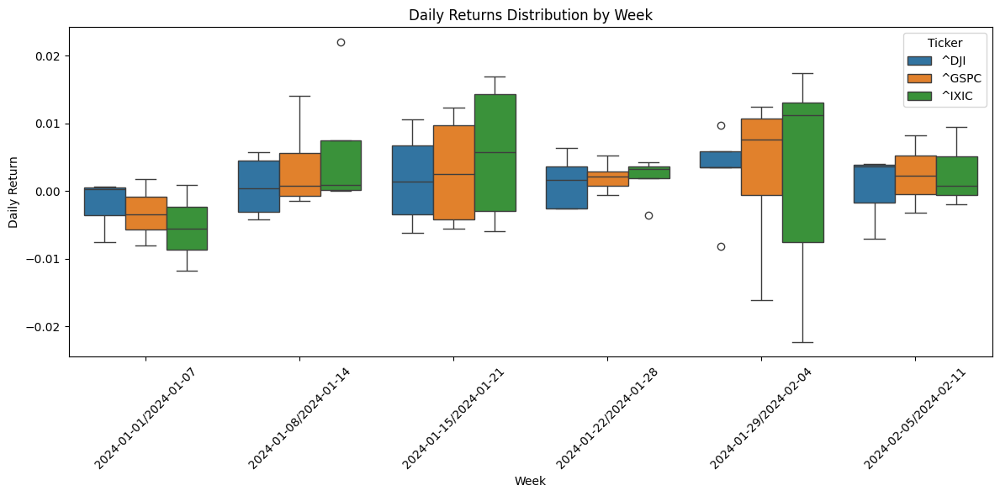

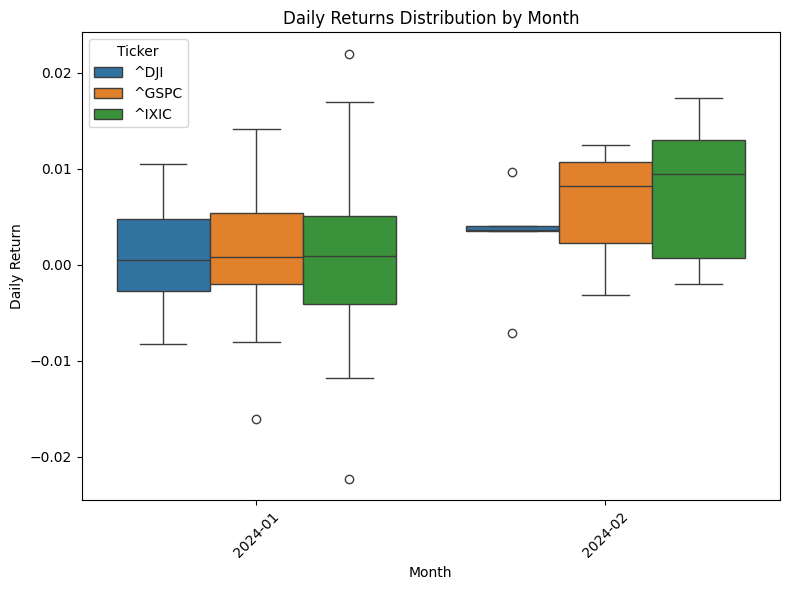

In [ ]:
import pandas as pd
import numpy as np
import yfinance as yf
import matplotlib.pyplot as plt
import seaborn as sns

# -------------------------------
# Parameters and Data Retrieval
# -------------------------------
# Define the start and end dates (example dates)
start_date = "2024-01-01"
end_date = "2024-02-08"

# Define the tickers (S&P 500, NASDAQ, Dow Jones)
tickers = ["^GSPC", "^IXIC", "^DJI"]

# Download daily closing prices for the tickers
data = yf.download(tickers, start=start_date, end=end_date)["Close"]

if data.empty:
    raise ValueError("No data retrieved. Check the ticker symbols or date range.")

# -------------------------------
# Compute Daily Returns
# -------------------------------
returns = data.pct_change().dropna()

# -------------------------------
# Create Week and Month Identifiers
# -------------------------------
# Create a copy to add grouping columns
returns_df = returns.copy()
# Create a 'Week' column (e.g., '2024-01-07/2024-01-13') based on each date's week period.
returns_df['Week'] = returns_df.index.to_period('W').astype(str)
# Create a 'Month' column (e.g., '2024-01') based on each date's month period.
returns_df['Month'] = returns_df.index.to_period('M').astype(str)

# Reset the index to turn the DateTimeIndex into a column (needed for melting)
returns_df = returns_df.reset_index().rename(columns={'index': 'Date'})

# -------------------------------
# Reshape the DataFrame for Seaborn
# -------------------------------
# Melt the DataFrame so that we have a column for tickers and their returns.
# The resulting DataFrame will have columns: Date, Week, Month, Ticker, and Return.
returns_melted = returns_df.melt(id_vars=['Date', 'Week', 'Month'], var_name='Ticker', value_name='Return')

# -------------------------------
# Plot Box Plots for Weekly Returns
# -------------------------------
plt.figure(figsize=(12, 6))
sns.boxplot(data=returns_melted, x='Week', y='Return', hue='Ticker')
plt.title("Daily Returns Distribution by Week")
plt.xticks(rotation=45)
plt.xlabel("Week")
plt.ylabel("Daily Return")
plt.tight_layout()
plt.show()

# -------------------------------
# Plot Box Plots for Monthly Returns
# -------------------------------
plt.figure(figsize=(8, 6))
sns.boxplot(data=returns_melted, x='Month', y='Return', hue='Ticker')
plt.title("Daily Returns Distribution by Month")
plt.xticks(rotation=45)
plt.xlabel("Month")
plt.ylabel("Daily Return")
plt.tight_layout()
plt.show()


[*********************100%***********************]  1 of 1 completed


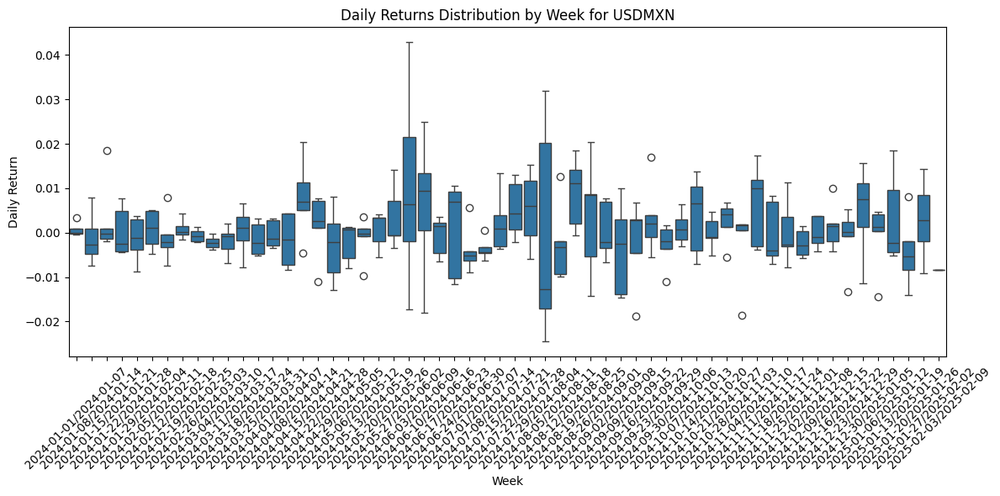

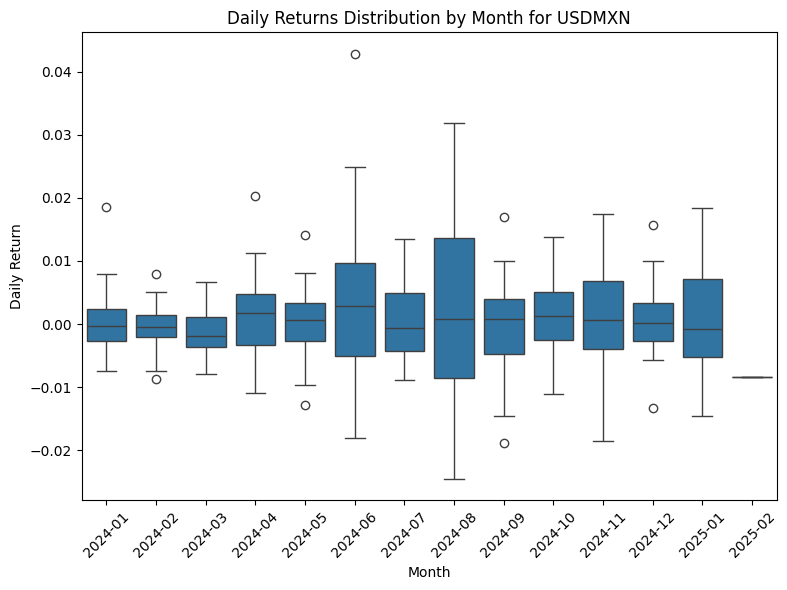

In [ ]:
import pandas as pd
import numpy as np
import yfinance as yf
import matplotlib.pyplot as plt
import seaborn as sns

# -------------------------------
# Parameters and Data Retrieval
# -------------------------------
start_date = "2024-01-01"
end_date = "2025-12-08"
ticker = "USDMXN=X"

# Download daily closing prices for USDMXN
data = yf.download(ticker, start=start_date, end=end_date)["Close"]

if data.empty:
    raise ValueError("No data retrieved. Check the ticker symbol or date range.")

# -------------------------------
# Compute Daily Returns
# -------------------------------
returns = data.pct_change().dropna()

# If returns is a Series, convert it to a DataFrame:
if isinstance(returns, pd.Series):
    returns_df = returns.to_frame(name="Return")
else:
    # Otherwise, if it's already a DataFrame with one column, rename the column.
    returns_df = returns.copy()
    if returns_df.shape[1] == 1:
         returns_df.columns = ["Return"]

returns_df.index.name = "Date"

# -------------------------------
# Create Week and Month Identifiers
# -------------------------------
returns_df["Week"] = returns_df.index.to_period('W').astype(str)
returns_df["Month"] = returns_df.index.to_period('M').astype(str)

returns_df = returns_df.reset_index()

# -------------------------------
# Plot Box Plots for Weekly Returns
# -------------------------------
plt.figure(figsize=(12, 6))
sns.boxplot(data=returns_df, x="Week", y="Return")
plt.title("Daily Returns Distribution by Week for USDMXN")
plt.xlabel("Week")
plt.ylabel("Daily Return")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

# -------------------------------
# Plot Box Plots for Monthly Returns
# -------------------------------
plt.figure(figsize=(8, 6))
sns.boxplot(data=returns_df, x="Month", y="Return")
plt.title("Daily Returns Distribution by Month for USDMXN")
plt.xlabel("Month")
plt.ylabel("Daily Return")
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()



DataFrame head:
         Date      Close
0 2024-01-01  16.963440
1 2024-01-02  16.962509
2 2024-01-03  17.019400
3 2024-01-04  17.012150
4 2024-01-05  17.008600

DataFrame info:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 285 entries, 0 to 284
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   Date    285 non-null    datetime64[ns]
 1   Close   285 non-null    float64       
dtypes: datetime64[ns](1), float64(1)
memory usage: 4.6 KB


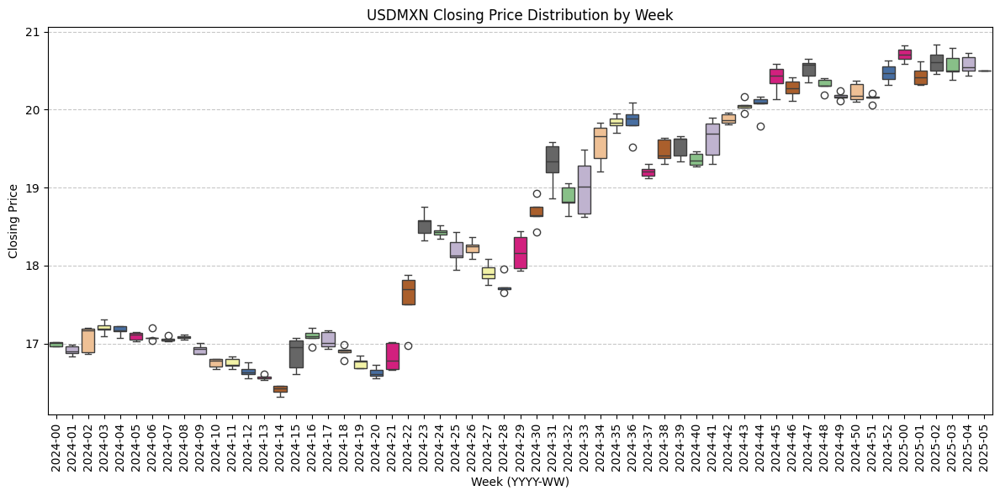

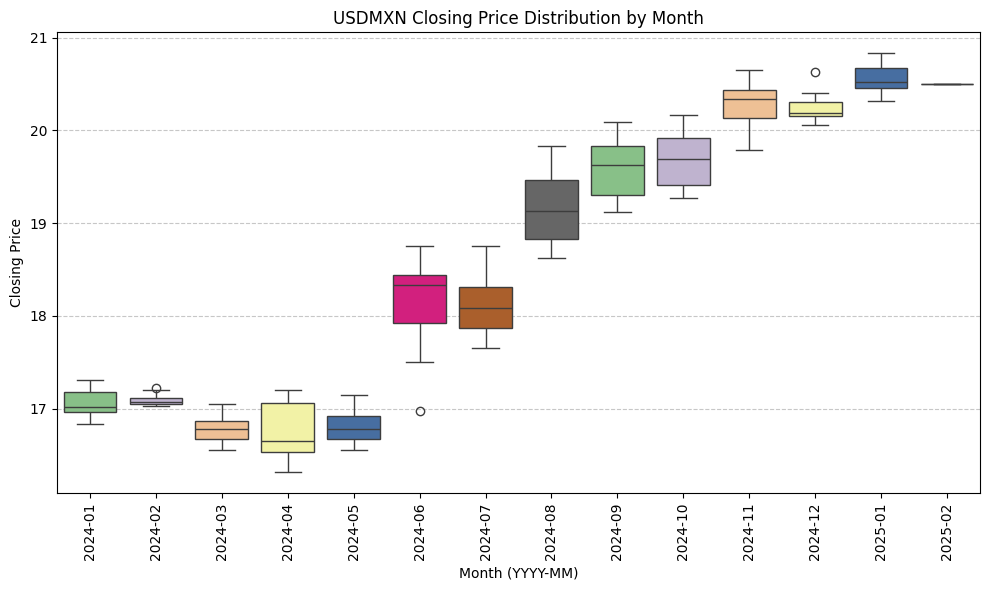

In [ ]:
import pandas as pd
import yfinance as yf
import matplotlib.pyplot as plt
import seaborn as sns

# -------------------------------
# 1. Download and Prepare Data
# -------------------------------
start_date = "2024-01-01"
end_date = "2025-12-08"
ticker = "USDMXN=X"

# Download full OHLCV data (often returns a multi-index DataFrame)
data = yf.download(ticker, start=start_date, end=end_date, progress=False)

if data.empty:
    raise ValueError("No data retrieved. Check the ticker symbol or date range.")

#  If columns are a multi-index, flatten them.
if isinstance(data.columns, pd.MultiIndex):
    # Example: (Close, USDMXN=X) -> "Close_USDMXN=X"
    data.columns = data.columns.to_flat_index()
    data.columns = [
        f"{col_tuple[0]}_{col_tuple[1]}" if col_tuple[1] else col_tuple[0]
        for col_tuple in data.columns
    ]

# Now find the column(s) that contain "Close"
possible_close_cols = [c for c in data.columns if "Close" in c]
if not possible_close_cols:
    raise ValueError("No Close column found in the downloaded data.")

# Select the first matching close column
close_col = possible_close_cols[0]

# Create a clean DataFrame with columns [Date, Close]
df = data[[close_col]].copy()
df.columns = ["Close"]  # Rename to a simple "Close"

# Reset index so that 'Date' is a column
df.reset_index(inplace=True)
df.rename(columns={"index": "Date"}, inplace=True)  # Just to be safe

# Convert Date to datetime (yfinance usually does this automatically, but just in case)
df["Date"] = pd.to_datetime(df["Date"], errors="coerce")

# Ensure "Close" is numeric and strictly 1D
df["Close"] = pd.to_numeric(df["Close"], errors="coerce")

print("DataFrame head:\n", df.head())
print("\nDataFrame info:\n")
df.info()

# -------------------------------
# 2. Create Weekly and Monthly Grouping
# -------------------------------
# We can create weekly labels like "YYYY-WW" using strftime('%Y-%U')
df["Week"] = df["Date"].dt.strftime("%Y-%U")   # e.g., "2024-01", "2024-02", ...
df["Month"] = df["Date"].dt.strftime("%Y-%m")  # e.g., "2024-01", "2024-02", ...

# Convert those strings into categorical for better control on the x-axis order
df["Week"] = pd.Categorical(df["Week"], categories=sorted(df["Week"].unique()), ordered=True)
df["Month"] = pd.Categorical(df["Month"], categories=sorted(df["Month"].unique()), ordered=True)

# -------------------------------
# 3. Plot Weekly Box Plot
# -------------------------------
plt.figure(figsize=(12, 6))
sns.boxplot(data=df, x="Week", y="Close", palette="Accent")
plt.title("USDMXN Closing Price Distribution by Week")
plt.xlabel("Week (YYYY-WW)")
plt.ylabel("Closing Price")
plt.xticks(rotation=90)
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.tight_layout()
plt.show()

# -------------------------------
# 4. Plot Monthly Box Plot
# -------------------------------
plt.figure(figsize=(10, 6))
sns.boxplot(data=df, x="Month", y="Close", palette="Accent")
plt.title("USDMXN Closing Price Distribution by Month")
plt.xlabel("Month (YYYY-MM)")
plt.ylabel("Closing Price")
plt.xticks(rotation=90)
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.tight_layout()
plt.show()



DataFrame head:
         Date       Open      Close       High        Low
0 2024-01-01  16.963440  16.963440  16.963440  16.963341
1 2024-01-02  16.962509  16.962509  17.064510  16.895300
2 2024-01-03  17.019400  17.019400  17.098249  17.003599
3 2024-01-04  17.012150  17.012150  17.083700  16.965500
4 2024-01-05  17.008600  17.008600  17.066820  16.870300

DataFrame info:
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 285 entries, 0 to 284
Data columns (total 5 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   Date    285 non-null    datetime64[ns]
 1   Open    285 non-null    float64       
 2   Close   285 non-null    float64       
 3   High    285 non-null    float64       
 4   Low     285 non-null    float64       
dtypes: datetime64[ns](1), float64(4)
memory usage: 11.3 KB


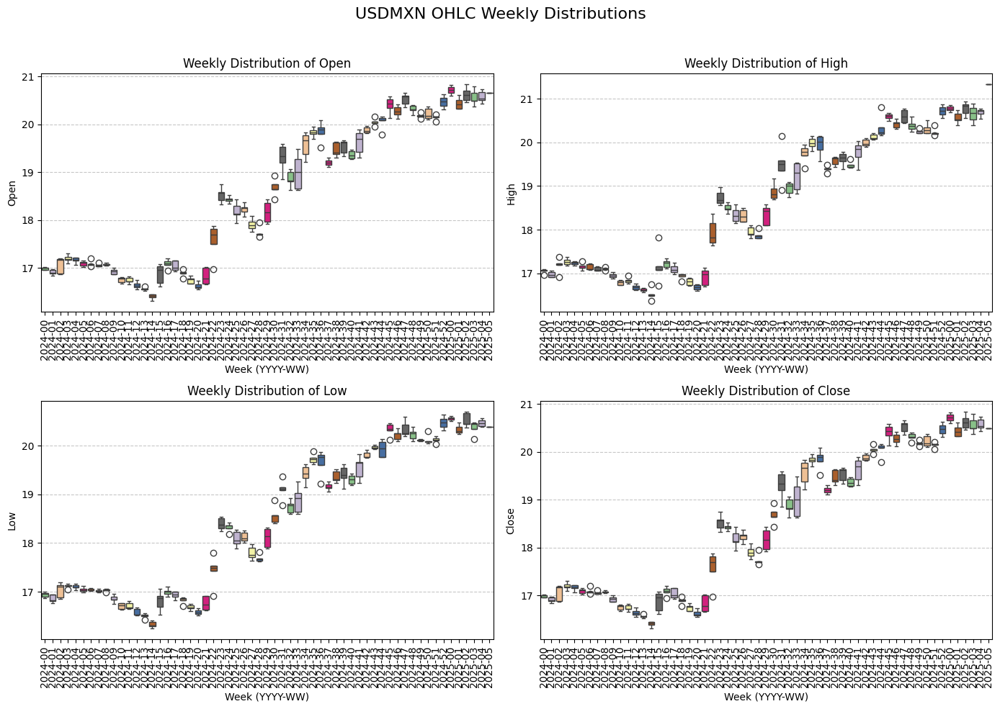

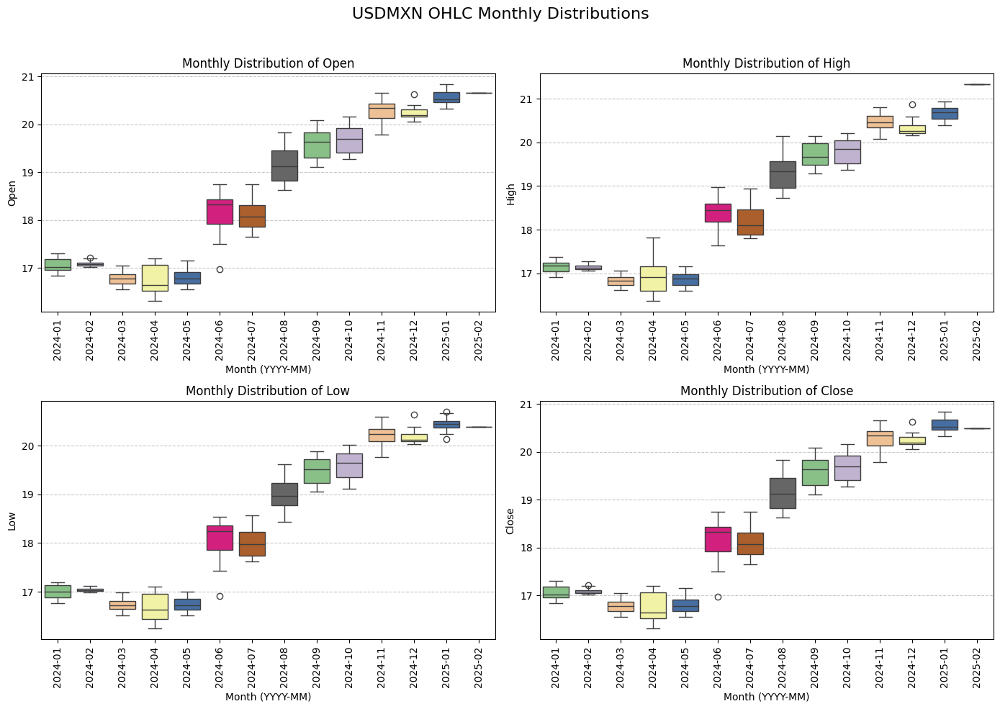

In [ ]:
import pandas as pd
import yfinance as yf
import matplotlib.pyplot as plt
import seaborn as sns

# -------------------------------
# 1. Download and Prepare Data
# -------------------------------
start_date = "2024-01-01"
end_date = "2025-12-08"
ticker = "USDMXN=X"

# Download full OHLCV data
data = yf.download(ticker, start=start_date, end=end_date, progress=False)

if data.empty:
    raise ValueError("No data retrieved. Check the ticker symbol or date range.")

# If the DataFrame has a multi-index for columns, flatten it.
if isinstance(data.columns, pd.MultiIndex):
    data.columns = data.columns.to_flat_index()
    data.columns = [
        f"{col_tuple[0]}_{col_tuple[1]}" if col_tuple[1] else col_tuple[0]
        for col_tuple in data.columns
    ]

# -------------------------------
# 2. Extract OHLC Columns
# -------------------------------
# Find the columns that contain Open, Close, High, and Low.
possible_open_cols = [c for c in data.columns if "Open" in c]
possible_close_cols = [c for c in data.columns if "Close" in c]
possible_high_cols = [c for c in data.columns if "High" in c]
possible_low_cols = [c for c in data.columns if "Low" in c]

if not (possible_open_cols and possible_close_cols and possible_high_cols and possible_low_cols):
    raise ValueError("One or more of the required columns (Open, Close, High, Low) were not found.")

# Select the first matching columns.
open_col = possible_open_cols[0]
close_col = possible_close_cols[0]
high_col = possible_high_cols[0]
low_col = possible_low_cols[0]

# Create a clean DataFrame with the four OHLC columns.
df = data[[open_col, close_col, high_col, low_col]].copy()
df.columns = ["Open", "Close", "High", "Low"]  # Rename for clarity

# Reset index so that 'Date' becomes a column and ensure proper types.
df.reset_index(inplace=True)
df["Date"] = pd.to_datetime(df["Date"], errors="coerce")
df["Open"] = pd.to_numeric(df["Open"], errors="coerce")
df["Close"] = pd.to_numeric(df["Close"], errors="coerce")
df["High"] = pd.to_numeric(df["High"], errors="coerce")
df["Low"] = pd.to_numeric(df["Low"], errors="coerce")

print("DataFrame head:\n", df.head())
print("\nDataFrame info:")
df.info()

# -------------------------------
# 3. Create Weekly and Monthly Groupings
# -------------------------------
# Create week labels (format: YYYY-WW) and month labels (format: YYYY-MM).
df["Week"] = df["Date"].dt.strftime("%Y-%U")   # Week numbers (Sunday as the first day of the week)
df["Month"] = df["Date"].dt.strftime("%Y-%m")    # Month labels

# Convert to categorical for proper ordering in the plots.
df["Week"] = pd.Categorical(df["Week"], categories=sorted(df["Week"].unique()), ordered=True)
df["Month"] = pd.Categorical(df["Month"], categories=sorted(df["Month"].unique()), ordered=True)

# -------------------------------
# 4. Plot Weekly and Monthly Distributions
# -------------------------------
# We will create two figures: one for weekly and one for monthly distributions.
# Each figure will have a 2x2 grid of box plots for Open, High, Low, and Close.

# --- Weekly Distribution Chart ---
fig, axes = plt.subplots(2, 2, figsize=(14, 10))
for ax, col in zip(axes.flatten(), ["Open", "High", "Low", "Close"]):
    sns.boxplot(data=df, x="Week", y=col, ax=ax, palette="Accent")
    ax.set_title(f"Weekly Distribution of {col}")
    ax.set_xlabel("Week (YYYY-WW)")
    ax.set_ylabel(col)
    ax.tick_params(axis='x', rotation=90)
    ax.grid(axis="y", linestyle="--", alpha=0.7)

plt.suptitle("USDMXN OHLC Weekly Distributions", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()

# --- Monthly Distribution Chart ---
fig, axes = plt.subplots(2, 2, figsize=(14, 10))
for ax, col in zip(axes.flatten(), ["Open", "High", "Low", "Close"]):
    sns.boxplot(data=df, x="Month", y=col, ax=ax, palette="Accent")
    ax.set_title(f"Monthly Distribution of {col}")
    ax.set_xlabel("Month (YYYY-MM)")
    ax.set_ylabel(col)
    ax.tick_params(axis='x', rotation=90)
    ax.grid(axis="y", linestyle="--", alpha=0.7)

plt.suptitle("USDMXN OHLC Monthly Distributions", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 0.96])
plt.show()


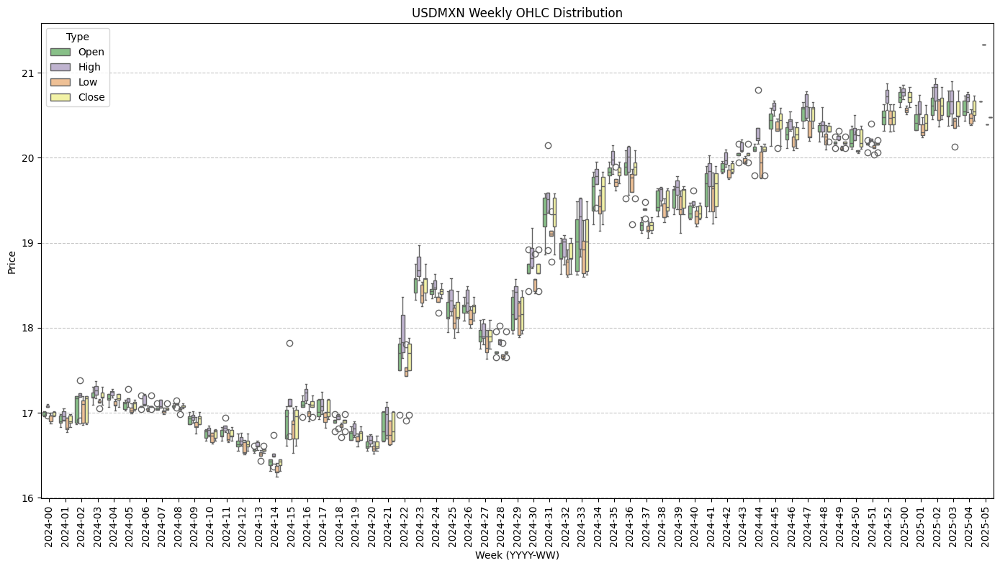

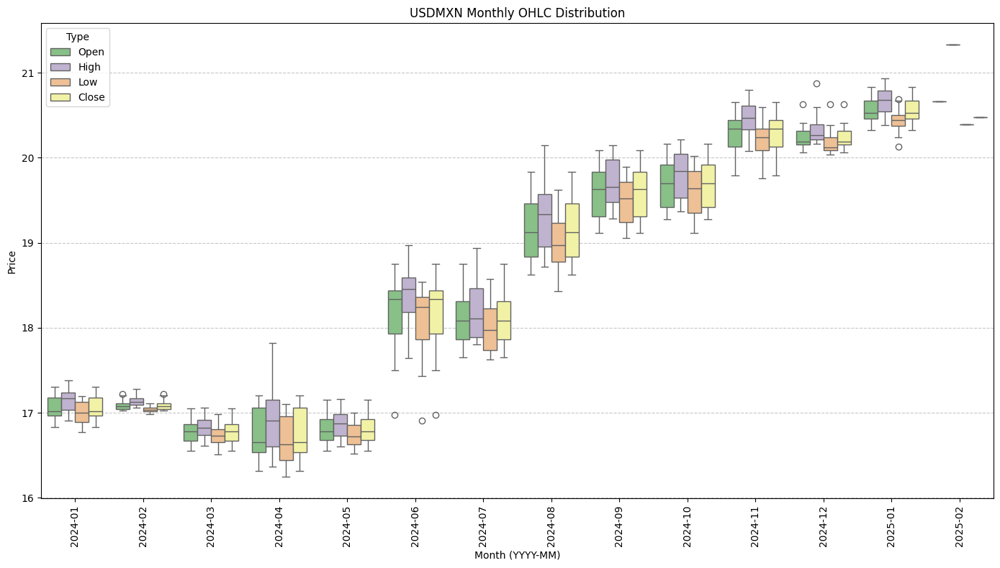

In [ ]:
import pandas as pd
import yfinance as yf
import matplotlib.pyplot as plt
import seaborn as sns

# -------------------------------
# 1. Download and Prepare Data
# -------------------------------
start_date = "2024-01-01"
end_date = "2025-12-08"
ticker = "USDMXN=X"

# Download full OHLCV data
data = yf.download(ticker, start=start_date, end=end_date, progress=False)

if data.empty:
    raise ValueError("No data retrieved. Check the ticker symbol or date range.")

# If columns are a MultiIndex, flatten them.
if isinstance(data.columns, pd.MultiIndex):
    data.columns = data.columns.to_flat_index()
    data.columns = [
        f"{col_tuple[0]}_{col_tuple[1]}" if col_tuple[1] else col_tuple[0]
        for col_tuple in data.columns
    ]

# -------------------------------
# 2. Extract OHLC Columns
# -------------------------------
# Find the columns that contain Open, Close, High, and Low.
possible_open_cols = [c for c in data.columns if "Open" in c]
possible_close_cols = [c for c in data.columns if "Close" in c]
possible_high_cols = [c for c in data.columns if "High" in c]
possible_low_cols = [c for c in data.columns if "Low" in c]

if not (possible_open_cols and possible_close_cols and possible_high_cols and possible_low_cols):
    raise ValueError("One or more of the required columns (Open, Close, High, Low) were not found.")

# Select the first matching columns.
open_col = possible_open_cols[0]
close_col = possible_close_cols[0]
high_col = possible_high_cols[0]
low_col = possible_low_cols[0]

# Create a clean DataFrame with the four OHLC columns.
df = data[[open_col, close_col, high_col, low_col]].copy()
df.columns = ["Open", "Close", "High", "Low"]  # Rename for clarity

# Reset index so that 'Date' becomes a column and ensure proper data types.
df.reset_index(inplace=True)
df["Date"] = pd.to_datetime(df["Date"], errors="coerce")
df["Open"] = pd.to_numeric(df["Open"], errors="coerce")
df["Close"] = pd.to_numeric(df["Close"], errors="coerce")
df["High"] = pd.to_numeric(df["High"], errors="coerce")
df["Low"] = pd.to_numeric(df["Low"], errors="coerce")

# -------------------------------
# 3. Create Weekly and Monthly Groupings
# -------------------------------
# Create week labels (format: YYYY-WW) and month labels (format: YYYY-MM).
df["Week"] = df["Date"].dt.strftime("%Y-%U")
df["Month"] = df["Date"].dt.strftime("%Y-%m")

# Convert to categorical to maintain the desired order in plots.
df["Week"] = pd.Categorical(df["Week"], categories=sorted(df["Week"].unique()), ordered=True)
df["Month"] = pd.Categorical(df["Month"], categories=sorted(df["Month"].unique()), ordered=True)

# -------------------------------
# 4. Convert Data to Long Format
# -------------------------------
# Melt the DataFrame so that the OHLC values are in one column.
df_long = pd.melt(
    df,
    id_vars=["Date", "Week", "Month"],
    value_vars=["Open", "High", "Low", "Close"],
    var_name="Type",
    value_name="Price"
)

# -------------------------------
# 5. Plot the Combined Distributions
# -------------------------------
# --- Weekly Distribution Chart ---
plt.figure(figsize=(14, 8))
sns.boxplot(data=df_long, x="Week", y="Price", hue="Type", palette="Accent")
plt.title("USDMXN Weekly OHLC Distribution")
plt.xlabel("Week (YYYY-WW)")
plt.ylabel("Price")
plt.xticks(rotation=90)
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.tight_layout()
plt.show()

# --- Monthly Distribution Chart ---
plt.figure(figsize=(14, 8))
sns.boxplot(data=df_long, x="Month", y="Price", hue="Type", palette="Accent")
plt.title("USDMXN Monthly OHLC Distribution")
plt.xlabel("Month (YYYY-MM)")
plt.ylabel("Price")
plt.xticks(rotation=90)
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.tight_layout()
plt.show()


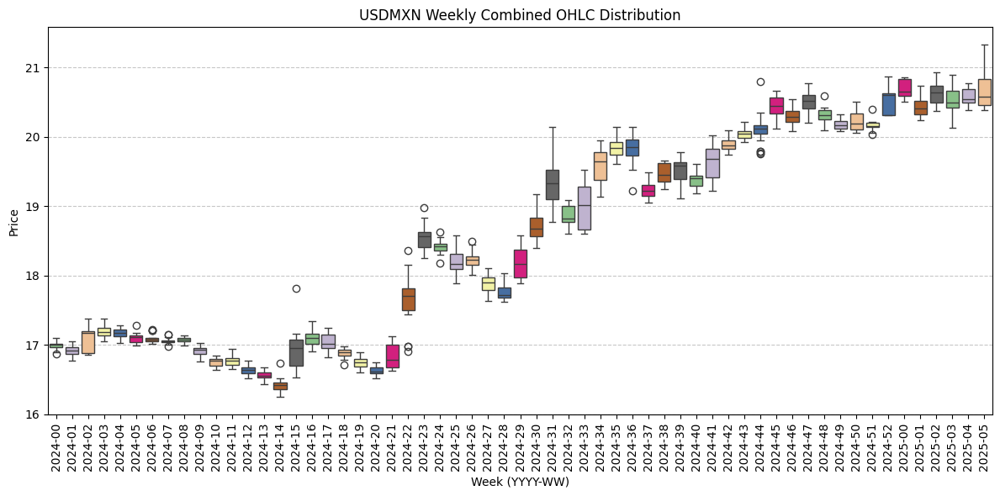

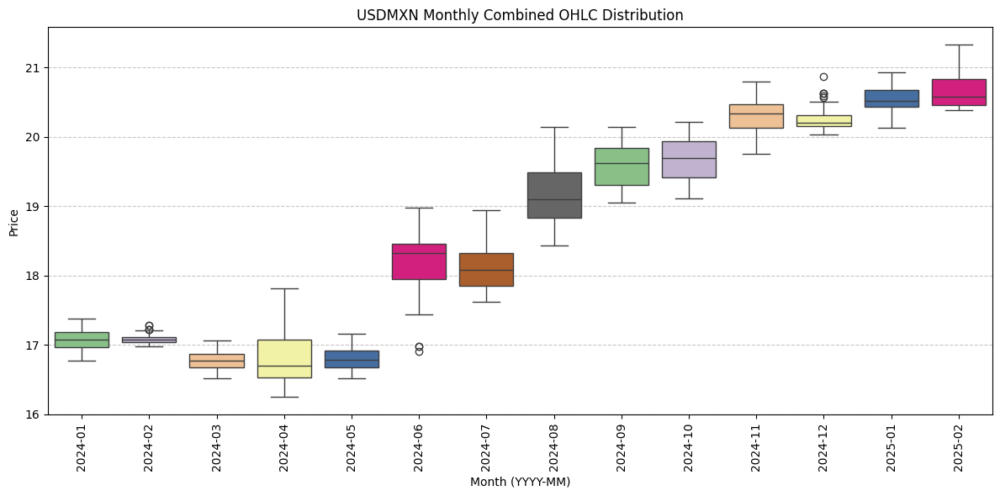

In [ ]:
import pandas as pd
import yfinance as yf
import matplotlib.pyplot as plt
import seaborn as sns

# -------------------------------
# 1. Download and Prepare Data
# -------------------------------
start_date = "2024-01-01"
end_date = "2025-12-08"
ticker = "USDMXN=X"

# Download the OHLCV data
data = yf.download(ticker, start=start_date, end=end_date, progress=False)
if data.empty:
    raise ValueError("No data retrieved. Check the ticker symbol or date range.")

# If the DataFrame has a MultiIndex for columns, flatten it.
if isinstance(data.columns, pd.MultiIndex):
    data.columns = data.columns.to_flat_index()
    data.columns = [
        f"{col_tuple[0]}_{col_tuple[1]}" if col_tuple[1] else col_tuple[0]
        for col_tuple in data.columns
    ]

# -------------------------------
# 2. Extract OHLC Columns
# -------------------------------
# Identify the columns containing Open, Close, High, and Low.
possible_open_cols = [c for c in data.columns if "Open" in c]
possible_close_cols = [c for c in data.columns if "Close" in c]
possible_high_cols = [c for c in data.columns if "High" in c]
possible_low_cols = [c for c in data.columns if "Low" in c]

if not (possible_open_cols and possible_close_cols and possible_high_cols and possible_low_cols):
    raise ValueError("One or more of the required columns (Open, Close, High, Low) were not found.")

# Select the first matching column for each.
open_col = possible_open_cols[0]
close_col = possible_close_cols[0]
high_col = possible_high_cols[0]
low_col = possible_low_cols[0]

# Create a clean DataFrame with the four OHLC columns.
df = data[[open_col, close_col, high_col, low_col]].copy()
df.columns = ["Open", "Close", "High", "Low"]  # Rename for clarity

# Reset the index so that 'Date' becomes a column and convert data types.
df.reset_index(inplace=True)
df["Date"] = pd.to_datetime(df["Date"], errors="coerce")
df["Open"] = pd.to_numeric(df["Open"], errors="coerce")
df["Close"] = pd.to_numeric(df["Close"], errors="coerce")
df["High"] = pd.to_numeric(df["High"], errors="coerce")
df["Low"] = pd.to_numeric(df["Low"], errors="coerce")

# -------------------------------
# 3. Create Weekly and Monthly Groupings
# -------------------------------
# Create labels for Week (format: YYYY-WW) and Month (format: YYYY-MM)
df["Week"] = df["Date"].dt.strftime("%Y-%U")
df["Month"] = df["Date"].dt.strftime("%Y-%m")

# Optional: Convert these labels to categorical data types for proper ordering in the plots.
df["Week"] = pd.Categorical(df["Week"], categories=sorted(df["Week"].unique()), ordered=True)
df["Month"] = pd.Categorical(df["Month"], categories=sorted(df["Month"].unique()), ordered=True)

# -------------------------------
# 4. Convert Data to Long Format
# -------------------------------
# Melt the DataFrame so that all OHLC values appear in a single column.
df_long = pd.melt(
    df,
    id_vars=["Date", "Week", "Month"],
    value_vars=["Open", "High", "Low", "Close"],
    var_name="Type",
    value_name="Price"
)

# -------------------------------
# 5. Plot Combined Distributions
# -------------------------------
# In these plots we drop the 'Type' differentiation, so each period (week/month)
# is represented by a single box plot that aggregates all OHLC values.

# --- Weekly Distribution Chart (Combined) ---
plt.figure(figsize=(12, 6))
sns.boxplot(data=df_long, x="Week", y="Price", palette="Accent")
plt.title("USDMXN Weekly Combined OHLC Distribution")
plt.xlabel("Week (YYYY-WW)")
plt.ylabel("Price")
plt.xticks(rotation=90)
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.tight_layout()
plt.show()

# --- Monthly Distribution Chart (Combined) ---
plt.figure(figsize=(12, 6))
sns.boxplot(data=df_long, x="Month", y="Price", palette="Accent")
plt.title("USDMXN Monthly Combined OHLC Distribution")
plt.xlabel("Month (YYYY-MM)")
plt.ylabel("Price")
plt.xticks(rotation=90)
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.tight_layout()
plt.show()


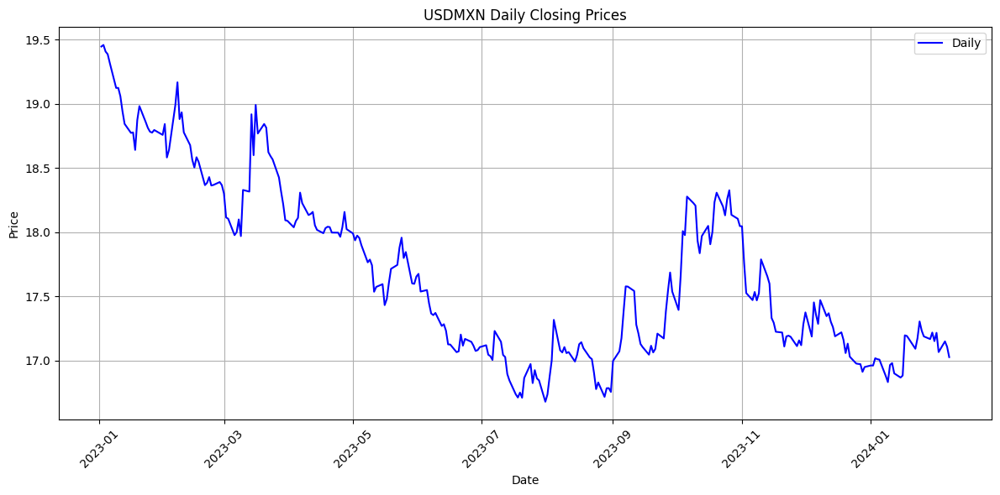

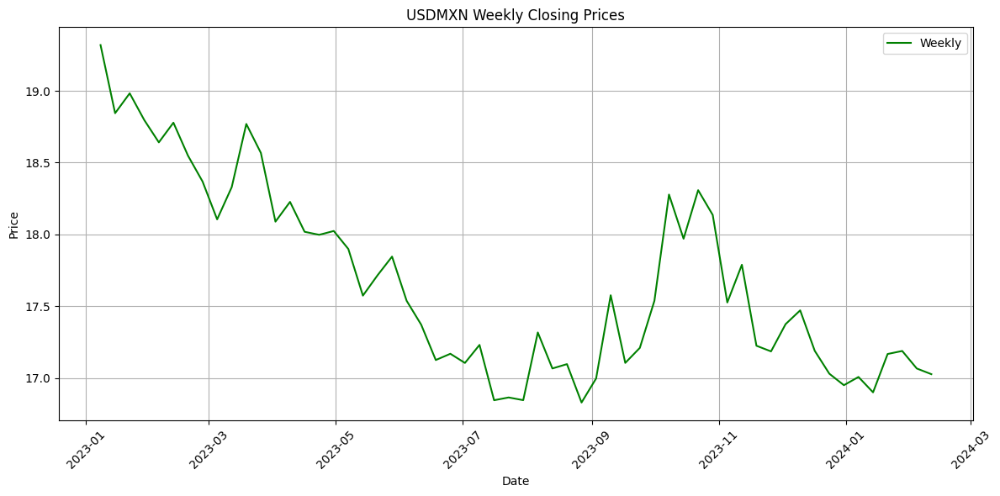

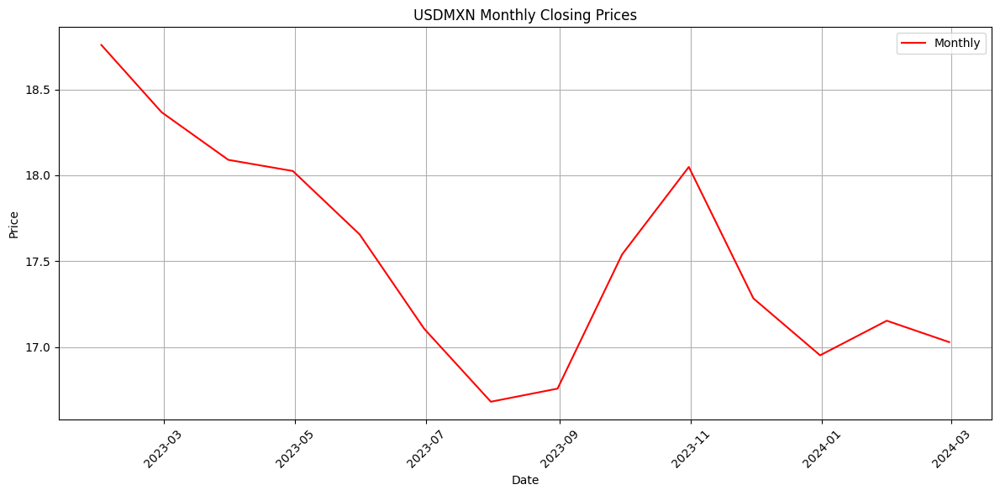

In [ ]:
import pandas as pd
import yfinance as yf
import matplotlib.pyplot as plt

# -------------------------------
# Parameters and Data Retrieval
# -------------------------------
start_date = "2023-01-01"
end_date = "2024-02-08"
ticker = "USDMXN=X"

# Download daily historical data for USDMXN
df = yf.download(ticker, start=start_date, end=end_date, progress=False)

# Reset the index so that 'Date' becomes a column
df.reset_index(inplace=True)

# -------------------------------
# 1. Daily Closing Prices
# -------------------------------
plt.figure(figsize=(12, 6))
plt.plot(df["Date"], df["Close"], label="Daily", color='blue')
plt.title("USDMXN Daily Closing Prices")
plt.xlabel("Date")
plt.ylabel("Price")
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# -------------------------------
# 2. Weekly Closing Prices
# -------------------------------
# Convert Date column to datetime if not already and set it as index
df["Date"] = pd.to_datetime(df["Date"])
df_weekly = df.set_index("Date").resample("W").last()

plt.figure(figsize=(12, 6))
plt.plot(df_weekly.index, df_weekly["Close"], label="Weekly", color='green')
plt.title("USDMXN Weekly Closing Prices")
plt.xlabel("Date")
plt.ylabel("Price")
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()

# -------------------------------
# 3. Monthly Closing Prices
# -------------------------------
df_monthly = df.set_index("Date").resample("M").last()

plt.figure(figsize=(12, 6))
plt.plot(df_monthly.index, df_monthly["Close"], label="Monthly", color='red')
plt.title("USDMXN Monthly Closing Prices")
plt.xlabel("Date")
plt.ylabel("Price")
plt.xticks(rotation=45)
plt.legend()
plt.grid(True)
plt.tight_layout()
plt.show()



In [ ]:
import pandas as pd
import numpy as np
import yfinance as yf
from scipy.stats import norm

# -------------------------------
# User Settings
# -------------------------------
frequency = 'monthly'  # Set either 'daily' or 'monthly'
start_date = "2024-01-01"
end_date = "2024-11-01"

# -------------------------------
# Tickers and Categories
# -------------------------------
tickers = {
    "EURUSD=X": "Euro (EUR)", "USDJPY=X": "Japan (JPY)", "GBPUSD=X": "British Pound (GBP)",
    "USDCHF=X": "Swiss Franc (CHF)", "USDCAD=X": "Canadian Dollar (CAD)", "USDMXN=X": "Mexican Peso (MXN)",
    "USDPLN=X": "Polish Zloty (PLN)", "USDHUF=X": "Hungarian Forint (HUF)", "USDZAR=X": "South African Rand (ZAR)",
    "USDSGD=X": "Singapore Dollar (SGD)", "USDBRL=X": "Brazilian Real (BRL)", "AUDUSD=X": "Australian Dollar (AUD)",
    "NZDUSD=X": "New Zealand Dollar (NZD)", "USDINR=X": "Indian Rupee (INR)", "USDKRW=X": "South Korean Won (KRW)",
    "USDRUB=X": "Russian Ruble (RUB)", "USDCNY=X": "Chinese Yuan (CNY)", "USDTWD=X": "Taiwan Dollar (TWD)",
    "USDTHB=X": "Thai Baht (THB)", "USDTRY=X": "Turkish Lira (TRY)", "USDCZK=X": "Czech Koruna (CZK)",
    "USDMYR=X": "Malaysian Ringgit (MYR)", "USDCOP=X": "Colombian Peso (COP)", "USDARS=X": "Argentine Peso (ARS)",
    "USDCLP=X": "Chilean Peso (CLP)", "USDPEN=X": "Peruvian Nuevo Sol (PEN)"
}
benchmark = "DX-Y.NYB"  # Dollar Index used as benchmark
tickers[benchmark] = "Dollar Index (DXY)"

categories = {
    "EURUSD=X": {"Continent": "Europe", "Economic Classification": "Eurozone (Advanced)"},
    "USDJPY=X": {"Continent": "Asia", "Economic Classification": "Japan (Advanced)"},
    "GBPUSD=X": {"Continent": "Europe", "Economic Classification": "United Kingdom (Advanced)"},
    "USDCHF=X": {"Continent": "Europe", "Economic Classification": "Switzerland (Advanced)"},
    "USDCAD=X": {"Continent": "North America", "Economic Classification": "Canada (Advanced)"},
    "USDMXN=X": {"Continent": "North America", "Economic Classification": "Mexico (Emerging)"},
    "USDPLN=X": {"Continent": "Europe", "Economic Classification": "Poland (Emerging)"},
    "USDHUF=X": {"Continent": "Europe", "Economic Classification": "Hungary (Emerging)"},
    "USDZAR=X": {"Continent": "Africa", "Economic Classification": "South Africa (Emerging)"},
    "USDSGD=X": {"Continent": "Asia", "Economic Classification": "Singapore (Advanced)"},
    "USDBRL=X": {"Continent": "South America", "Economic Classification": "Brazil (Emerging)"},
    "AUDUSD=X": {"Continent": "Oceania", "Economic Classification": "Australia (Advanced)"},
    "NZDUSD=X": {"Continent": "Oceania", "Economic Classification": "New Zealand (Advanced)"},
    "USDINR=X": {"Continent": "Asia", "Economic Classification": "India (Emerging)"},
    "USDKRW=X": {"Continent": "Asia", "Economic Classification": "South Korea (Advanced)"},
    "USDRUB=X": {"Continent": "Europe/Asia", "Economic Classification": "Russia (Emerging)"},
    "USDCNY=X": {"Continent": "Asia", "Economic Classification": "China (Emerging)"},
    "USDTWD=X": {"Continent": "Asia", "Economic Classification": "Taiwan (Advanced)"},
    "USDTHB=X": {"Continent": "Asia", "Economic Classification": "Thailand (Emerging)"},
    "USDTRY=X": {"Continent": "Asia", "Economic Classification": "Turkey (Emerging)"},
    "USDCZK=X": {"Continent": "Europe", "Economic Classification": "Czech Republic (Emerging)"},
    "USDMYR=X": {"Continent": "Asia", "Economic Classification": "Malaysia (Emerging)"},
    "USDCOP=X": {"Continent": "South America", "Economic Classification": "Colombia (Emerging)"},
    "USDARS=X": {"Continent": "South America", "Economic Classification": "Argentina (Emerging)"},
    "USDCLP=X": {"Continent": "South America", "Economic Classification": "Chile (Emerging)"},
    "USDPEN=X": {"Continent": "South America", "Economic Classification": "Peru (Emerging)"},
    "DX-Y.NYB": {"Continent": "Global", "Economic Classification": "Benchmark (DXY)"}
}

# -------------------------------
# Interest Rates
# -------------------------------
interest_rates = {
    'EUR': 3.40, 'USD': 5.00, 'JPY': 0.25, 'GBP': 5.00, 'CHF': 1.00, 'CAD': 3.75,
    'AUD': 4.35, 'NZD': 4.75, 'MXN': 10.50, 'PLN': 5.75, 'HUF': 6.50, 'ZAR': 8.00,
    'SGD': 3.16, 'BRL': 10.75, 'INR': 6.75, 'KRW': 3.25, 'RUB': 21.00, 'CNY': 3.10,
    'TWD': 2.00, 'THB': 2.25, 'TRY': 50.00, 'CZK': 4.25, 'MYR': 3.00, 'COP': 10.00,
    'ARS': 35.00, 'CLP': 5.25, 'PEN': 3.50
}

def get_interest_rate(currency):
    return interest_rates.get(currency, 0.01)  # Default to 1% if not found

# -------------------------------
# Data Retrieval and Resampling
# -------------------------------
data = yf.download(list(tickers.keys()), start=start_date, end=end_date)["Close"]

if data.empty:
    raise ValueError("No data retrieved. Check ticker symbols or date range.")

# Choose the resampling and scaling factors based on frequency
if frequency == 'monthly':
    # Resample data: we use the last available price of each month
    data = data.resample('M').last()
    # For returns computed on monthly data, the number of periods per year is 12.
    periods_per_year = 12
else:
    # Use daily data (assumed trading days ~252)
    periods_per_year = 252

# Calculate returns using the selected frequency
returns = data.pct_change().dropna()

# Set the risk-free rate per period (if annual risk_free_rate is given)
risk_free_rate = 0.01  # Annual risk-free rate
risk_free_rate_period = risk_free_rate / periods_per_year

# For CAPM benchmark returns, compute based on the chosen frequency
benchmark_return = returns[benchmark].mean() * periods_per_year

# -------------------------------
# Calculate Metrics
# -------------------------------
metrics = {}

for ticker, label in tickers.items():
    # Standard deviation (volatility) per period, then annualized
    period_std = returns[ticker].std()  # volatility in period units
    std_dev = period_std * np.sqrt(periods_per_year)

    # Sharpe Ratio (using period mean and std; then annualized)
    period_excess_return = returns[ticker].mean() - risk_free_rate_period
    sharpe_ratio = (period_excess_return / period_std) * np.sqrt(periods_per_year) if period_std != 0 else np.nan

    # Sortino Ratio (using downside deviation computed on period data)
    negative_returns = returns[ticker][returns[ticker] < 0]
    period_downside_dev = negative_returns.std() if not negative_returns.empty else np.nan
    downside_deviation = period_downside_dev * np.sqrt(periods_per_year) if period_downside_dev is not np.nan else np.nan
    sortino_ratio = (period_excess_return / period_downside_dev) * np.sqrt(periods_per_year) if (period_downside_dev is not None and period_downside_dev != 0) else np.nan

    # Drawdown Metrics
    cumulative_returns = (1 + returns[ticker]).cumprod()
    drawdown = cumulative_returns.cummax() - cumulative_returns
    max_drawdown = drawdown.max()
    avg_drawdown = drawdown.mean()

    # CVaR (Expected Shortfall) and VaR at 95% level
    var_95 = returns[ticker].quantile(0.05)
    cvar_95 = returns[ticker][returns[ticker] <= var_95].mean()

    # Average Daily (or Period) Range as a proxy for liquidity
    daily_range = data[ticker].diff().abs()
    avg_daily_range = daily_range.mean()

    # Advanced FX Metrics: Carry Trade Return (using first 3 letters as base and next 3 as quote)
    base_currency, quote_currency = ticker[:3], ticker[3:6]
    base_rate = get_interest_rate(base_currency)
    quote_rate = get_interest_rate(quote_currency)
    carry_trade_return = base_rate - quote_rate

    # Rolling Volatility and Beta (using a window expressed in periods)
    window = 30 if len(returns) >= 30 else len(returns)
    rolling_volatility = returns[ticker].rolling(window=window).std() * np.sqrt(periods_per_year)
    rolling_beta = returns[ticker].rolling(window=window).cov(returns[benchmark]) / returns[benchmark].rolling(window=window).var()

    # Momentum over a 3-month period (if monthly data, 3 periods; if daily, ~63 periods)
    momentum_window = 3 if frequency == 'monthly' else 63
    # Here we use compound returns over the window
    momentum = (1 + returns[ticker]).rolling(window=momentum_window).apply(np.prod, raw=True) - 1

    # Rolling Correlation with Benchmark
    rolling_corr = returns[ticker].rolling(window=window).corr(returns[benchmark])

    # CAPM metrics
    avg_return = returns[ticker].mean() * periods_per_year
    beta = returns[ticker].cov(returns[benchmark]) / returns[benchmark].var() if returns[benchmark].var() != 0 else np.nan
    alpha = (avg_return - risk_free_rate) - beta * (benchmark_return - risk_free_rate) if beta is not np.nan else np.nan
    capm_return = risk_free_rate + beta * (benchmark_return - risk_free_rate) if beta is not np.nan else np.nan
    treynor_ratio = (avg_return - risk_free_rate) / beta if beta != 0 else np.nan

    # Tracking error and Information Ratio (here computed on period returns)
    diff_returns = returns[ticker] - returns[benchmark]
    tracking_error = diff_returns.std() * np.sqrt(periods_per_year)
    active_return = (returns[ticker].mean() - returns[benchmark].mean()) * periods_per_year
    information_ratio = active_return / tracking_error if tracking_error != 0 else np.nan

    # Calmar Ratio (using annualized average return and max drawdown)
    calmar_ratio = avg_return / max_drawdown if max_drawdown != 0 else np.nan

    # Cumulative Return (compound growth over the sample)
    cumulative_return = cumulative_returns.iloc[-1] - 1

    # Omega Ratio (sum of gains divided by sum of losses)
    gains = returns[ticker][returns[ticker] > 0].sum()
    losses = abs(returns[ticker][returns[ticker] < 0].sum())
    omega_ratio = gains / losses if losses != 0 else np.nan

    # Monthly Seasonality (if using monthly returns this is direct; otherwise, resample to month-end)
    monthly_seasonality = returns[ticker].resample('M').mean().mean()

    # Store metrics for ticker
    metrics[ticker] = {
        # Volatility and Risk Measures
        'Standard Deviation': std_dev,
        'Rolling Volatility (30p)': rolling_volatility.mean(),
        'Max Drawdown': max_drawdown,
        'Average Drawdown': avg_drawdown,
        'Expected Shortfall (CVaR 95%)': cvar_95,
        'VaR 95%': var_95,
        'Average Period Range': avg_daily_range,

        # Risk-Adjusted Performance Ratios
        'Sharpe Ratio': sharpe_ratio,
        'Sortino Ratio': sortino_ratio,
        'Treynor Ratio': treynor_ratio,
        'Omega Ratio': omega_ratio,

        # CAPM and Benchmark Metrics
        'Beta (vs DXY)': beta,
        'Alpha': alpha,
        'CAPM Expected Return': capm_return,
        'Jensen\'s Alpha': alpha,
        'Rolling Beta (30p)': rolling_beta.mean(),
        'Tracking Error': tracking_error,
        'Information Ratio': information_ratio,

        # Return and Momentum Metrics
        'Momentum (3p)': momentum.mean(),
        'Average Return': avg_return,
        'Average Positive Return': returns[ticker][returns[ticker] > 0].mean() * periods_per_year,
        'Average Negative Return': returns[ticker][returns[ticker] < 0].mean() * periods_per_year,
        'Cumulative Return': cumulative_return,
        'Max Return': returns[ticker].max(),
        'Min Return': returns[ticker].min(),

        # Distribution Metrics
        'Skewness': returns[ticker].skew(),
        'Kurtosis': returns[ticker].kurtosis(),

        # Drawdown/Reward Measure
        'Calmar Ratio': calmar_ratio,

        # FX Specific Metrics
        'Carry Trade Return': carry_trade_return,
        'Rolling Correlation (30p)': rolling_corr.mean(),

        # Seasonality
        'Monthly Seasonality': monthly_seasonality
    }

# Create a DataFrame from the metrics dictionary and add category columns
metrics_df = pd.DataFrame(metrics).T
metrics_df['Continent'] = metrics_df.index.map(lambda x: categories[x]['Continent'])
metrics_df['Economic Classification'] = metrics_df.index.map(lambda x: categories[x]['Economic Classification'])

# Reorder columns to place categories first
cols = ['Continent', 'Economic Classification'] + [col for col in metrics_df.columns if col not in ['Continent', 'Economic Classification']]
metrics_df = metrics_df[cols]

output_filename = "currency_metrics_with_categories.csv"
metrics_df.to_csv(output_filename, index=True)
print(f"CSV file '{output_filename}' has been created successfully.")


[*********************100%***********************]  27 of 27 completed


CSV file 'currency_metrics_with_categories.csv' has been created successfully.
